In [1]:
# Imports
# !pip install torchinfo
import torch
import torch.nn as nn
import torch.utils.data as Data
from torchvision import datasets, transforms
from torchinfo import summary
import matplotlib.pyplot as plt
import numpy as np
import random
import os
import time
import CompMethods_V2 as TP
import DataSetting as DS

### Loader

In [2]:
gpu = 1
date_run = '240331R1'

In [3]:
datadir = '../dataset/0509/make14-split-few/'
print(os.listdir(datadir))

['fcsi_train.npy', 'fcsi_valid.npy', 'fcsi_test.npy', 'cimg_train.npy', 'cimg_valid.npy', 'cimg_test.npy', 'bbx_train.npy', 'bbx_valid.npy', 'bbx_test.npy', 'bbx_n_train.npy', 'bbx_n_valid.npy', 'bbx_n_test.npy', 'fpd_train.npy', 'fpd_valid.npy', 'fpd_test.npy', 'ndpt_train.npy', 'ndpt_valid.npy', 'ndpt_test.npy', 'rimg_train.npy', 'rimg_valid.npy', 'rimg_test.npy', 'ind_train.npy', 'ind_valid.npy', 'ind_test.npy']


In [ ]:
transform = transforms.Compose([
    transforms.Resize([128, 128]),
    transforms.ToTensor()])

train_data = DS.MyDatasetV2(name = 'train',
                          paths = {'csi': datadir + 'fcsi_train.npy',
                                 'img': datadir + 'rimg_train.npy',
                                  'ind': datadir + 'ind_train.npy'},
                         transform = transform,
                         mmap_mode=None
                        )
train_data.load_data()
myloader = DS.DataSplitter(train_data, train_ratio=1)

train_loader = myloader.unsplit_loader()

valid_data = DS.MyDatasetV2(name = 'valid',
                          paths = {'csi': datadir + 'fcsi_valid.npy',
                                 'img': datadir + 'rimg_valid.npy',
                                  'ind': datadir + 'ind_valid.npy'},
                         transform = transform,
                         mmap_mode=None
                        )
valid_data.load_data()
myloader = DS.DataSplitter(valid_data, train_ratio=0, valid_ratio=1)

valid_loader = myloader.unsplit_loader()

test_data = DS.MyDatasetV2(name = 'test',
                          paths = {'csi': datadir + 'fcsi_test.npy',
                                 'img': datadir + 'rimg_test.npy',
                                  'ind': datadir + 'ind_test.npy'},
                         transform = transform,
                         mmap_mode=None
                        )
test_data.load_data()
myloader = DS.DataSplitter(test_data, train_ratio=0, valid_ratio=0)

test_loader = myloader.unsplit_loader(batch_size=1, shuffle=False)

train loading...
loaded csi of (1099, 6, 30, 30) as float64


### Wi2Vi

In [4]:
# ----Don't use ToPILImage() or ToTensor()----
transform = transforms.Compose([
    transforms.Resize([240, 320]),
 ])
train_data = DS.MyDatasetV2(name = 'train',
                          paths = {'csi': datadir + 'fcsi_train.npy',
                                 'img': datadir + 'cimg_train.npy',
                                 'bbx': datadir + 'bbx_train.npy',
                                 'pd': datadir + 'fpd_train.npy',
                                 'dpt': datadir + 'ndpt_train.npy'},
                          bbx_ver = 'xyxy',
                         transform,
                         mmap_mode=None
                        )
train_data.load_data()
train_data.adjust_bbx()
myloader = DS.DataSplitter(train_data, train_ratio=1)

train_loader = myloader.unsplit_loader()

valid_data = DS.MyDatasetV2(name = 'valid',
                          paths = {'csi': datadir + 'fcsi_valid.npy',
                                 'img': datadir + 'cimg_valid.npy',
                                 'bbx': datadir + 'bbx_valid.npy',
                                 'pd': datadir + 'fpd_valid.npy',
                                 'dpt': datadir + 'ndpt_valid.npy'},
                          bbx_ver = 'xyxy',
                         transform,
                         mmap_mode=None
                        )
valid_data.load_data()
valid_data.adjust_bbx()
myloader = DS.DataSplitter(valid_data, train_ratio=0, valid_ratio=1)

valid_loader = myloader.unsplit_loader()

test_data = DS.MyDatasetV2(name = 'test',
                          paths = {'csi': datadir + 'fcsi_test.npy',
                                 'img': datadir + 'cimg_test.npy',
                                 'bbx': datadir + 'bbx_test.npy',
                                 'pd': datadir + 'fpd_test.npy',
                                 'dpt': datadir + 'ndpt_test.npy'},
                          bbx_ver = 'xyxy',
                         transform,
                         mmap_mode=None
                        )
test_data.load_data()
test_data.adjust_bbx()
myloader = DS.DataSplitter(test_data, train_ratio=0, valid_ratio=0)

test_loader = myloader.unsplit_loader(batch_size=1, shuffle=False)

comp loading...
loaded csi of (10990, 6, 30, 30)
loaded img of (10990, 1, 128, 226)
Exporting...
Exported loader len: train 8792, valid 1099, test 1099


In [5]:
# Model and Loss
wi2vi = TP.Wi2Vi()
torch.cuda.set_device(gpu)

trainer_wi2vi = TP.CompTrainer(name='Wi2Vi', mask=True,
                              networks=[wi2vi],
                 lr=1e-4, epochs=10, cuda=gpu,
                 train_loader=train_loader, valid_loader=valid_loader, test_loader=test_loader)

Wi2Vi valid: epoch=9/10, batch=15/17, current best valid loss=2331000.7500        =2331000.7500    
Total training time: 294.0121417045593 sec
Wi2Vi test: sample=135/137, loss=33675.4609    
Test finished. Average loss={'LOSS': 33192.9259028748}

Total training time: 65.04824781417847 sec


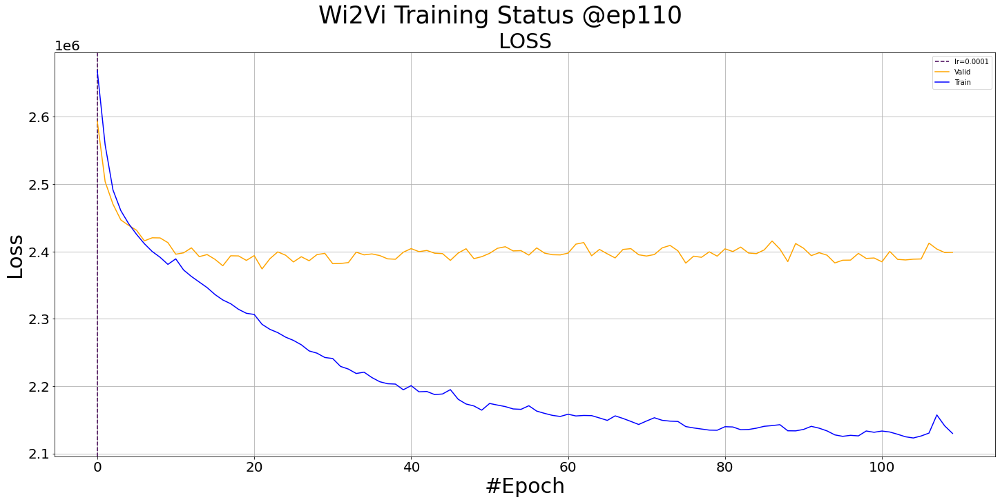

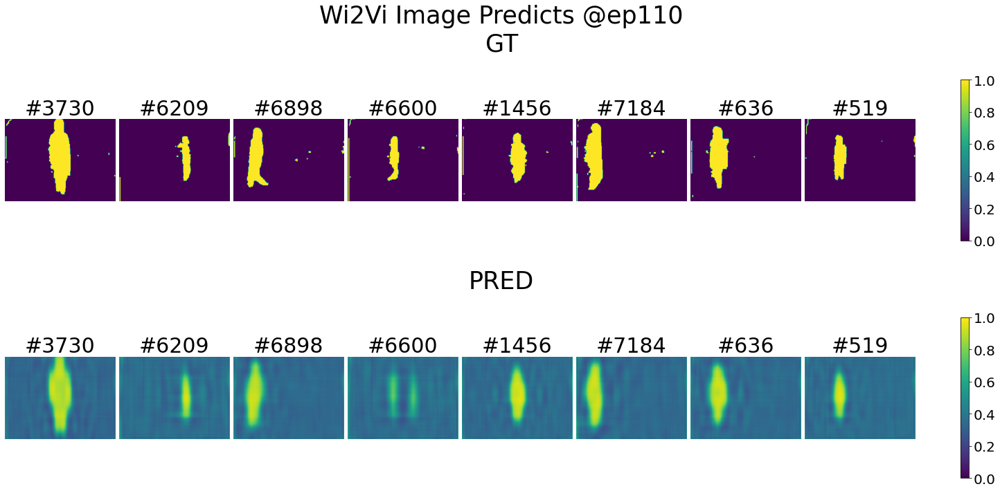

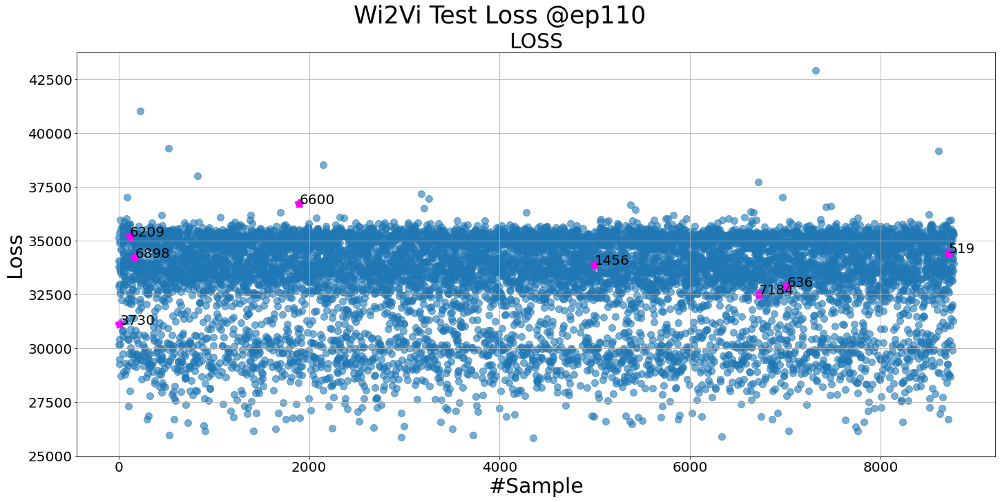

/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


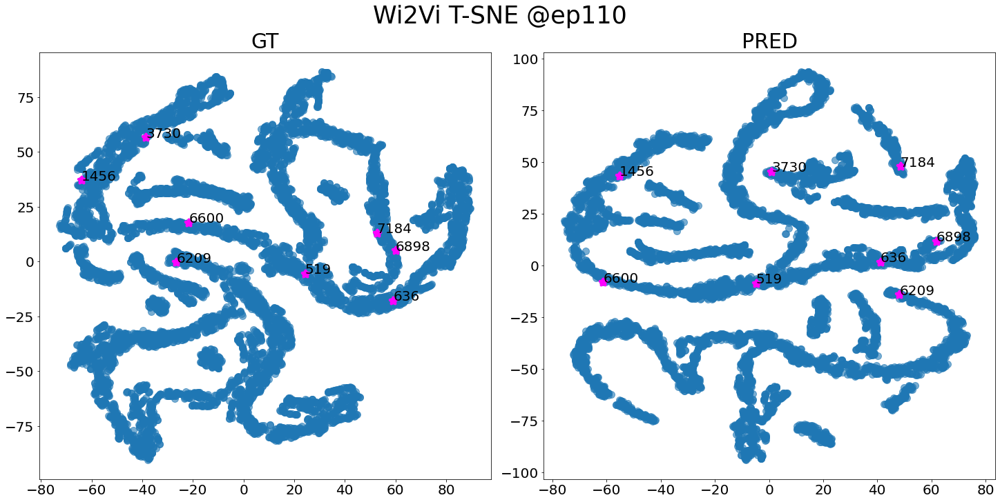

Wi2Vi valid: epoch=9/10, batch=15/17, current best valid loss=2327704.5000        =2327704.5000    
Total training time: 294.22368144989014 sec
Wi2Vi test: sample=135/137, loss=35234.5000    
Test finished. Average loss={'LOSS': 33111.06299117708}

Total training time: 58.060253620147705 sec


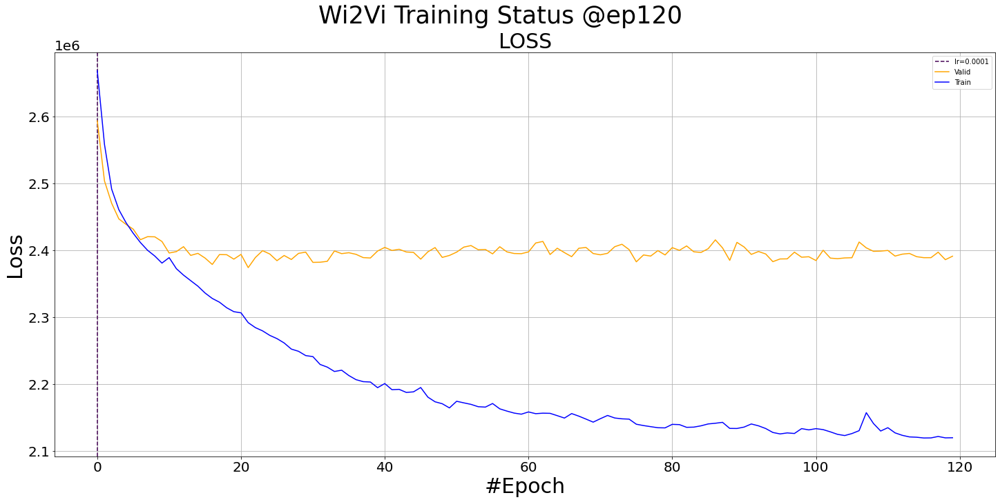

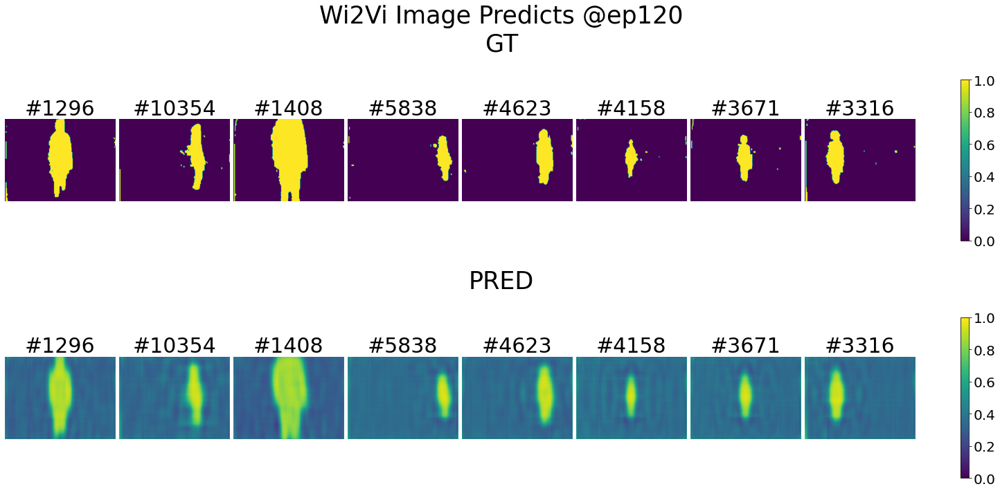

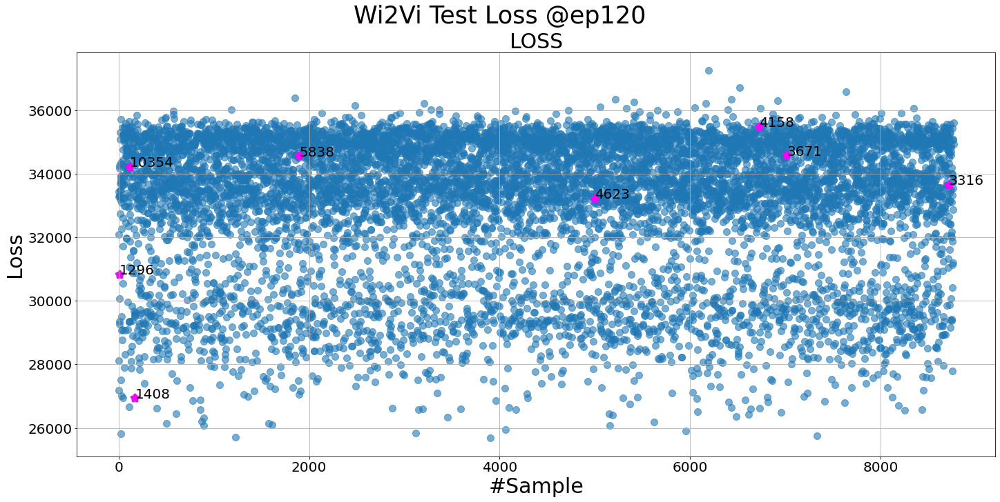

/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


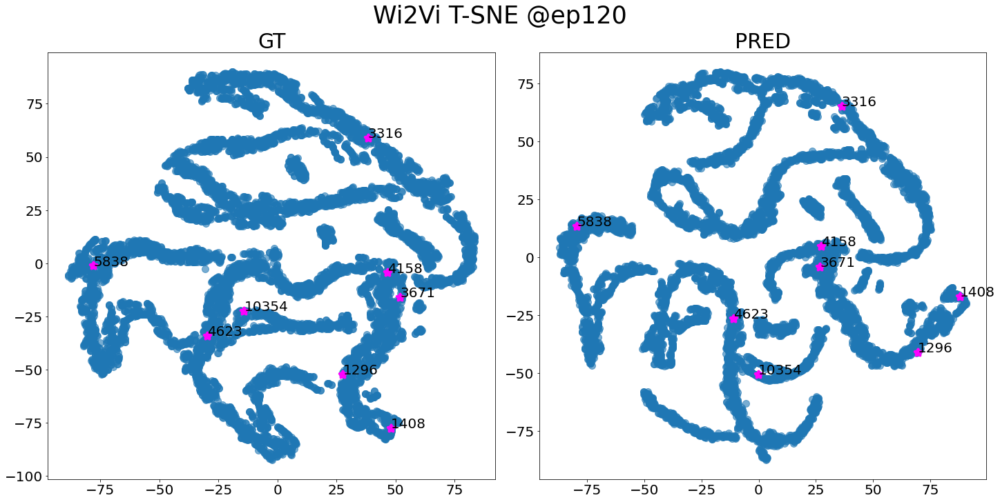

Wi2Vi valid: epoch=9/10, batch=15/17, current best valid loss=2327704.5000        =2327704.5000    
Total training time: 301.8362030982971 sec
Wi2Vi test: sample=135/137, loss=60205.3438    
Test finished. Average loss={'LOSS': 33972.713142116576}

Total training time: 62.192837715148926 sec


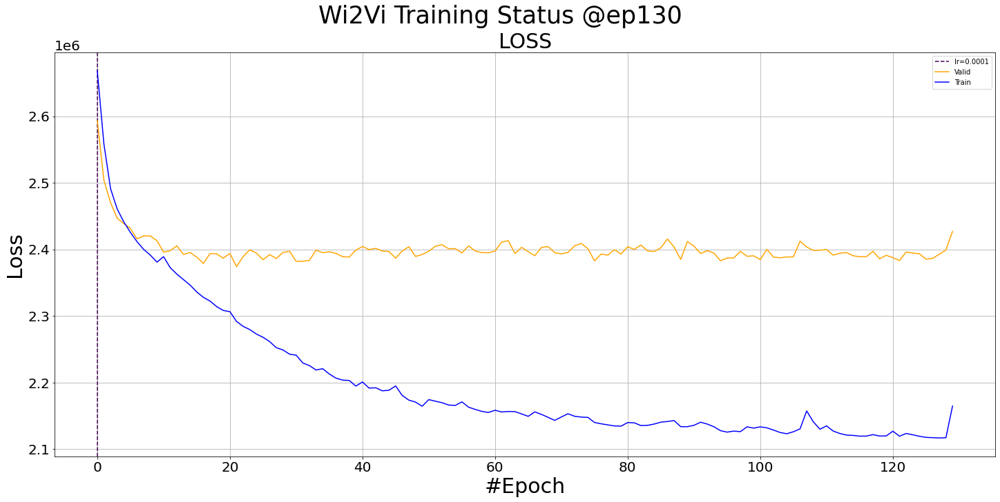

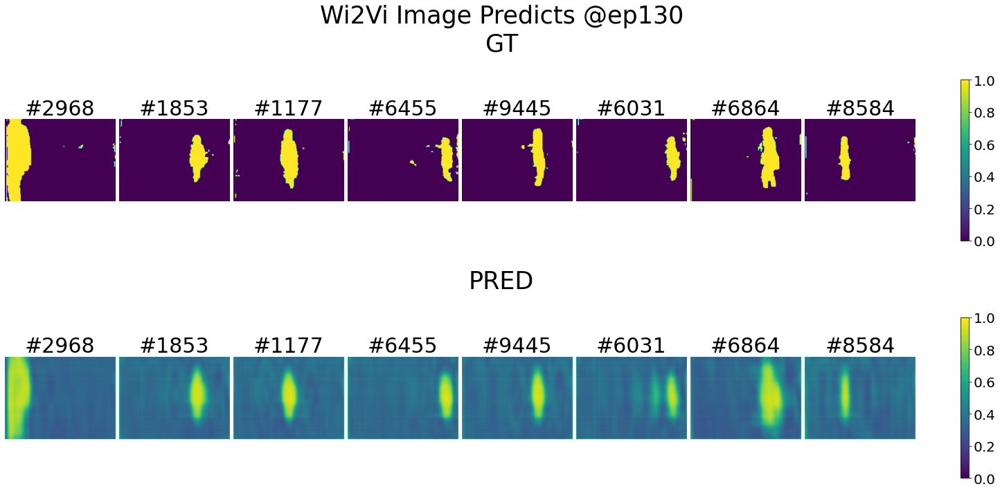

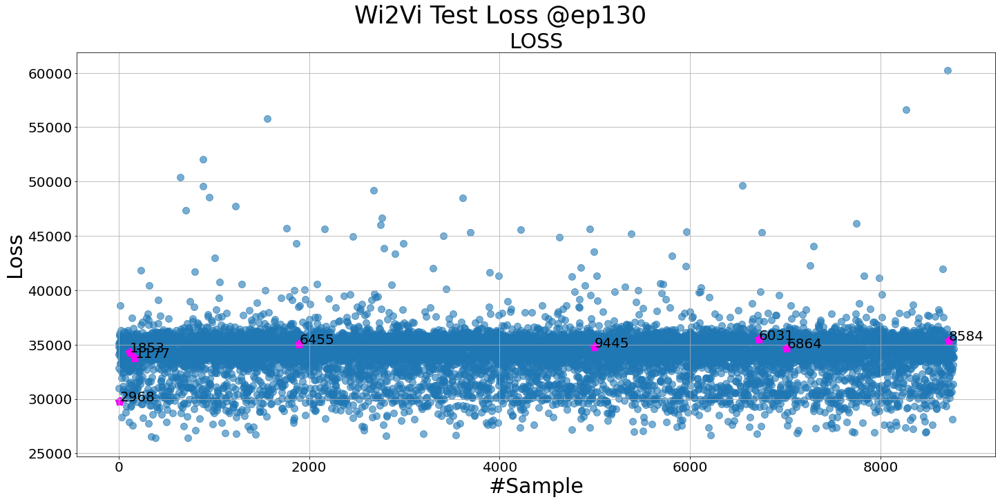

/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


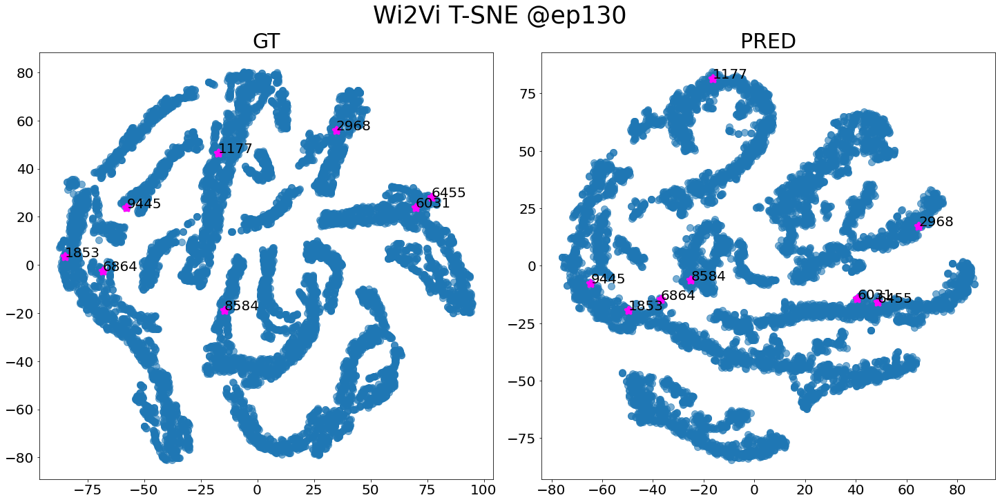

Wi2Vi valid: epoch=9/10, batch=15/17, current best valid loss=2327704.5000        =2327704.5000    
Total training time: 294.19959473609924 sec
Wi2Vi test: sample=135/137, loss=34164.9297    
Test finished. Average loss={'LOSS': 33067.185162843576}

Total training time: 58.71358847618103 sec


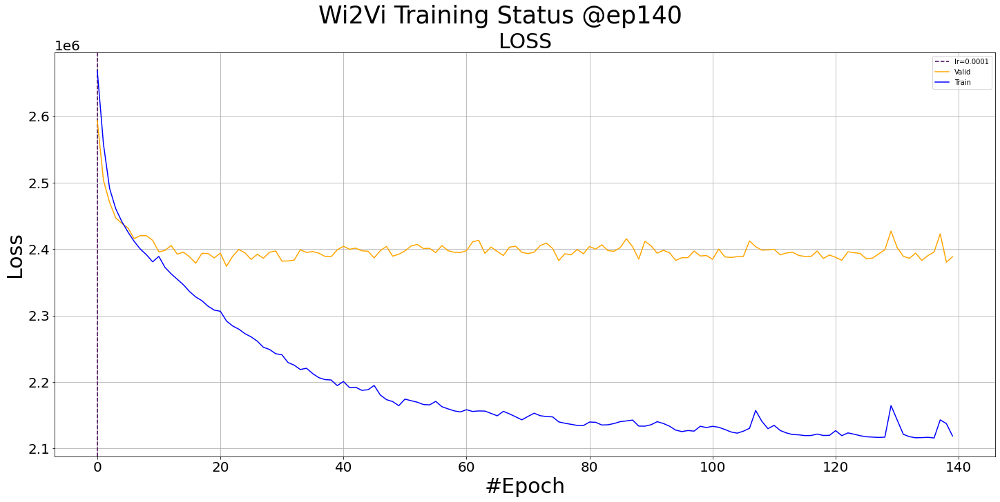

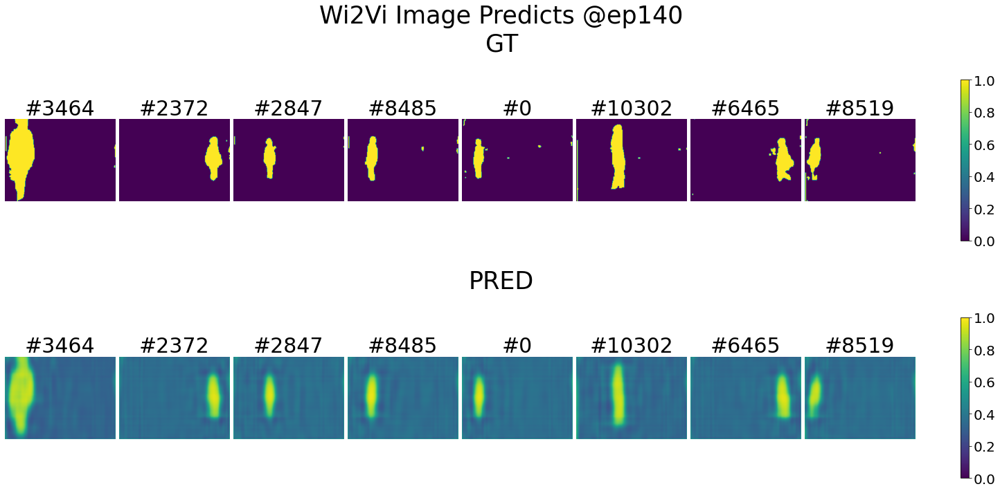

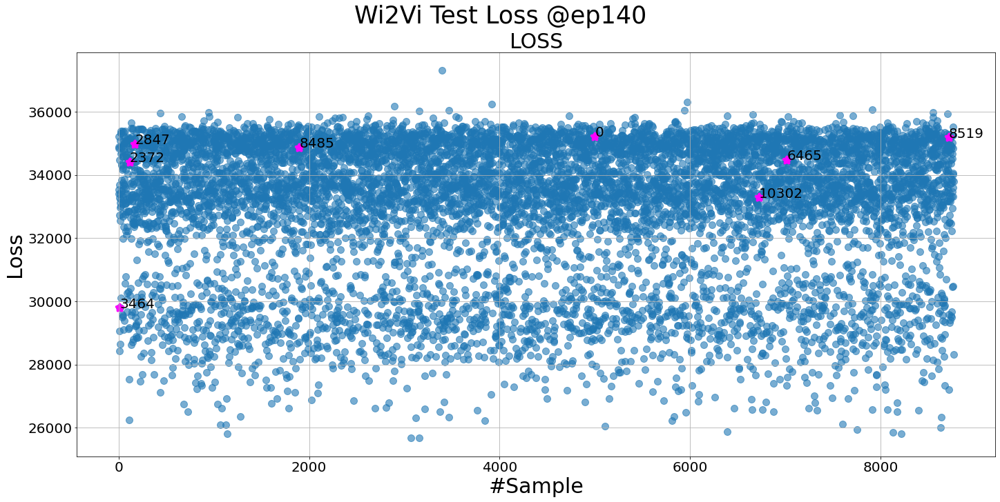

/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


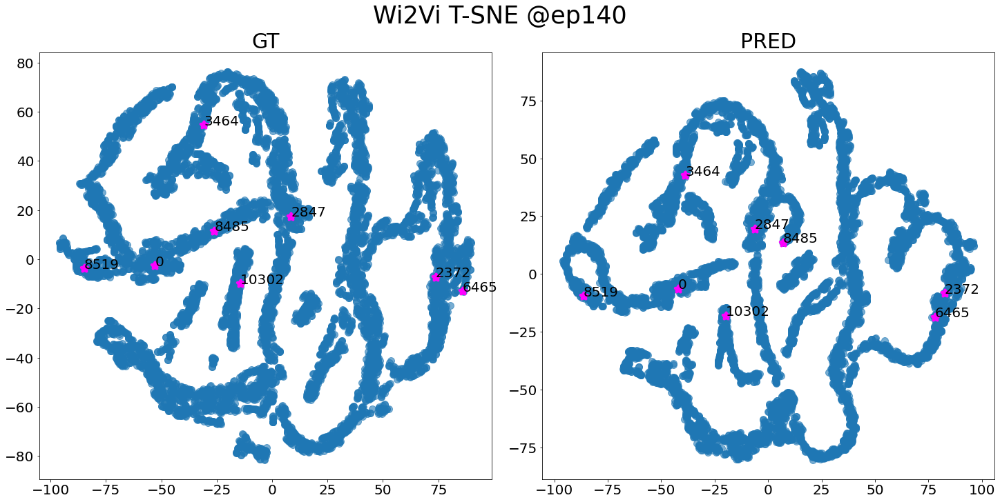

Wi2Vi valid: epoch=9/10, batch=15/17, current best valid loss=2327704.5000        =2327704.5000    
Total training time: 288.9649176597595 sec
Wi2Vi test: sample=135/137, loss=34427.3633    
Test finished. Average loss={'LOSS': 33014.82299225522}

Total training time: 63.71905255317688 sec


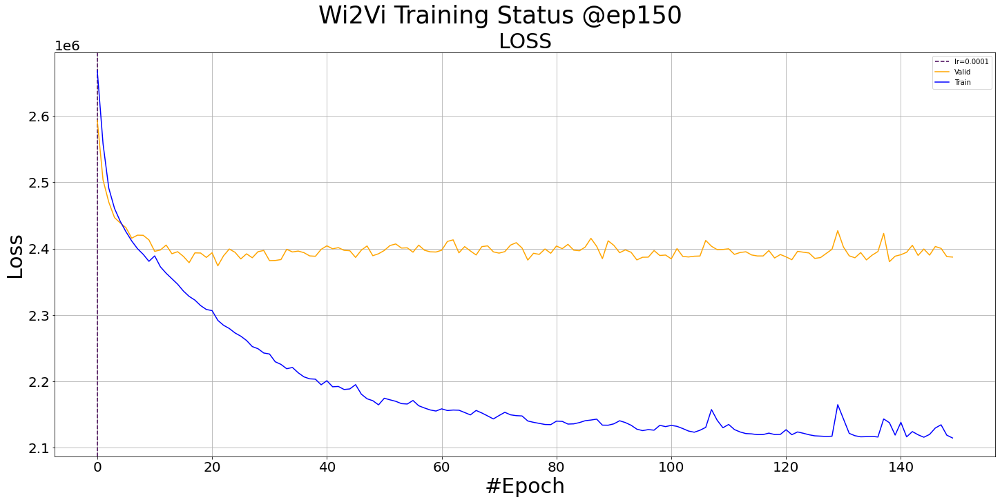

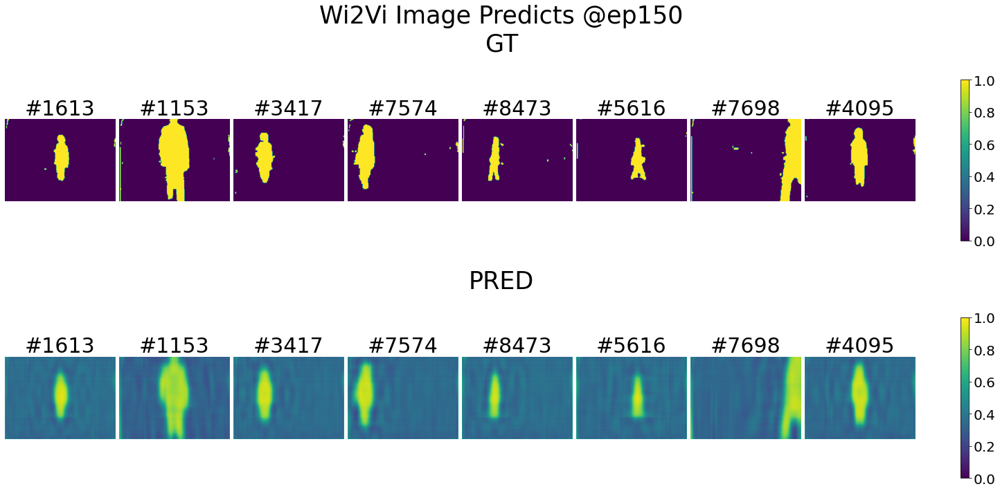

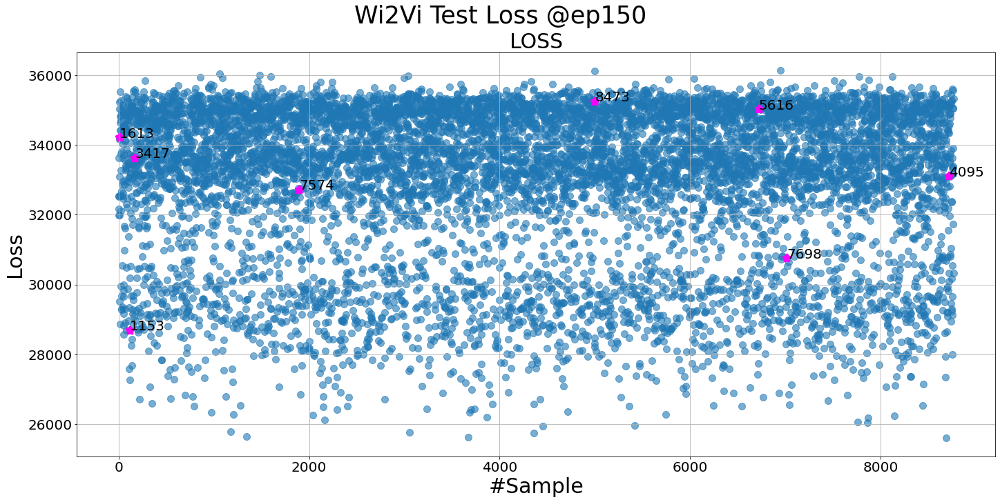

/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


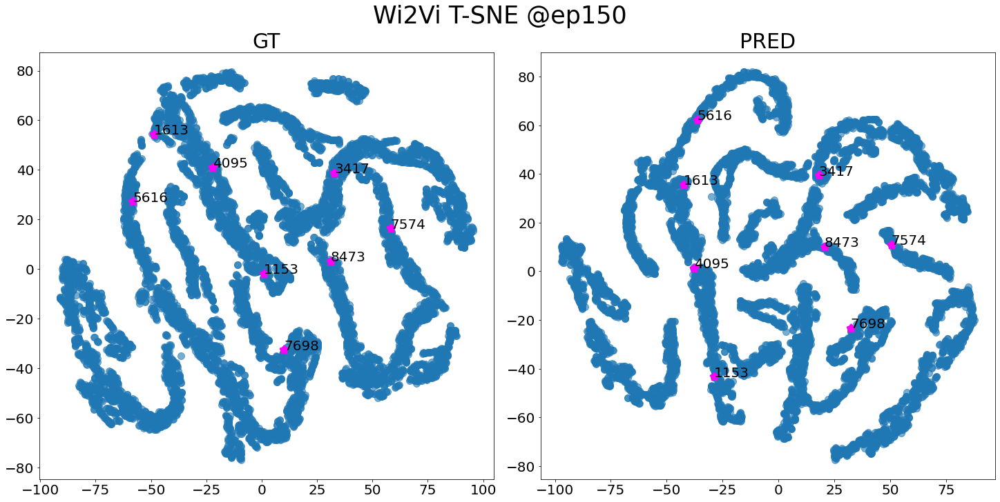

Wi2Vi valid: epoch=9/10, batch=15/17, current best valid loss=2327704.5000        =2327704.5000    
Total training time: 294.2886641025543 sec
Wi2Vi test: sample=135/137, loss=34792.2227    
Test finished. Average loss={'LOSS': 33017.36884569599}

Total training time: 60.514201641082764 sec


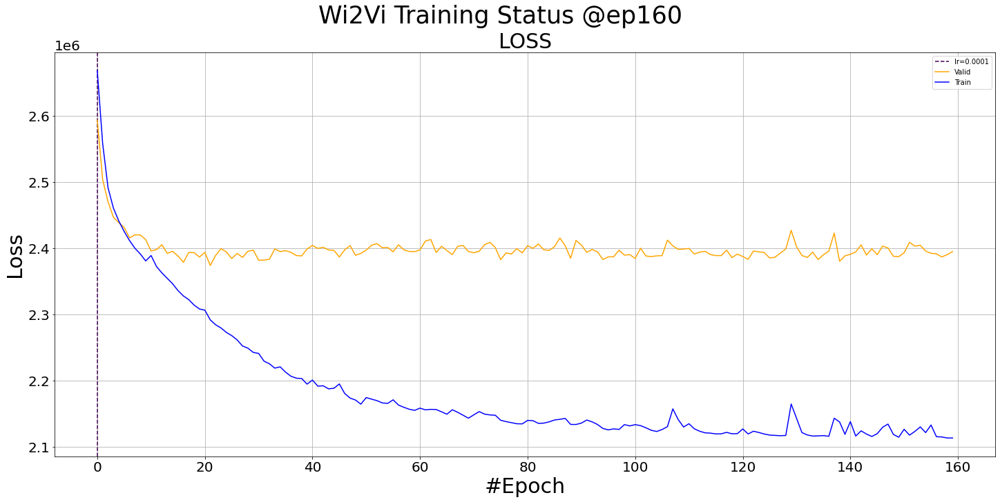

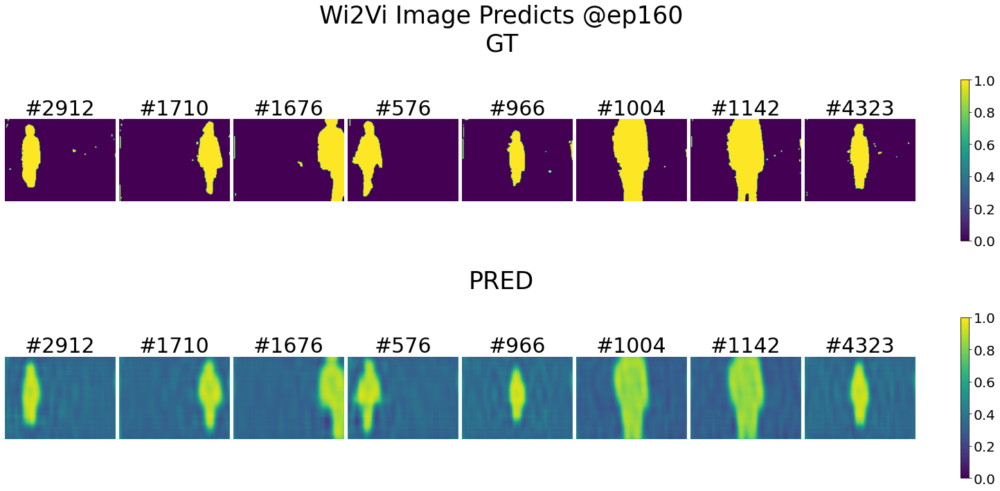

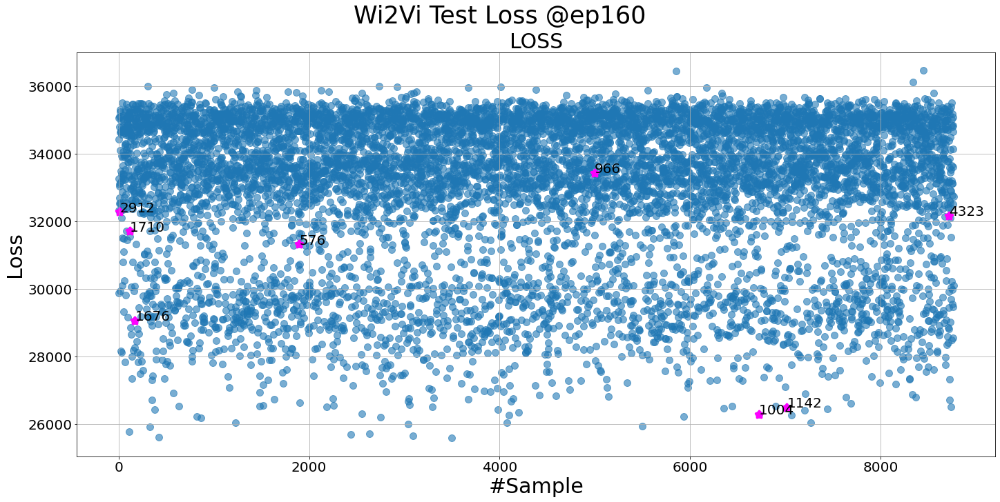

/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


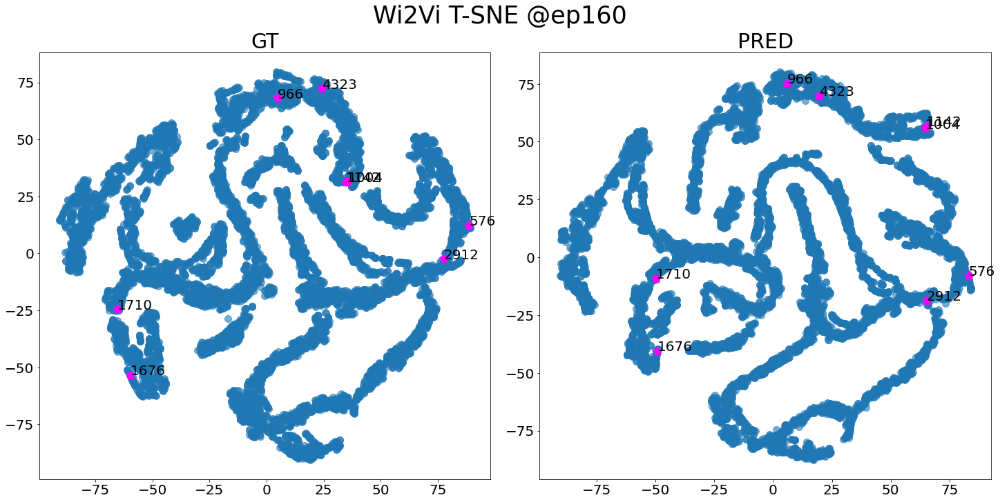

Wi2Vi valid: epoch=9/10, batch=15/17, current best valid loss=2327704.5000        =2327704.5000    
Total training time: 287.27936029434204 sec
Wi2Vi test: sample=135/137, loss=32067.9375    
Test finished. Average loss={'LOSS': 33220.16931620132}

Total training time: 58.7569260597229 sec


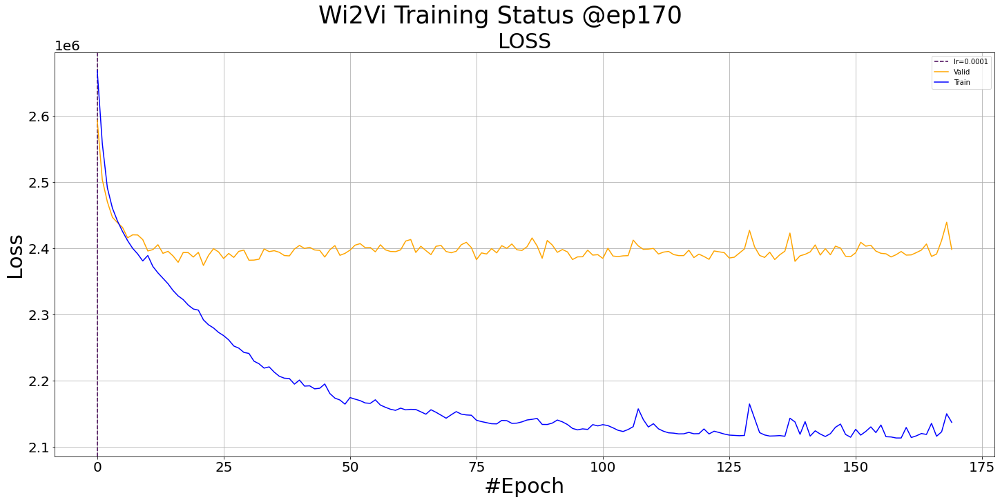

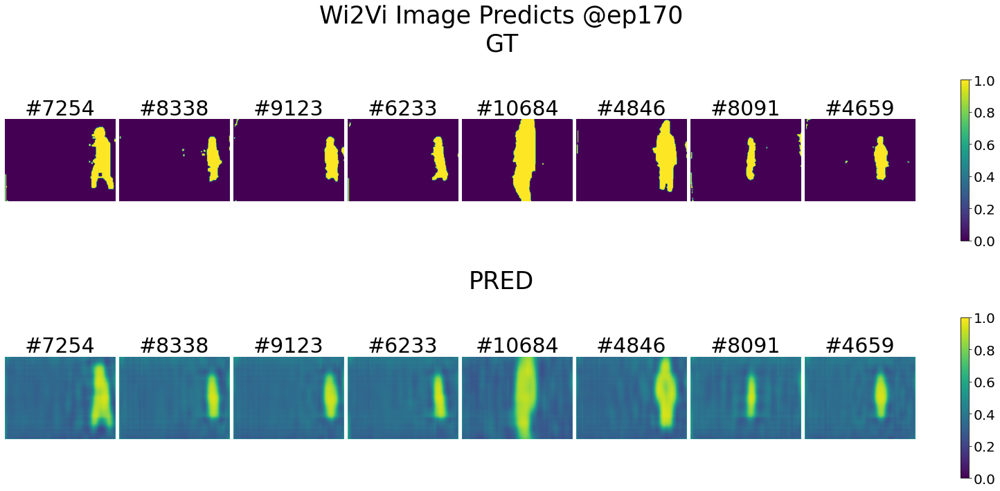

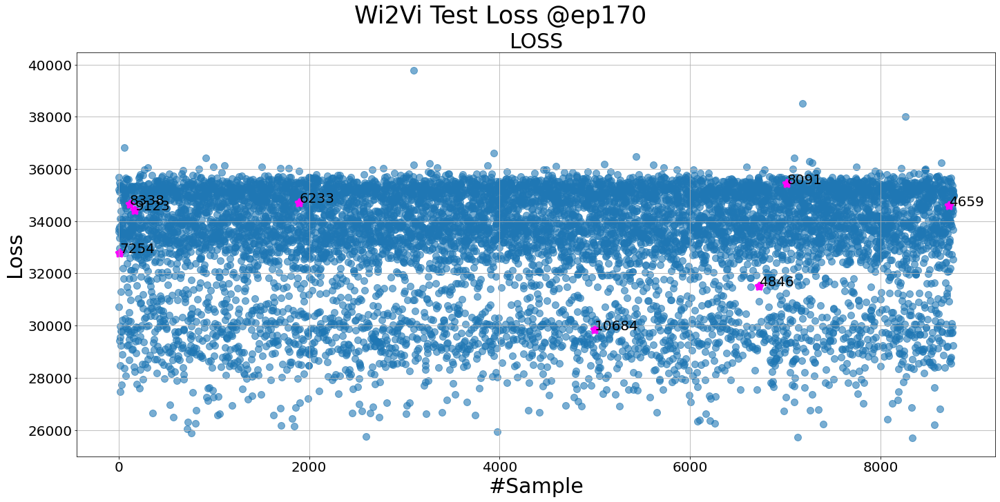

/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


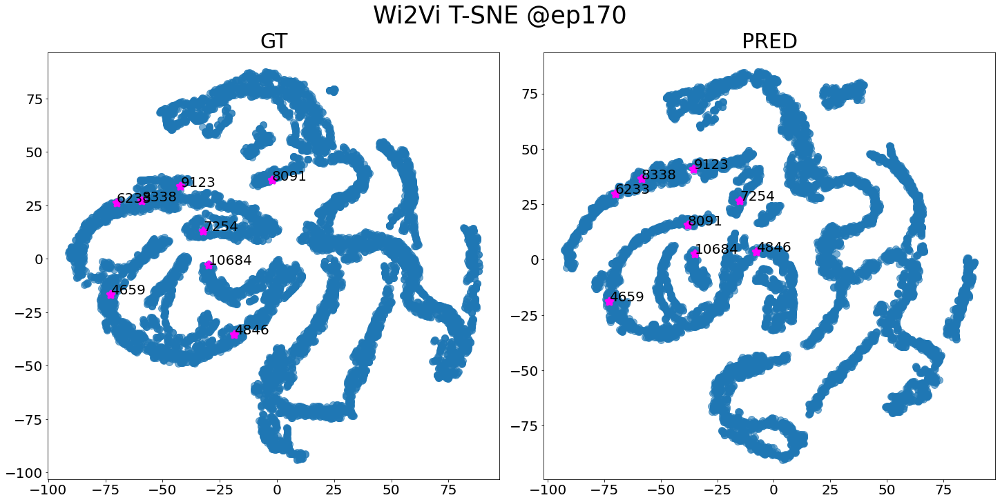

Wi2Vi valid: epoch=9/10, batch=15/17, current best valid loss=2320011.0000        =2320011.0000    
Total training time: 293.76413226127625 sec
Wi2Vi test: sample=135/137, loss=33945.1836    
Test finished. Average loss={'LOSS': 33061.55813732286}

Total training time: 59.366150856018066 sec


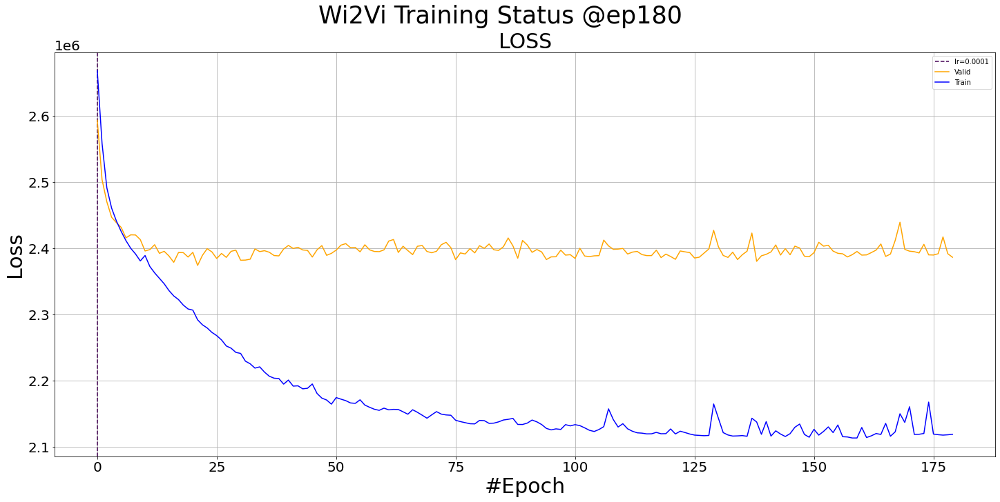

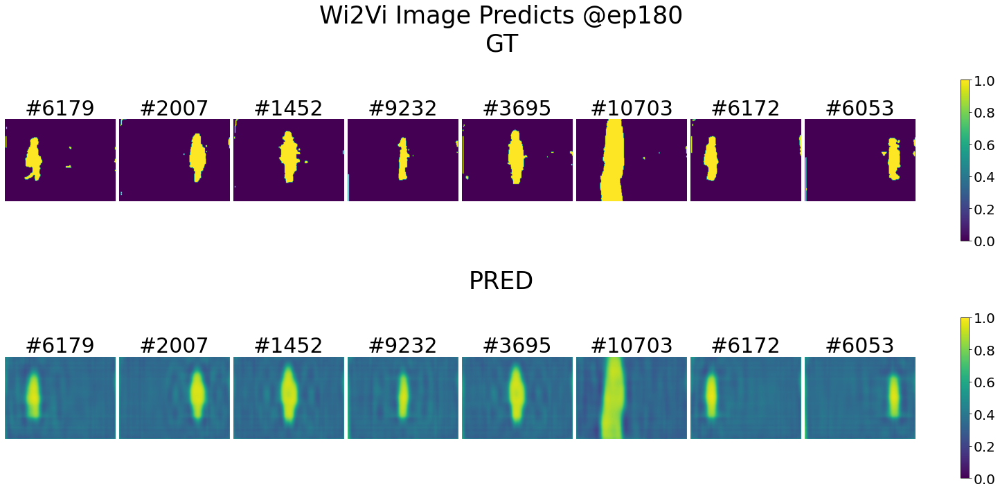

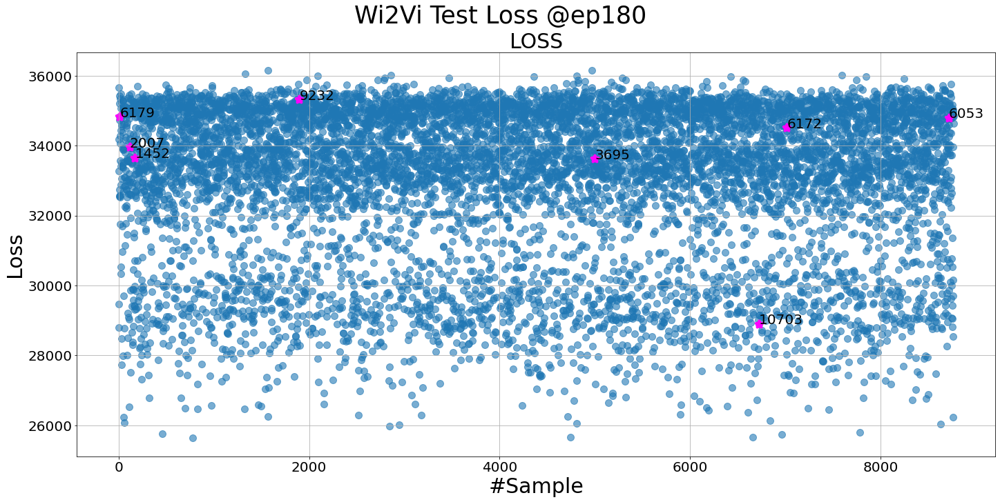

/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


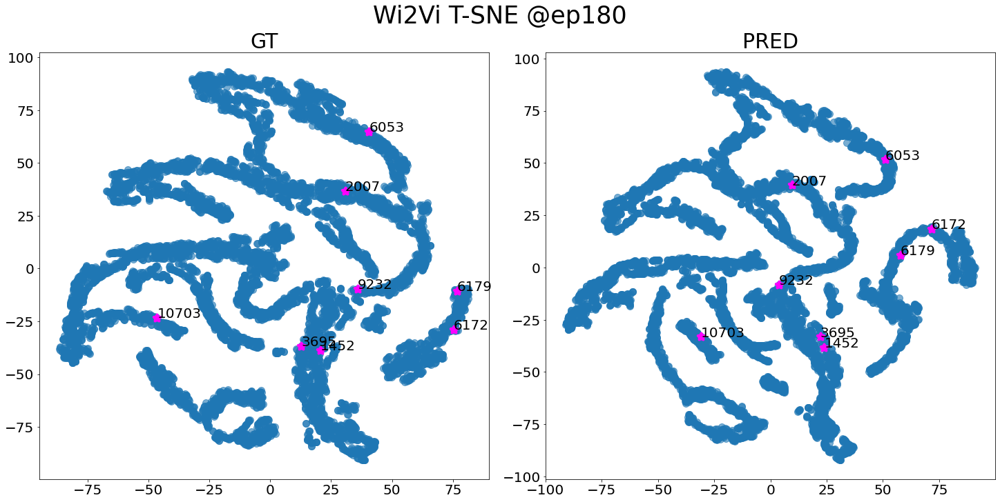

Wi2Vi valid: epoch=9/10, batch=15/17, current best valid loss=2320011.0000        =2320011.0000    
Total training time: 287.44704389572144 sec
Wi2Vi test: sample=135/137, loss=31243.8711    
Test finished. Average loss={'LOSS': 33239.92750181769}

Total training time: 56.14494562149048 sec


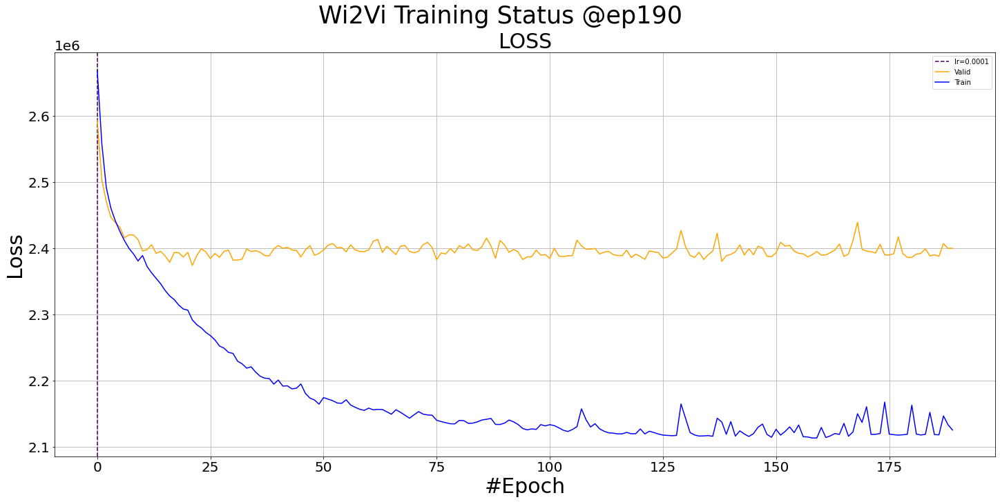

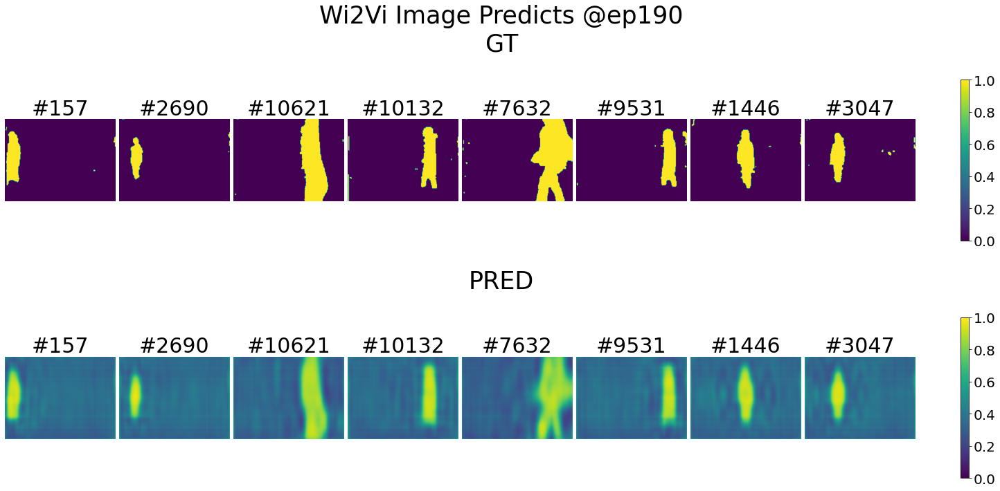

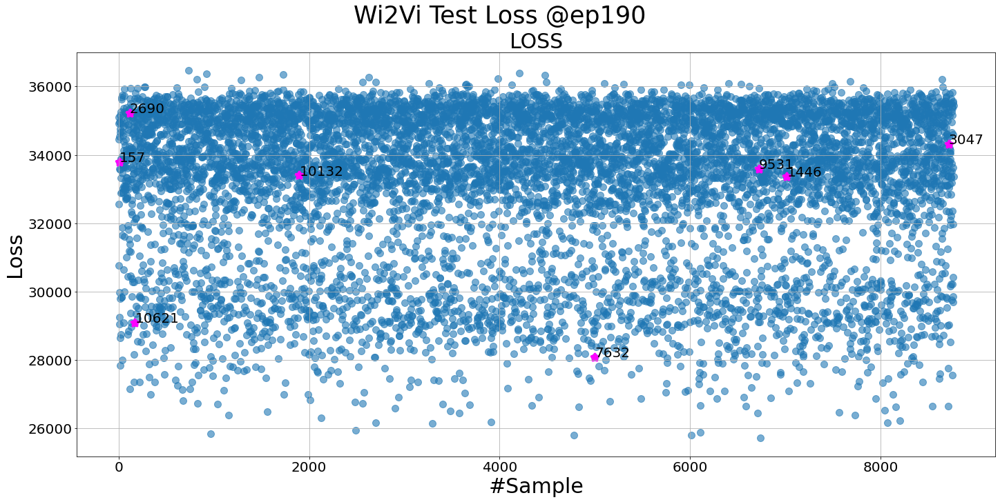

/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


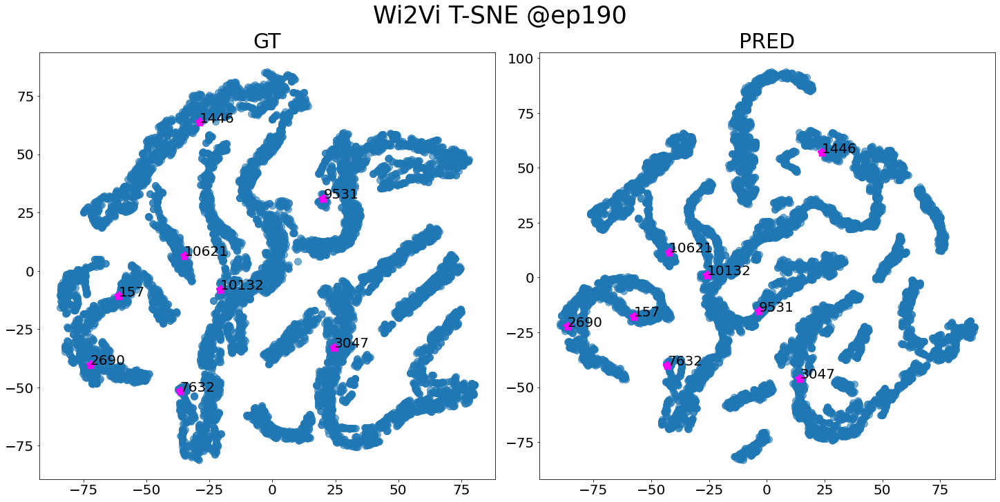

Wi2Vi valid: epoch=9/10, batch=15/17, current best valid loss=2320011.0000        =2320011.0000    
Total training time: 282.7431478500366 sec
Wi2Vi test: sample=135/137, loss=34760.0625    
Test finished. Average loss={'LOSS': 33596.33392400811}

Total training time: 54.866995334625244 sec


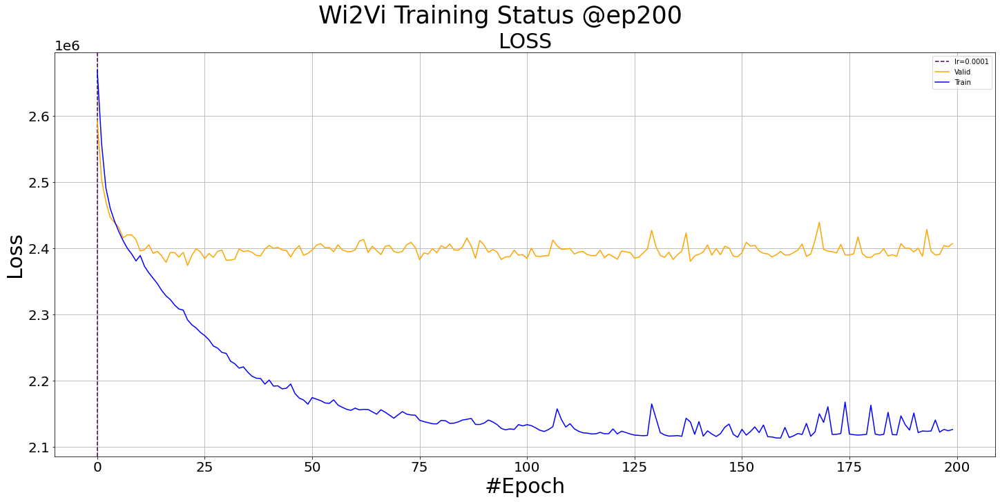

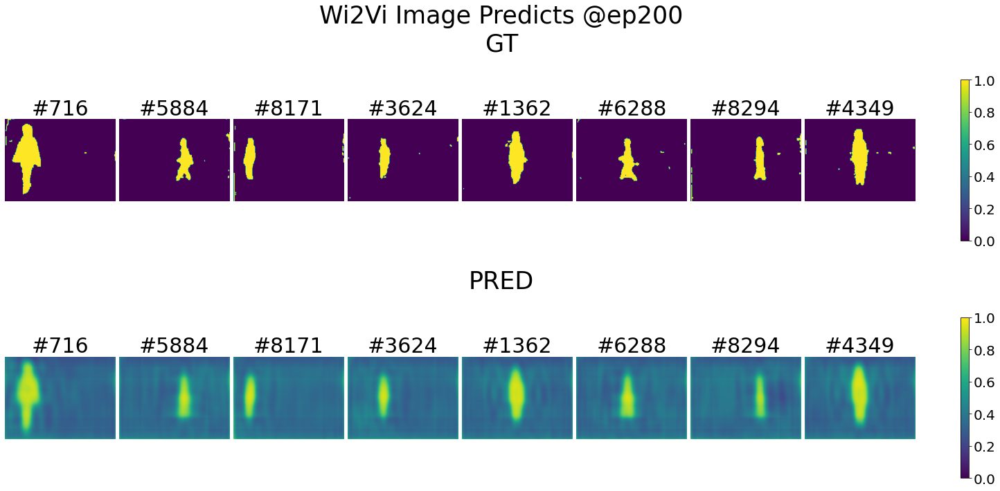

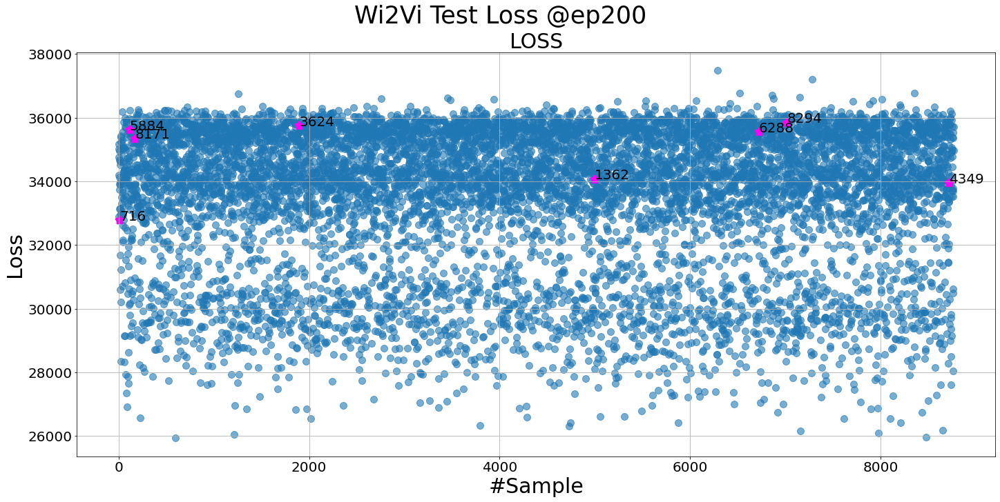

/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


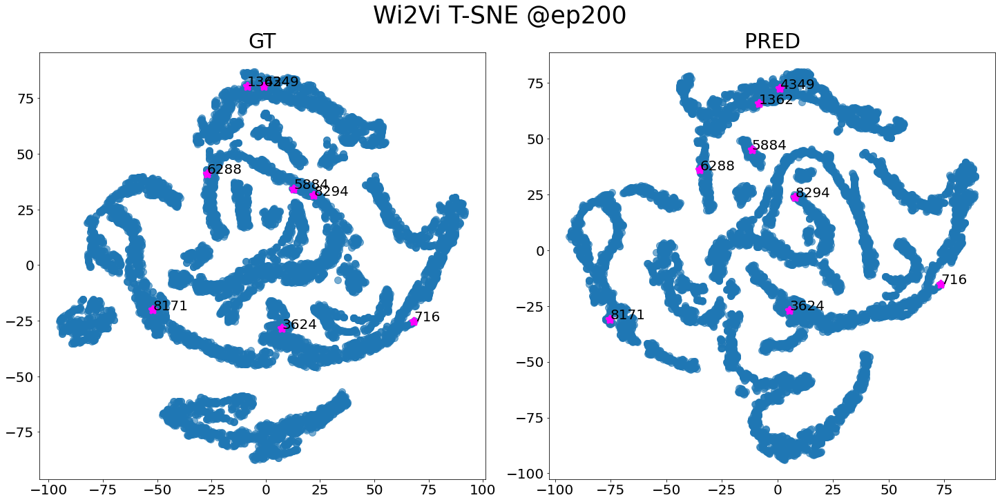


Schedule Completed!


In [7]:
# Training and Testing
%matplotlib inline
trainer_wi2vi.scheduler(turns=10,
                  test_loader='train', select_num=8,
                  autosave=True, notion='240301R1Wi2Vi', save_model=False)

Wi2Vi test: sample=1095/1099, loss=48622.4922    
Test finished. Average loss={'LOSS': 37996.057443912076}

Total training time: 11.978349208831787 sec


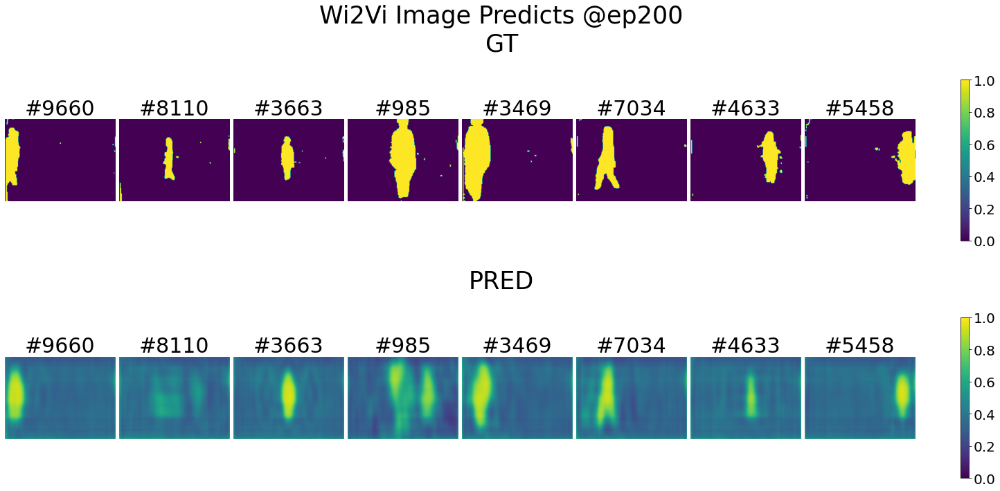

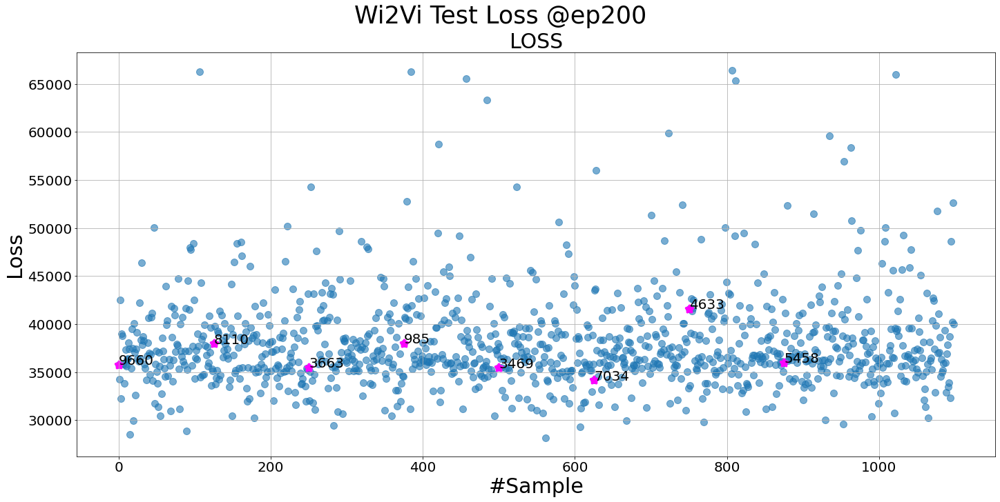

/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/bob/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


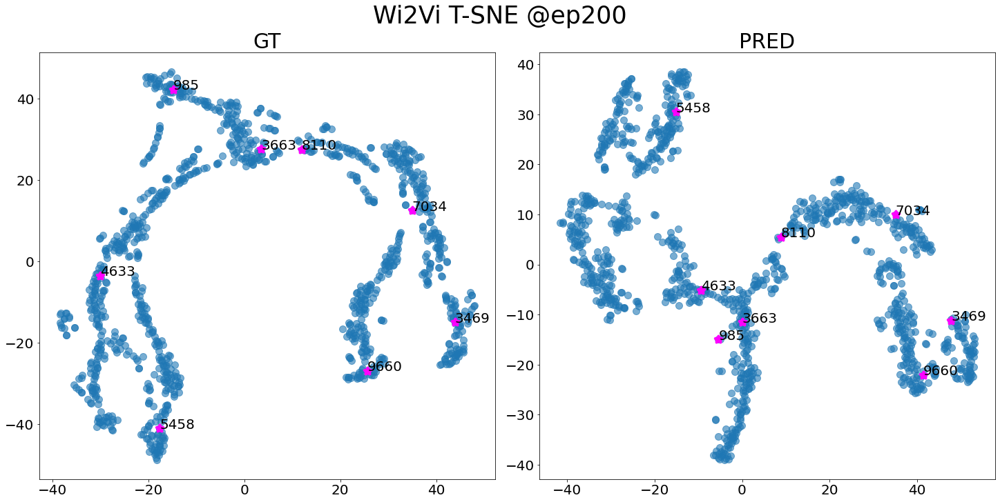

In [10]:
trainer_wi2vi.test(mode='test')
trainer_wi2vi.plot_test(select_ind=[0, 125,250,375,500,625,750,875],select_num=8, autosave=True, notion='240301R1Wi2Vi_test')

In [11]:
trainer_wi2vi.save('240301R1Wi2Vi')

Saving models...
Saving wi2vi...
All saved!


### AutoEncoder

In [5]:
torch.cuda.set_device(gpu)
ae = TP.AutoEncoder(latent_dim=16)
trainer_ae = TP.CompTrainer(name='AE', mode='ae', mask=False,
                              networks=[ae],
                 lr=1e-4, epochs=10, cuda=gpu,
                 train_loader=train_loader, valid_loader=valid_loader, test_loader=test_loader)

AE valid: epoch=9/10, batch=15/17, current best valid loss=0.0250        .0250    
Total training time: 34.3249146938324 sec
AE test: sample=15/17, loss=0.0238    
Test finished. Average loss={'LOSS': 0.01221420357700588}

Total training time: 2.742611885070801 sec


<Figure size 432x288 with 0 Axes>

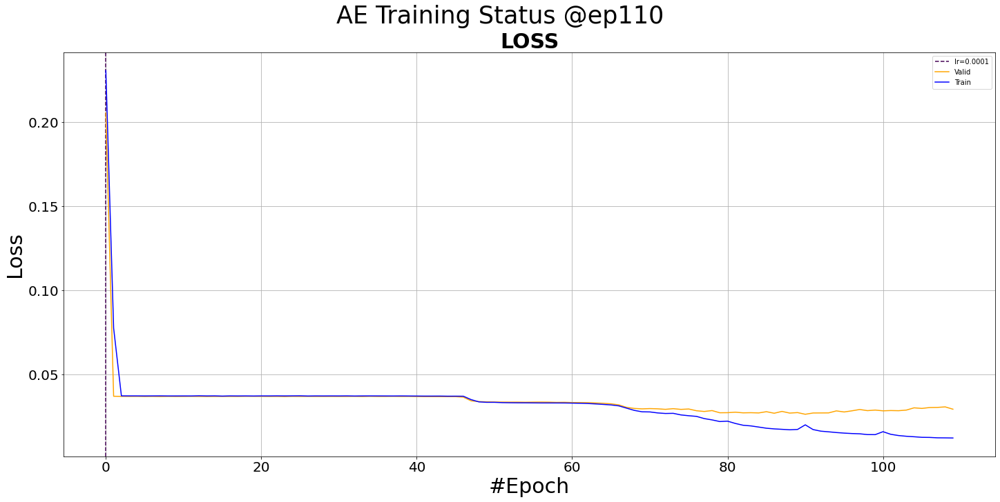

<Figure size 1440x720 with 0 Axes>

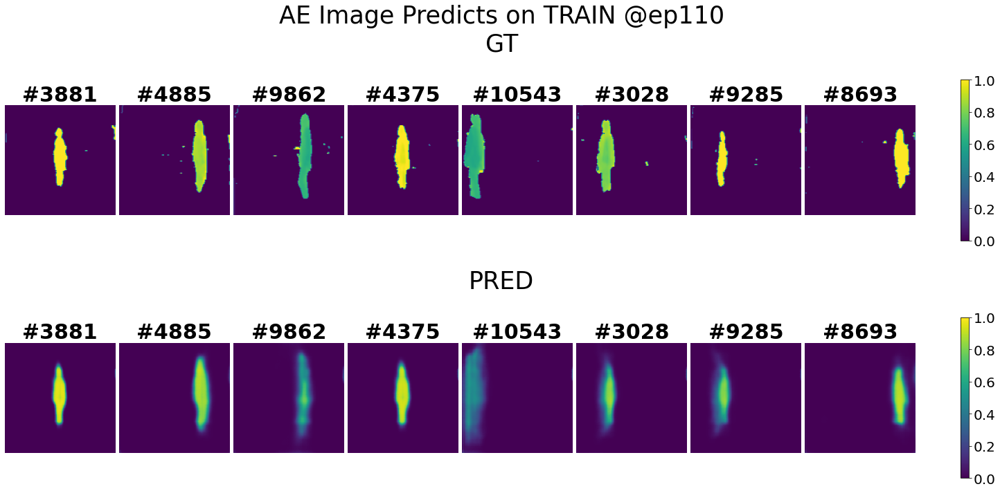

<Figure size 1440x720 with 0 Axes>

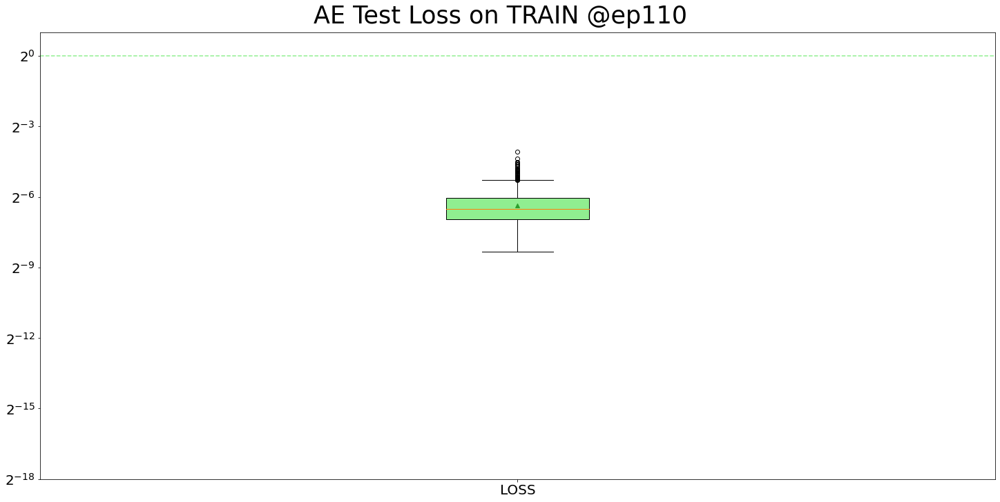

<Figure size 1440x720 with 0 Axes>

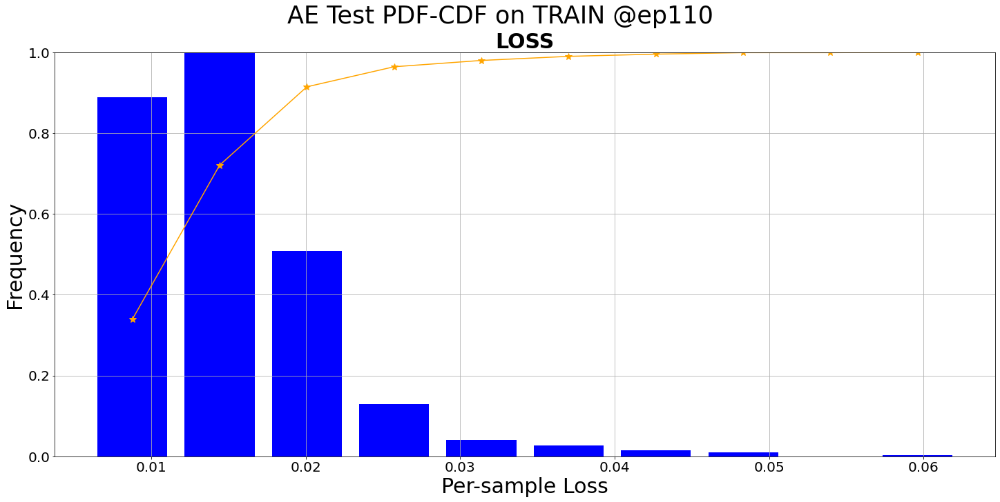

<Figure size 1440x720 with 0 Axes>

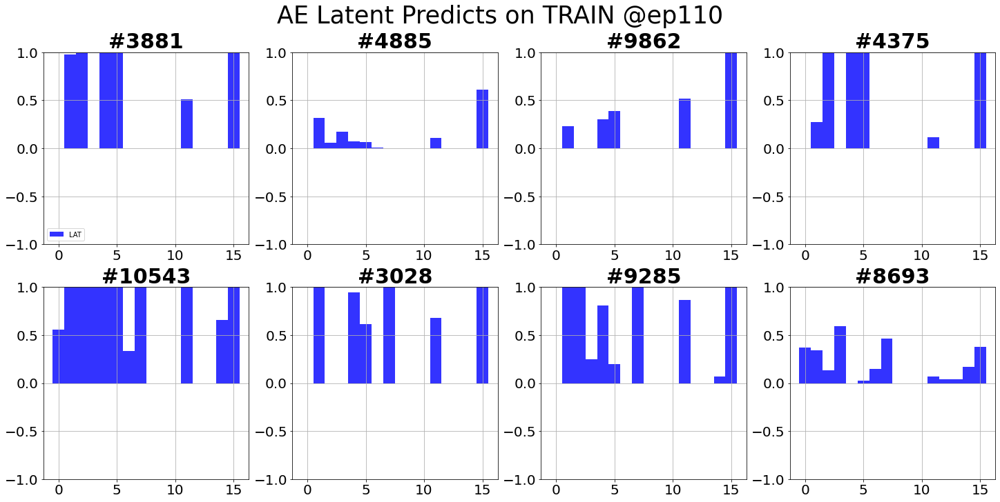

AE valid: epoch=9/10, batch=15/17, current best valid loss=0.0250        .0250    
Total training time: 35.91457533836365 sec
AE test: sample=15/17, loss=0.0065    
Test finished. Average loss={'LOSS': 0.010336766175896628}

Total training time: 2.8458516597747803 sec


<Figure size 1440x720 with 0 Axes>

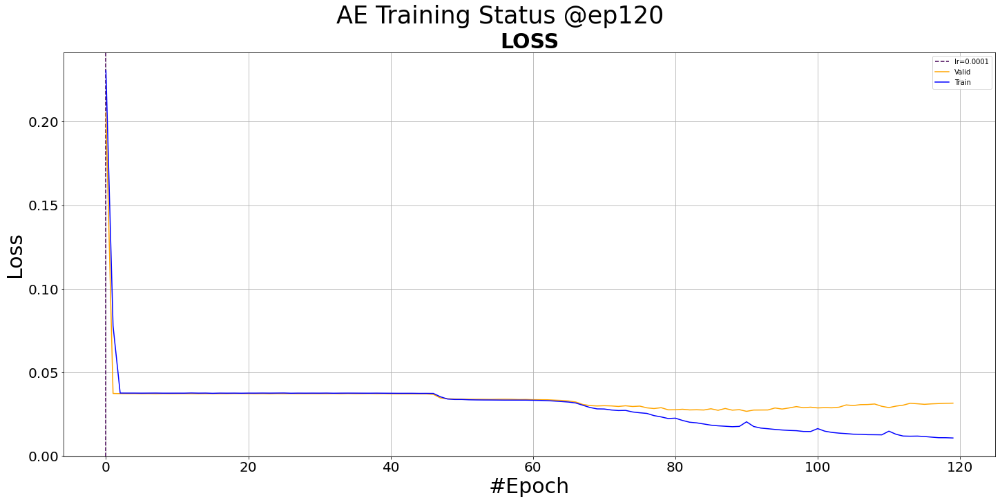

<Figure size 1440x720 with 0 Axes>

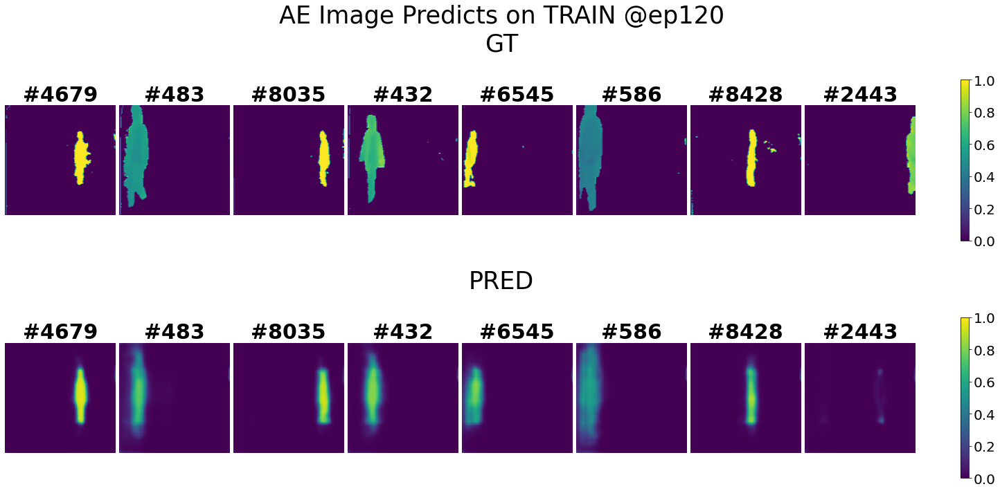

<Figure size 1440x720 with 0 Axes>

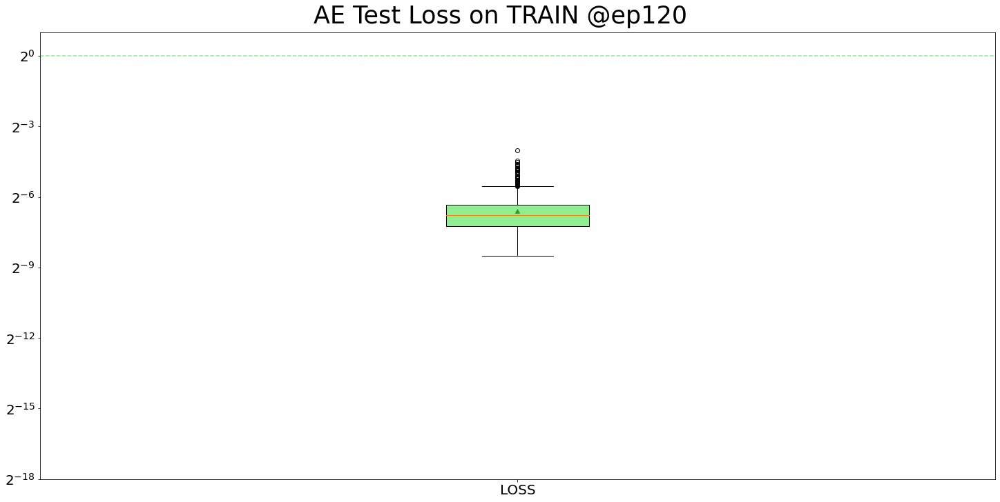

<Figure size 1440x720 with 0 Axes>

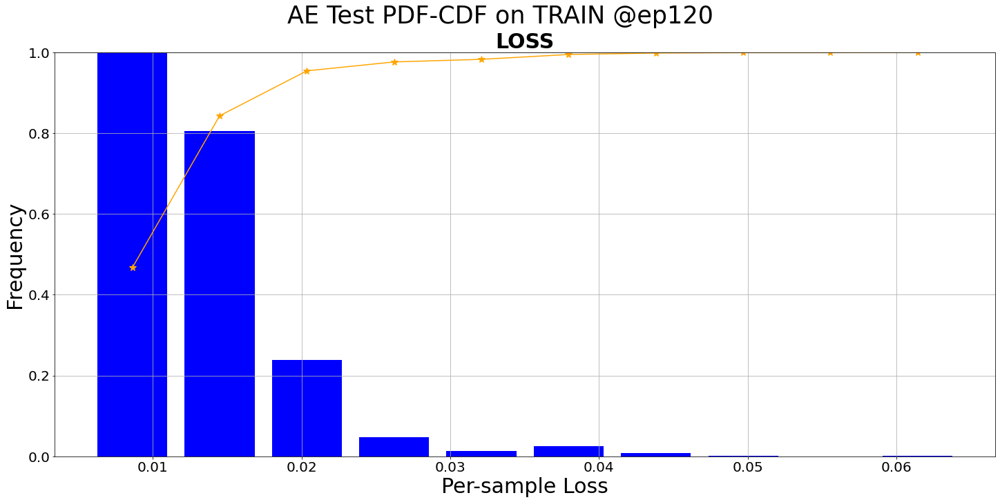

<Figure size 1440x720 with 0 Axes>

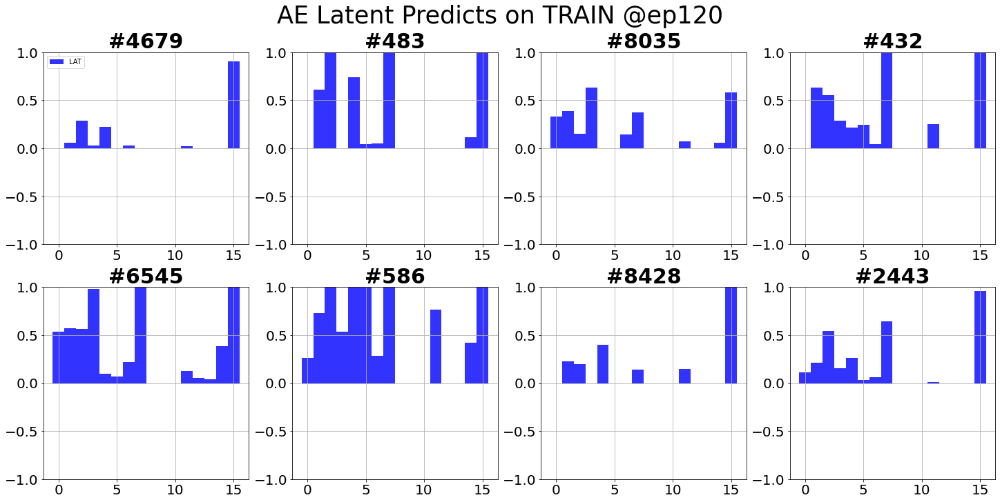

AE valid: epoch=9/10, batch=15/17, current best valid loss=0.0250        .0250    
Total training time: 32.26112651824951 sec
AE test: sample=15/17, loss=0.0075    
Test finished. Average loss={'LOSS': 0.009686057272226796}

Total training time: 2.92960524559021 sec


<Figure size 1440x720 with 0 Axes>

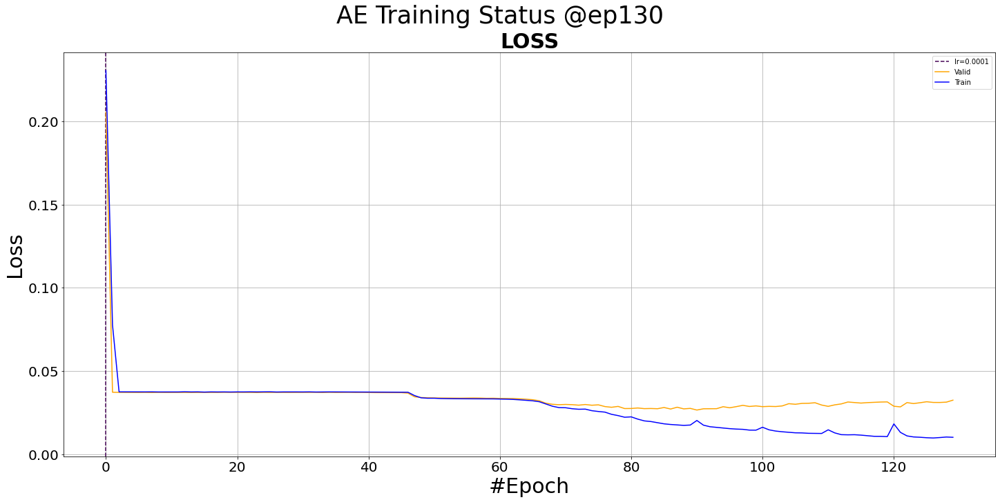

<Figure size 1440x720 with 0 Axes>

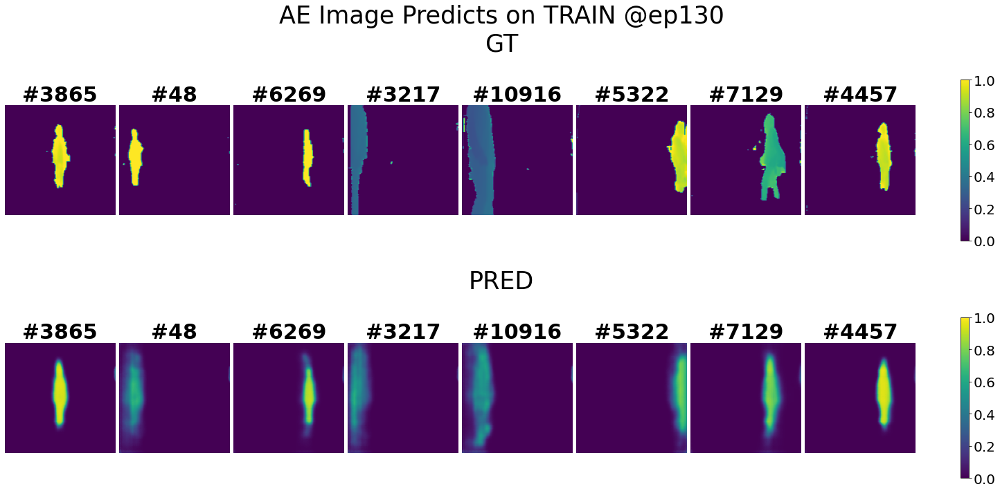

<Figure size 1440x720 with 0 Axes>

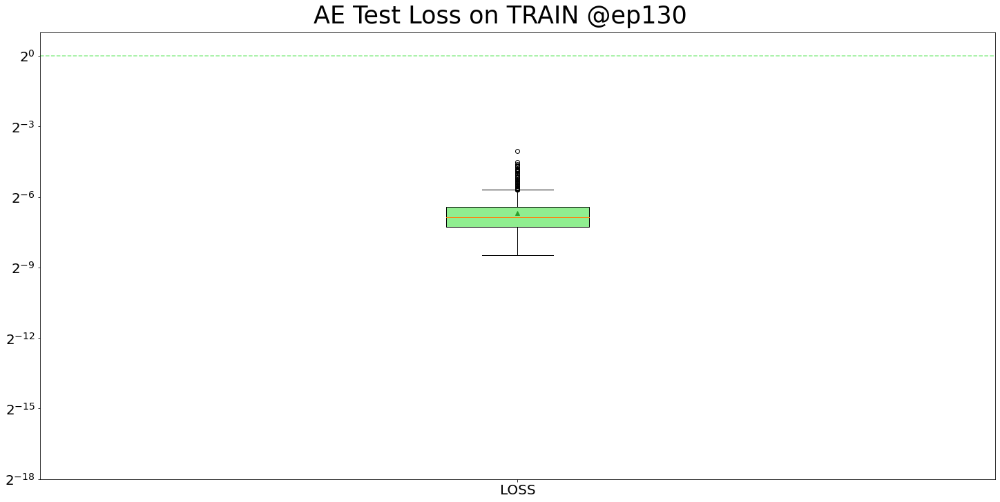

<Figure size 1440x720 with 0 Axes>

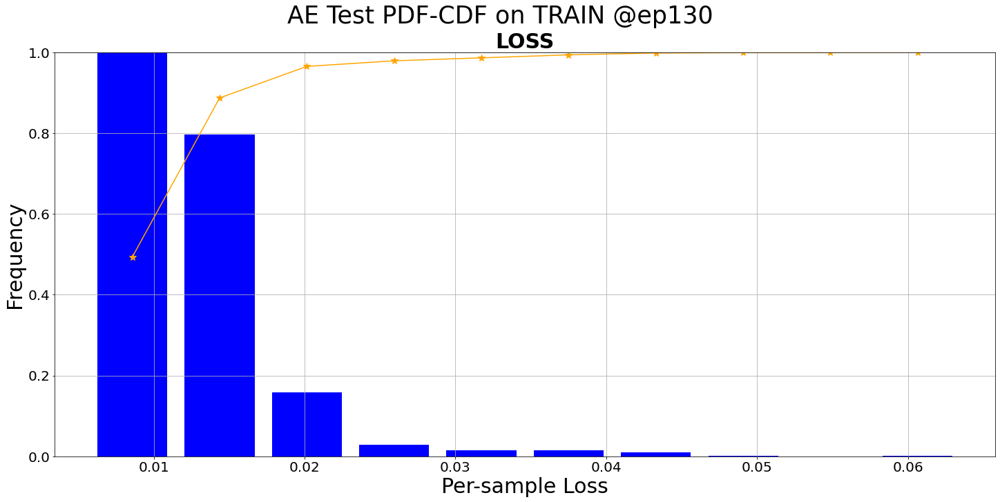

<Figure size 1440x720 with 0 Axes>

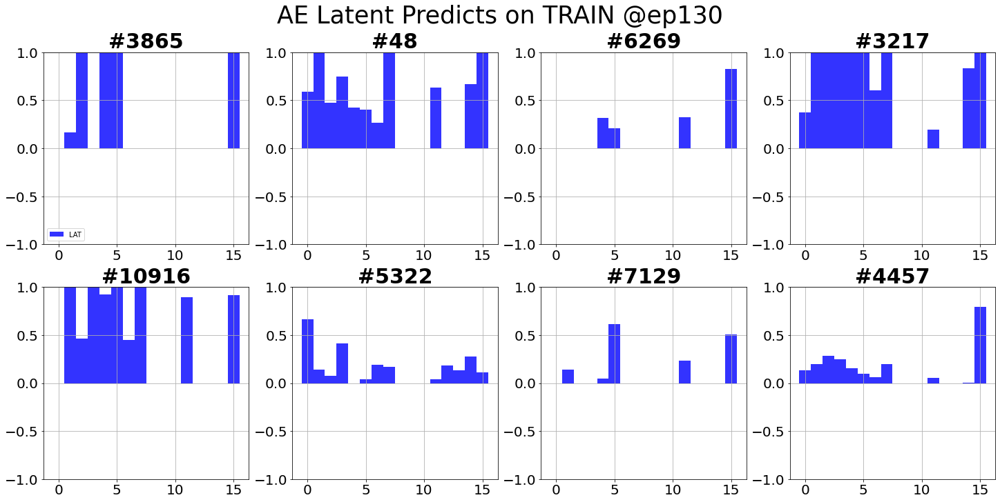

AE valid: epoch=9/10, batch=15/17, current best valid loss=0.0250        .0250    
Total training time: 31.63813352584839 sec
AE test: sample=15/17, loss=0.0292    
Test finished. Average loss={'LOSS': 0.008960469472881146}

Total training time: 3.117612838745117 sec


<Figure size 1440x720 with 0 Axes>

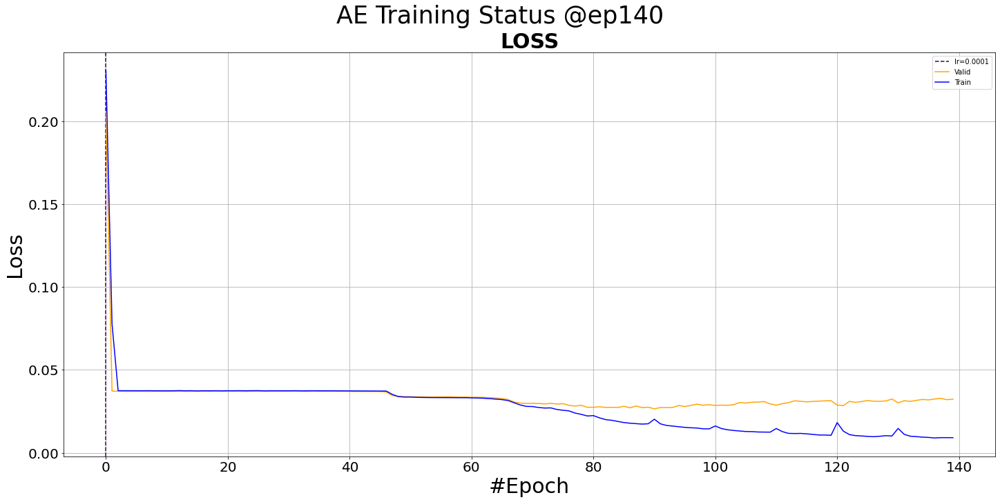

<Figure size 1440x720 with 0 Axes>

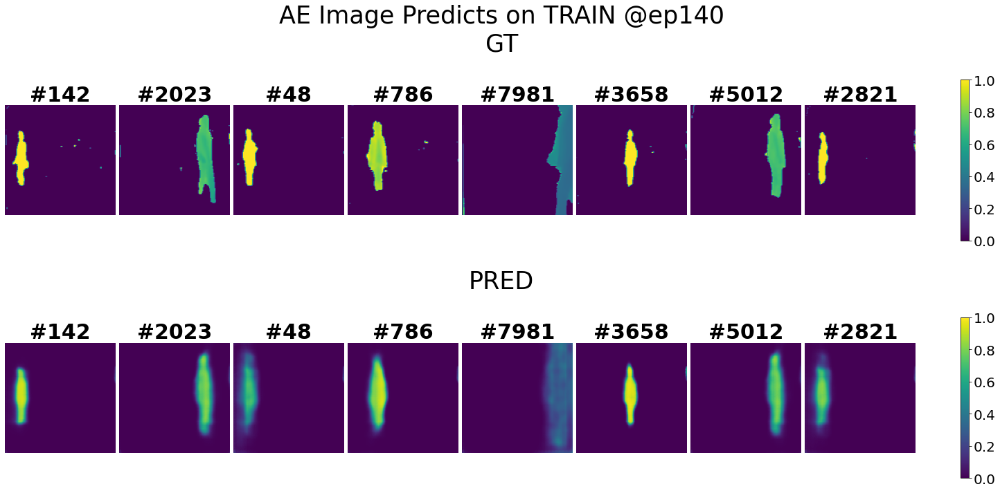

<Figure size 1440x720 with 0 Axes>

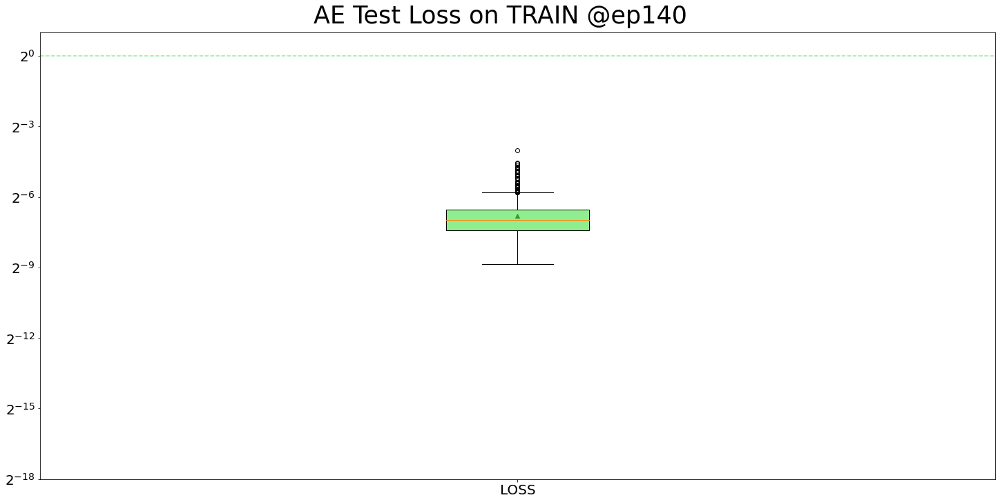

<Figure size 1440x720 with 0 Axes>

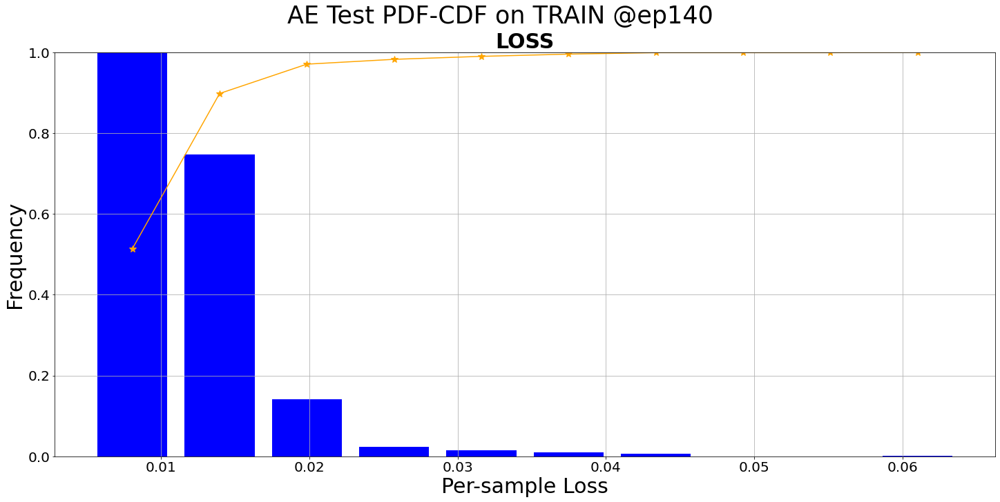

<Figure size 1440x720 with 0 Axes>

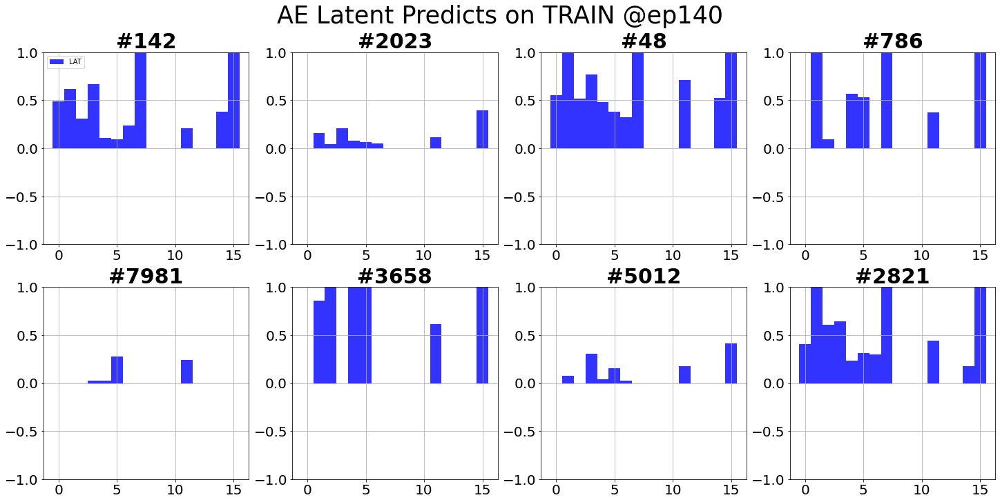

AE valid: epoch=9/10, batch=15/17, current best valid loss=0.0250        .0250    
Total training time: 35.48796844482422 sec
AE test: sample=15/17, loss=0.0048    
Test finished. Average loss={'LOSS': 0.008156313998102526}

Total training time: 2.8167929649353027 sec


<Figure size 1440x720 with 0 Axes>

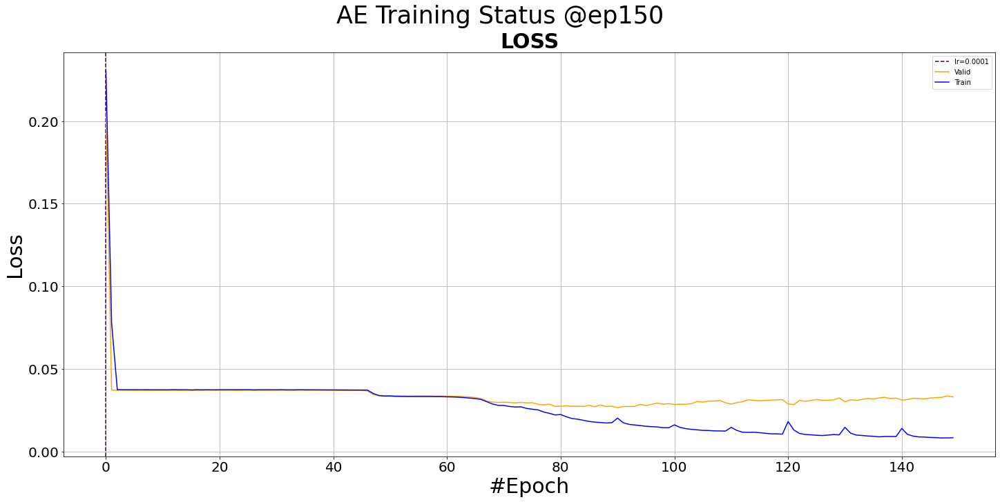

<Figure size 1440x720 with 0 Axes>

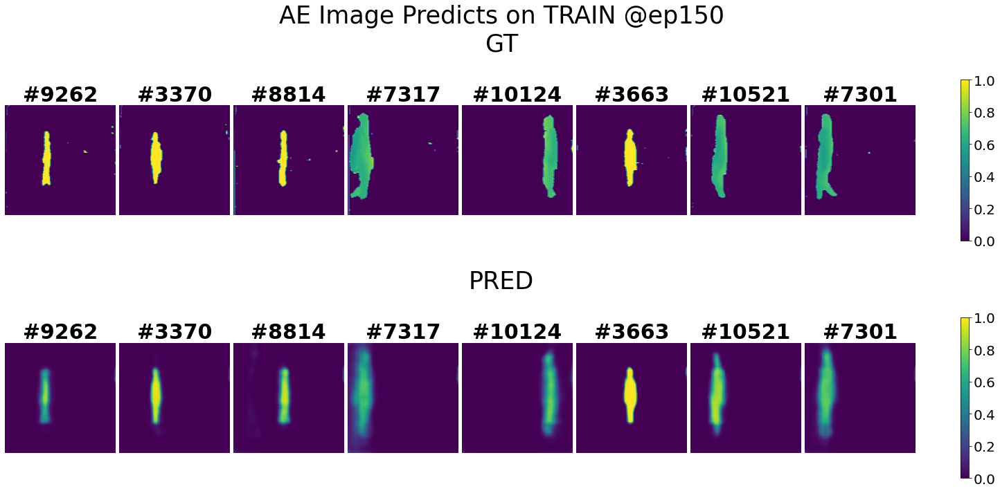

<Figure size 1440x720 with 0 Axes>

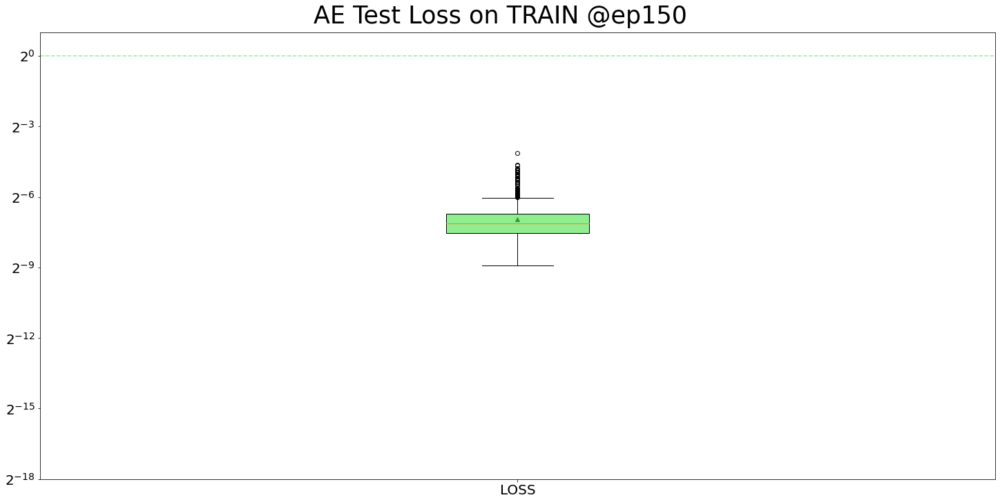

<Figure size 1440x720 with 0 Axes>

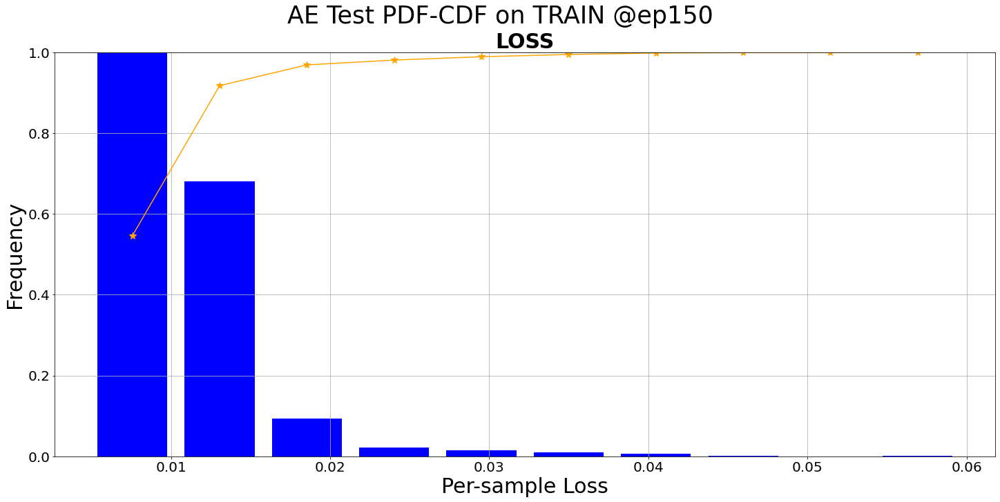

<Figure size 1440x720 with 0 Axes>

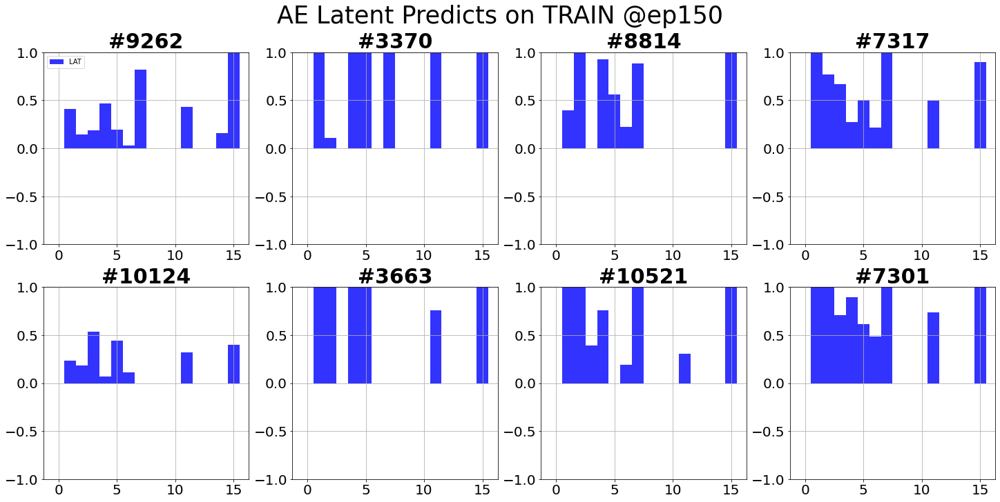

AE valid: epoch=9/10, batch=15/17, current best valid loss=0.0250        .0250    
Total training time: 31.598062753677368 sec
AE test: sample=15/17, loss=0.0059    
Test finished. Average loss={'LOSS': 0.007470573243100422}

Total training time: 2.688753366470337 sec


<Figure size 1440x720 with 0 Axes>

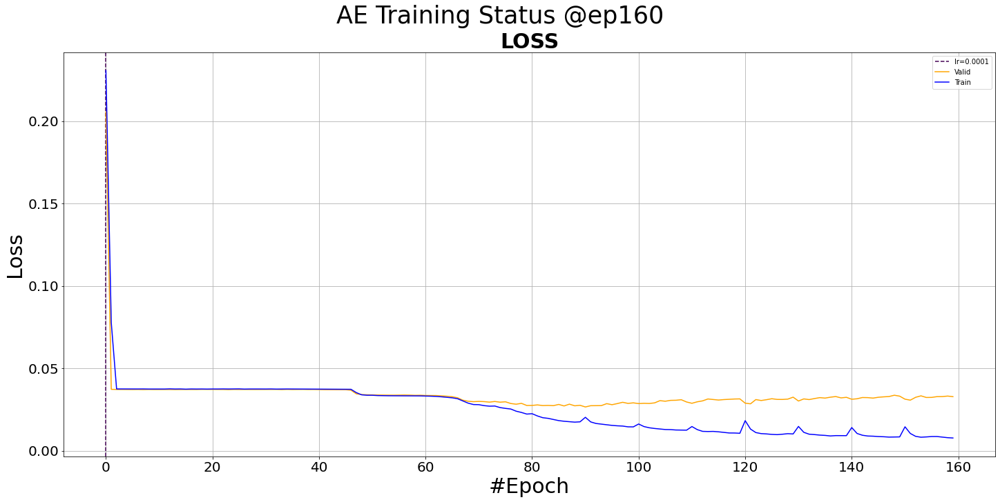

<Figure size 1440x720 with 0 Axes>

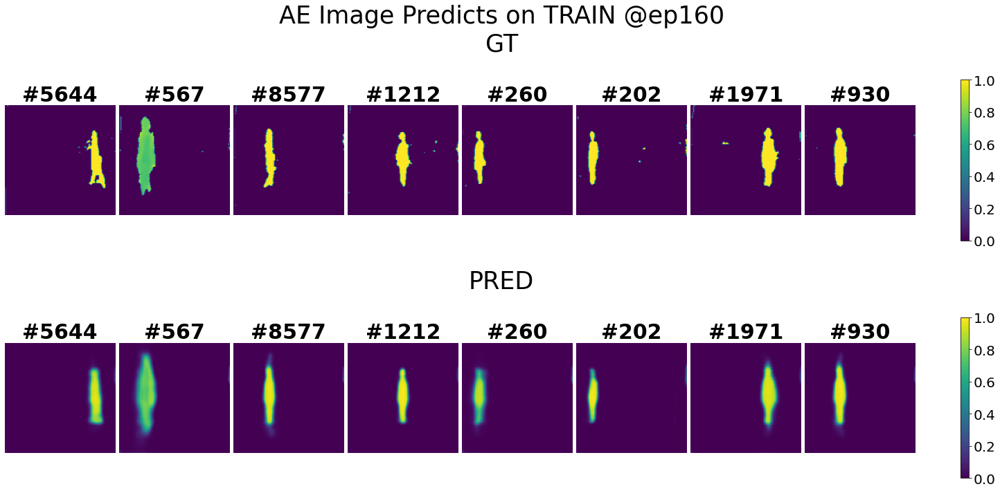

<Figure size 1440x720 with 0 Axes>

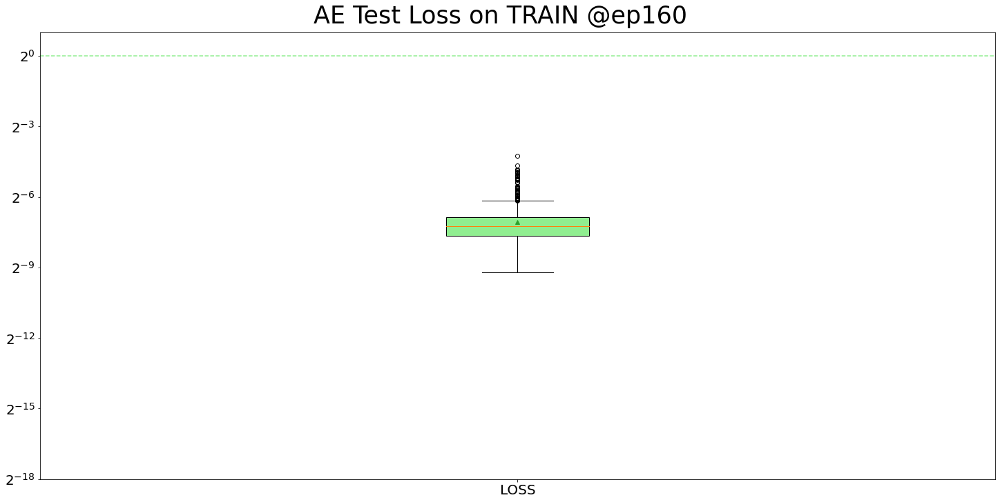

<Figure size 1440x720 with 0 Axes>

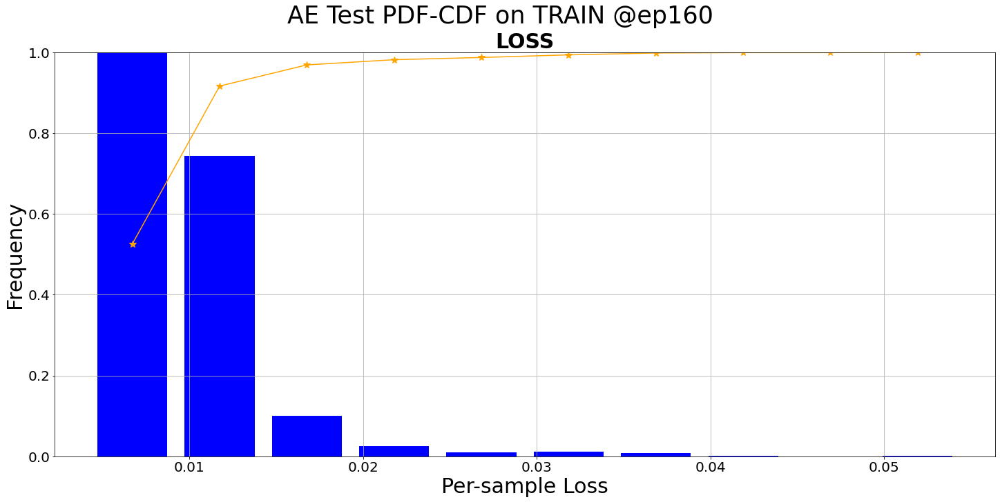

<Figure size 1440x720 with 0 Axes>

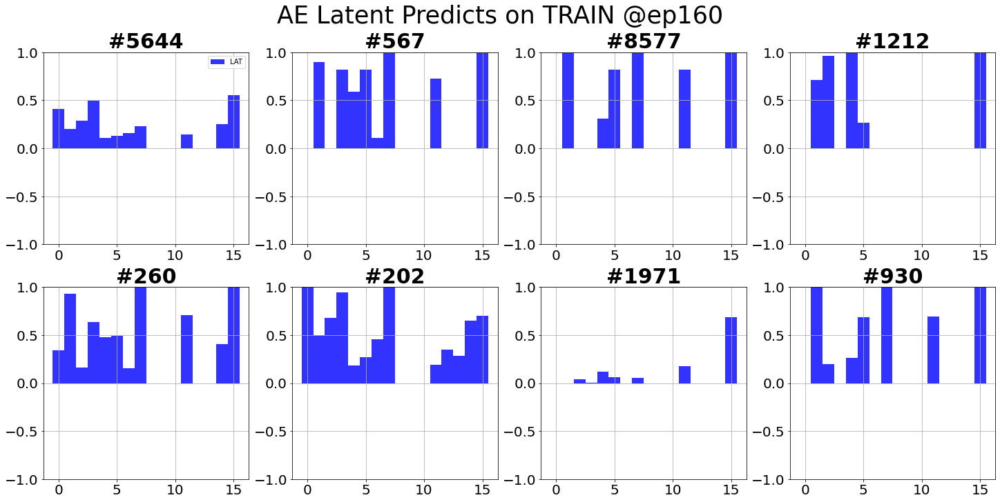

AE valid: epoch=9/10, batch=15/17, current best valid loss=0.0250        .0250    
Total training time: 29.5212140083313 sec
AE test: sample=15/17, loss=0.0109    
Test finished. Average loss={'LOSS': 0.007623056707469753}

Total training time: 2.692324638366699 sec


<Figure size 1440x720 with 0 Axes>

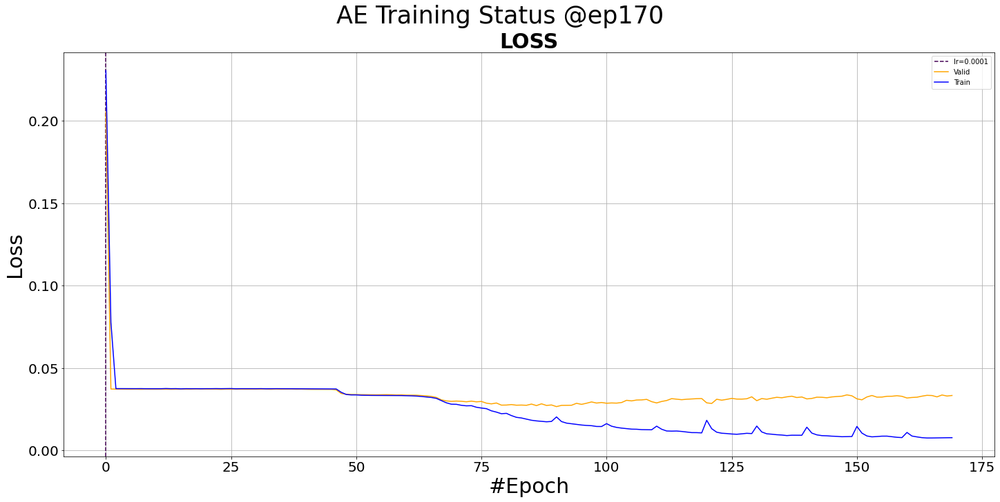

<Figure size 1440x720 with 0 Axes>

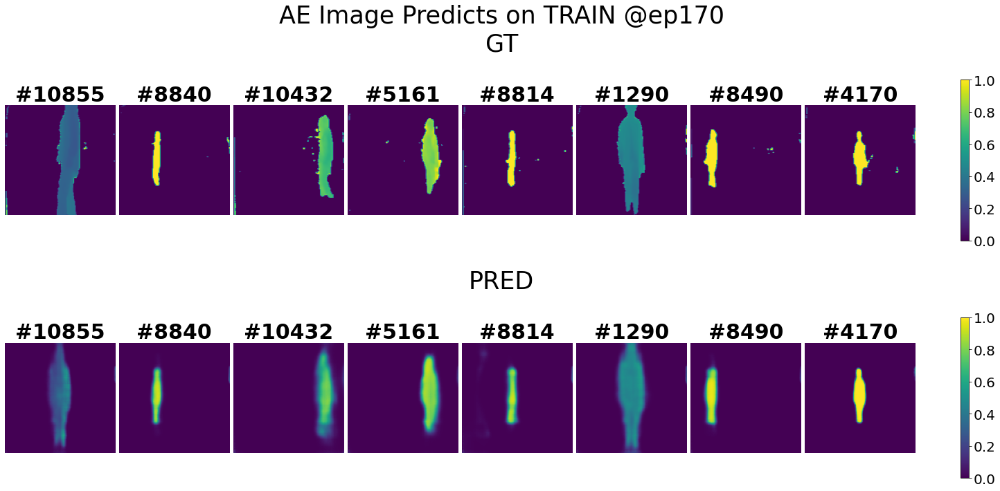

<Figure size 1440x720 with 0 Axes>

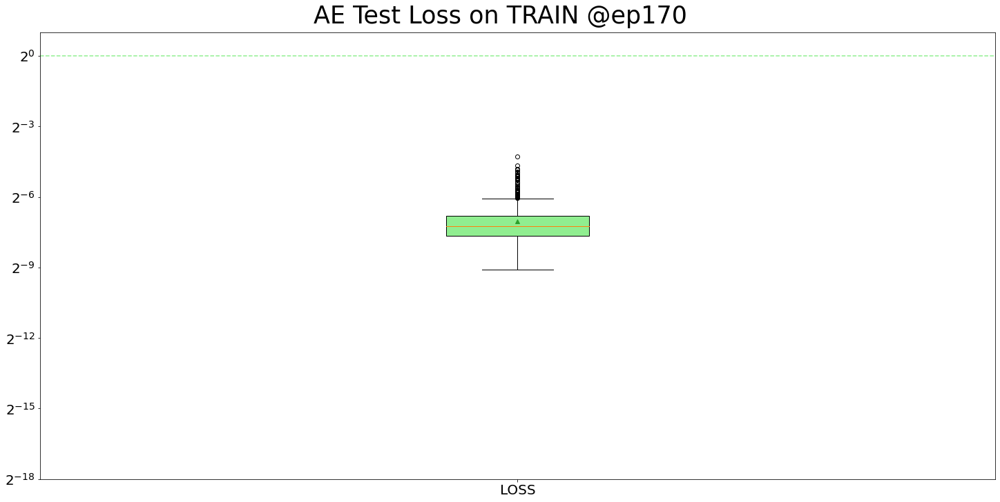

<Figure size 1440x720 with 0 Axes>

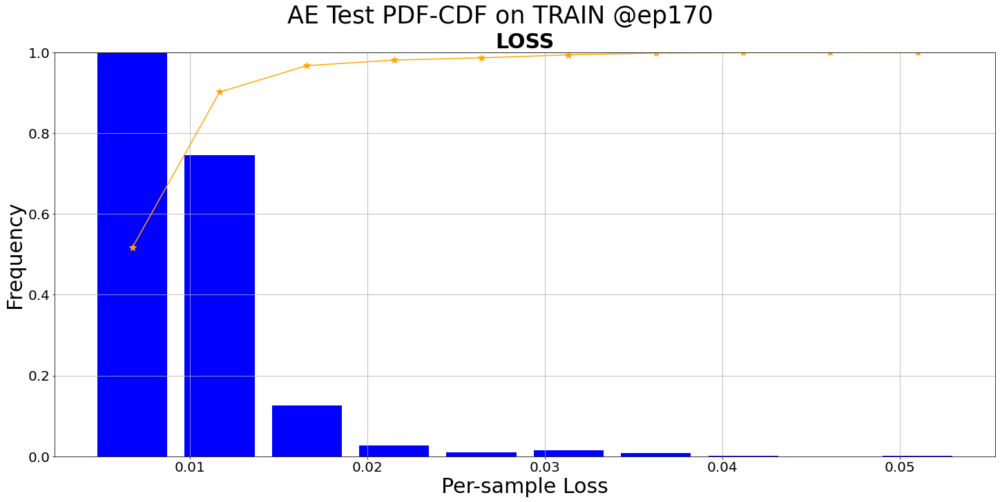

<Figure size 1440x720 with 0 Axes>

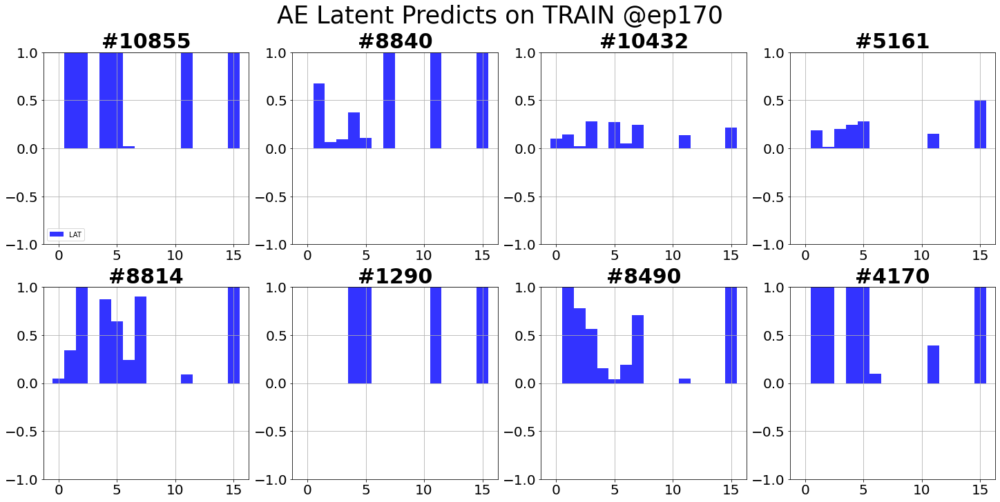

AE valid: epoch=9/10, batch=15/17, current best valid loss=0.0250        .0250    
Total training time: 40.22597885131836 sec
AE test: sample=15/17, loss=0.0054    
Test finished. Average loss={'LOSS': 0.006973999546543756}

Total training time: 2.7025859355926514 sec


<Figure size 1440x720 with 0 Axes>

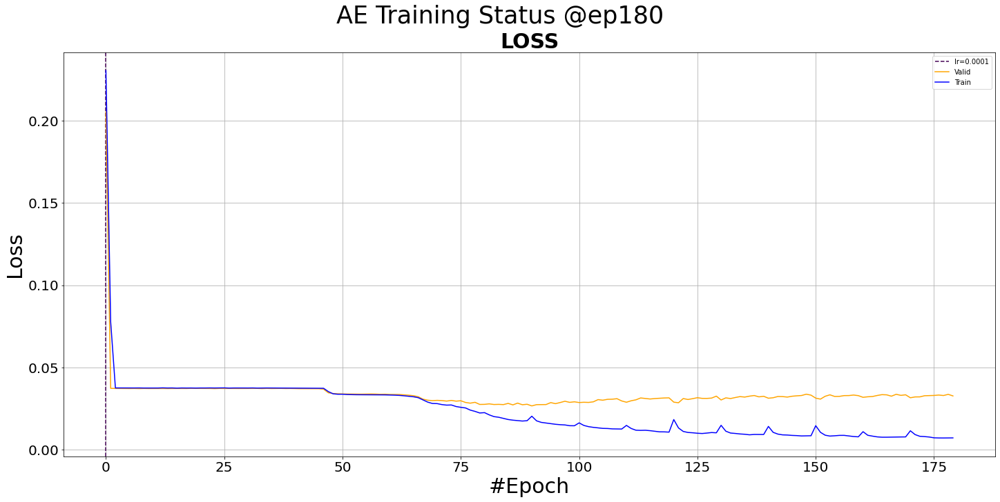

<Figure size 1440x720 with 0 Axes>

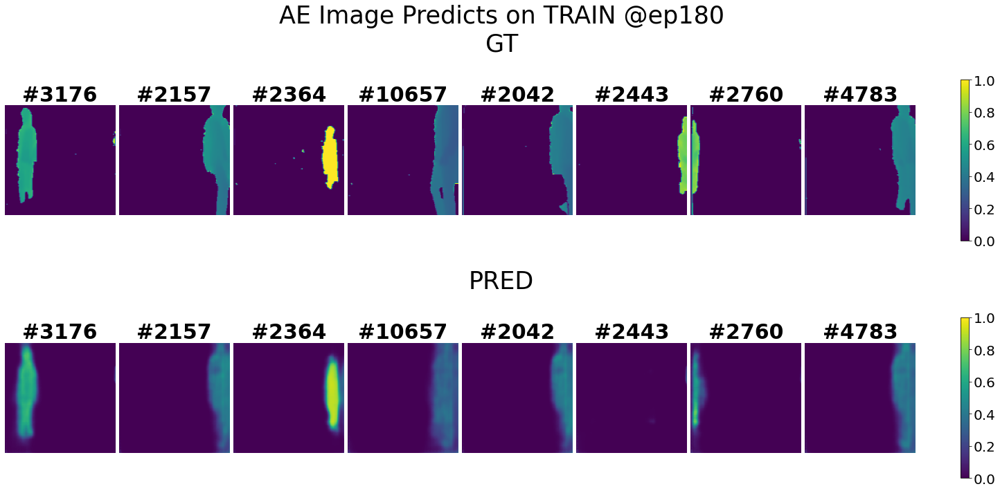

<Figure size 1440x720 with 0 Axes>

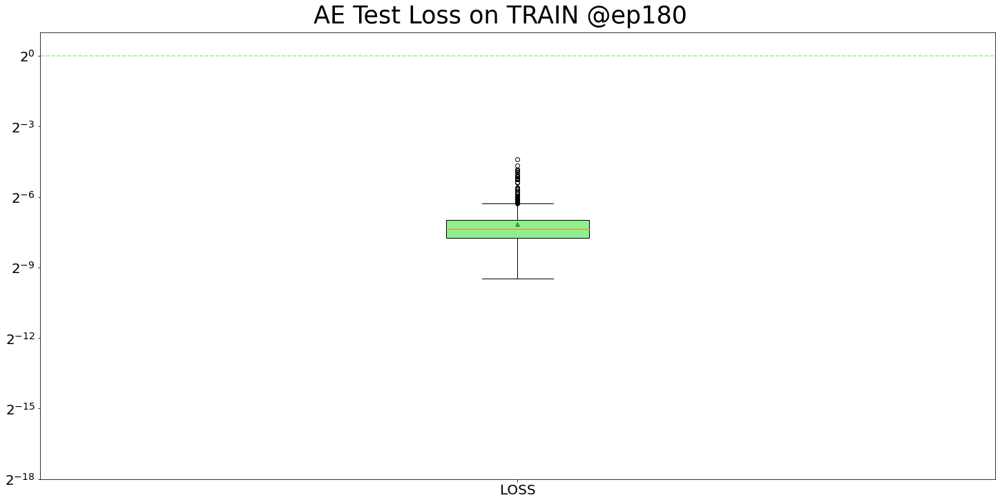

<Figure size 1440x720 with 0 Axes>

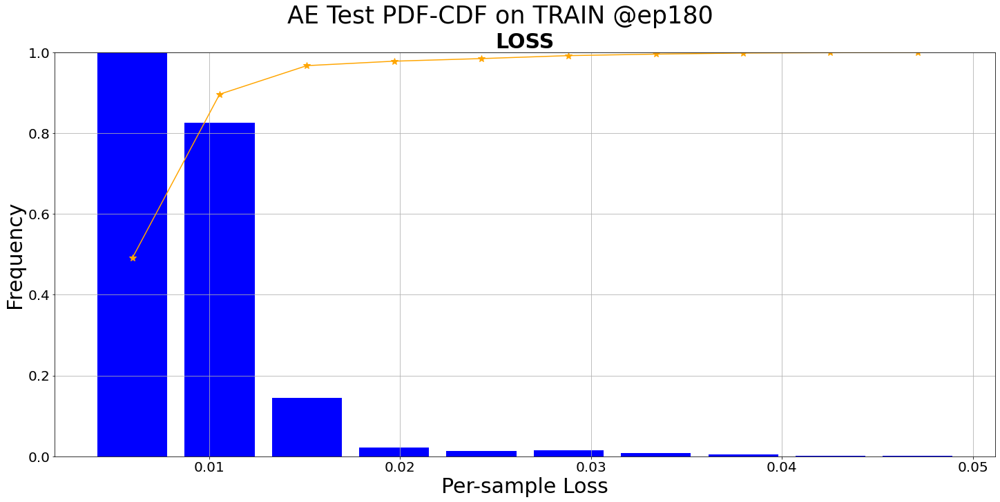

<Figure size 1440x720 with 0 Axes>

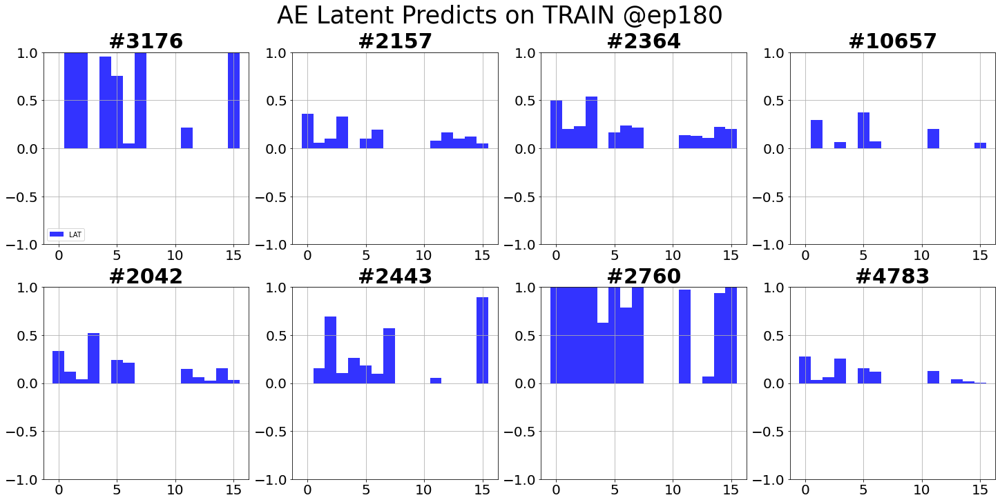

AE valid: epoch=9/10, batch=15/17, current best valid loss=0.0250        .0250    
Total training time: 31.12798833847046 sec
AE test: sample=15/17, loss=0.0062    
Test finished. Average loss={'LOSS': 0.006992660375330802}

Total training time: 2.6726627349853516 sec


<Figure size 1440x720 with 0 Axes>

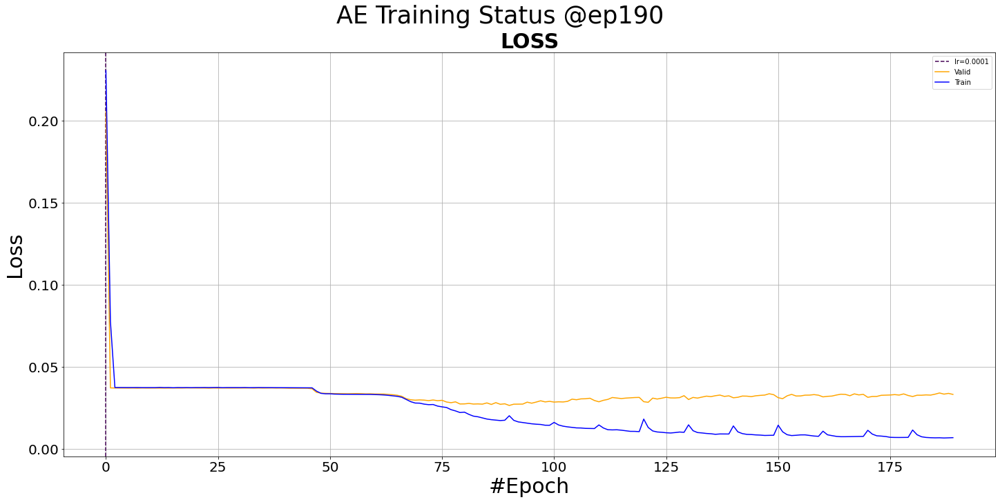

<Figure size 1440x720 with 0 Axes>

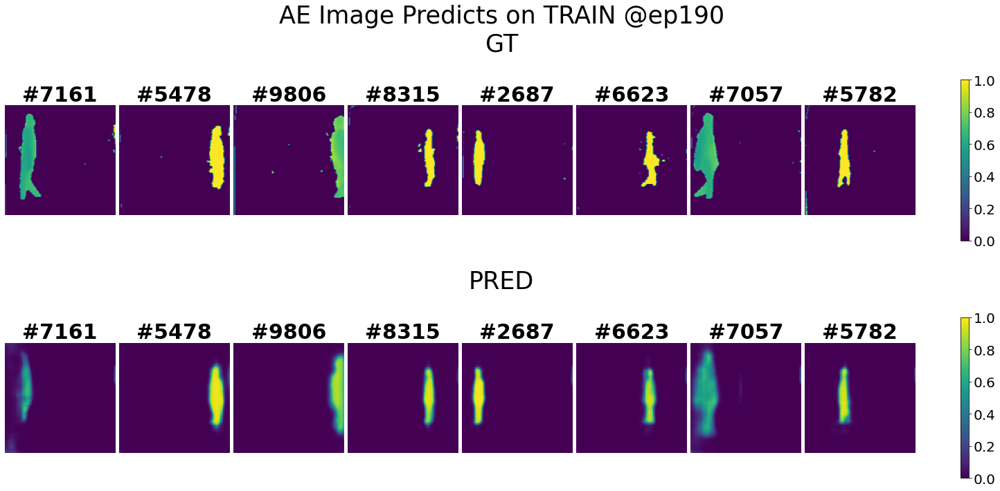

<Figure size 1440x720 with 0 Axes>

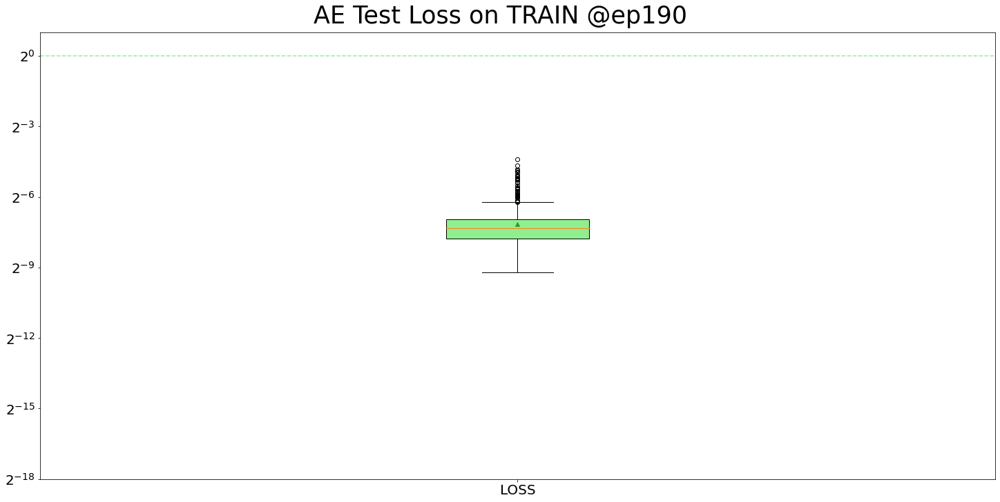

<Figure size 1440x720 with 0 Axes>

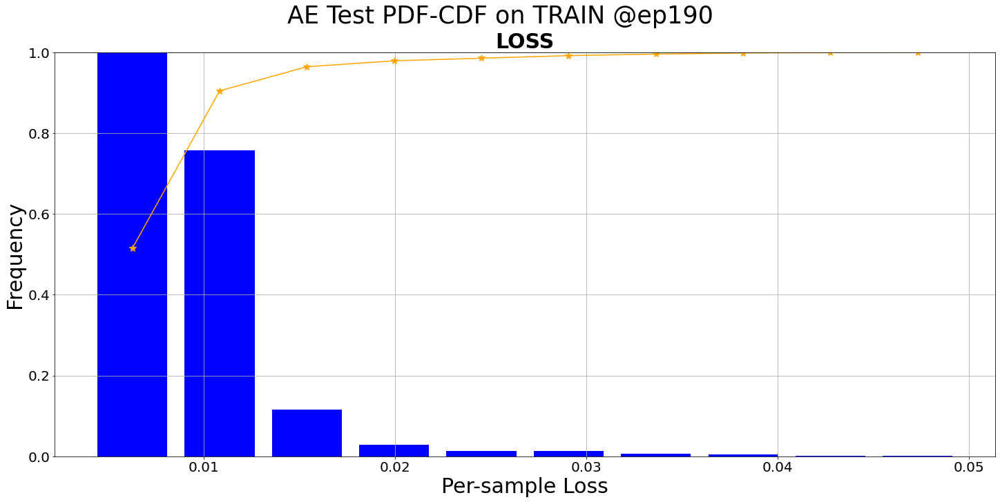

<Figure size 1440x720 with 0 Axes>

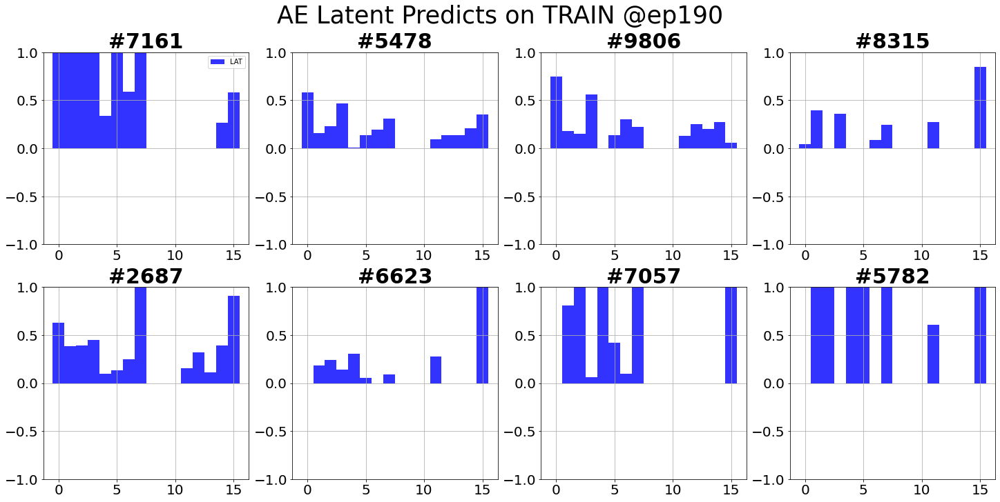

AE valid: epoch=9/10, batch=15/17, current best valid loss=0.0250        .0250    
Total training time: 30.875707626342773 sec
AE test: sample=15/17, loss=0.0083    
Test finished. Average loss={'LOSS': 0.006293812811075922}

Total training time: 2.6833178997039795 sec


<Figure size 1440x720 with 0 Axes>

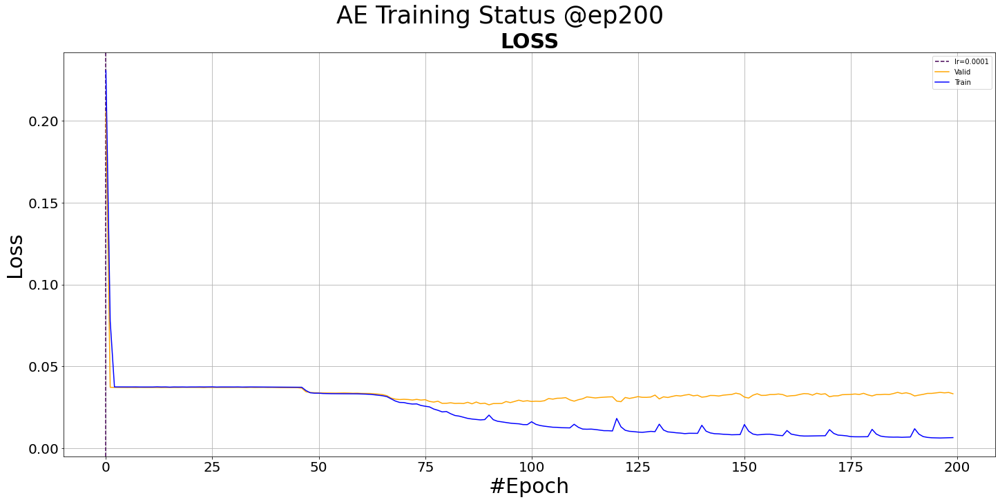

<Figure size 1440x720 with 0 Axes>

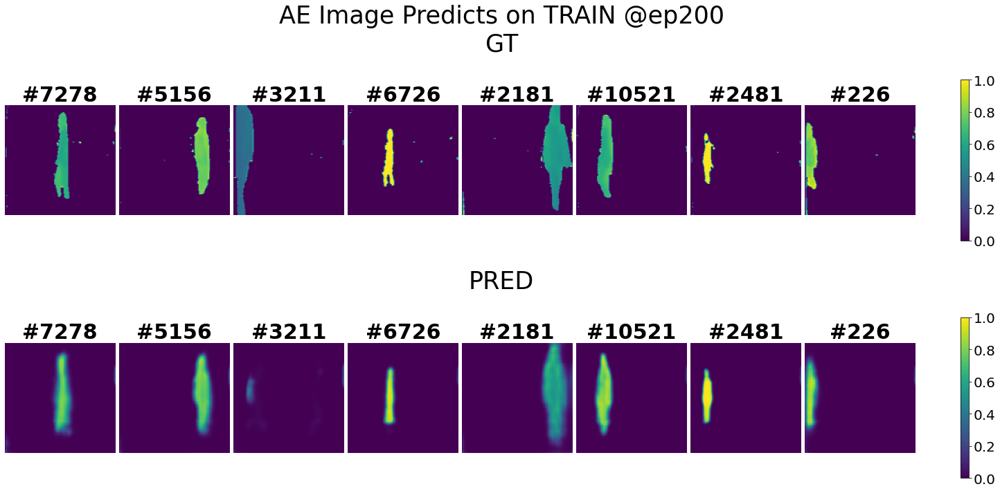

<Figure size 1440x720 with 0 Axes>

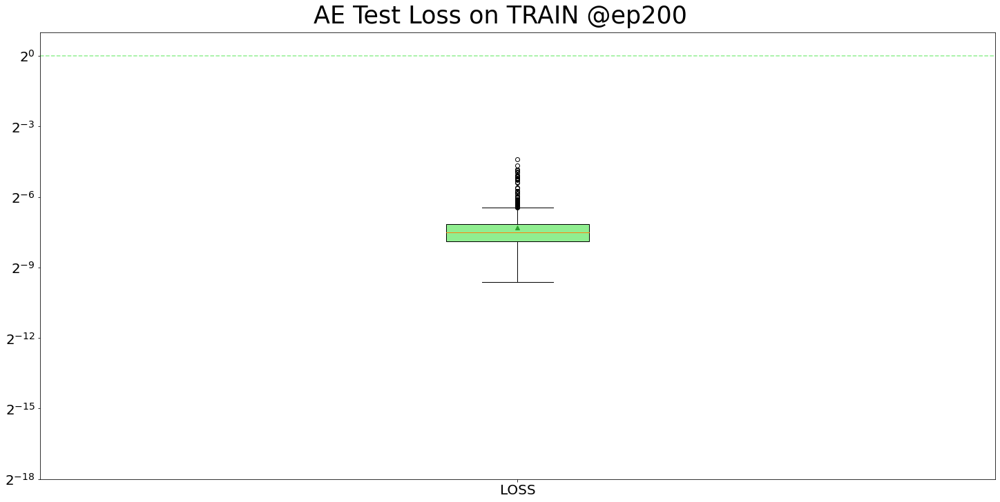

<Figure size 1440x720 with 0 Axes>

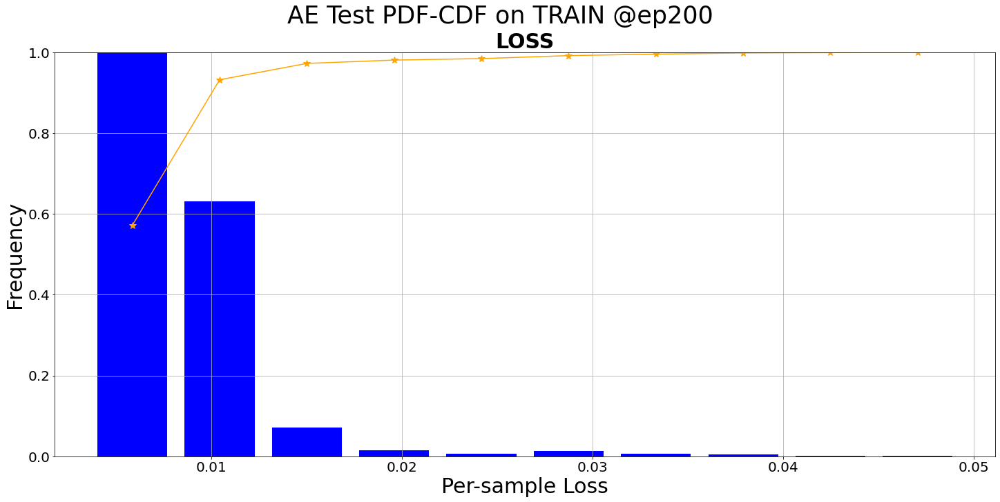

<Figure size 1440x720 with 0 Axes>

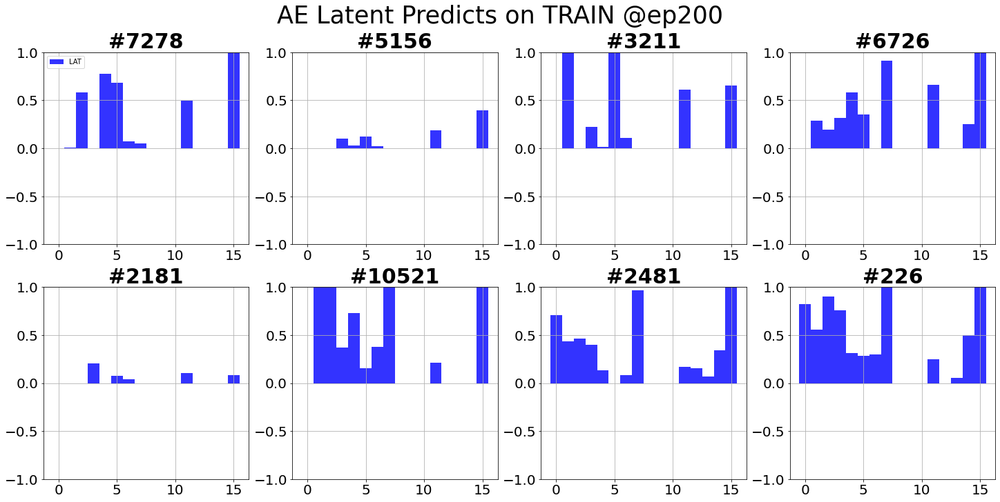


Schedule Completed!


In [8]:
# Training and Testing
%matplotlib inline
trainer_ae.scheduler(turns=10,
                  test_loader='train', select_num=8,
                  autosave=True, notion=f"{date_run}AE", save_model=False)

AE test: sample=8790/8792, loss=0.0605    
Test finished. Average loss={'LOSS': 0.03247064987335861}

Total training time: 24.9058735370636 sec


<Figure size 1440x720 with 0 Axes>

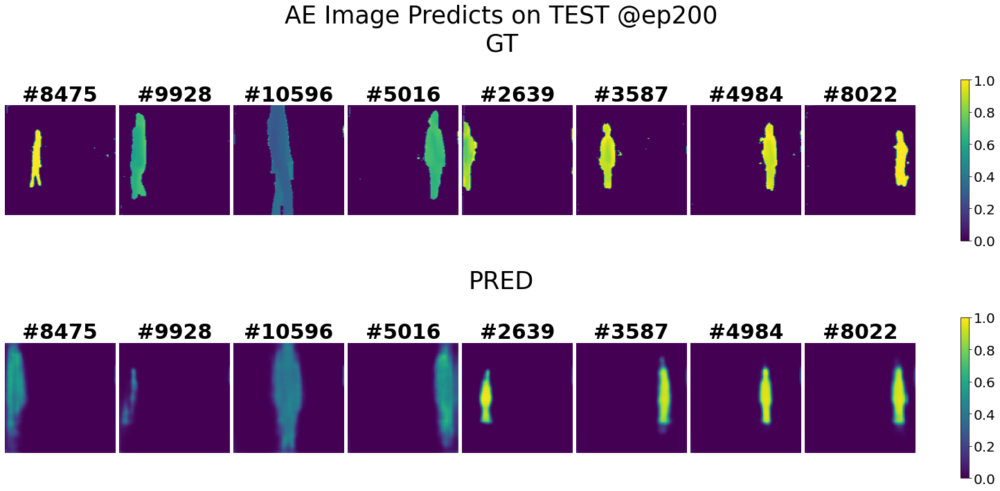

<Figure size 1440x720 with 0 Axes>

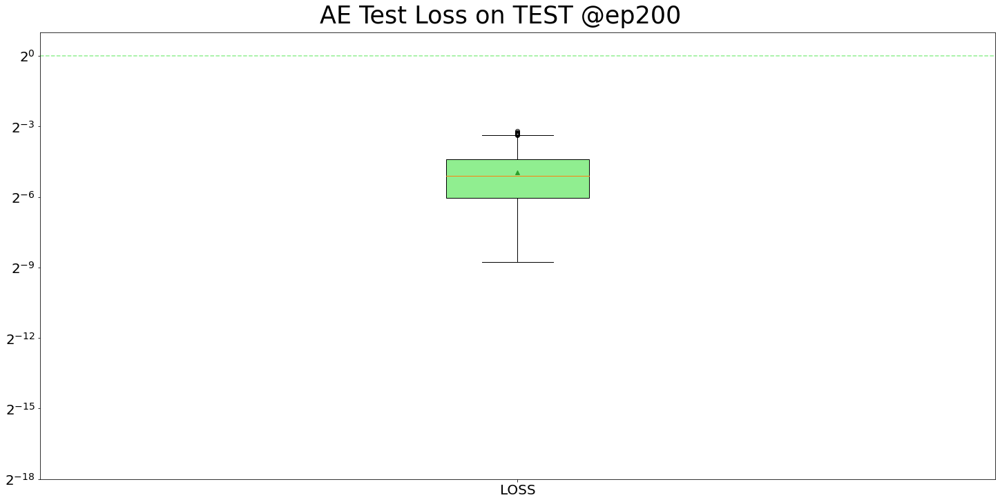

<Figure size 1440x720 with 0 Axes>

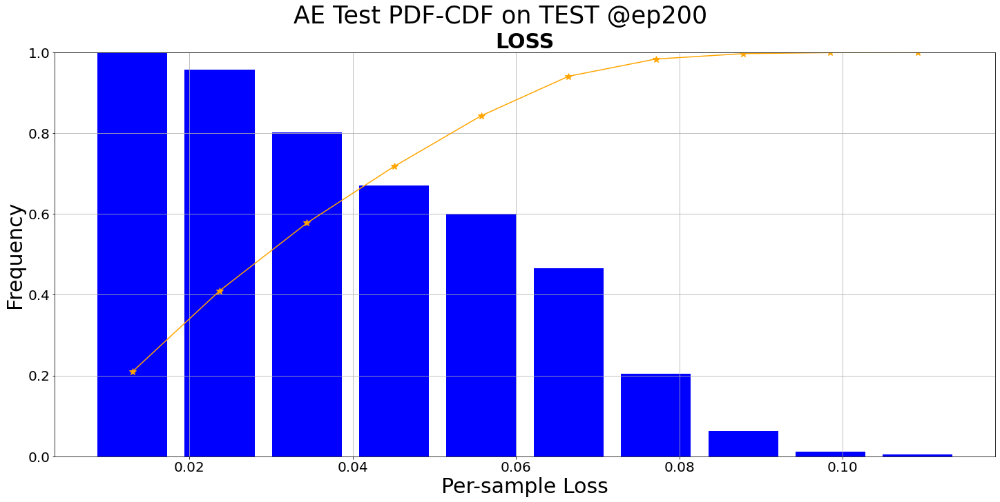

<Figure size 1440x720 with 0 Axes>

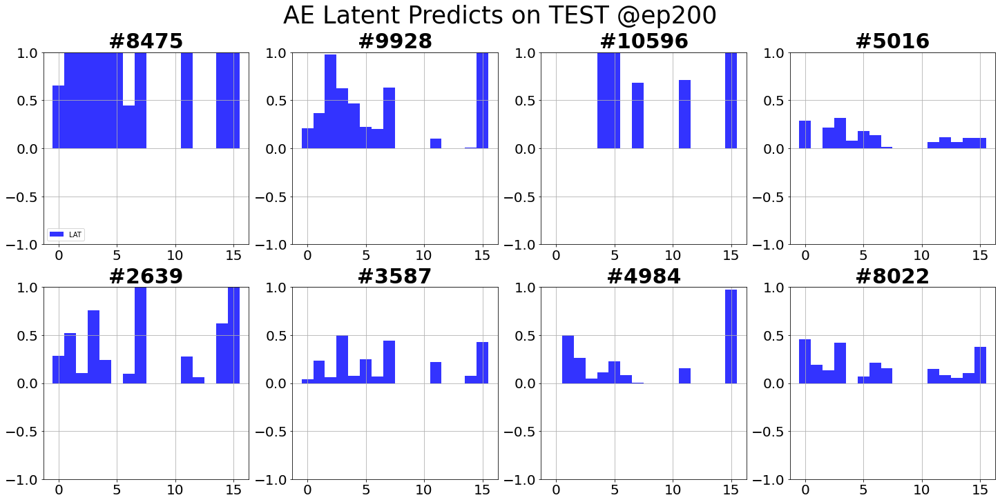

In [9]:
trainer_ae.test(mode='test')
trainer_ae.plot_test(select_num=8, autosave=True, notion=f"{date_run}AE")

In [10]:
trainer_ae.save(f"{date_run}AE")

Saving models...
Saving ae...
All saved!


In [11]:
trainer_ae.loss.save('pred', f"{date_run}AE")

Saving pred including GT, PRED, LAT, IND...Done


### VAE

In [12]:
torch.cuda.set_device(gpu)
imgdecoder = TP.ImageDecoder(latent_dim=16)
csiencoder = TP.CSIEncoder(out_length=32)
trainer_vae = TP.CompTrainer(name='VAE', mode='vae', mask=False,
                              networks=[csiencoder, imgdecoder],
                 lr=1e-4, epochs=10, cuda=gpu,
                 train_loader=train_loader, valid_loader=valid_loader, test_loader=test_loader)
trainer_vae.beta=0.5

VAE valid: epoch=9/10, batch=15/17, current best valid loss=0.0005        .0005    
Total training time: 38.424394607543945 sec
VAE test: sample=15/17, loss=0.0347    
Test finished. Average loss={'LOSS': 0.03371016533278367}

Total training time: 3.2865066528320312 sec


<Figure size 432x288 with 0 Axes>

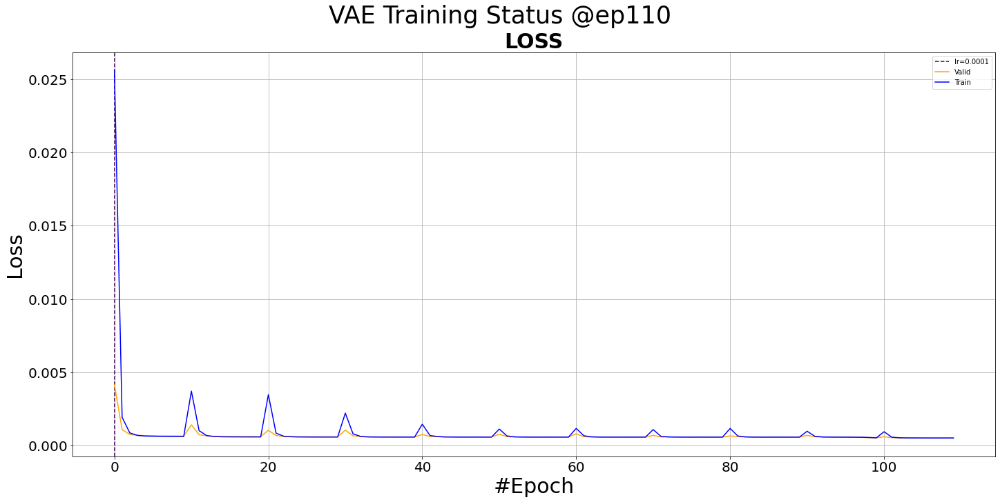

<Figure size 1440x720 with 0 Axes>

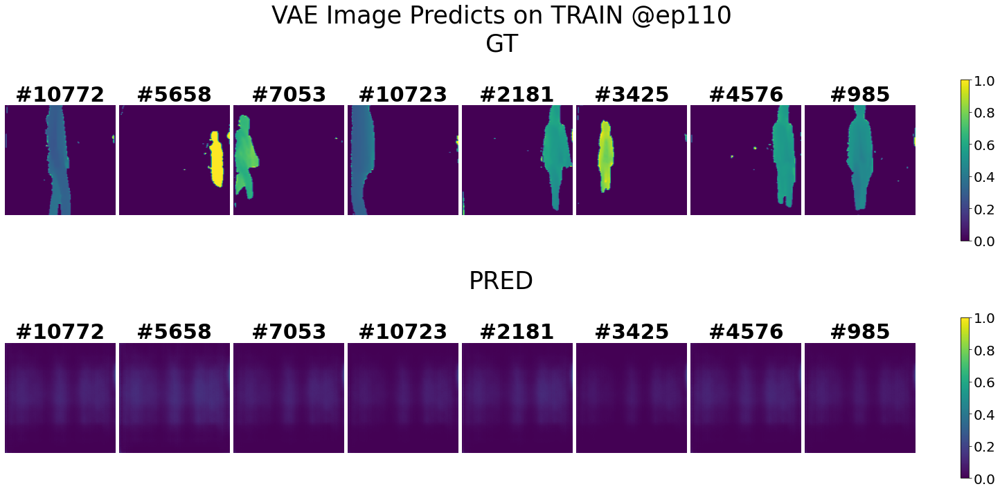

<Figure size 1440x720 with 0 Axes>

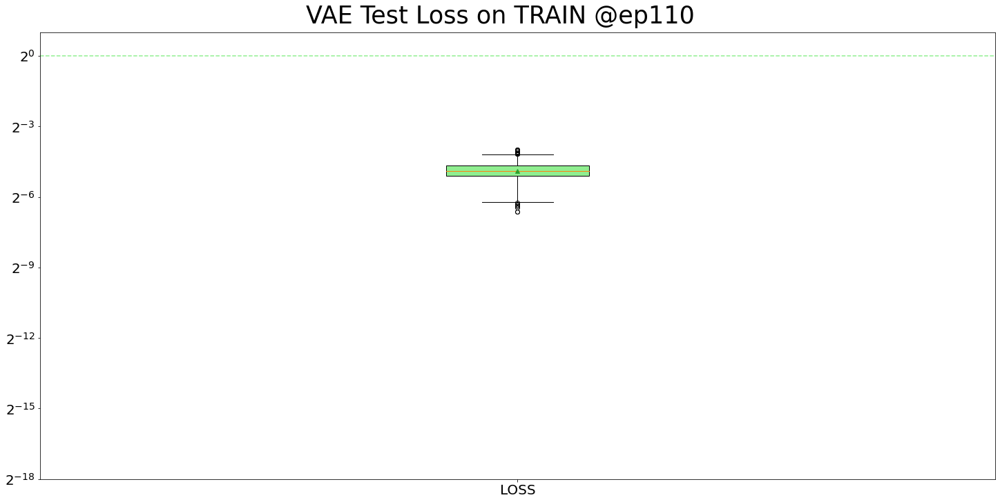

<Figure size 1440x720 with 0 Axes>

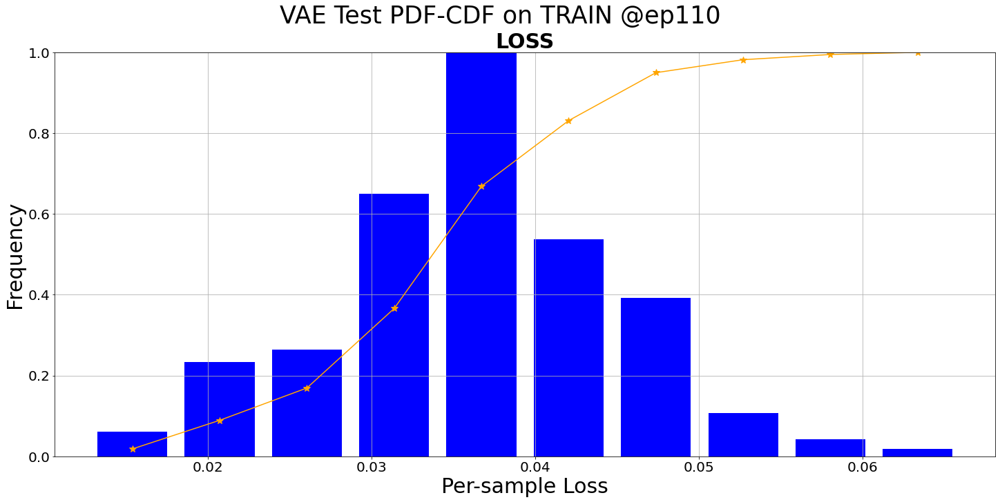

<Figure size 1440x720 with 0 Axes>

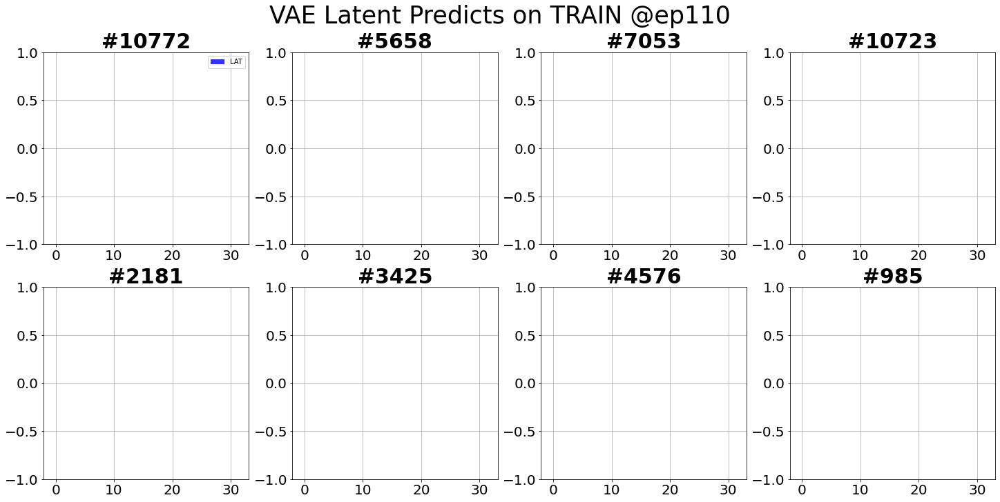

VAE valid: epoch=9/10, batch=15/17, current best valid loss=0.0005        .0005    
Total training time: 39.680054664611816 sec
VAE test: sample=15/17, loss=0.0200    
Test finished. Average loss={'LOSS': 0.033342280529562715}

Total training time: 3.2415716648101807 sec


<Figure size 1440x720 with 0 Axes>

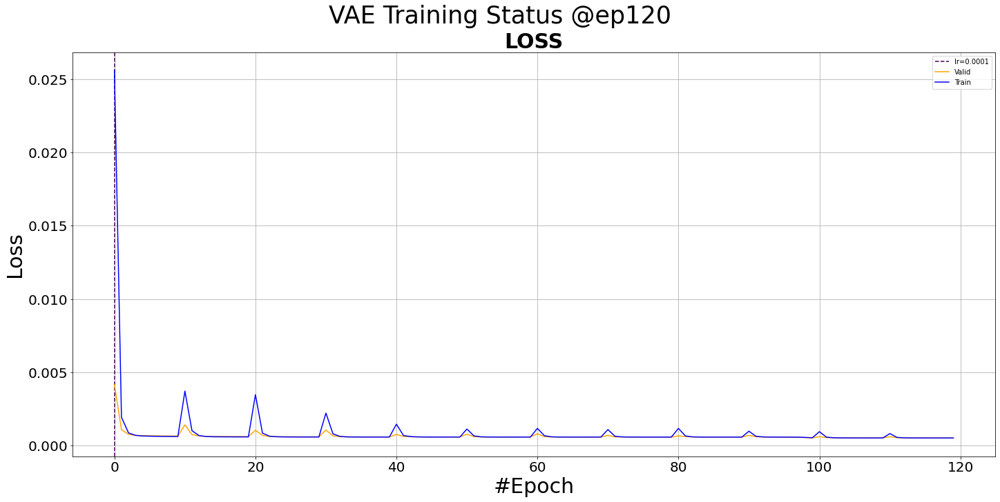

<Figure size 1440x720 with 0 Axes>

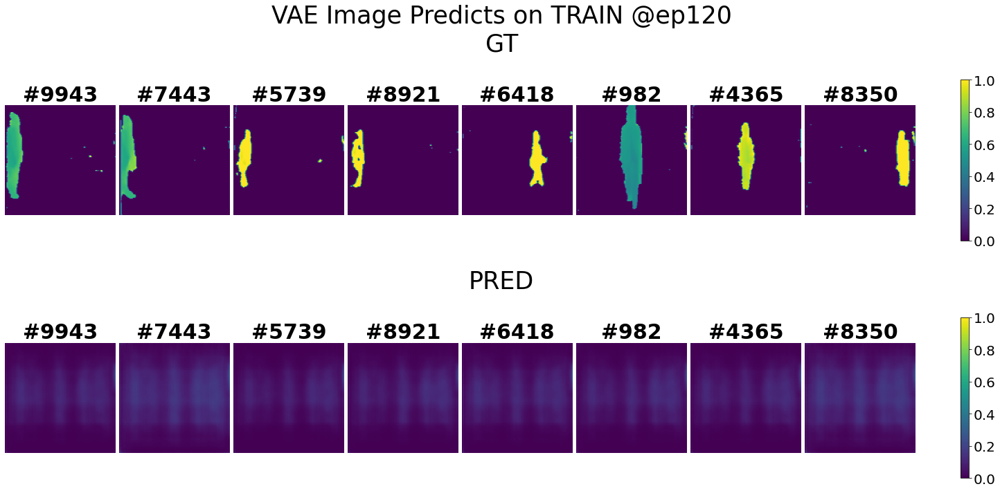

<Figure size 1440x720 with 0 Axes>

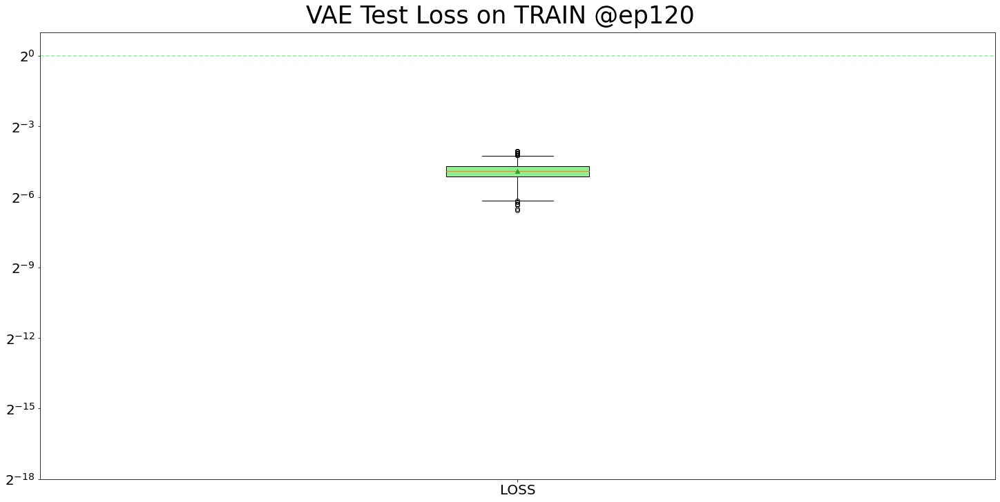

<Figure size 1440x720 with 0 Axes>

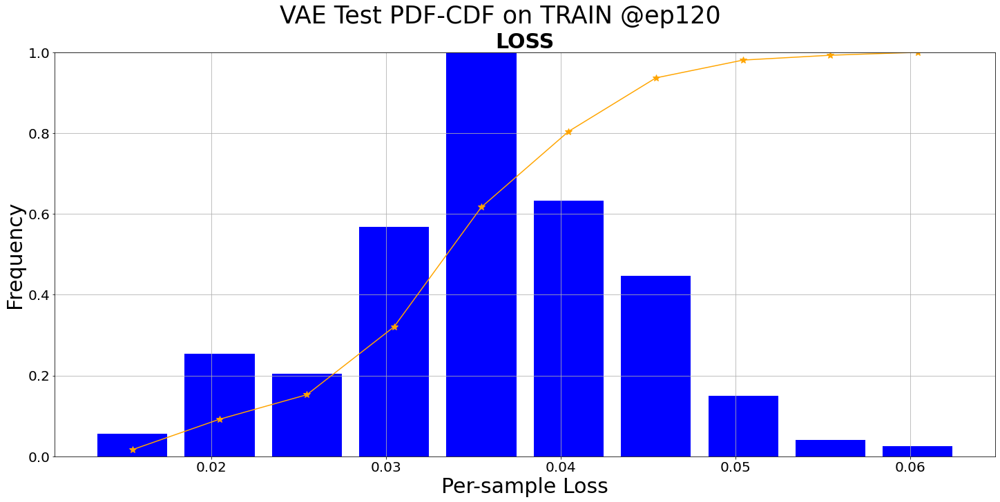

<Figure size 1440x720 with 0 Axes>

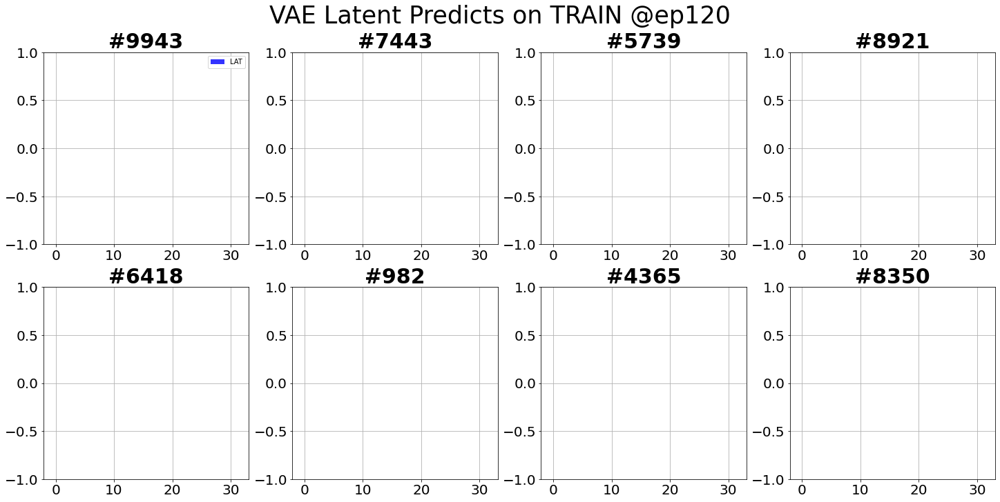

VAE valid: epoch=9/10, batch=15/17, current best valid loss=0.0005        .0005    
Total training time: 44.65108132362366 sec
VAE test: sample=15/17, loss=0.0254    
Test finished. Average loss={'LOSS': 0.033273123000981286}

Total training time: 3.2582948207855225 sec


<Figure size 1440x720 with 0 Axes>

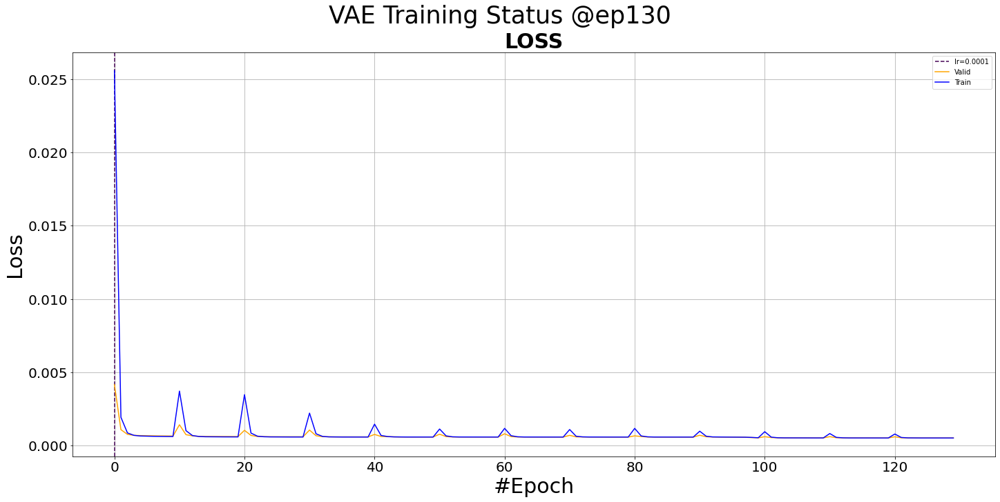

<Figure size 1440x720 with 0 Axes>

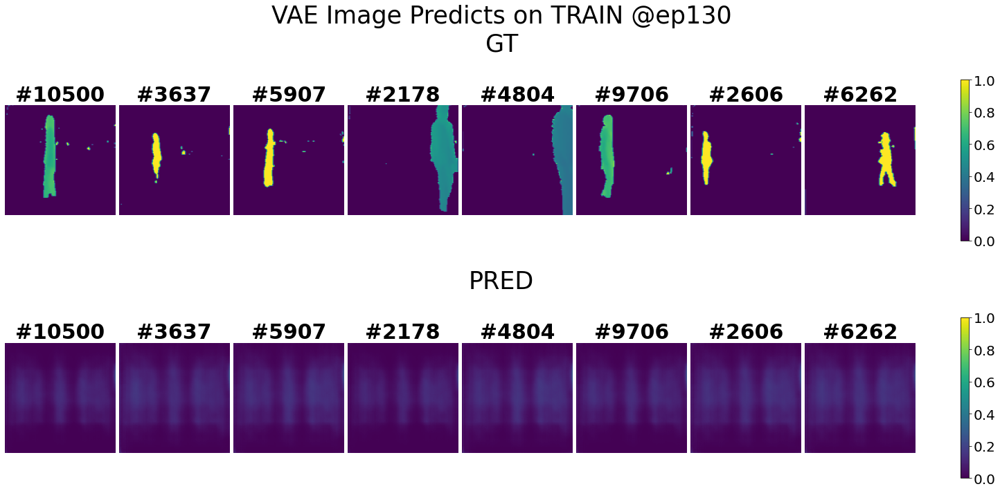

<Figure size 1440x720 with 0 Axes>

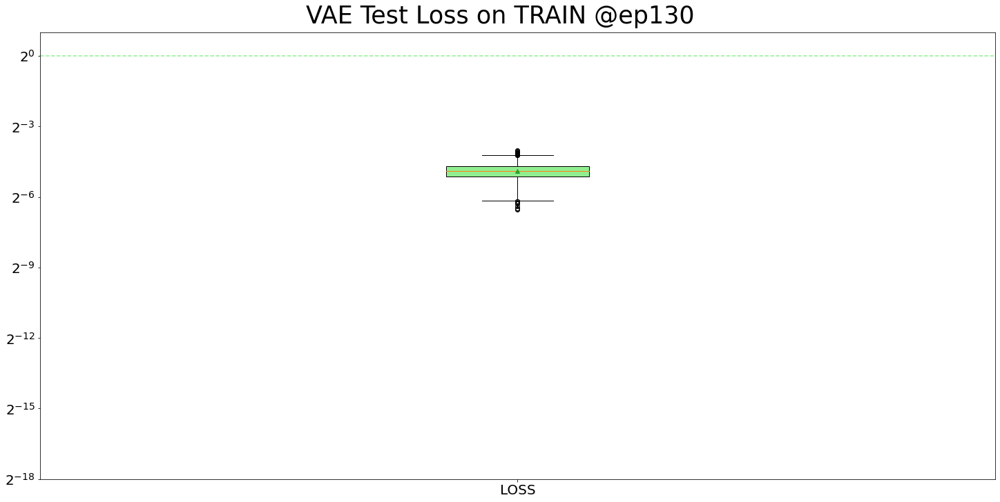

<Figure size 1440x720 with 0 Axes>

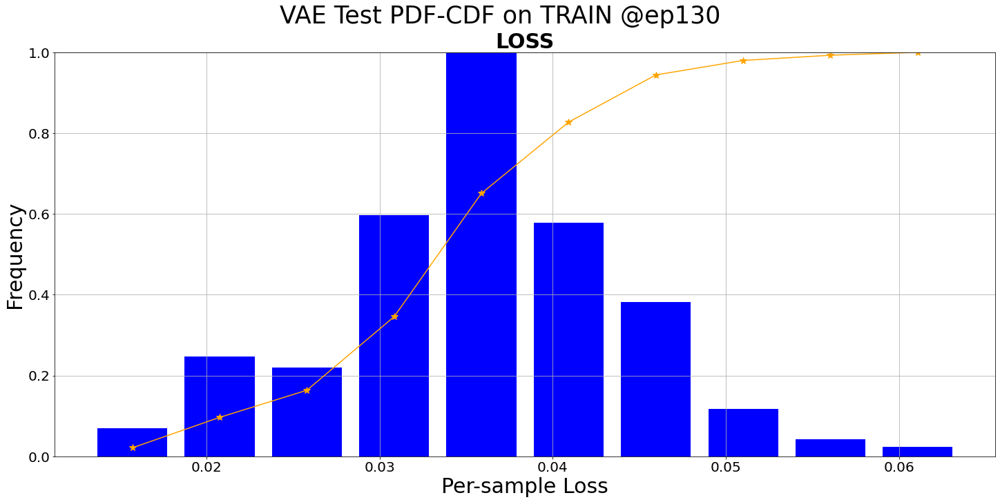

<Figure size 1440x720 with 0 Axes>

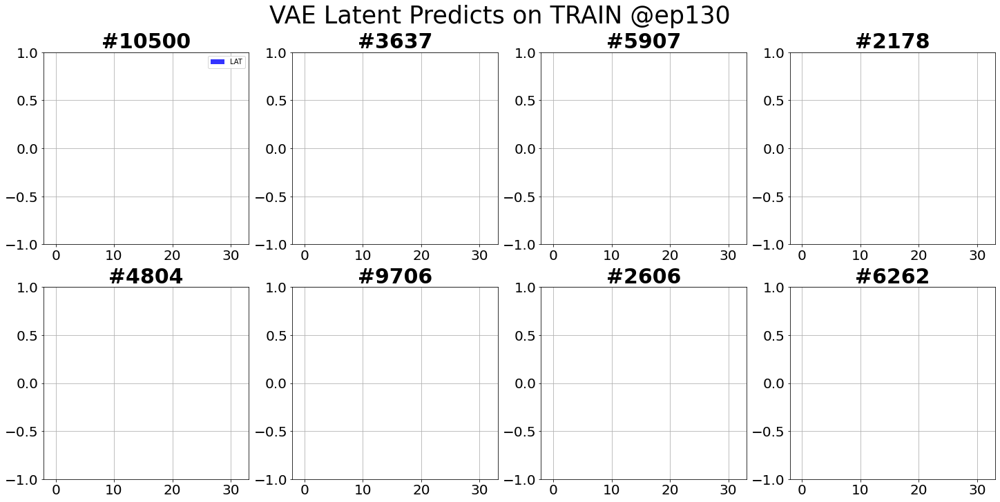

VAE valid: epoch=9/10, batch=15/17, current best valid loss=0.0005        .0005    
Total training time: 40.57291913032532 sec
VAE test: sample=15/17, loss=0.0327    
Test finished. Average loss={'LOSS': 0.033274934268453814}

Total training time: 3.2671058177948 sec


<Figure size 1440x720 with 0 Axes>

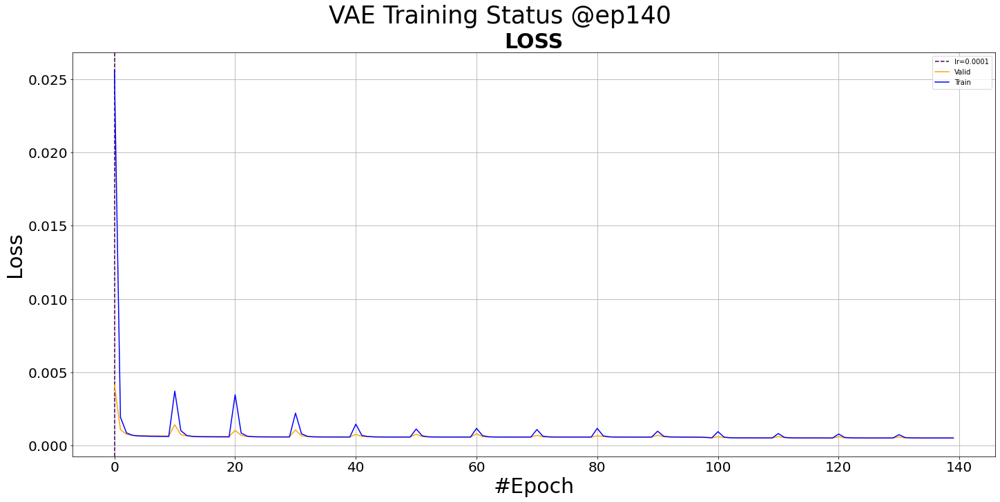

<Figure size 1440x720 with 0 Axes>

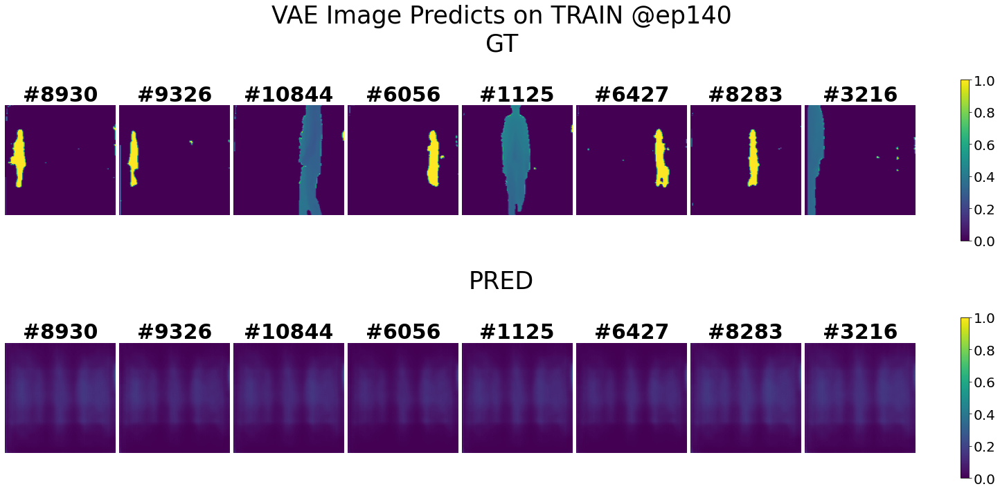

<Figure size 1440x720 with 0 Axes>

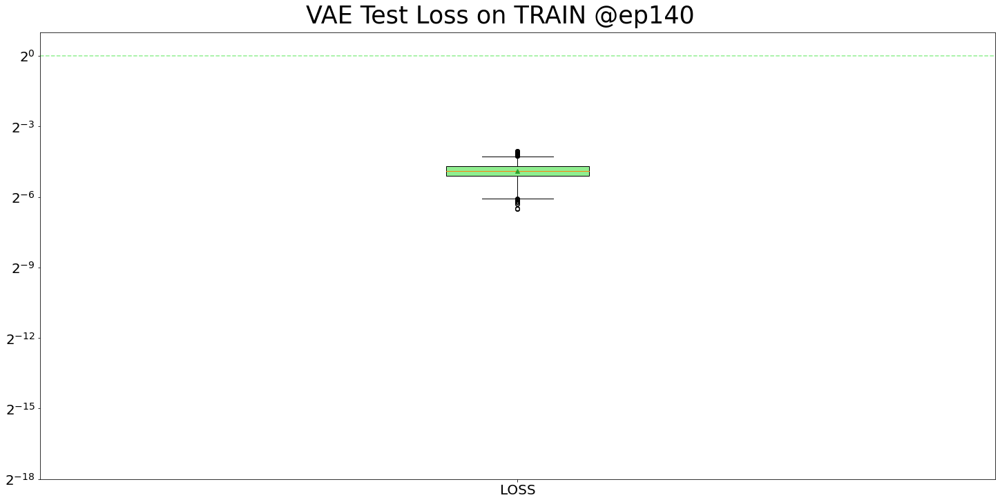

<Figure size 1440x720 with 0 Axes>

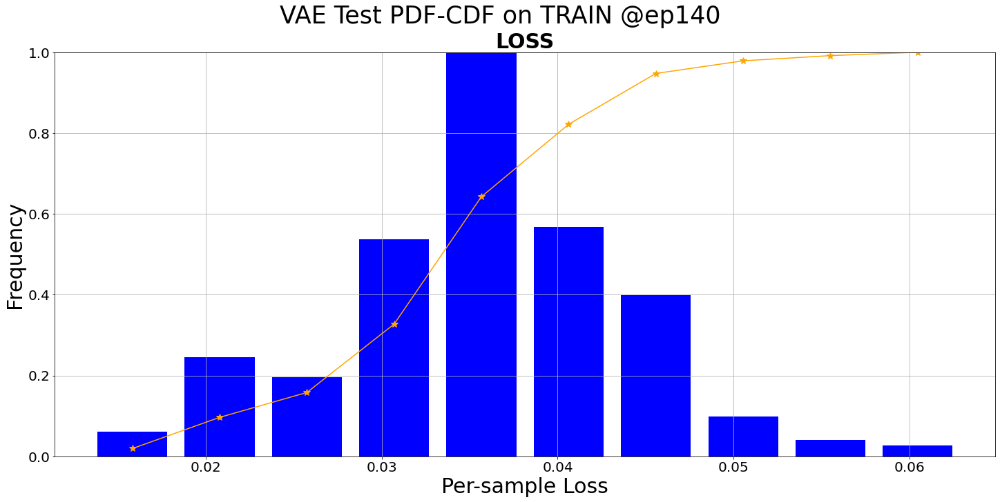

<Figure size 1440x720 with 0 Axes>

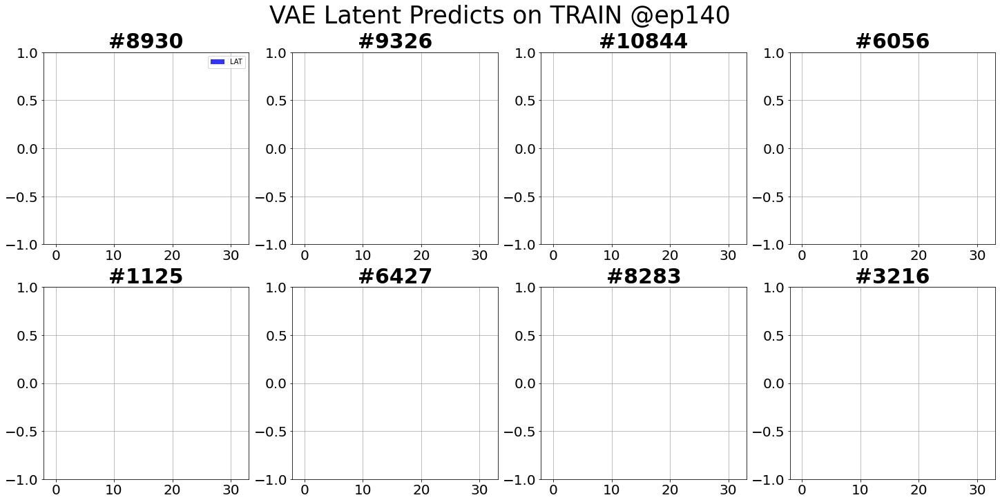

VAE valid: epoch=9/10, batch=15/17, current best valid loss=0.0005        .0005    
Total training time: 43.25040125846863 sec
VAE test: sample=15/17, loss=0.0231    
Test finished. Average loss={'LOSS': 0.033171552901930065}

Total training time: 3.087871789932251 sec


<Figure size 1440x720 with 0 Axes>

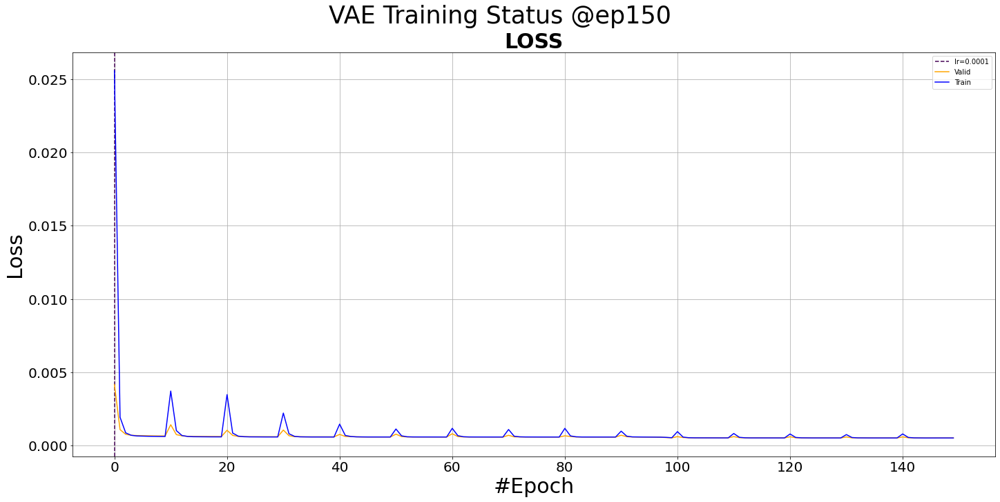

<Figure size 1440x720 with 0 Axes>

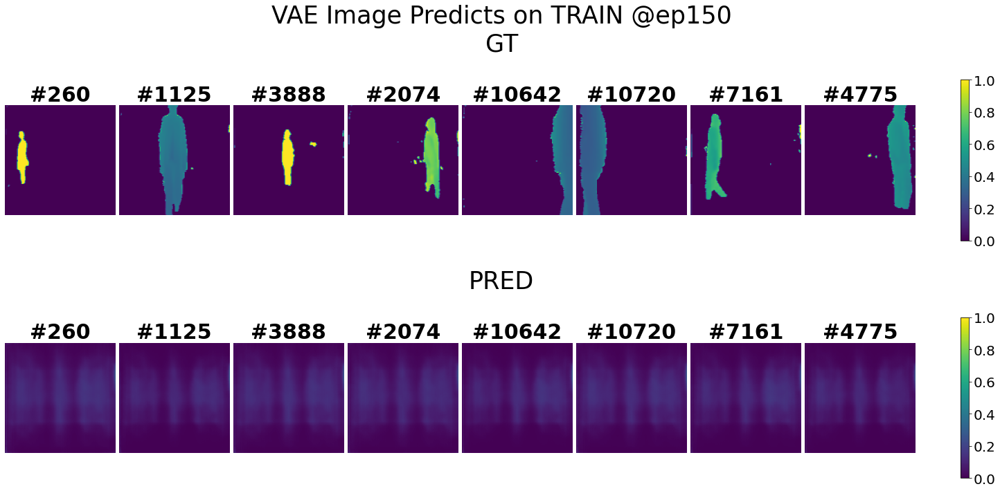

<Figure size 1440x720 with 0 Axes>

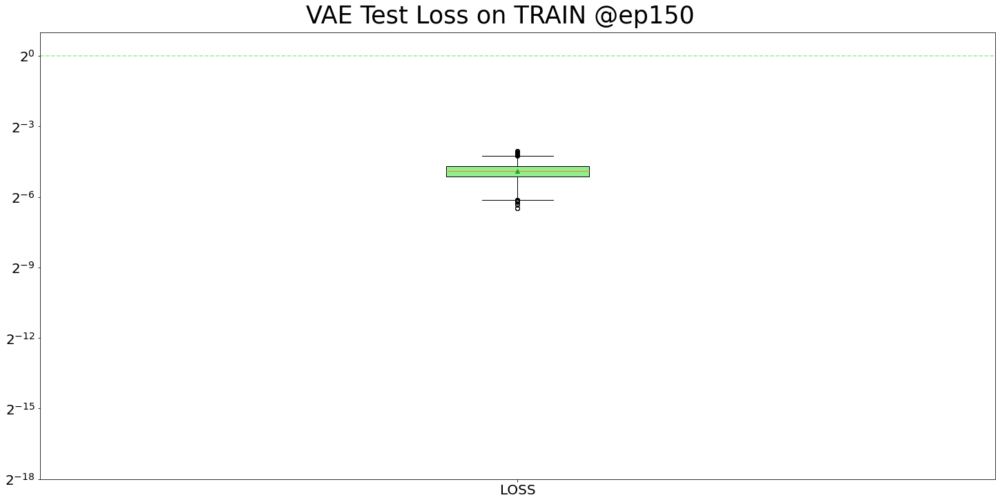

<Figure size 1440x720 with 0 Axes>

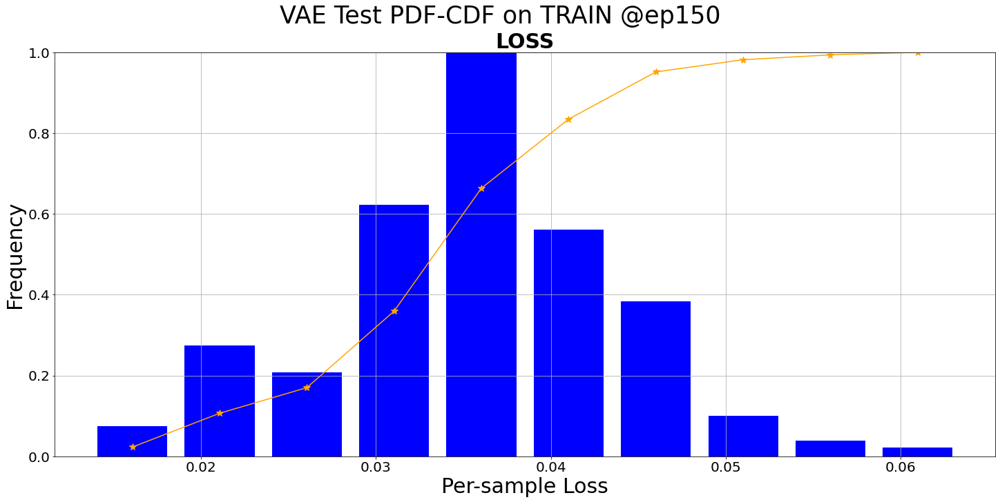

<Figure size 1440x720 with 0 Axes>

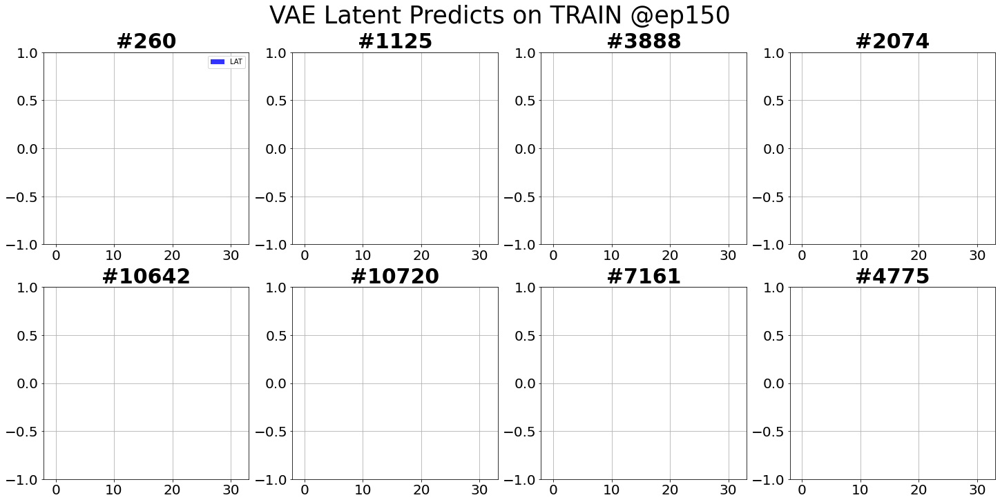

VAE valid: epoch=9/10, batch=15/17, current best valid loss=0.0005        .0005    
Total training time: 42.14370608329773 sec
VAE test: sample=15/17, loss=0.0268    
Test finished. Average loss={'LOSS': 0.0331512557082426}

Total training time: 3.0626258850097656 sec


<Figure size 1440x720 with 0 Axes>

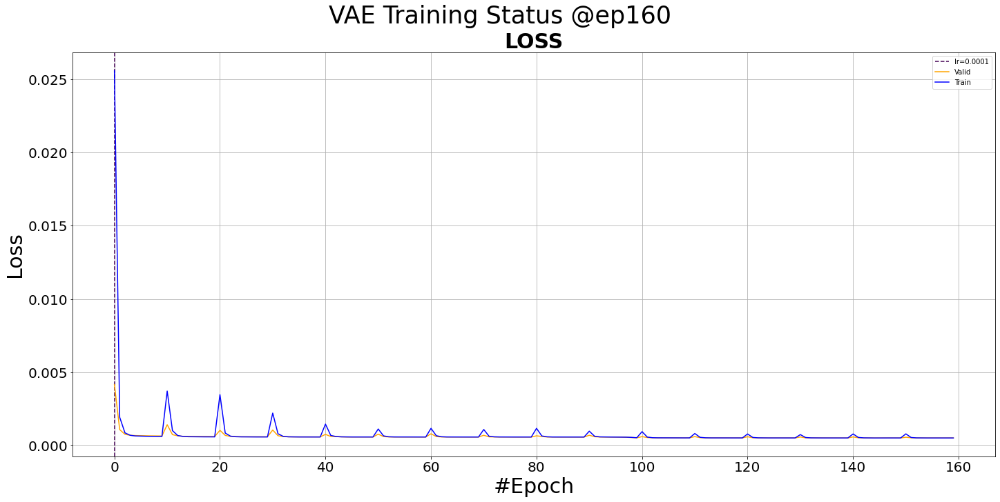

<Figure size 1440x720 with 0 Axes>

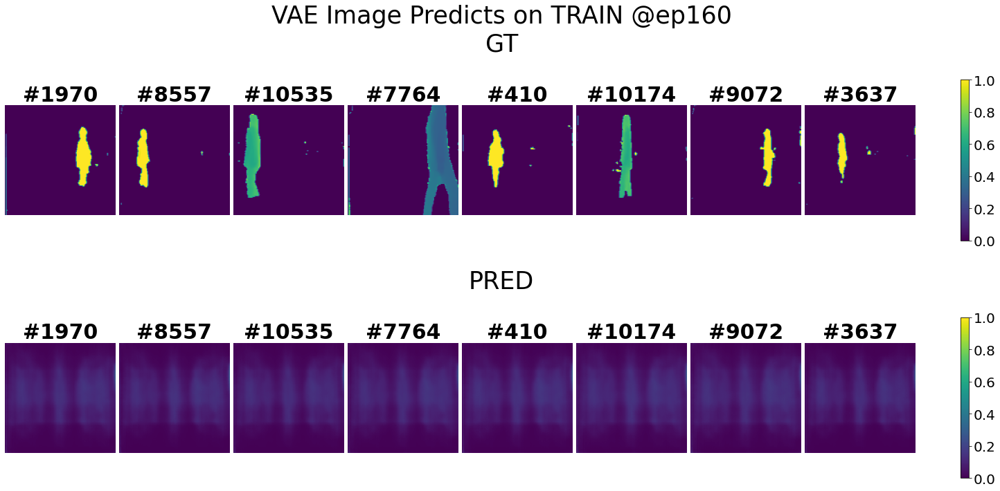

<Figure size 1440x720 with 0 Axes>

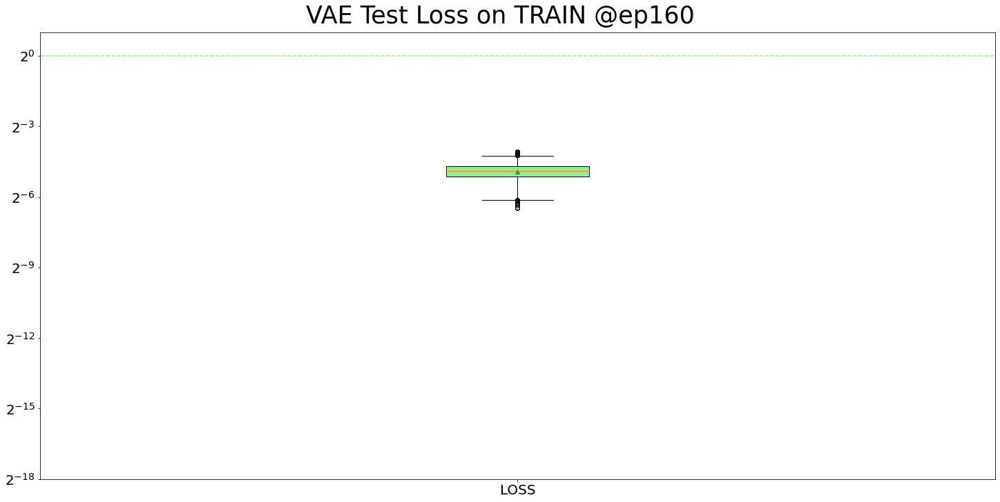

<Figure size 1440x720 with 0 Axes>

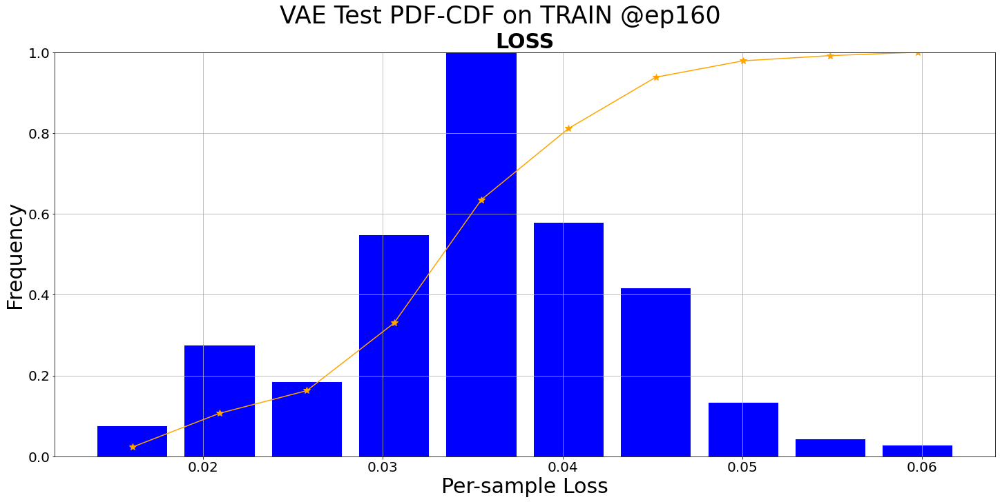

<Figure size 1440x720 with 0 Axes>

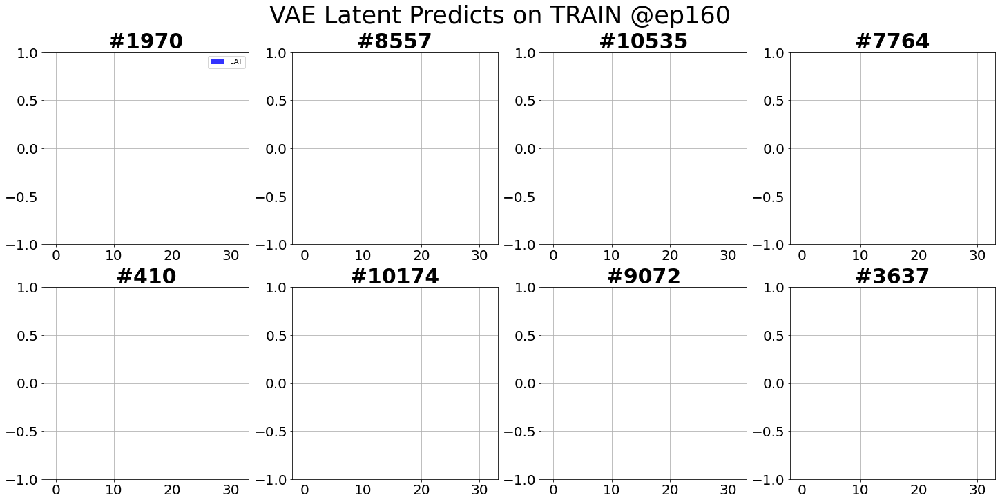

VAE valid: epoch=9/10, batch=15/17, current best valid loss=0.0005        .0005    
Total training time: 37.74980664253235 sec
VAE test: sample=15/17, loss=0.0294    
Test finished. Average loss={'LOSS': 0.033124151178259016}

Total training time: 3.11830735206604 sec


<Figure size 1440x720 with 0 Axes>

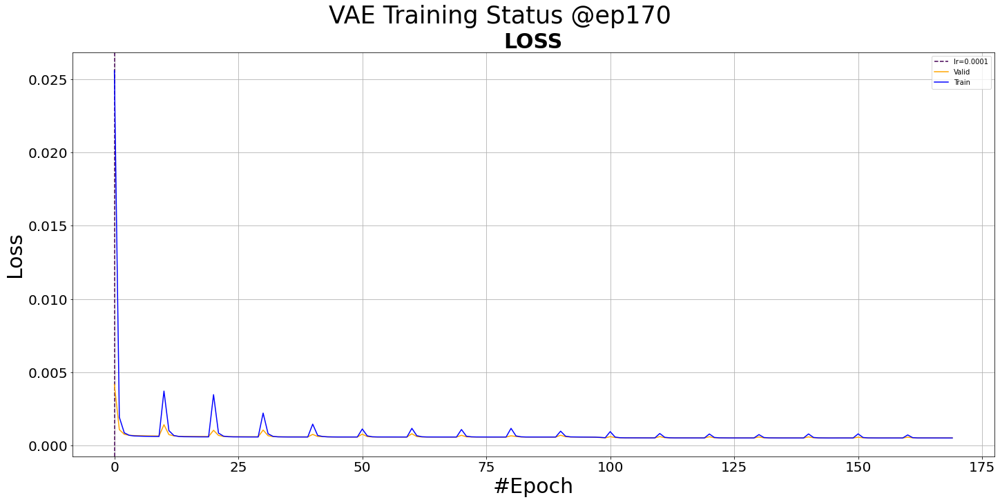

<Figure size 1440x720 with 0 Axes>

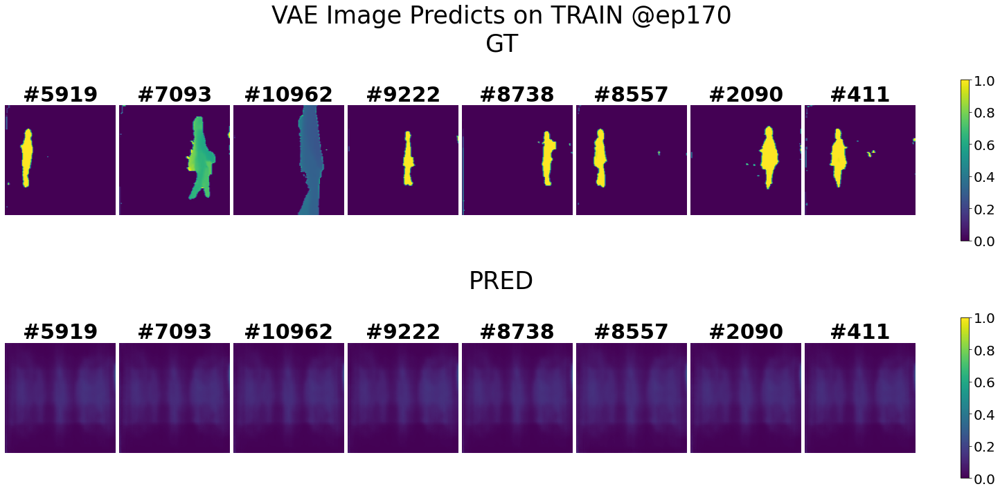

<Figure size 1440x720 with 0 Axes>

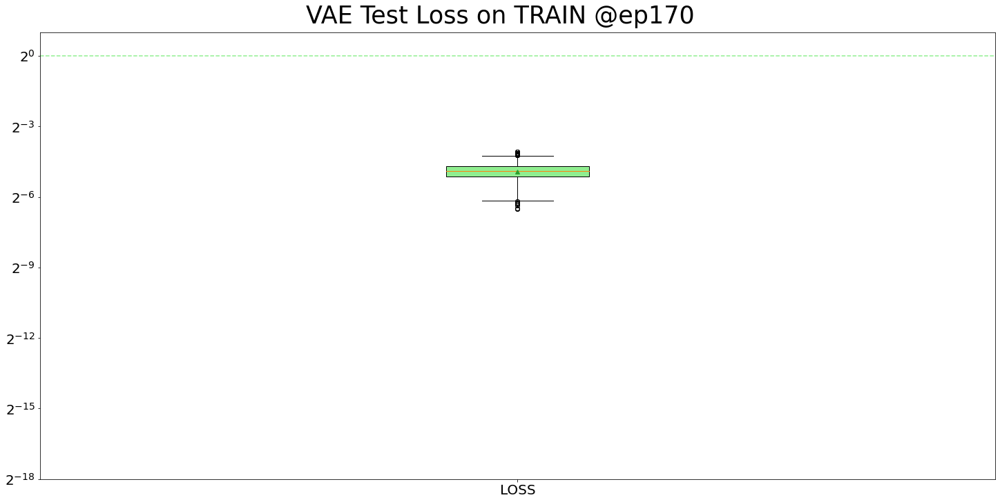

<Figure size 1440x720 with 0 Axes>

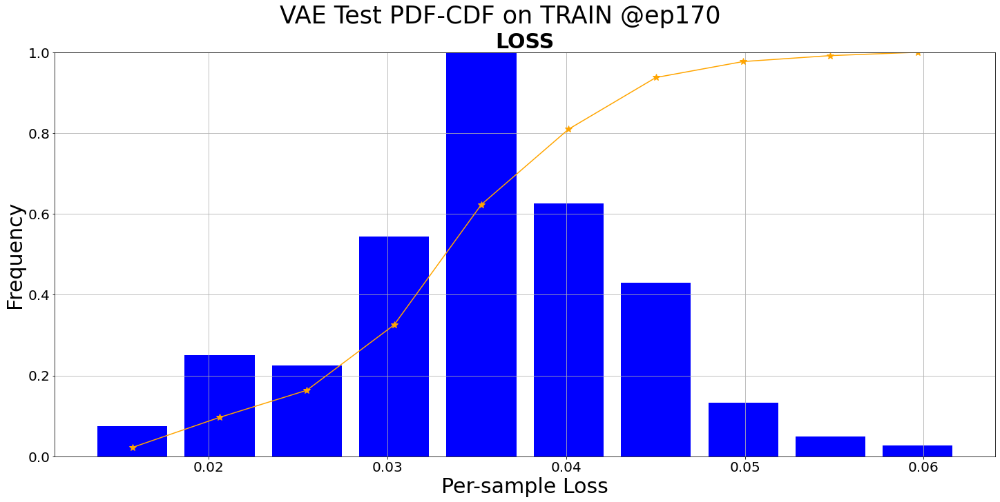

<Figure size 1440x720 with 0 Axes>

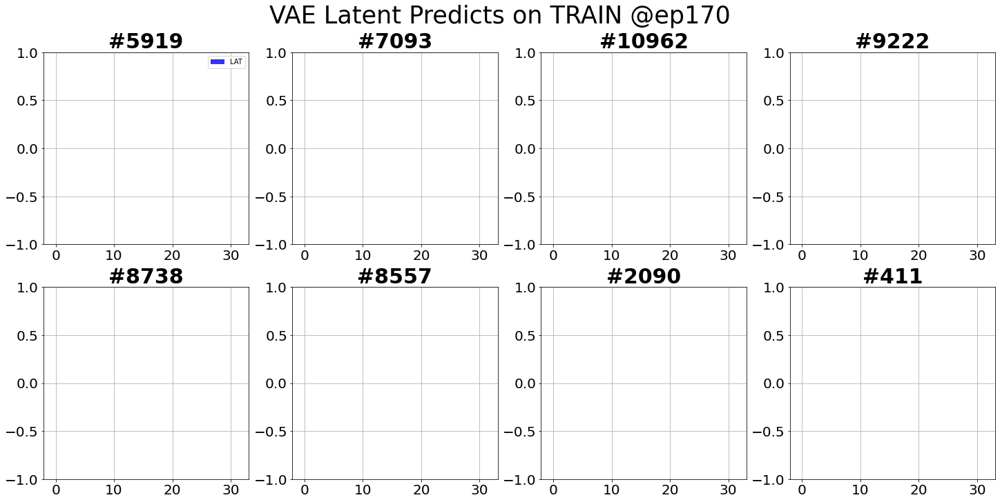

VAE valid: epoch=9/10, batch=15/17, current best valid loss=0.0005        .0005    
Total training time: 42.38749051094055 sec
VAE test: sample=15/17, loss=0.0351    
Test finished. Average loss={'LOSS': 0.03316279352978146}

Total training time: 3.1352837085723877 sec


<Figure size 1440x720 with 0 Axes>

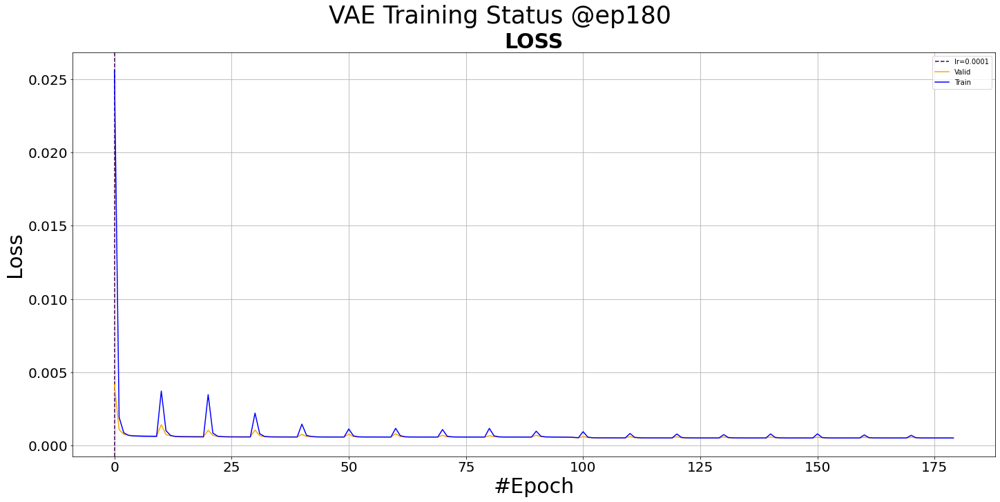

<Figure size 1440x720 with 0 Axes>

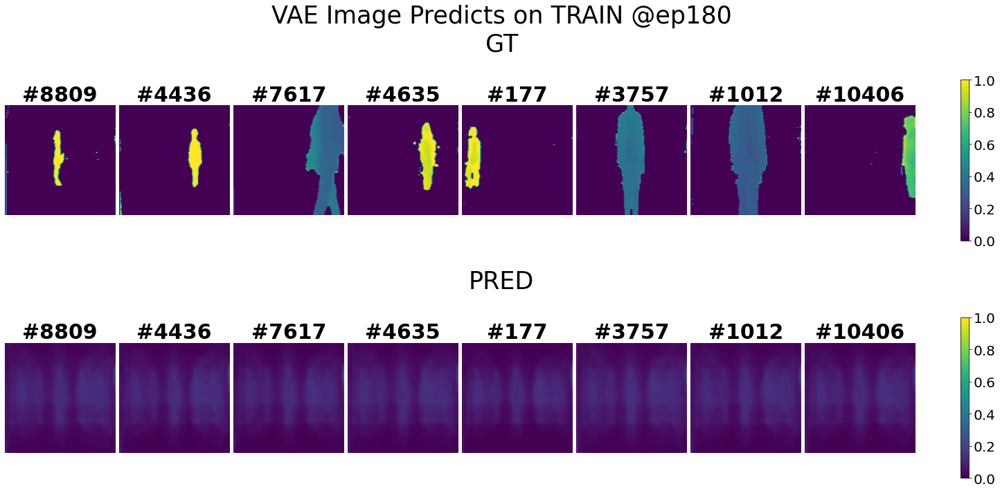

<Figure size 1440x720 with 0 Axes>

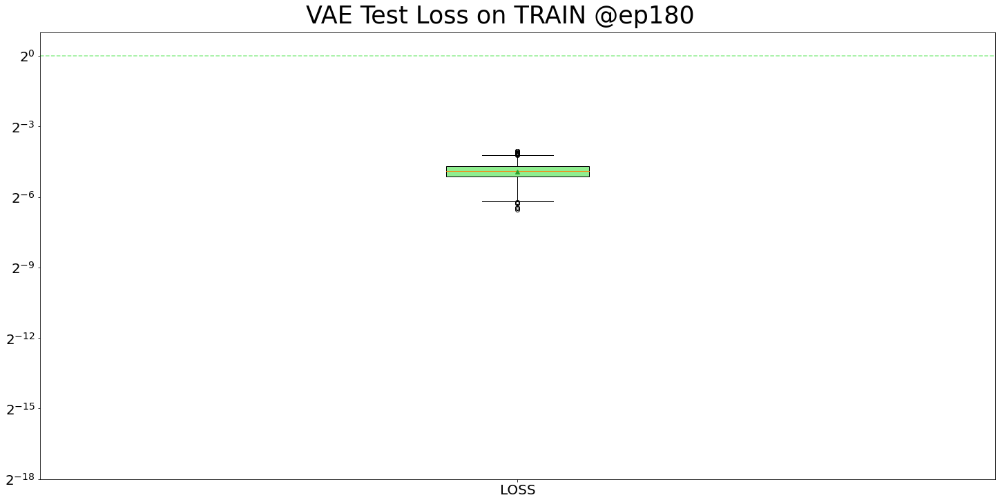

<Figure size 1440x720 with 0 Axes>

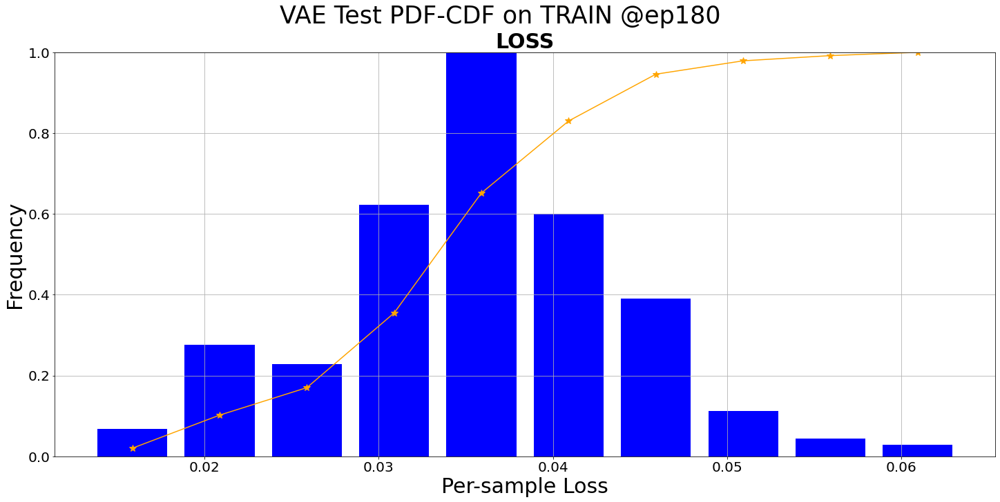

<Figure size 1440x720 with 0 Axes>

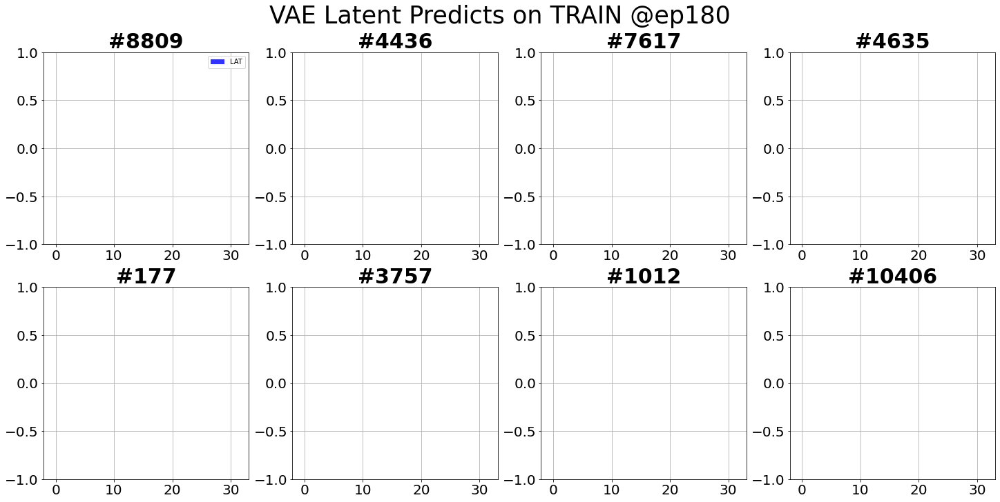

VAE valid: epoch=9/10, batch=15/17, current best valid loss=0.0005        .0005    
Total training time: 99.57147550582886 sec
VAE test: sample=15/17, loss=0.0362    
Test finished. Average loss={'LOSS': 0.033102908289840666}

Total training time: 3.049746036529541 sec


<Figure size 1440x720 with 0 Axes>

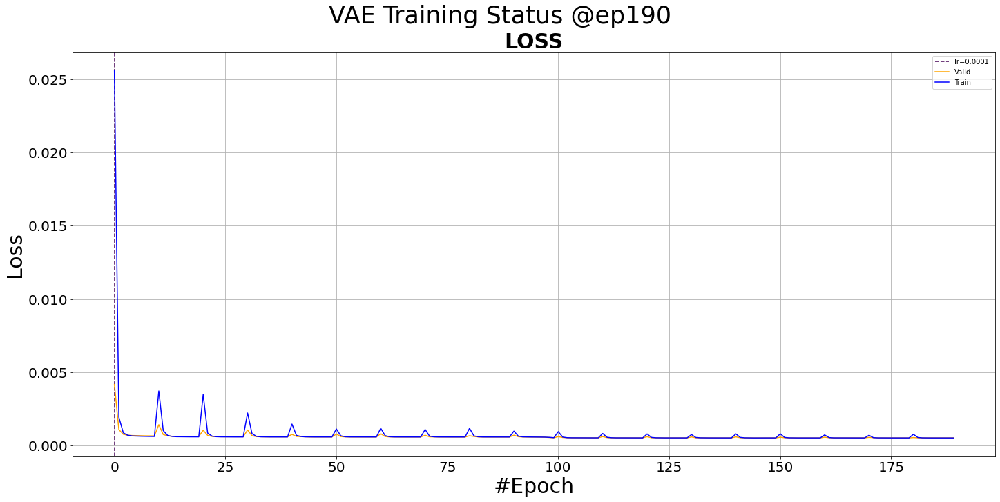

<Figure size 1440x720 with 0 Axes>

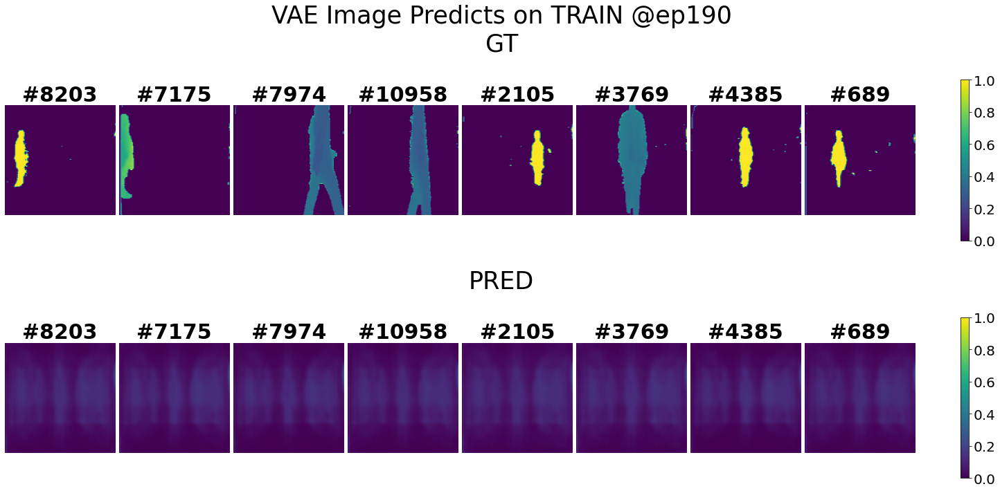

<Figure size 1440x720 with 0 Axes>

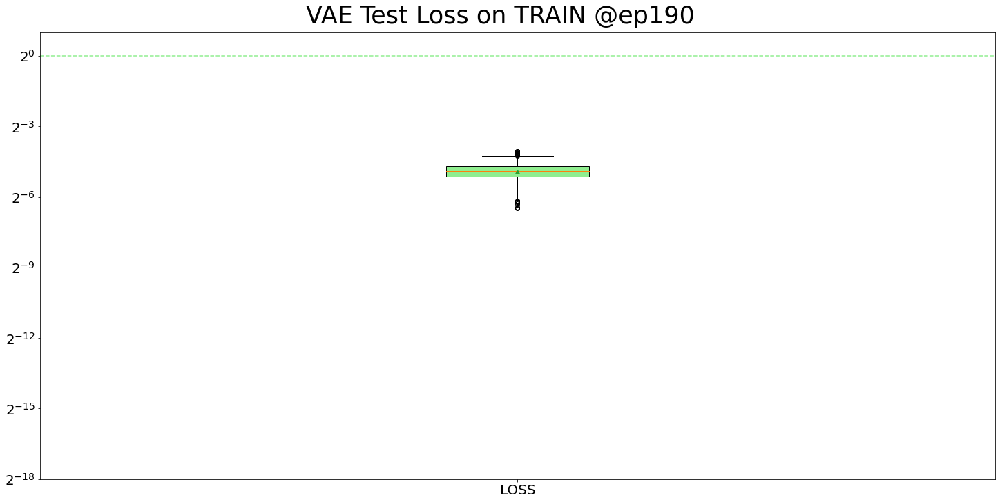

<Figure size 1440x720 with 0 Axes>

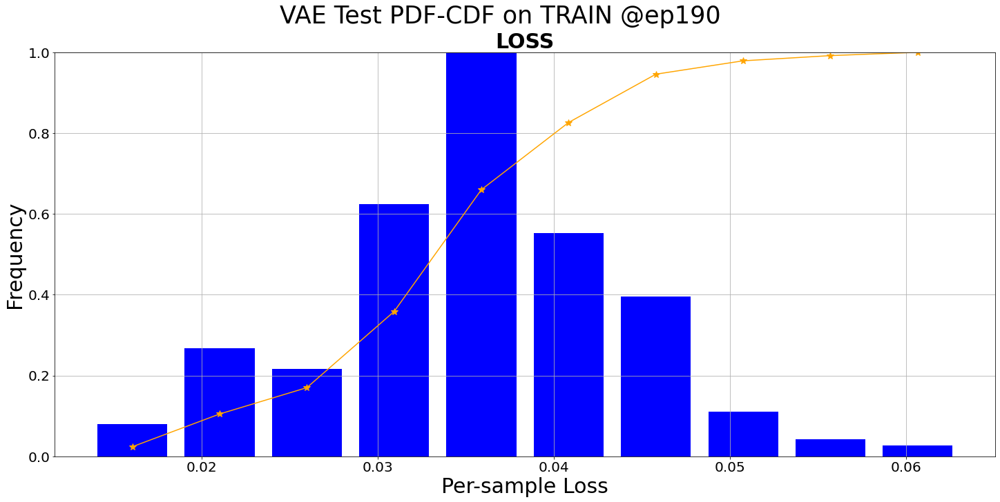

<Figure size 1440x720 with 0 Axes>

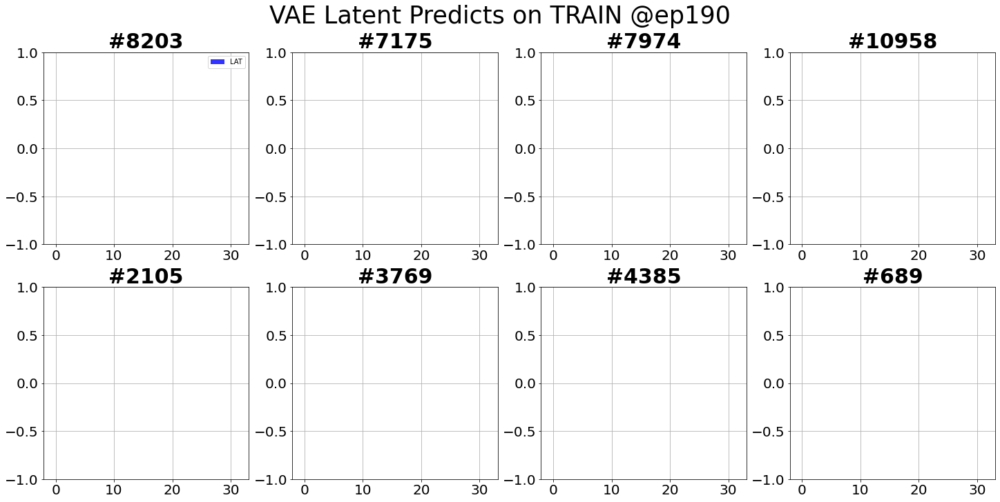

VAE valid: epoch=9/10, batch=15/17, current best valid loss=0.0005        .0005    
Total training time: 183.32997870445251 sec
VAE test: sample=15/17, loss=0.0364    
Test finished. Average loss={'LOSS': 0.03310388011724332}

Total training time: 3.0642855167388916 sec


<Figure size 1440x720 with 0 Axes>

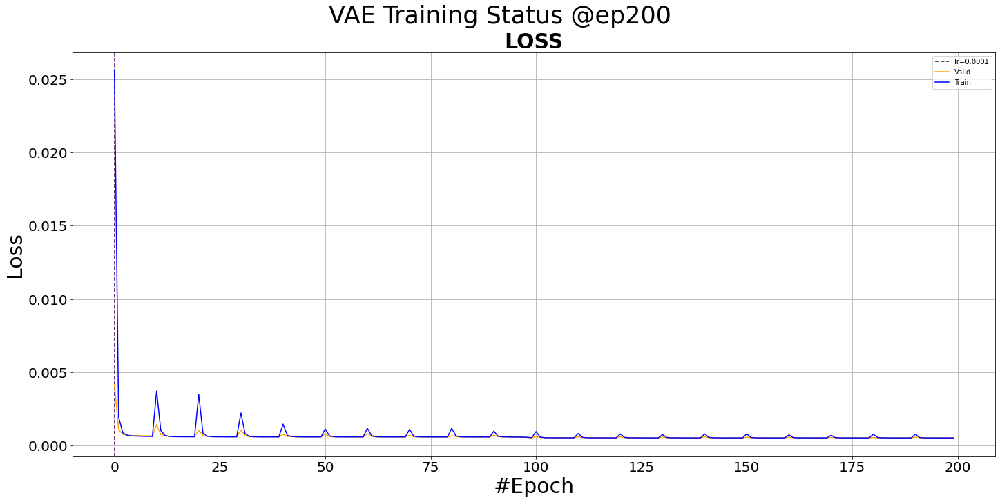

<Figure size 1440x720 with 0 Axes>

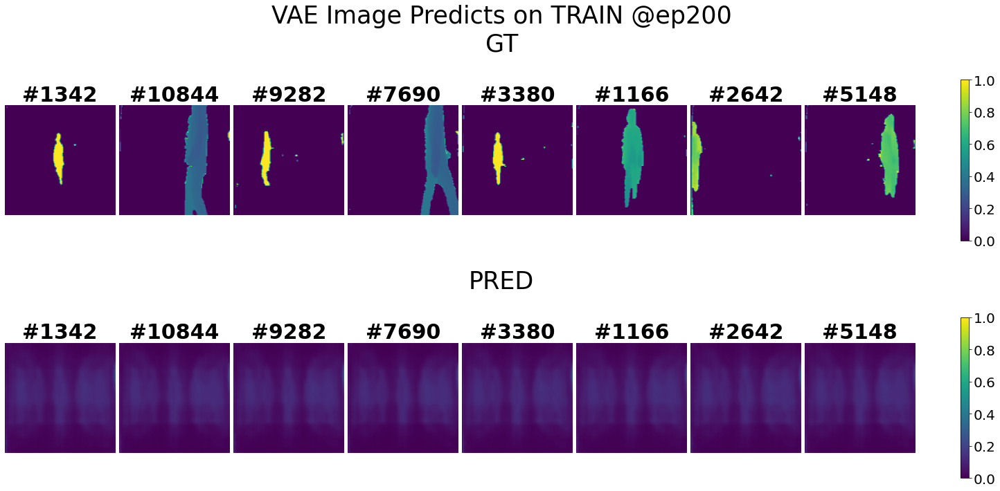

<Figure size 1440x720 with 0 Axes>

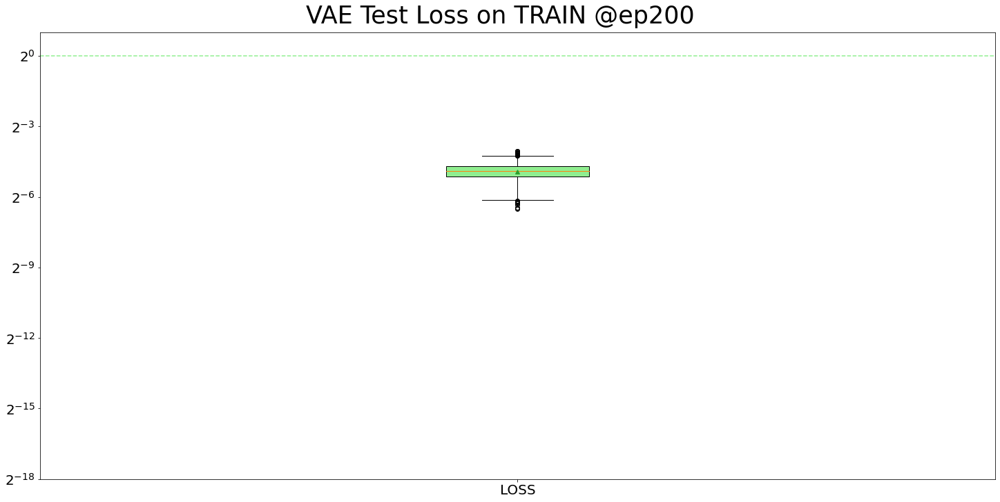

<Figure size 1440x720 with 0 Axes>

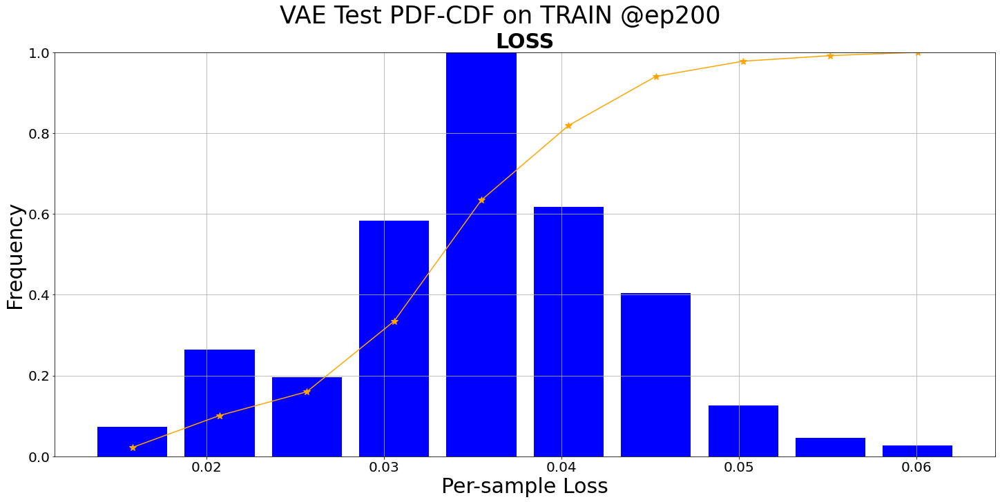

<Figure size 1440x720 with 0 Axes>

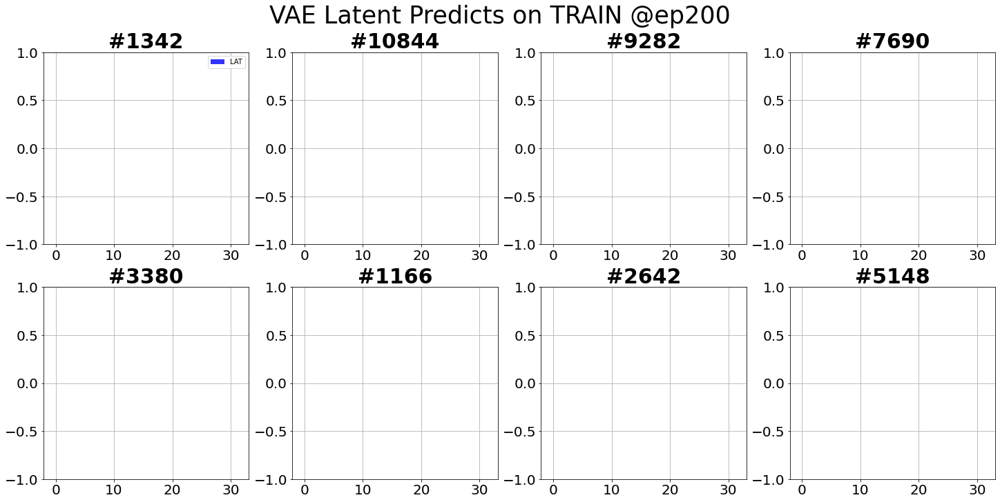


Schedule Completed!


In [15]:
# Training and Testing
%matplotlib inline
# trainer_vae.lr = 1e-3
trainer_vae.scheduler(turns=10,
                  test_loader='train', select_num=8,
                  autosave=True, notion=f"{date_run}VAE", save_model=False)

VAE test: sample=8790/8792, loss=0.0335    
Test finished. Average loss={'LOSS': 0.03307065673503394}

Total training time: 29.899617671966553 sec


<Figure size 1440x720 with 0 Axes>

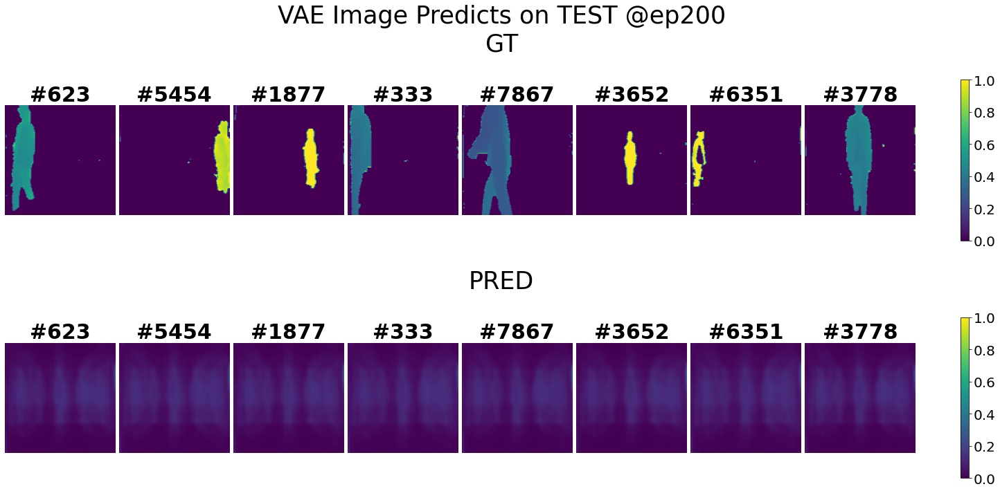

<Figure size 1440x720 with 0 Axes>

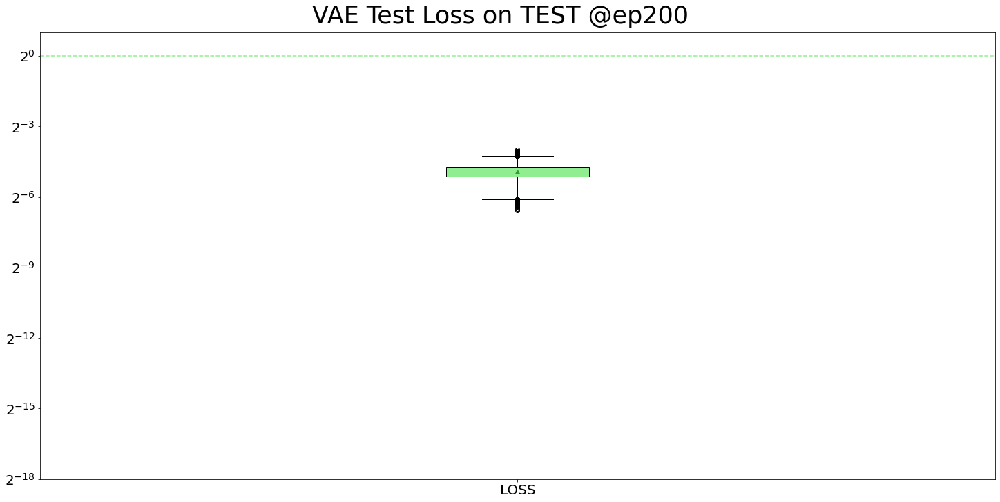

<Figure size 1440x720 with 0 Axes>

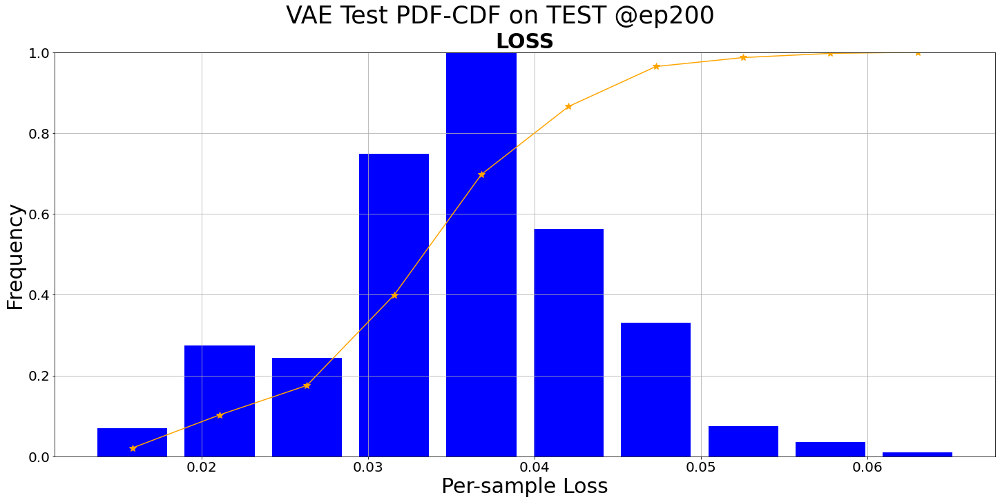

<Figure size 1440x720 with 0 Axes>

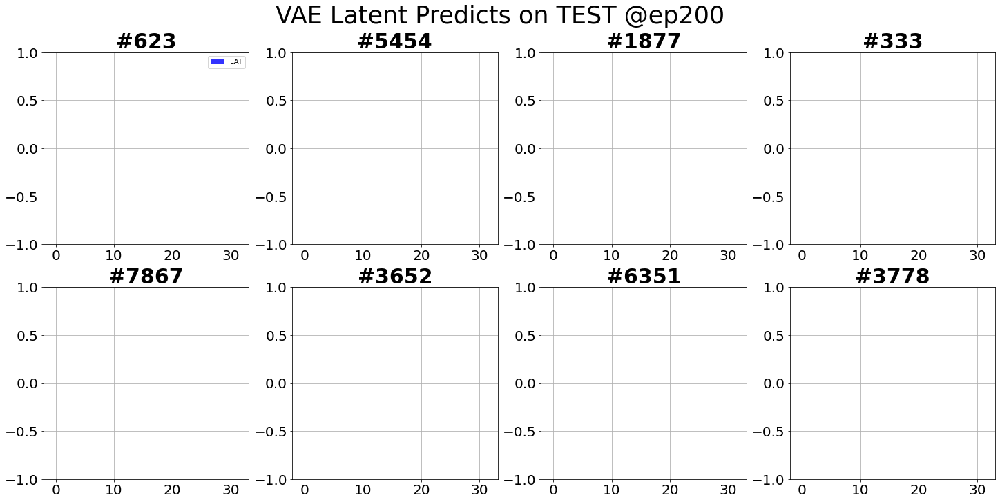

In [16]:
trainer_vae.test(mode='test')
trainer_vae.plot_test(select_num=8, autosave=True, notion=f"{date_run}VAE")

In [17]:
trainer_vae.save(f"{date_run}VAE")

Saving models...
Saving csien...
Saving imgde...
All saved!


In [18]:
trainer_vae.loss.save('pred', f"{date_run}VAE")

Saving pred including GT, PRED, LAT, IND...Done


### Teacher-Student AE

#### Teacher

In [24]:
torch.cuda.set_device(gpu)
imgencoder = TP.ImageEncoder(latent_dim=16)
imgdecoder = TP.ImageDecoder(latent_dim=16)
trainer_ts_t = TP.CompTrainer(name='Teacher', mode='ae_t', mask=False,
                              networks=[imgencoder, imgdecoder],
                 lr=1e-4, epochs=10, cuda=gpu,
                 train_loader=train_loader, valid_loader=valid_loader, test_loader=test_loader)

Teacher valid: epoch=9/10, batch=15/17, current best valid loss=0.0046        .0046    
Total training time: 41.37842679023743 sec
Teacher test: sample=15/17, loss=0.0019    
Test finished. Average loss={'LOSS': 0.004377710072838133}

Total training time: 3.733525037765503 sec


<Figure size 432x288 with 0 Axes>

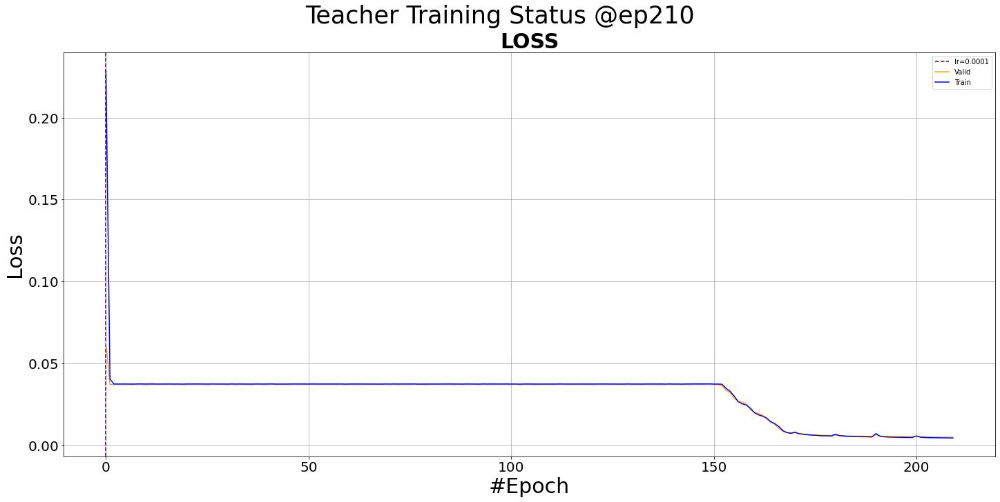

<Figure size 1440x720 with 0 Axes>

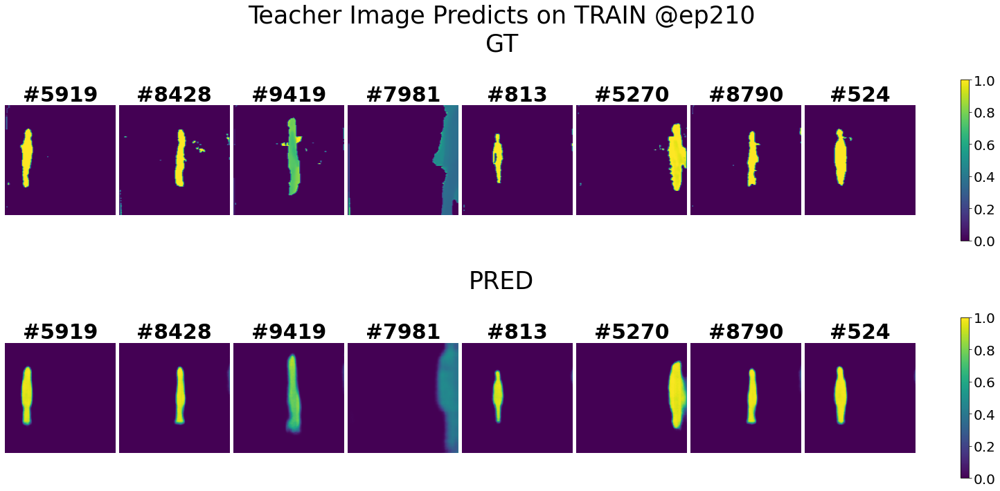

<Figure size 1440x720 with 0 Axes>

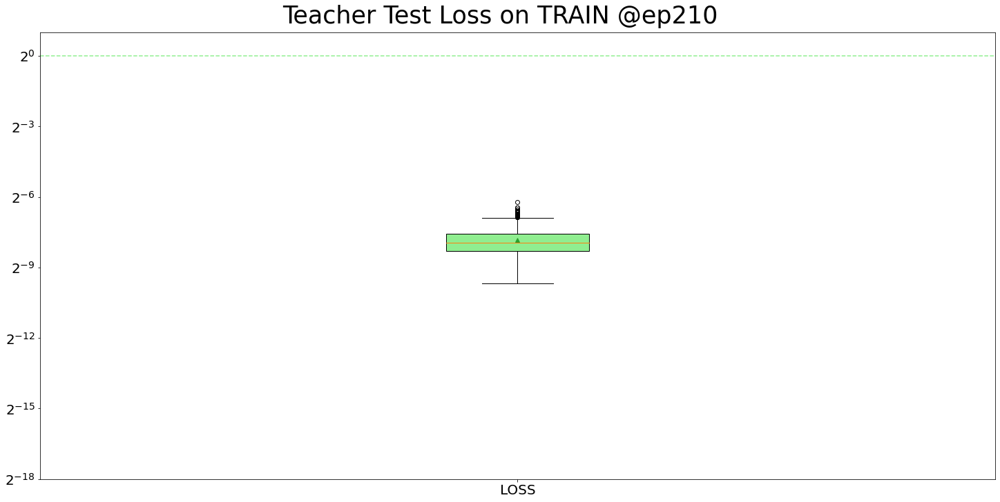

<Figure size 1440x720 with 0 Axes>

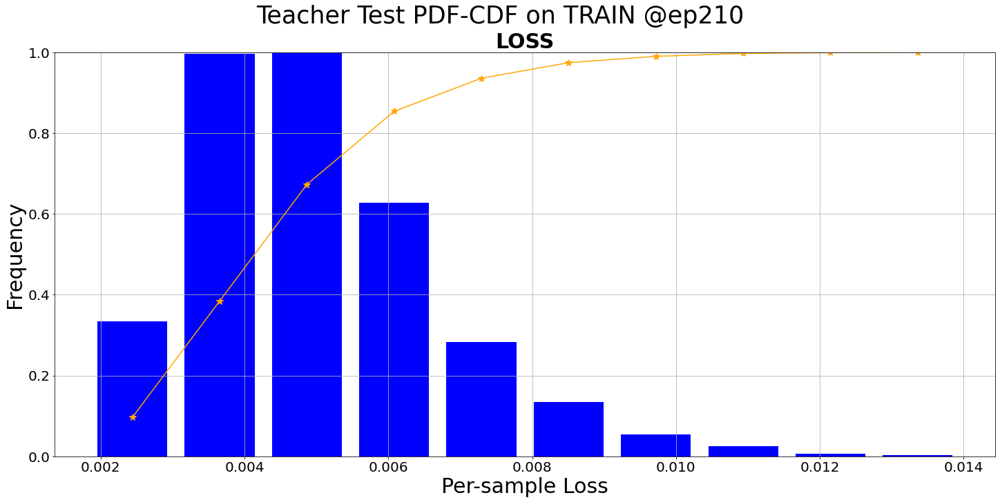

<Figure size 1440x720 with 0 Axes>

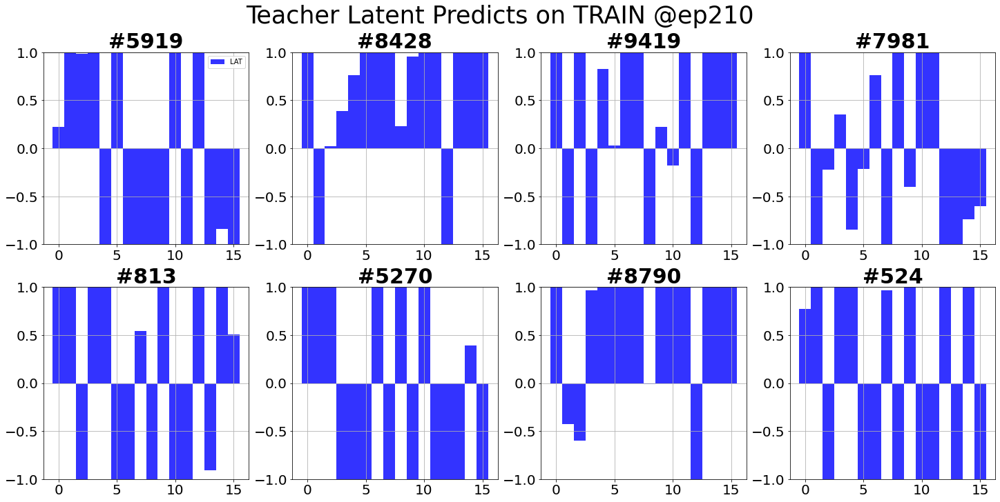

Teacher valid: epoch=9/10, batch=15/17, current best valid loss=0.0044        .0044    
Total training time: 45.544490337371826 sec
Teacher test: sample=15/17, loss=0.0031    
Test finished. Average loss={'LOSS': 0.004070920343485127}

Total training time: 3.7226996421813965 sec


<Figure size 1440x720 with 0 Axes>

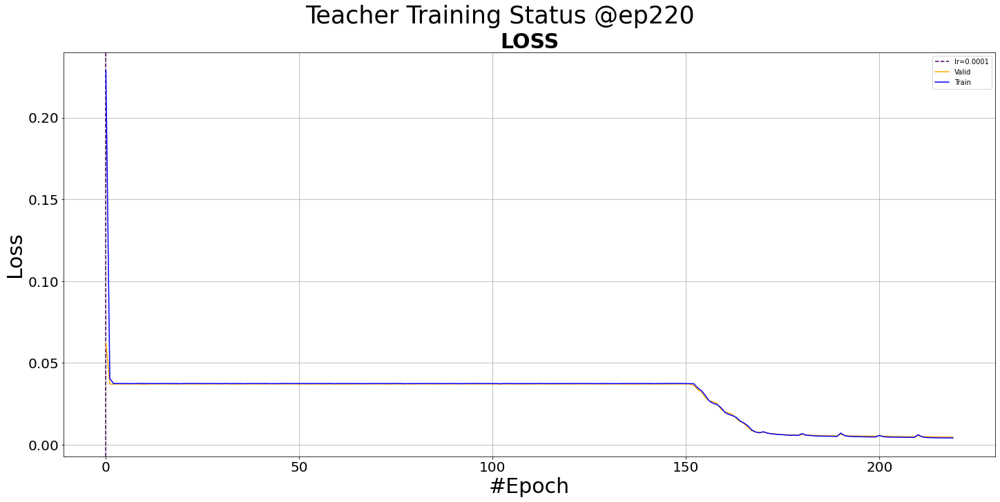

<Figure size 1440x720 with 0 Axes>

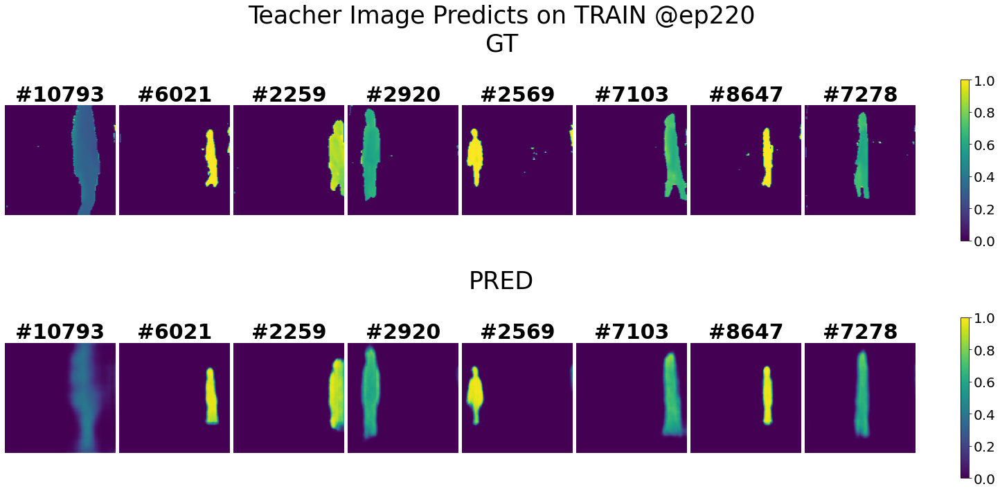

<Figure size 1440x720 with 0 Axes>

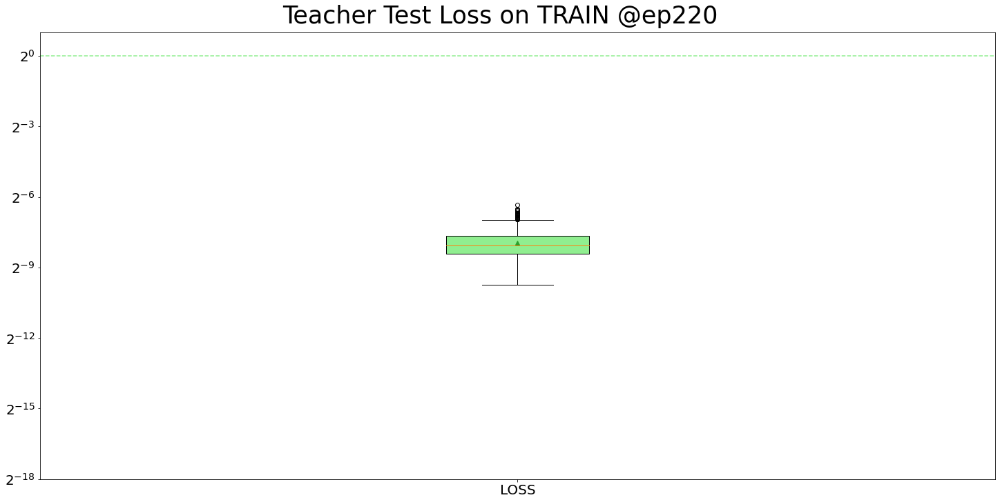

<Figure size 1440x720 with 0 Axes>

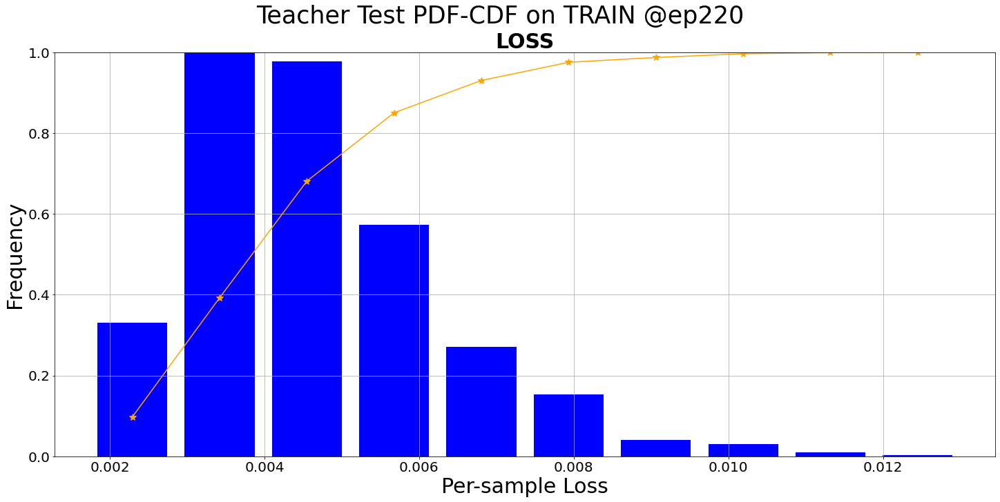

<Figure size 1440x720 with 0 Axes>

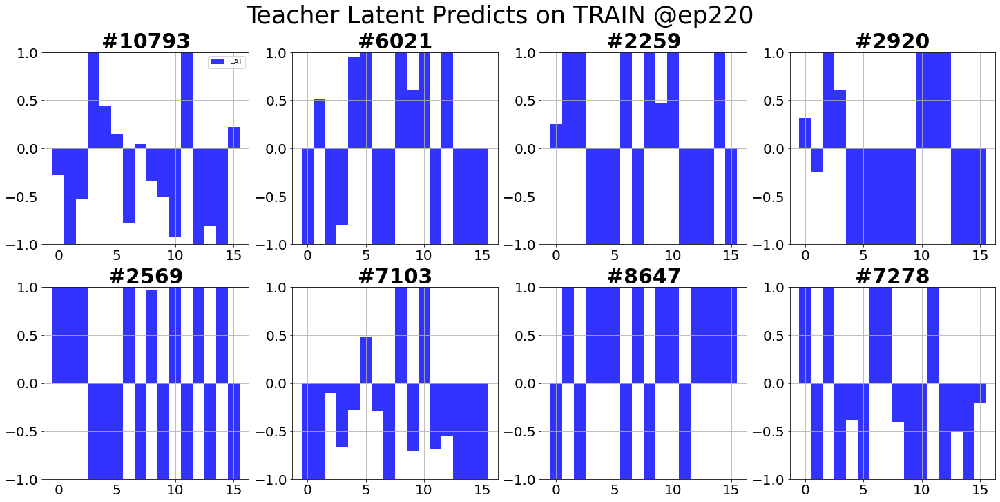

Teacher valid: epoch=9/10, batch=15/17, current best valid loss=0.0043        .0043    
Total training time: 42.29024577140808 sec
Teacher test: sample=15/17, loss=0.0044    
Test finished. Average loss={'LOSS': 0.003916112565895994}

Total training time: 3.700930595397949 sec


<Figure size 1440x720 with 0 Axes>

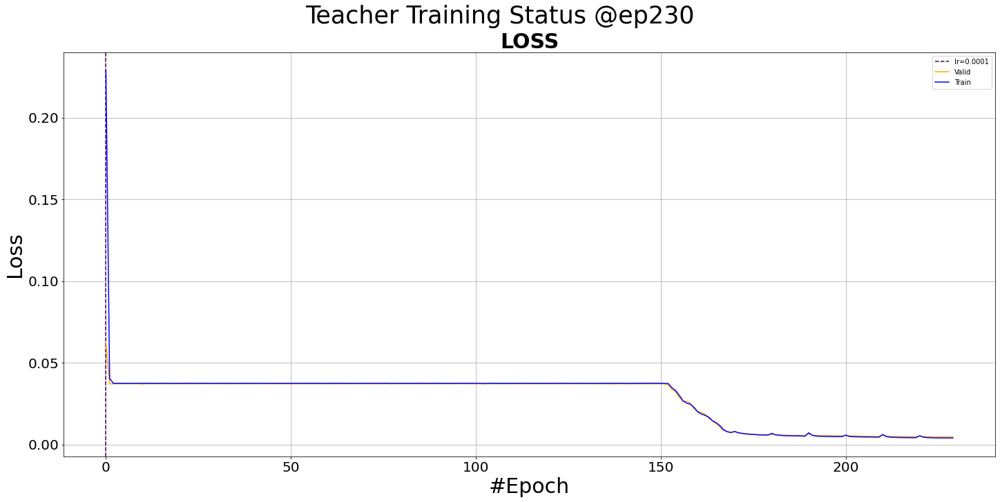

<Figure size 1440x720 with 0 Axes>

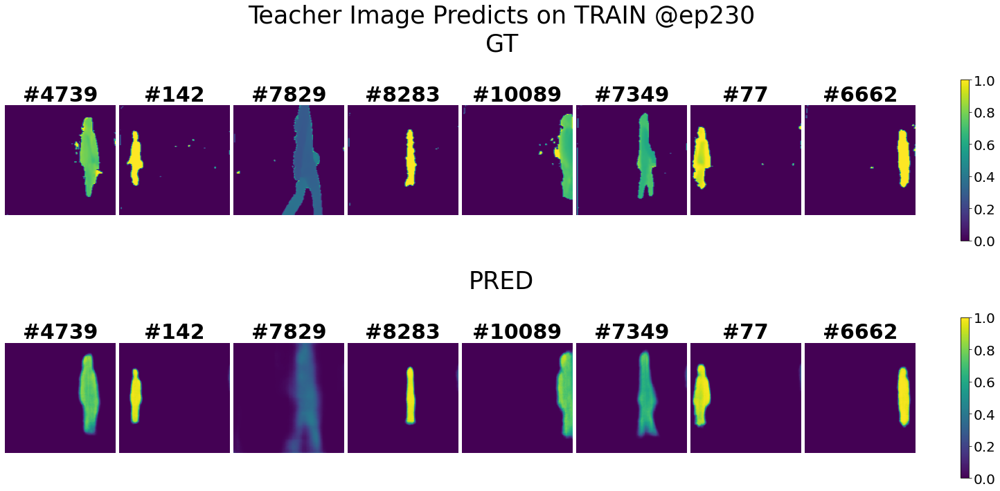

<Figure size 1440x720 with 0 Axes>

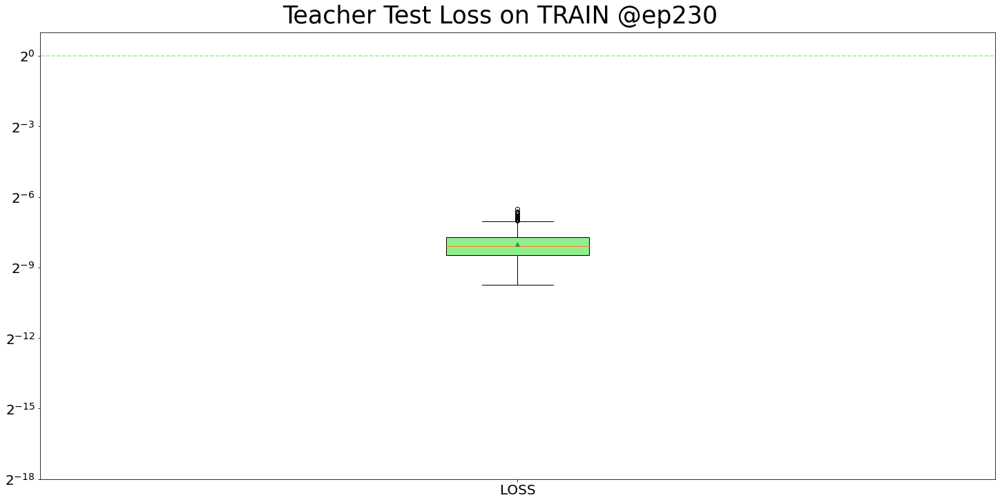

<Figure size 1440x720 with 0 Axes>

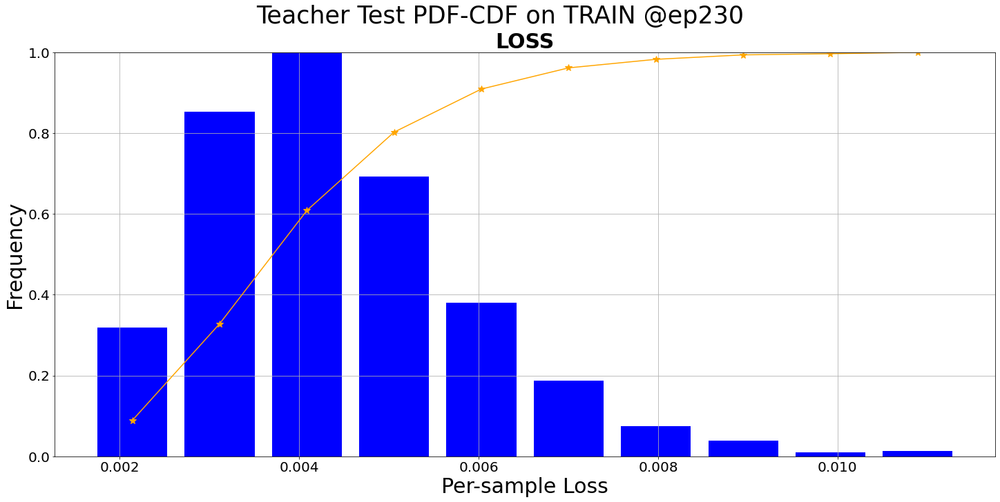

<Figure size 1440x720 with 0 Axes>

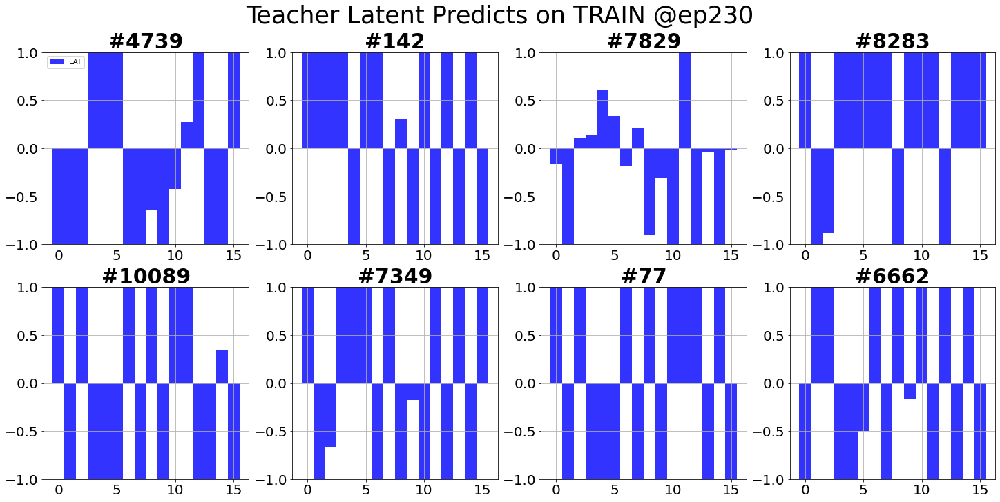

Teacher valid: epoch=9/10, batch=15/17, current best valid loss=0.0039        .0039    
Total training time: 47.50774693489075 sec
Teacher test: sample=15/17, loss=0.0065    
Test finished. Average loss={'LOSS': 0.003778720937535742}

Total training time: 3.709859609603882 sec


<Figure size 1440x720 with 0 Axes>

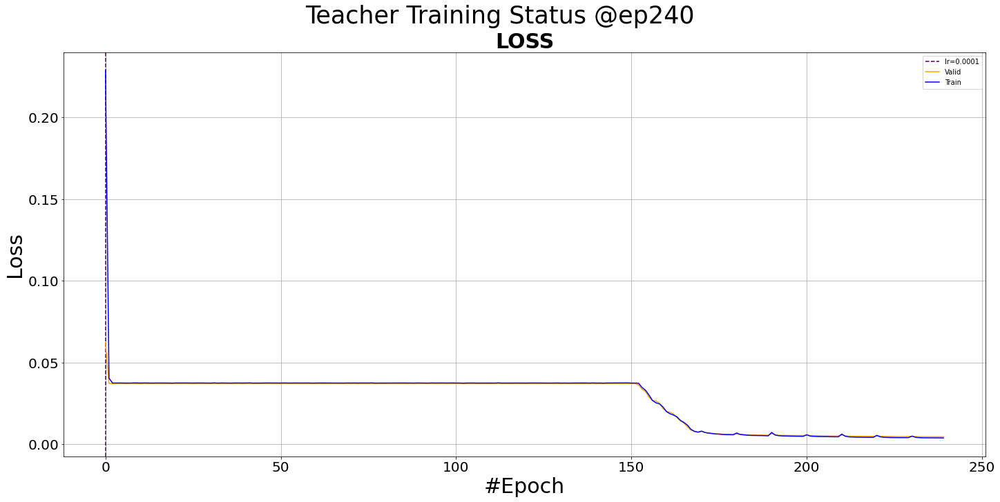

<Figure size 1440x720 with 0 Axes>

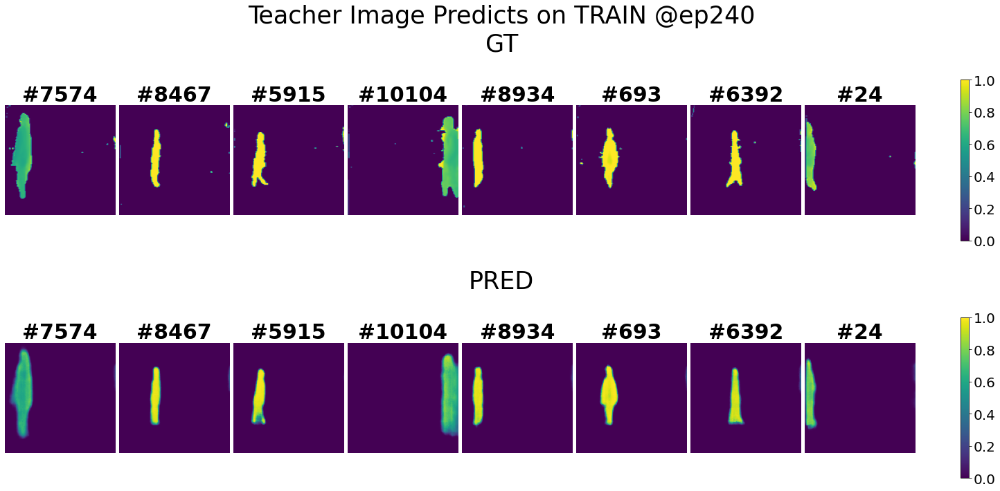

<Figure size 1440x720 with 0 Axes>

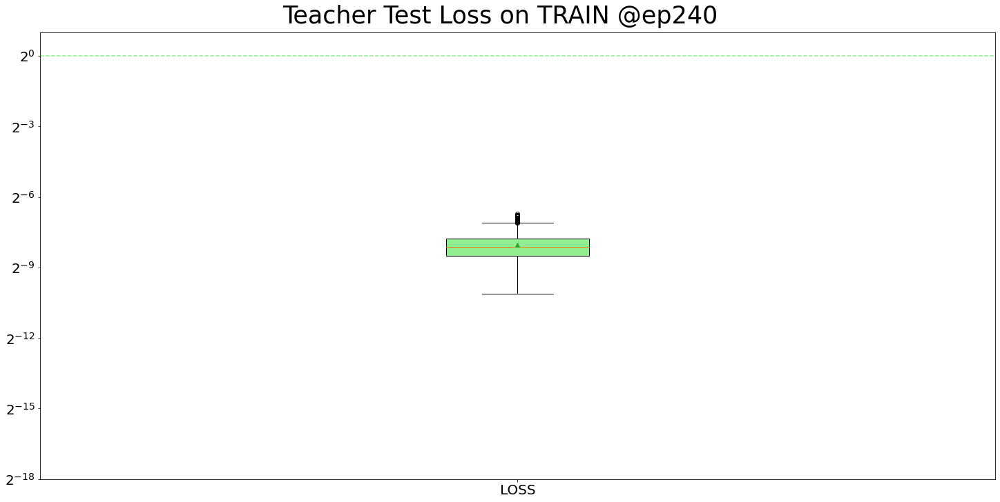

<Figure size 1440x720 with 0 Axes>

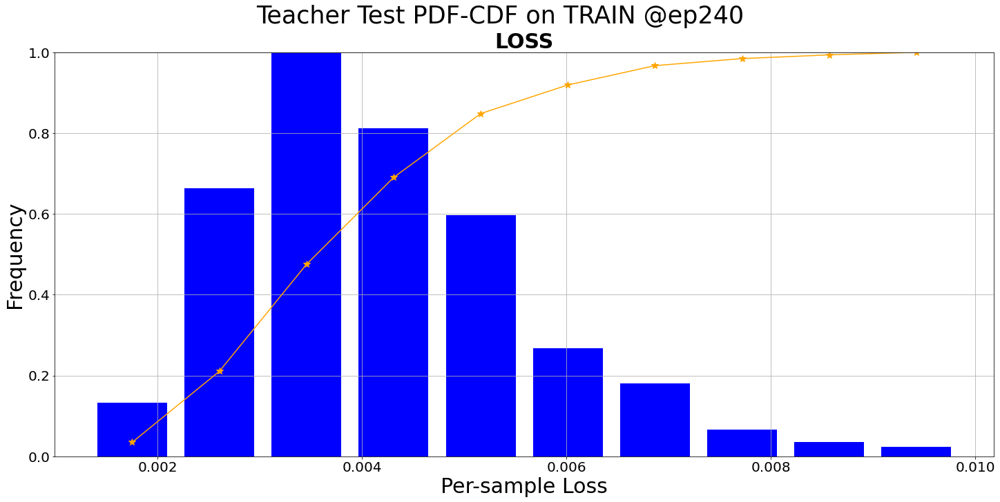

<Figure size 1440x720 with 0 Axes>

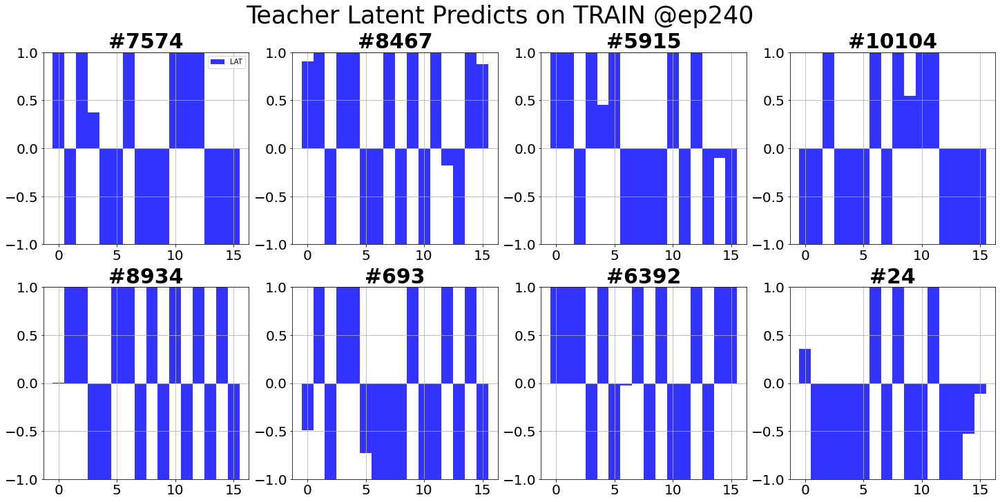

Teacher valid: epoch=9/10, batch=15/17, current best valid loss=0.0039        .0039    
Total training time: 42.83503770828247 sec
Teacher test: sample=15/17, loss=0.0041    
Test finished. Average loss={'LOSS': 0.0034663768086401806}

Total training time: 3.6847872734069824 sec


<Figure size 1440x720 with 0 Axes>

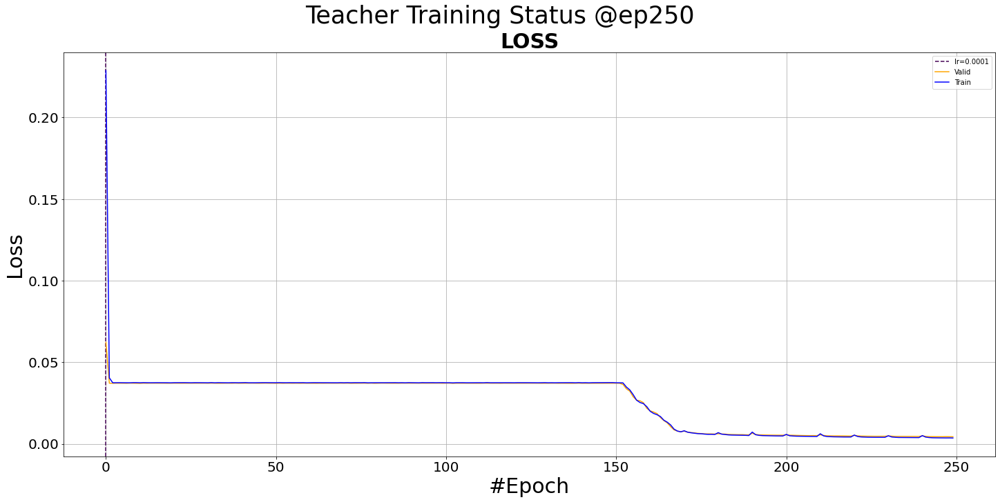

<Figure size 1440x720 with 0 Axes>

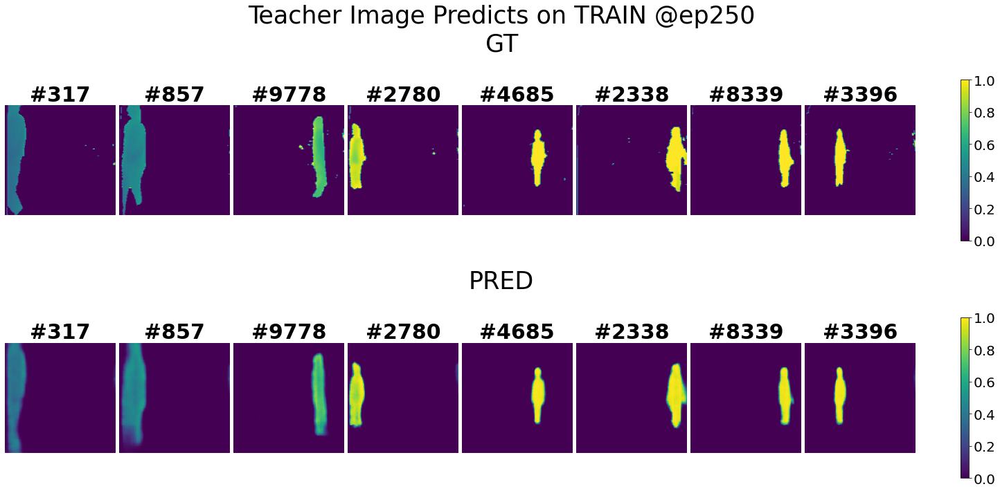

<Figure size 1440x720 with 0 Axes>

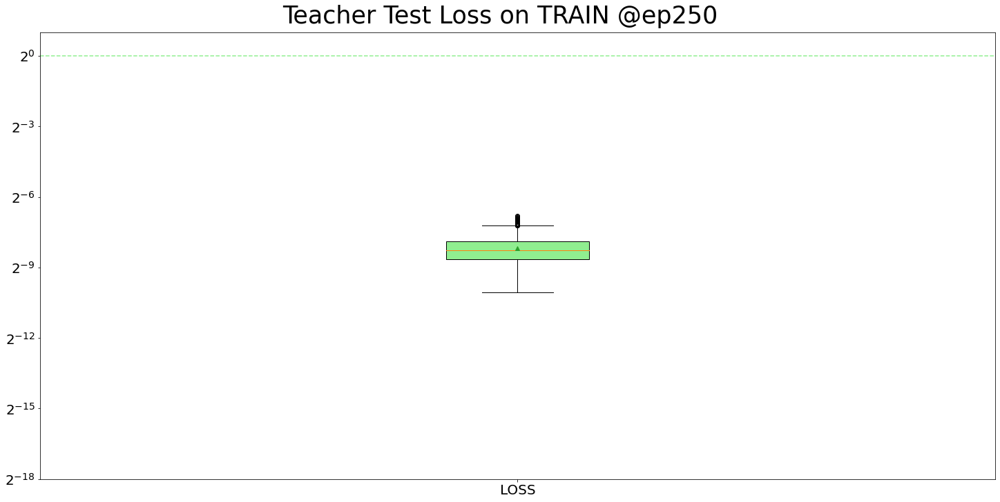

<Figure size 1440x720 with 0 Axes>

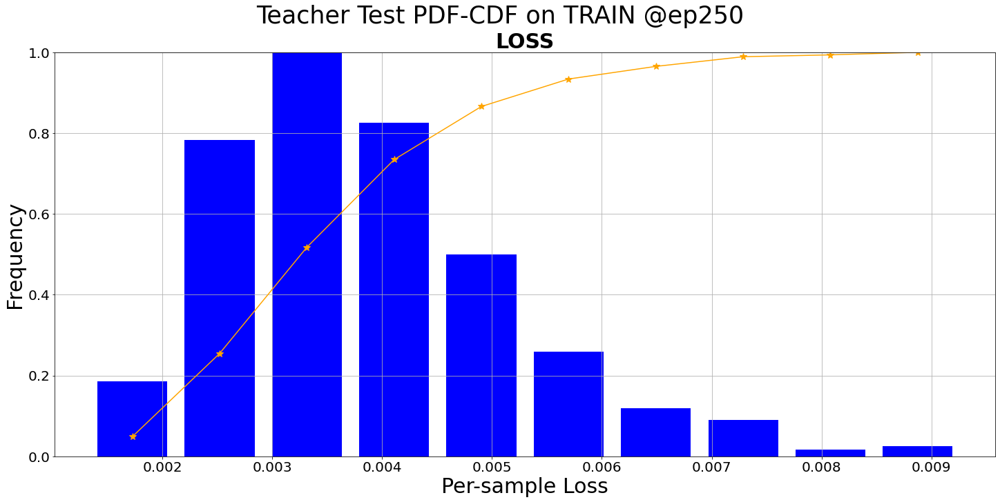

<Figure size 1440x720 with 0 Axes>

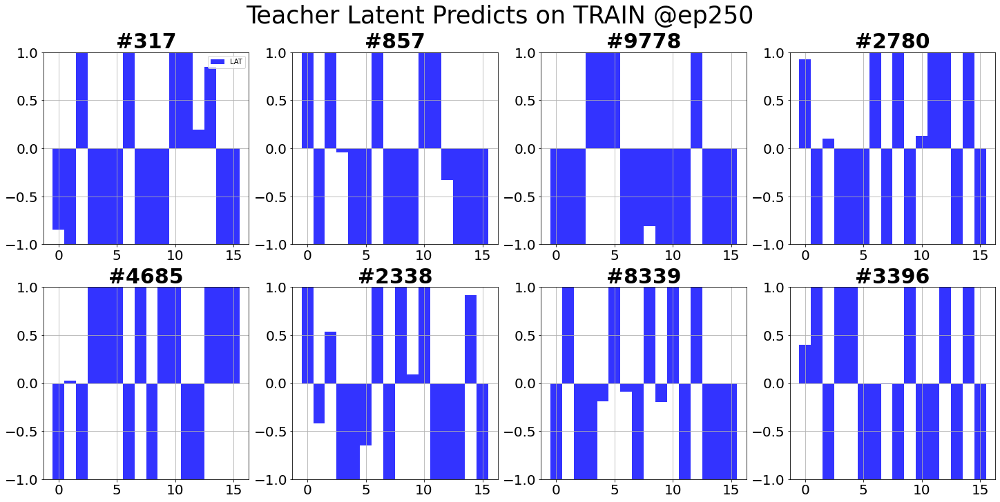

Teacher valid: epoch=9/10, batch=15/17, current best valid loss=0.0039        .0039    
Total training time: 42.484801292419434 sec
Teacher test: sample=15/17, loss=0.0021    
Test finished. Average loss={'LOSS': 0.0033371371265970727}

Total training time: 3.6832199096679688 sec


<Figure size 1440x720 with 0 Axes>

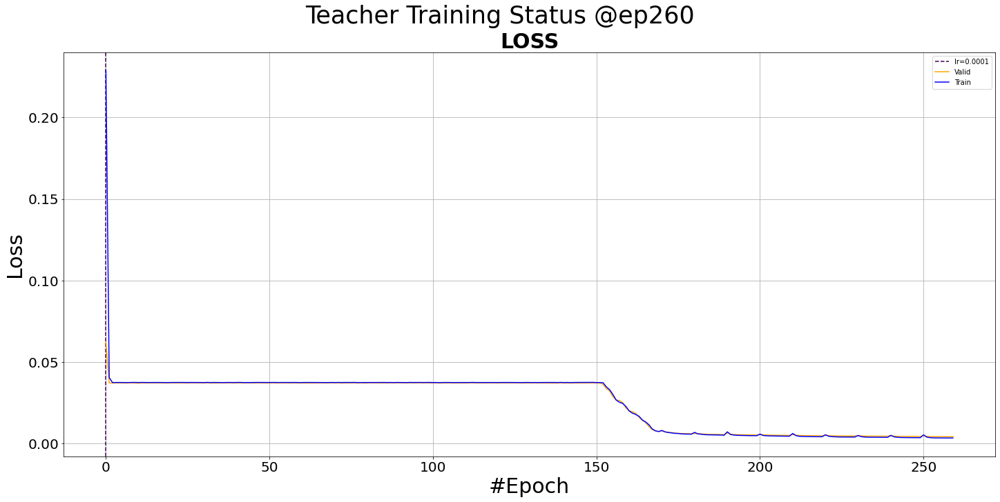

<Figure size 1440x720 with 0 Axes>

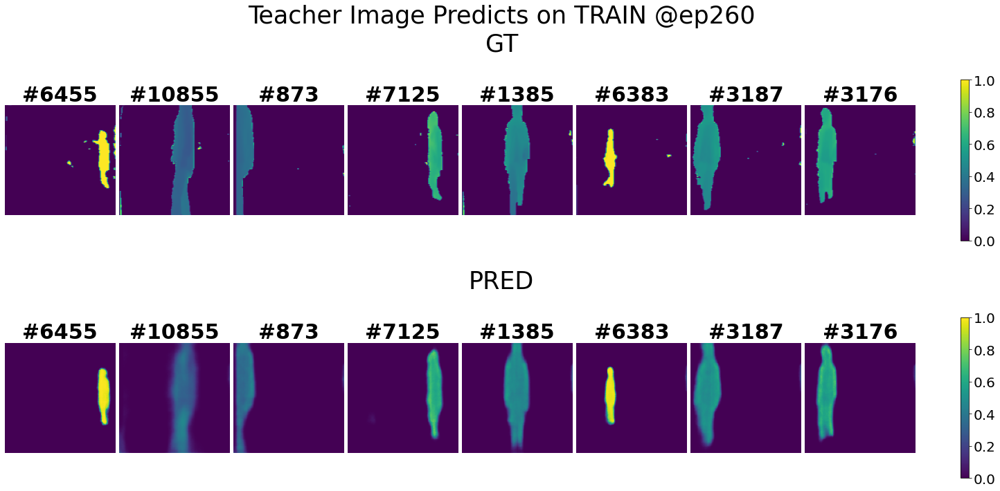

<Figure size 1440x720 with 0 Axes>

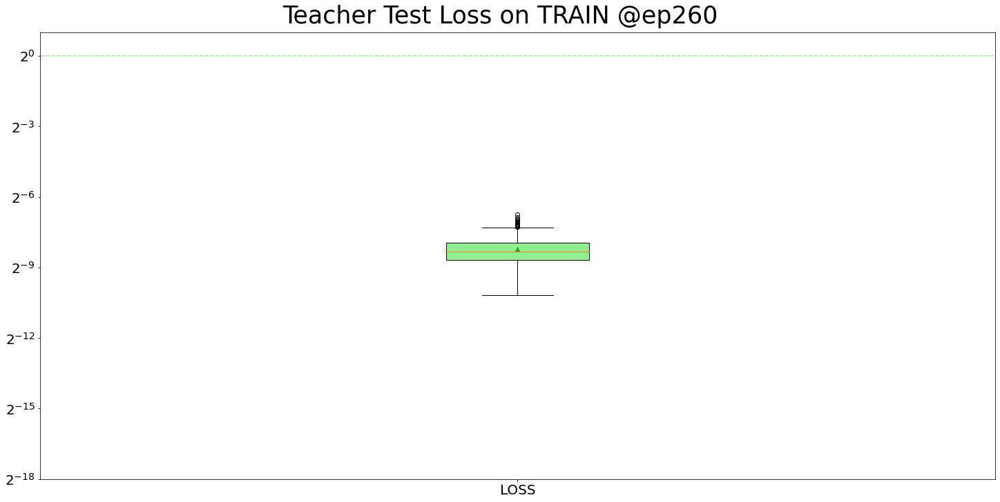

<Figure size 1440x720 with 0 Axes>

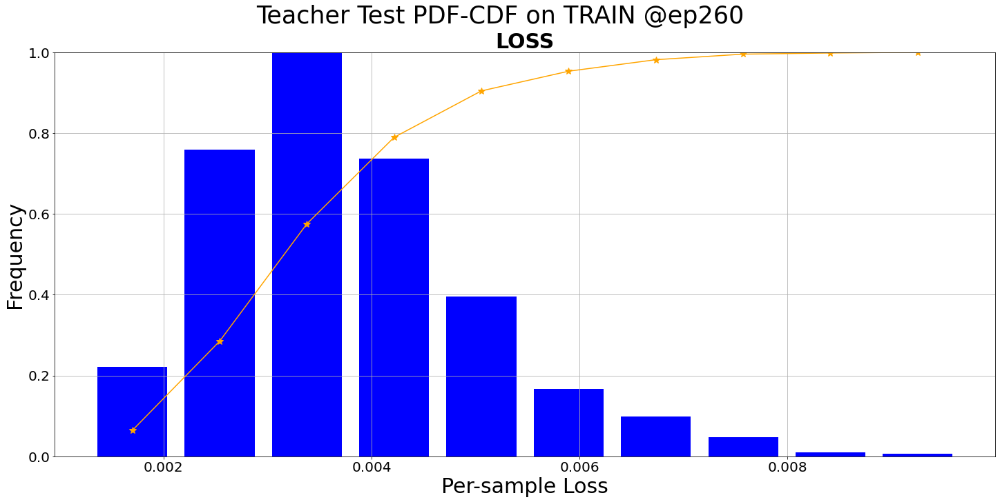

<Figure size 1440x720 with 0 Axes>

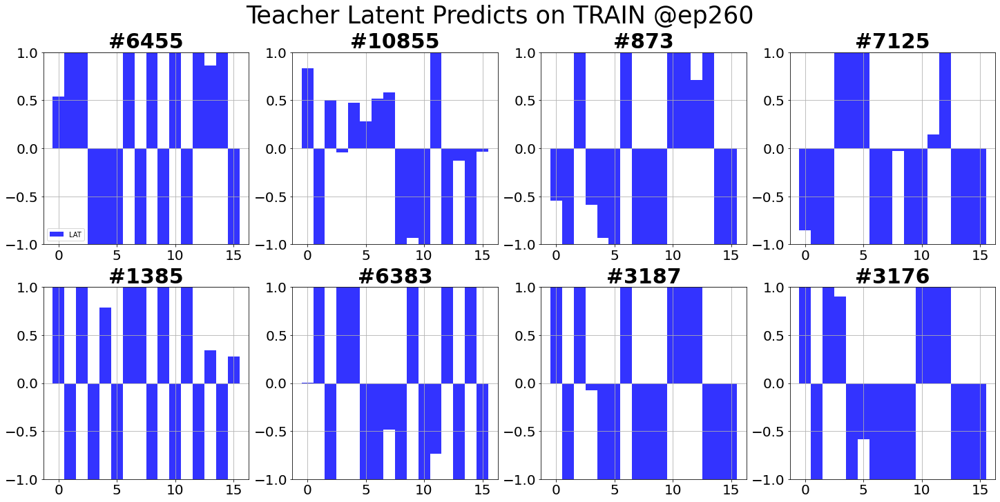

Teacher valid: epoch=9/10, batch=15/17, current best valid loss=0.0039        .0039    
Total training time: 47.20442295074463 sec
Teacher test: sample=15/17, loss=0.0033    
Test finished. Average loss={'LOSS': 0.003200377917731684}

Total training time: 3.673809289932251 sec


<Figure size 1440x720 with 0 Axes>

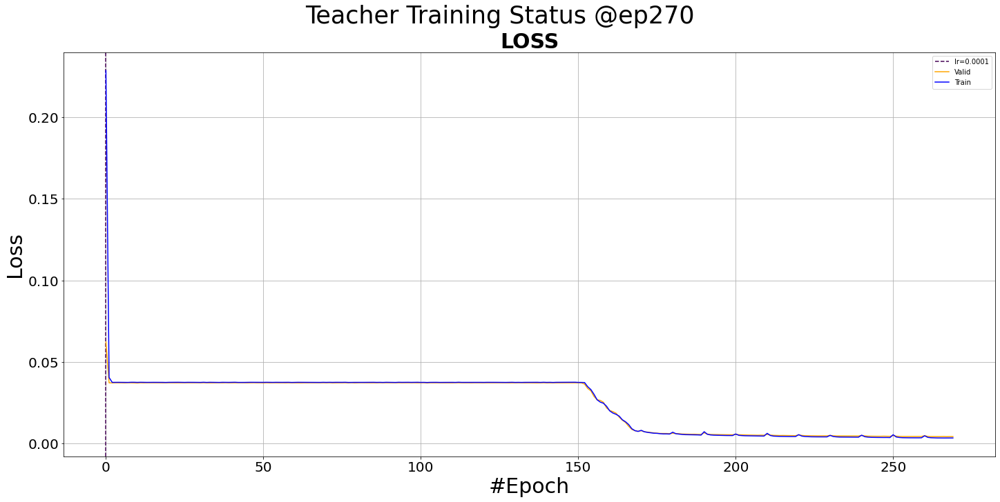

<Figure size 1440x720 with 0 Axes>

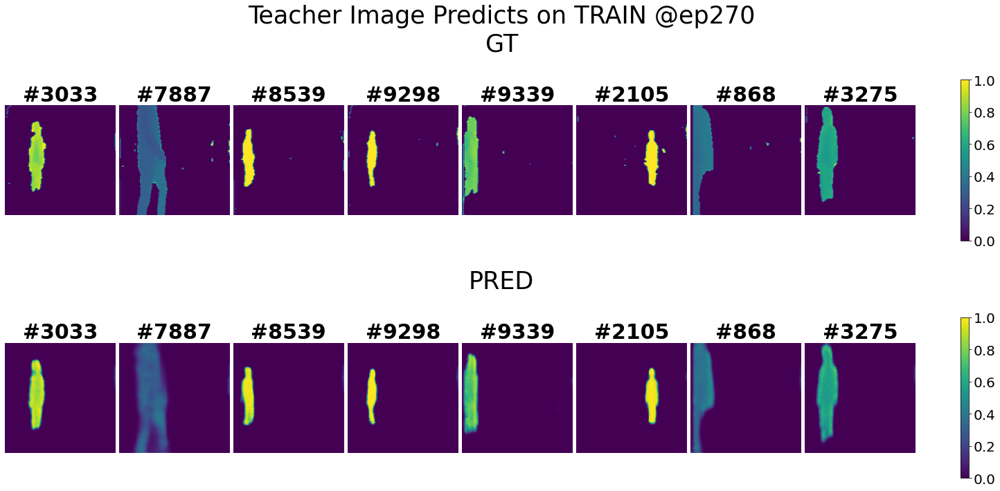

<Figure size 1440x720 with 0 Axes>

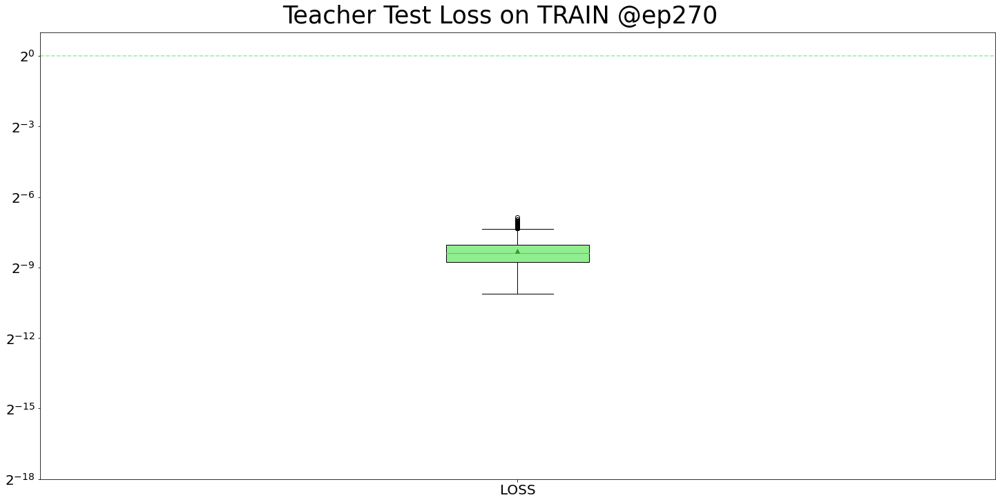

<Figure size 1440x720 with 0 Axes>

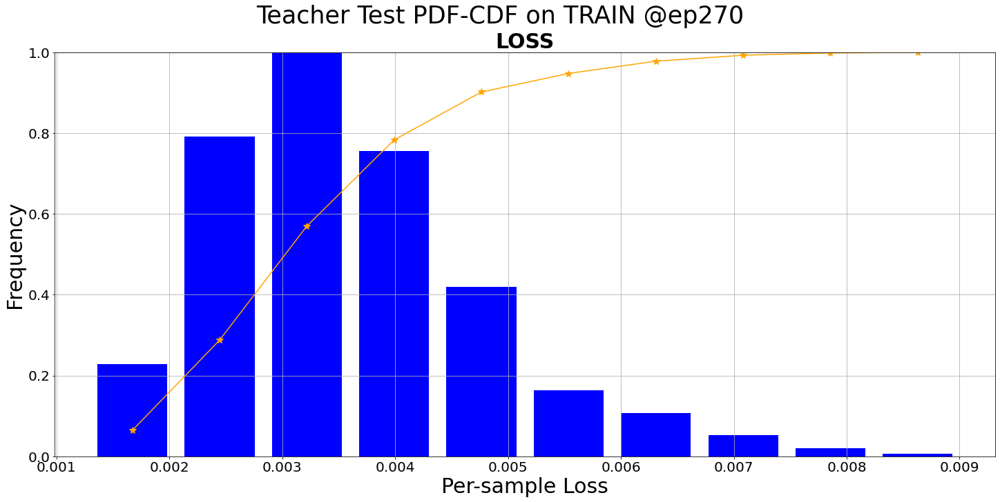

<Figure size 1440x720 with 0 Axes>

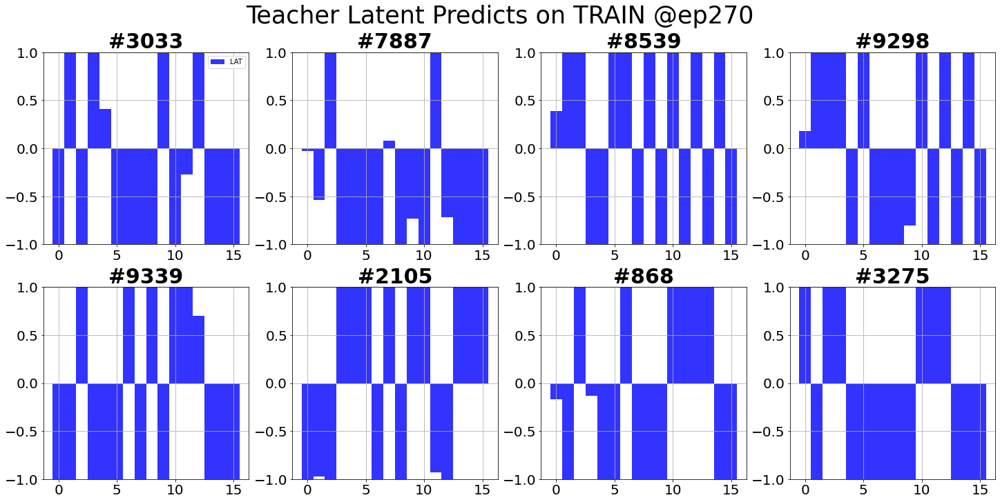

Teacher valid: epoch=9/10, batch=15/17, current best valid loss=0.0039        .0039    
Total training time: 42.65797305107117 sec
Teacher test: sample=15/17, loss=0.0039    
Test finished. Average loss={'LOSS': 0.003093620320482039}

Total training time: 3.6733672618865967 sec


<Figure size 1440x720 with 0 Axes>

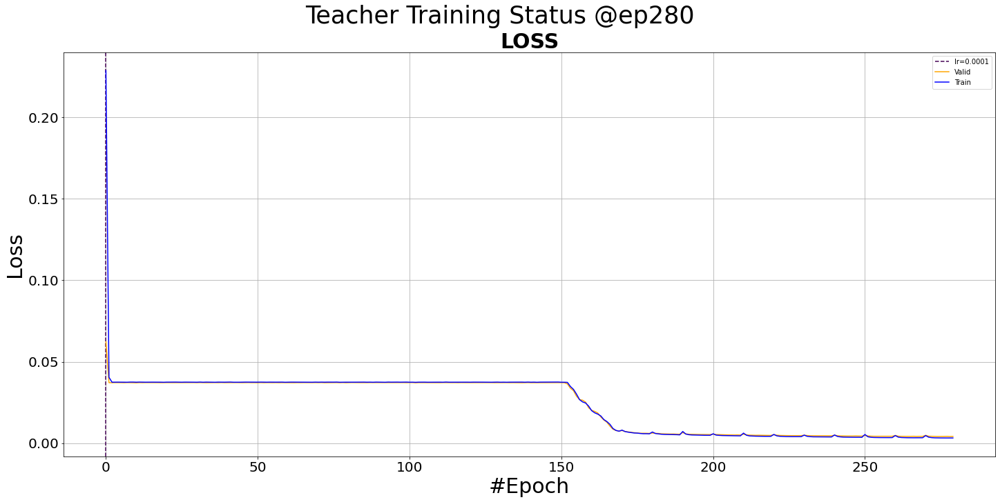

<Figure size 1440x720 with 0 Axes>

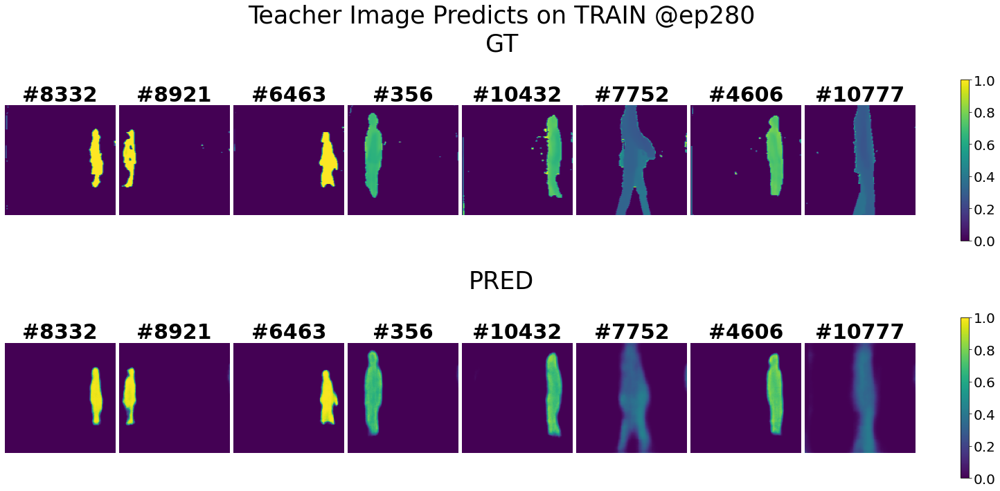

<Figure size 1440x720 with 0 Axes>

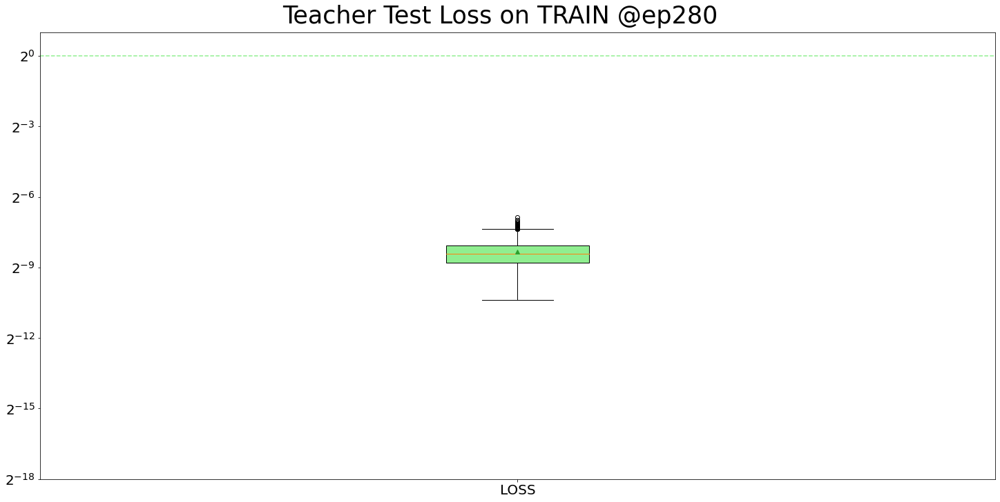

<Figure size 1440x720 with 0 Axes>

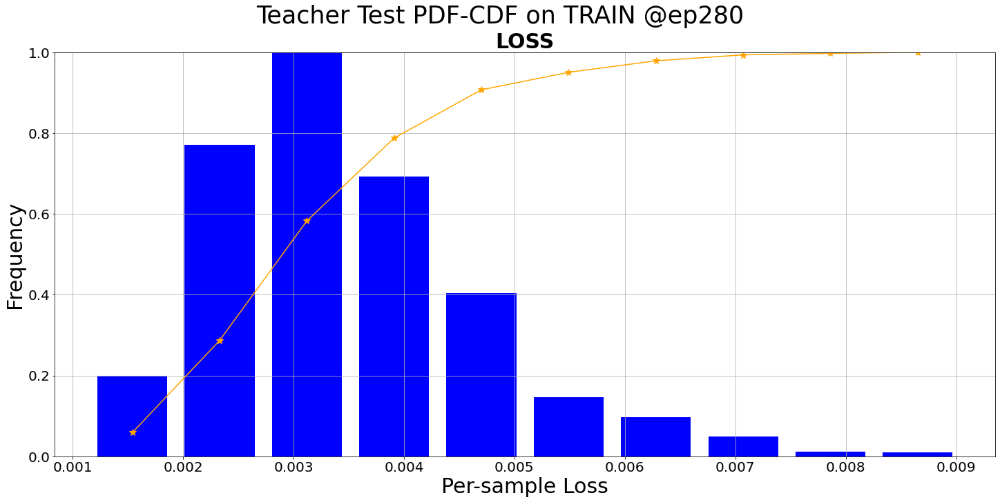

<Figure size 1440x720 with 0 Axes>

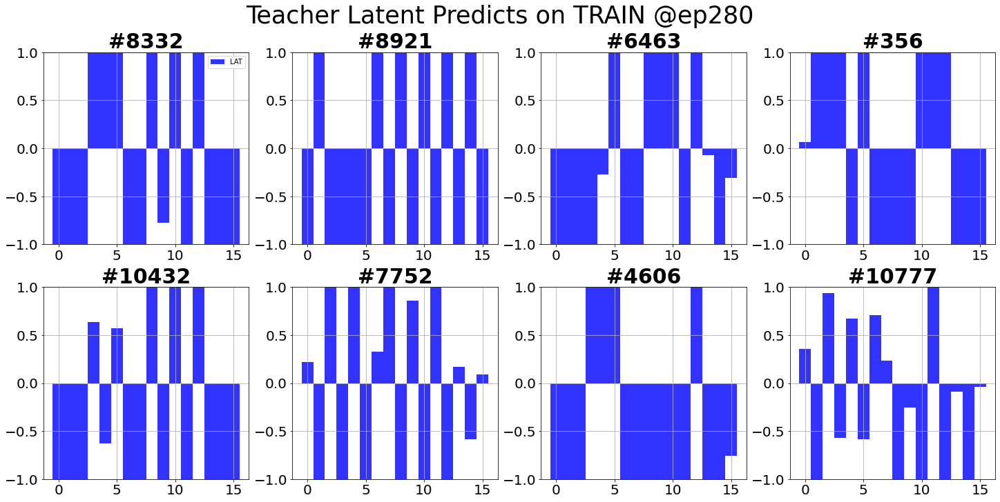

Teacher valid: epoch=9/10, batch=15/17, current best valid loss=0.0037        .0037    
Total training time: 47.671053409576416 sec
Teacher test: sample=15/17, loss=0.0037    
Test finished. Average loss={'LOSS': 0.0030200451504189163}

Total training time: 3.7948195934295654 sec


<Figure size 1440x720 with 0 Axes>

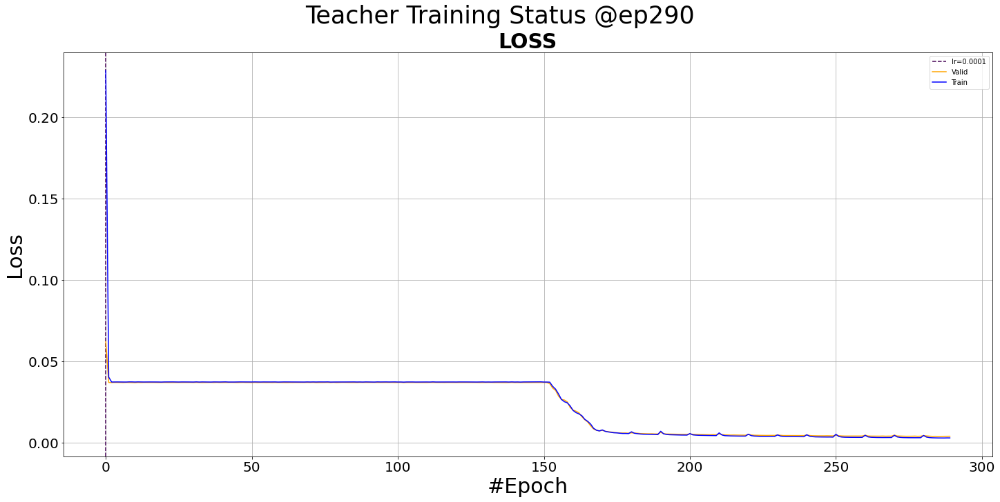

<Figure size 1440x720 with 0 Axes>

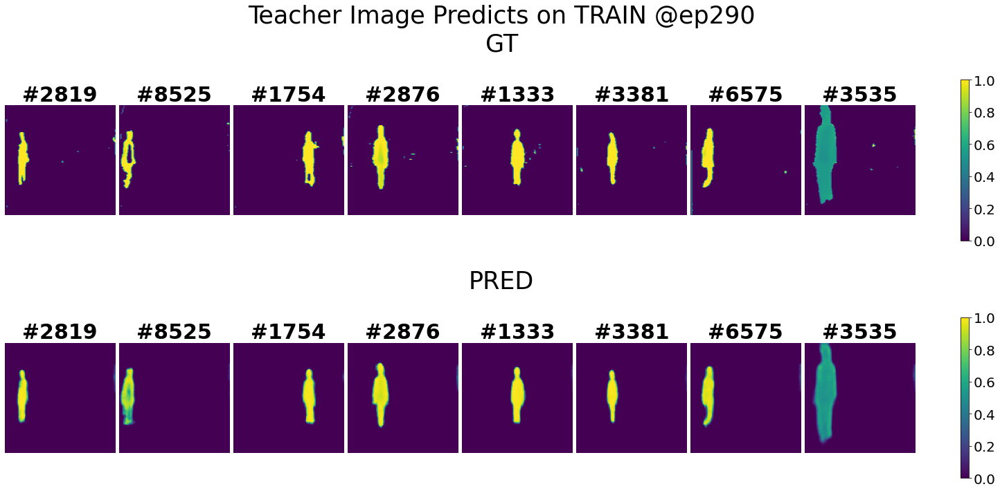

<Figure size 1440x720 with 0 Axes>

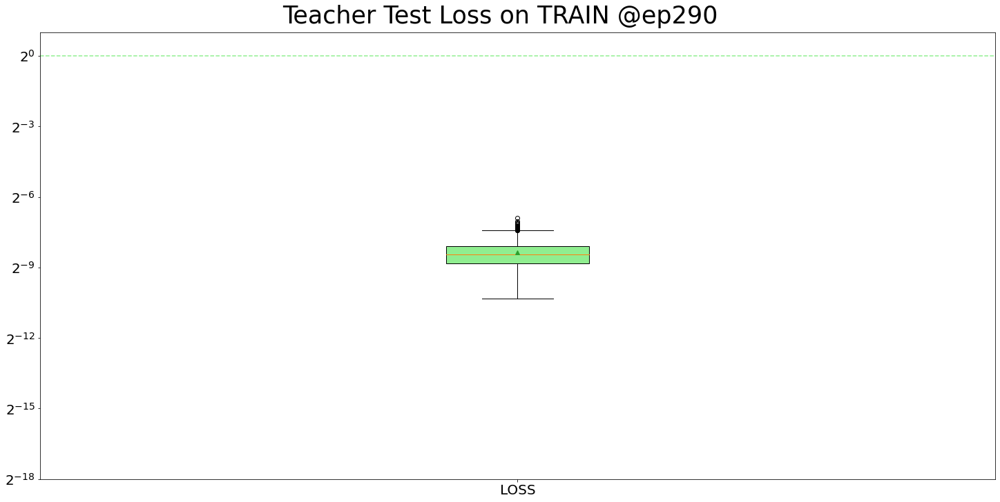

<Figure size 1440x720 with 0 Axes>

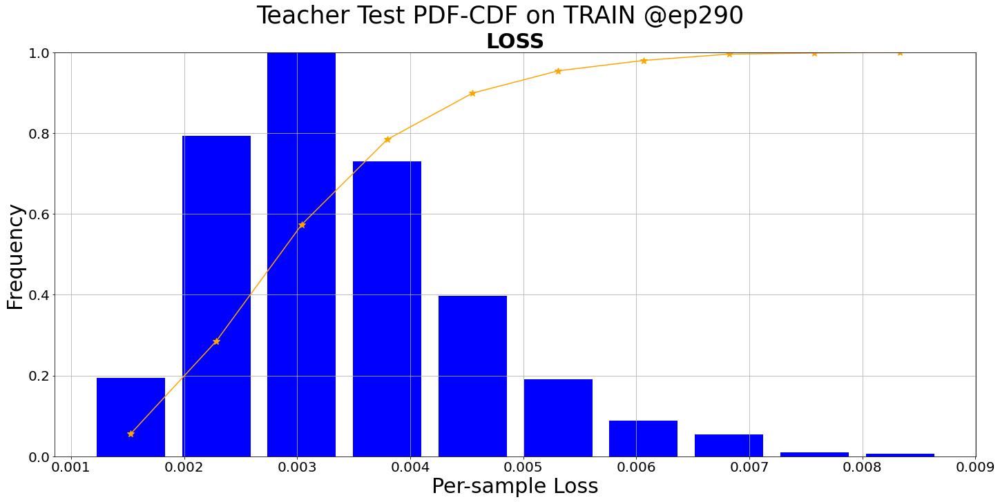

<Figure size 1440x720 with 0 Axes>

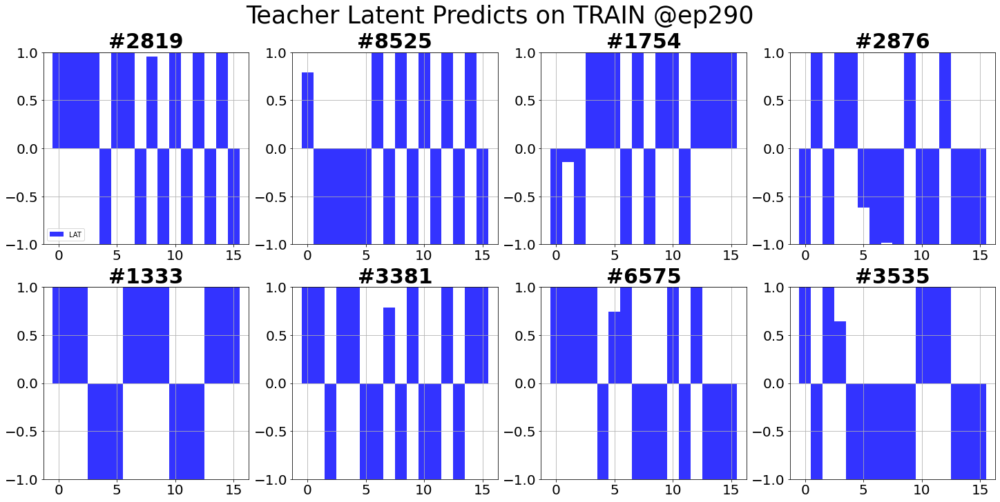

Teacher valid: epoch=9/10, batch=15/17, current best valid loss=0.0037        .0037    
Total training time: 42.51933288574219 sec
Teacher test: sample=15/17, loss=0.0030    
Test finished. Average loss={'LOSS': 0.0028527575170087137}

Total training time: 3.687721014022827 sec


<Figure size 1440x720 with 0 Axes>

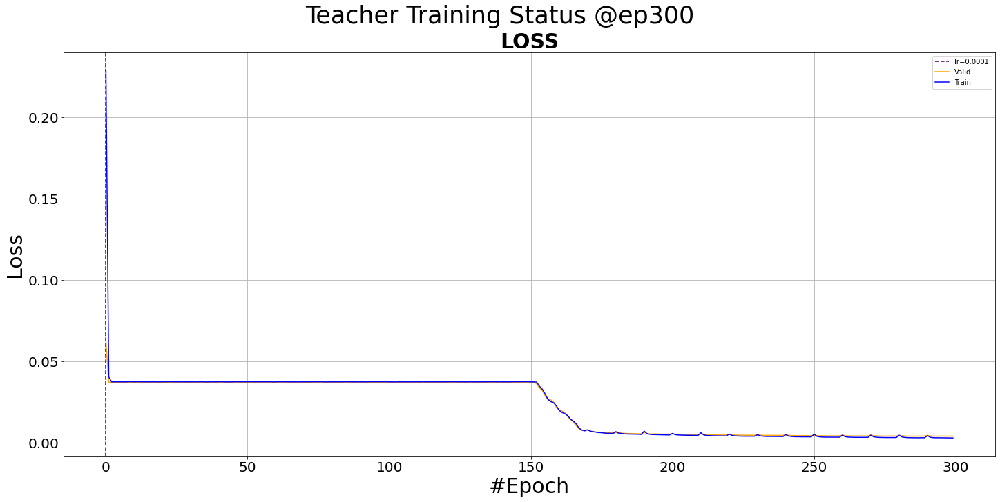

<Figure size 1440x720 with 0 Axes>

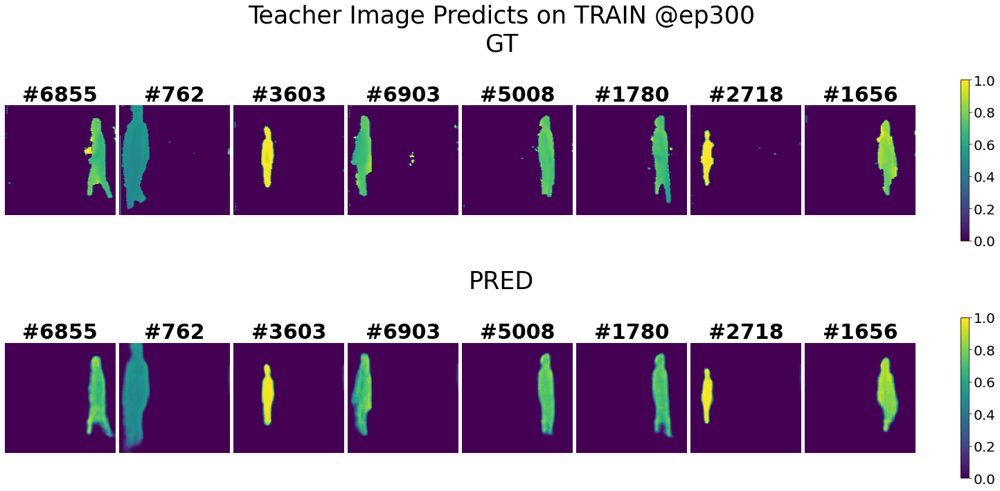

<Figure size 1440x720 with 0 Axes>

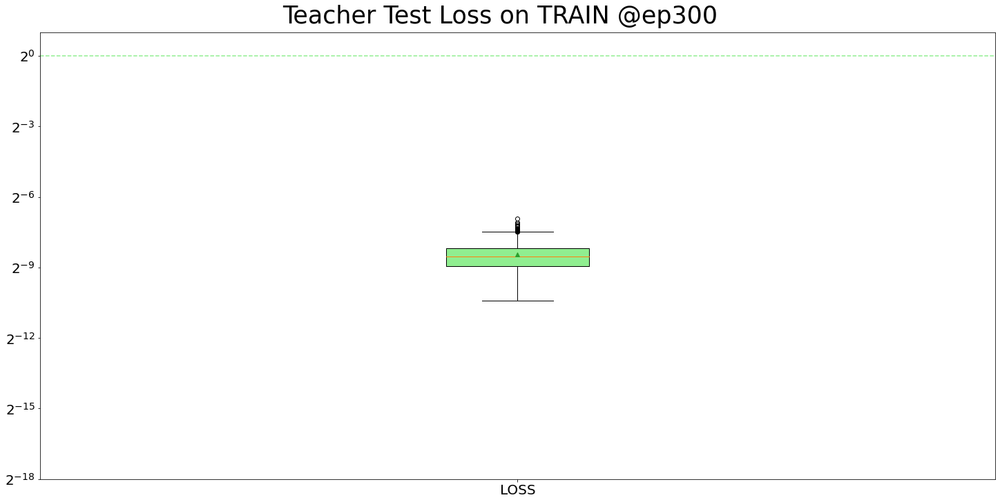

<Figure size 1440x720 with 0 Axes>

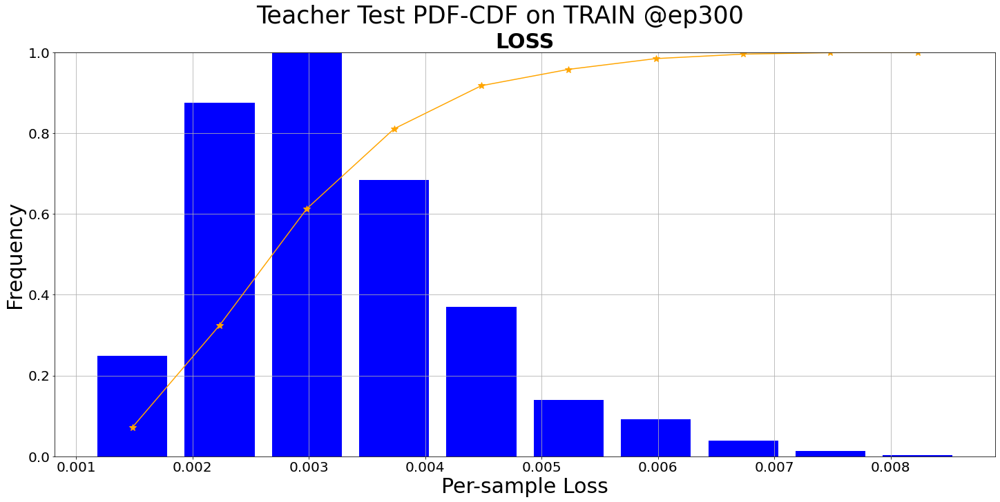

<Figure size 1440x720 with 0 Axes>

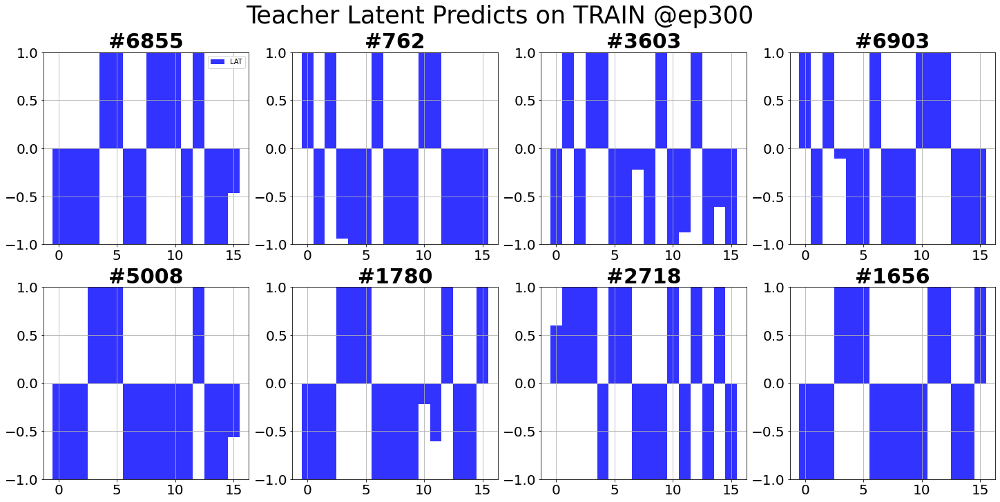


Schedule Completed!


In [29]:
# Training and Testing
%matplotlib inline
trainer_ts_t.scheduler(turns=10,
                  test_loader='train', select_num=8,
                  autosave=True, notion=f"{date_run}TSAE", save_model=False)

Teacher test: sample=8790/8792, loss=0.0027    
Test finished. Average loss={'LOSS': 0.004031515372604303}

Total training time: 32.08874702453613 sec


<Figure size 1440x720 with 0 Axes>

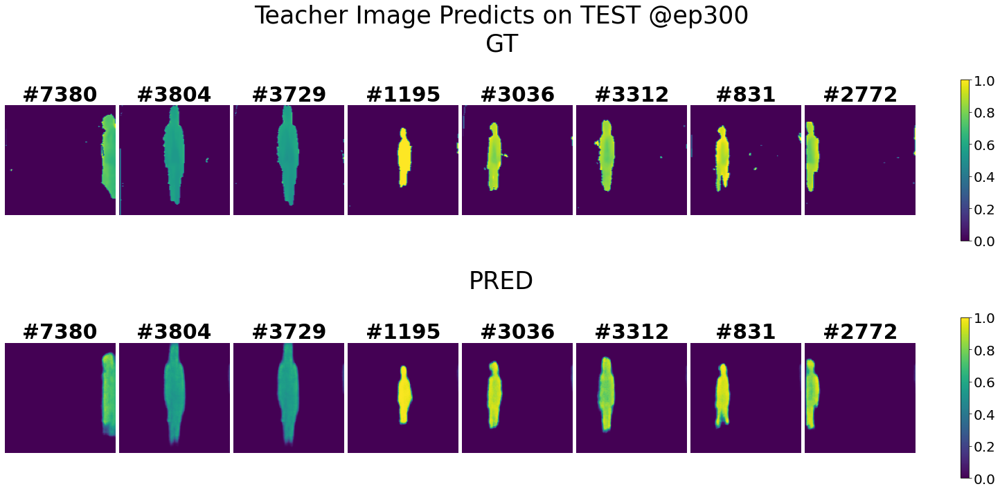

<Figure size 1440x720 with 0 Axes>

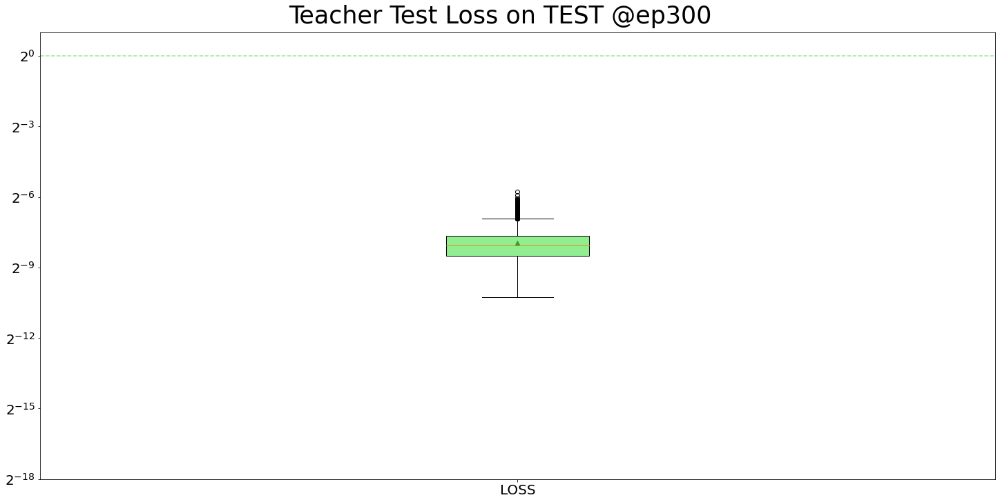

<Figure size 1440x720 with 0 Axes>

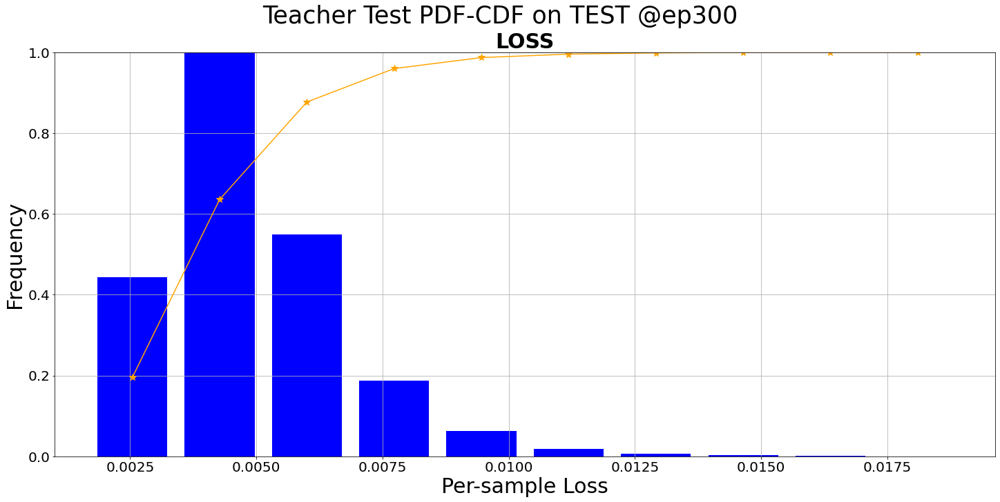

<Figure size 1440x720 with 0 Axes>

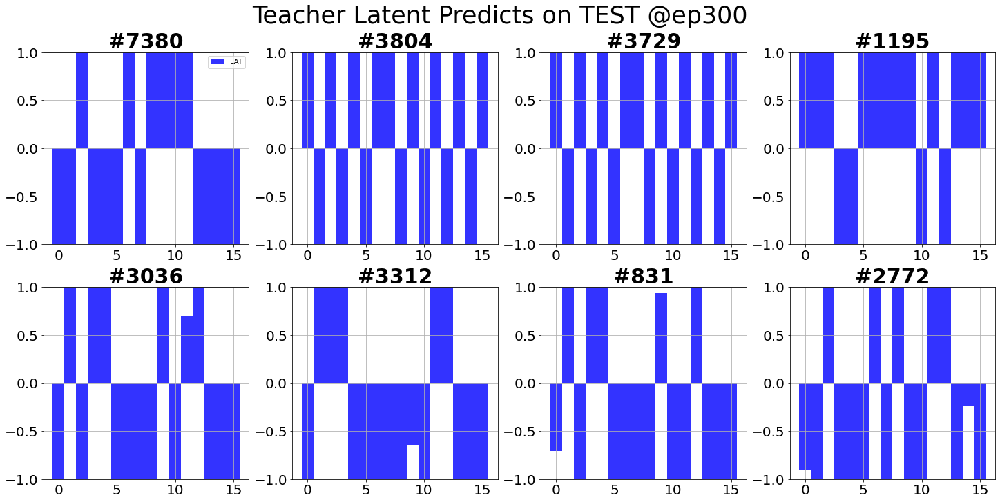

In [30]:
trainer_ts_t.test(loader='test')
trainer_ts_t.plot_test(select_num=8, autosave=True, notion=f"{date_run}TSAE")

In [ ]:
trainer_ae_t.save(f"{date_run}TSAE")

#### Student

In [33]:
csiencoder = TP.CSIEncoder(out_length=16)
imgencoder = TP.ImageEncoder(latent_dim=16)
imgdecoder = TP.ImageDecoder(latent_dim=16)

# imgencoder.load_state_dict(torch.load('../saved/240301R1TS_T/240301R1TS_T_IMGENCompV2@ep100.pth'))
# imgdecoder.load_state_dict(torch.load('../saved/240301R1TS_T/240301R1TS_T_IMGDEV06C1@ep100.pth'))

trainer_ts_s = TP.CompTrainerAEStudent(
                              name='Student', mask=False, 
#    networks=[csiencoder, imgencoder, imgdecoder],
        networks=[csiencoder, trainer_ts_t.models['imgen'], trainer_ts_t.models['imgde']],
                 lr=1e-4, epochs=10, cuda=gpu,
                 train_loader=train_loader, valid_loader=valid_loader, test_loader=test_loader)
trainer_ts_s.recon_lossfunc = nn.MSELoss()

Student valid: epoch=9/10, batch=15/17, current best valid loss=86.2713        86.2713     
Total training time: 48.24655842781067 sec
Student test: sample=15/17, loss=97.8632    
Test finished. Average loss={'LOSS': 91.93346909291165, 'IMG': 0.037368471045577764}

Total training time: 5.621608018875122 sec


<Figure size 432x288 with 0 Axes>

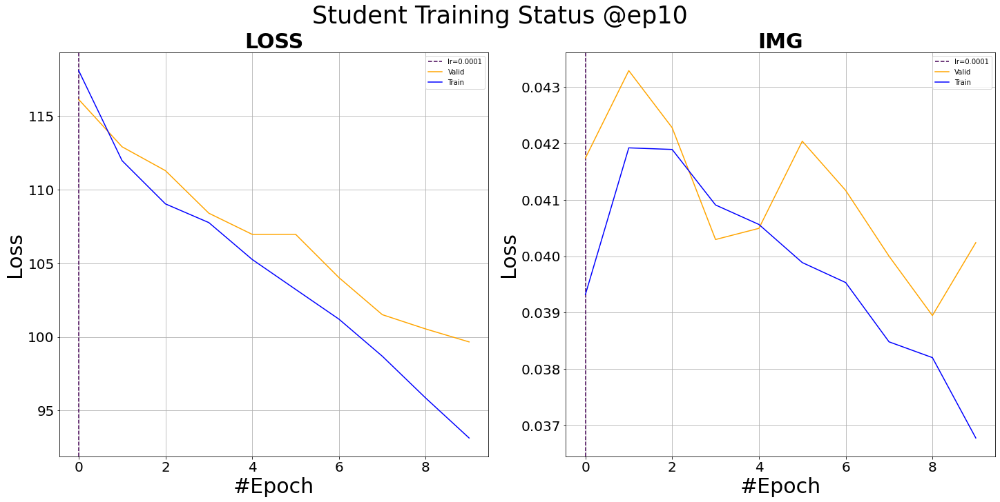

<Figure size 1440x720 with 0 Axes>

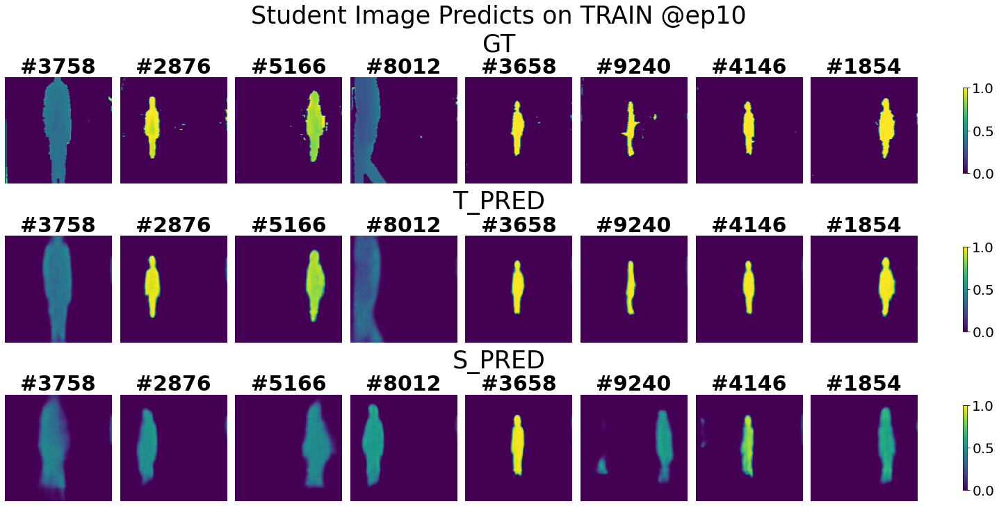

<Figure size 1440x720 with 0 Axes>

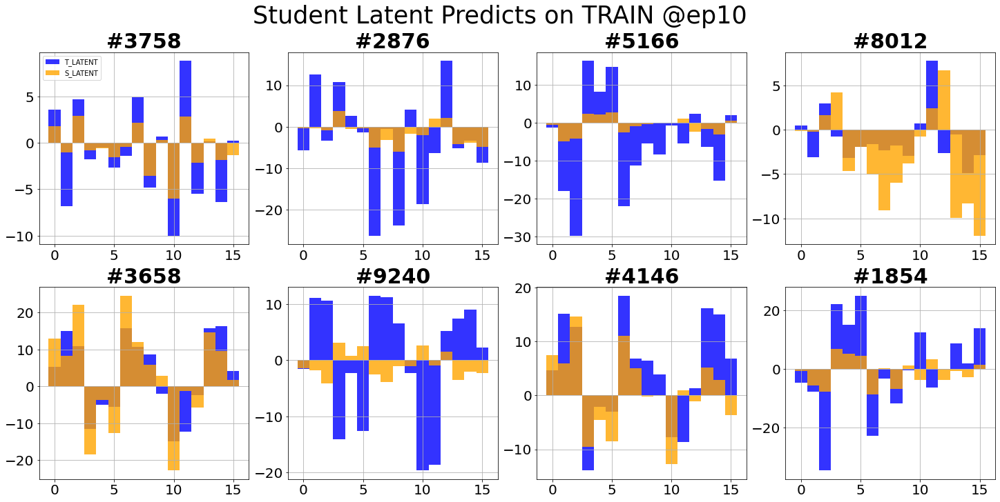

<Figure size 1440x720 with 0 Axes>

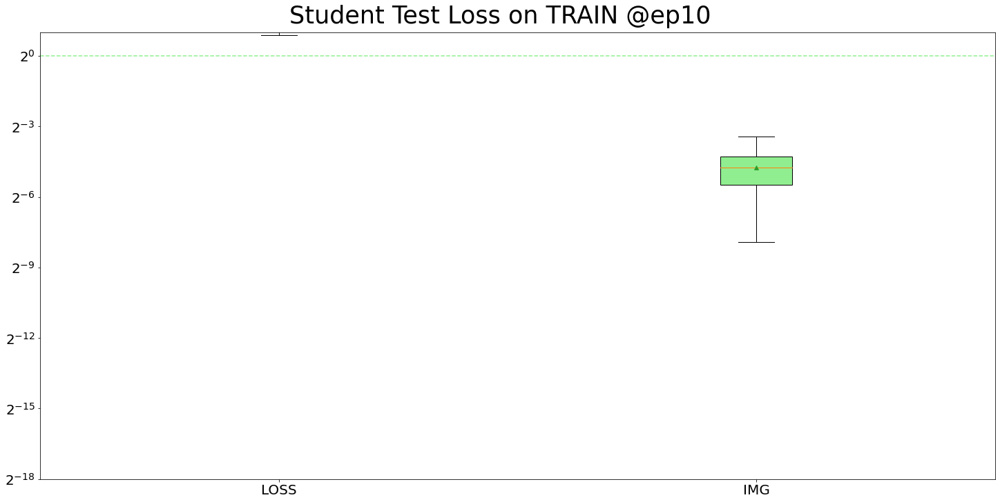

<Figure size 1440x720 with 0 Axes>

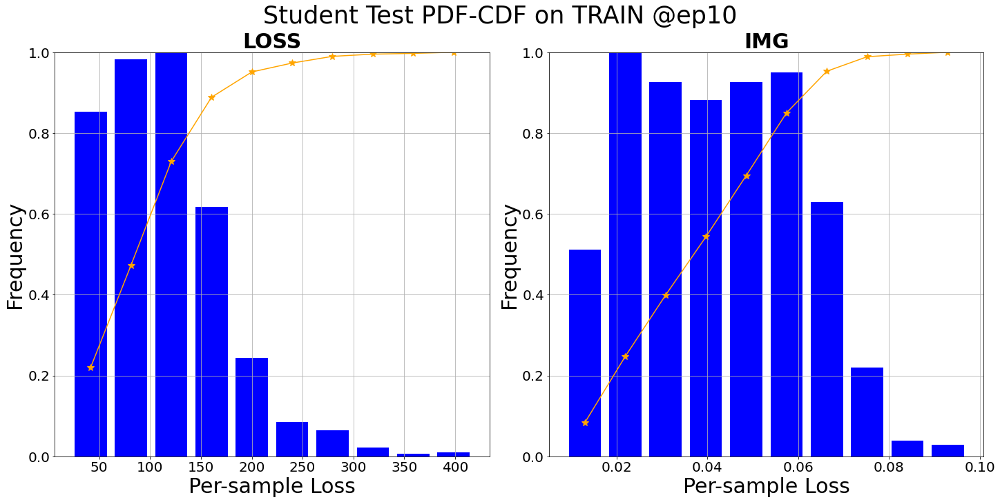

Student valid: epoch=9/10, batch=15/17, current best valid loss=85.7645        5.7645    
Total training time: 49.27053928375244 sec
Student test: sample=15/17, loss=110.8760    
Test finished. Average loss={'LOSS': 78.78924297607121, 'IMG': 0.03408129956455121}

Total training time: 5.68429970741272 sec


<Figure size 1440x720 with 0 Axes>

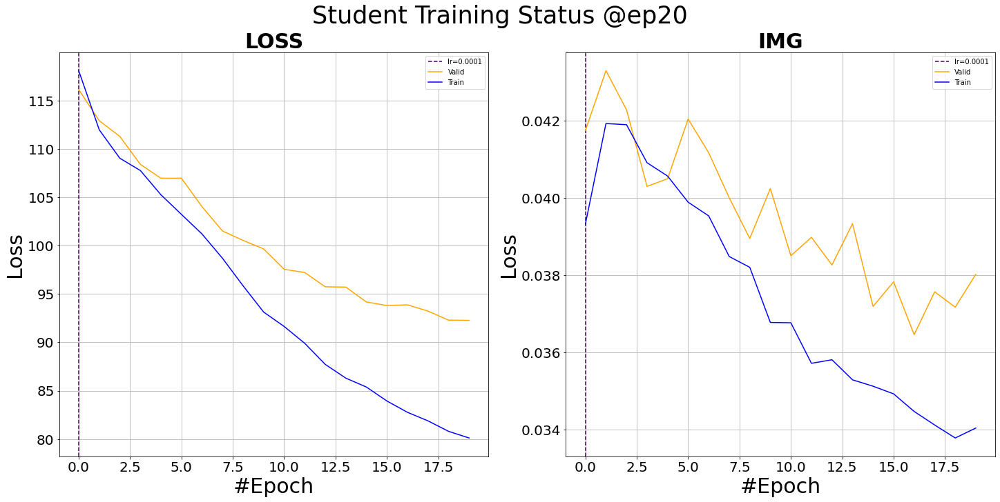

<Figure size 1440x720 with 0 Axes>

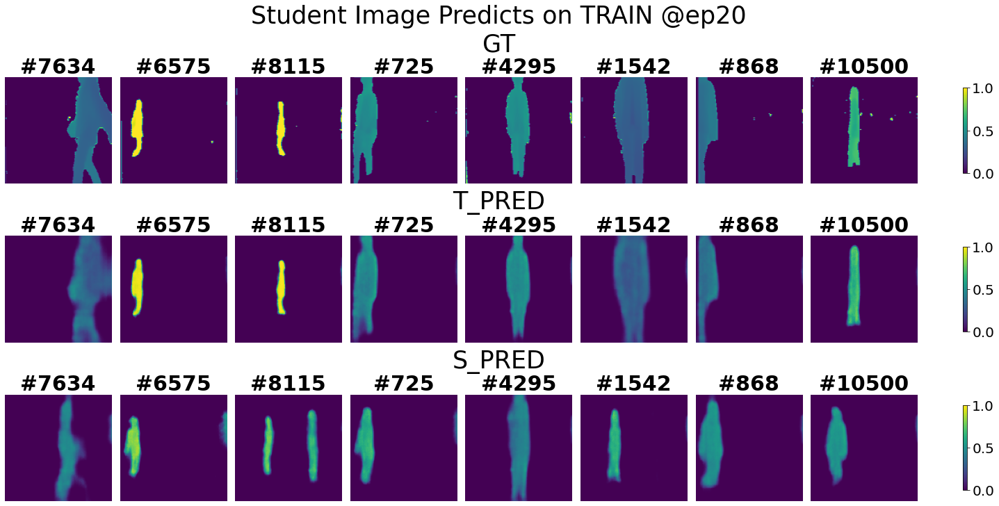

<Figure size 1440x720 with 0 Axes>

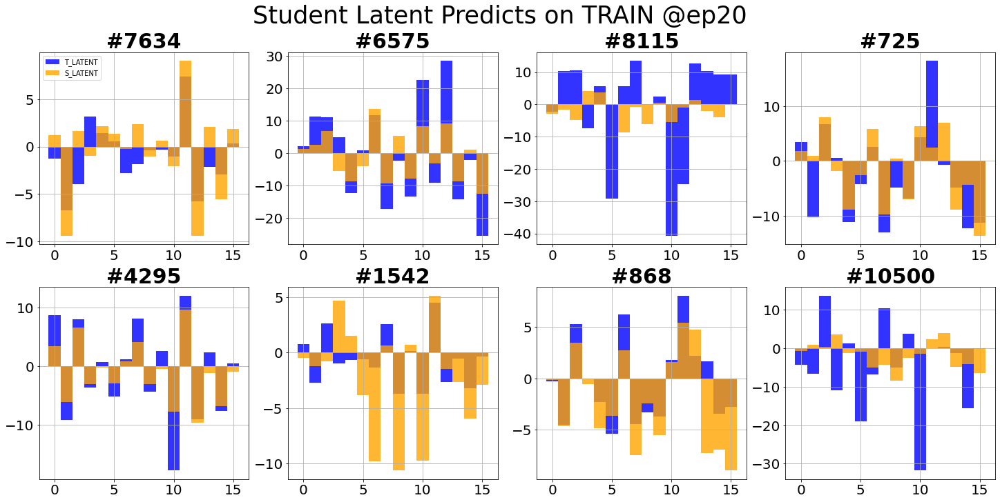

<Figure size 1440x720 with 0 Axes>

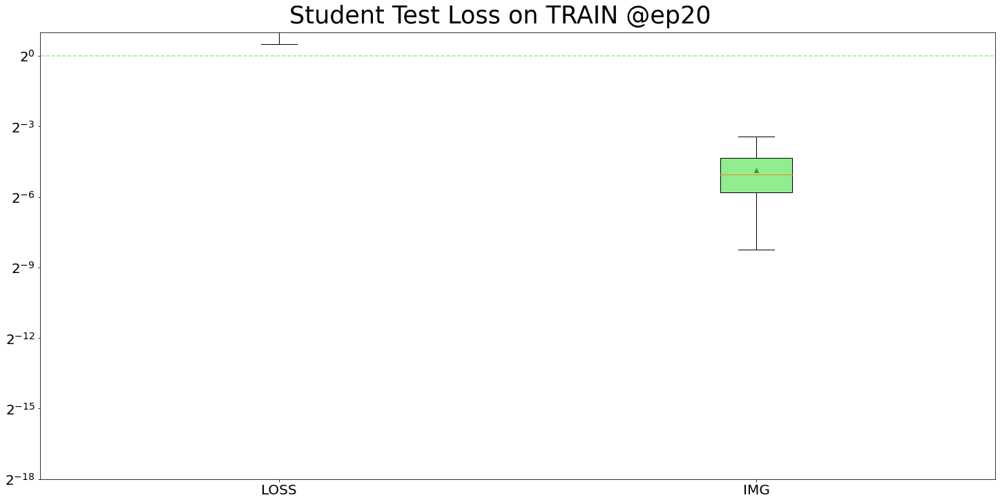

<Figure size 1440x720 with 0 Axes>

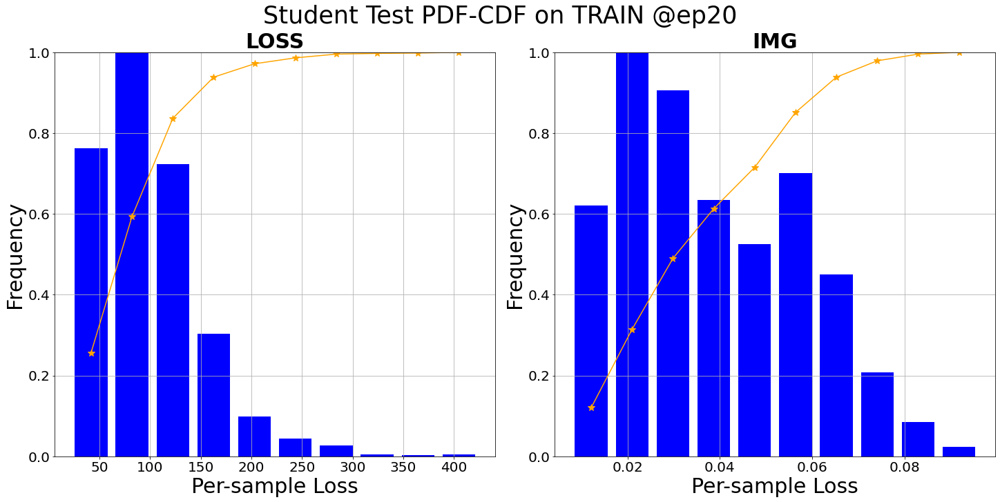

Student valid: epoch=9/10, batch=15/17, current best valid loss=79.1761        9.1761    
Total training time: 48.869712352752686 sec
Student test: sample=15/17, loss=107.7602    
Test finished. Average loss={'LOSS': 70.84894540128025, 'IMG': 0.031311114641378965}

Total training time: 5.711751937866211 sec


<Figure size 1440x720 with 0 Axes>

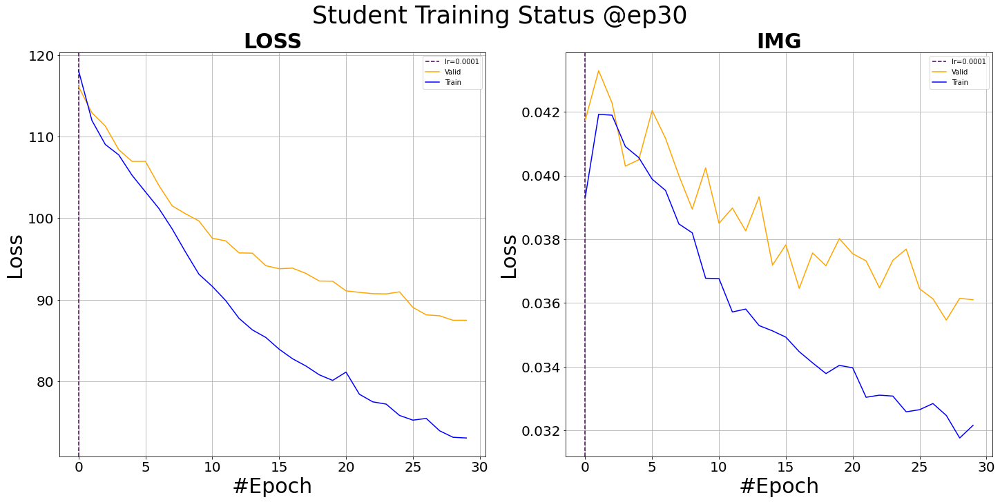

<Figure size 1440x720 with 0 Axes>

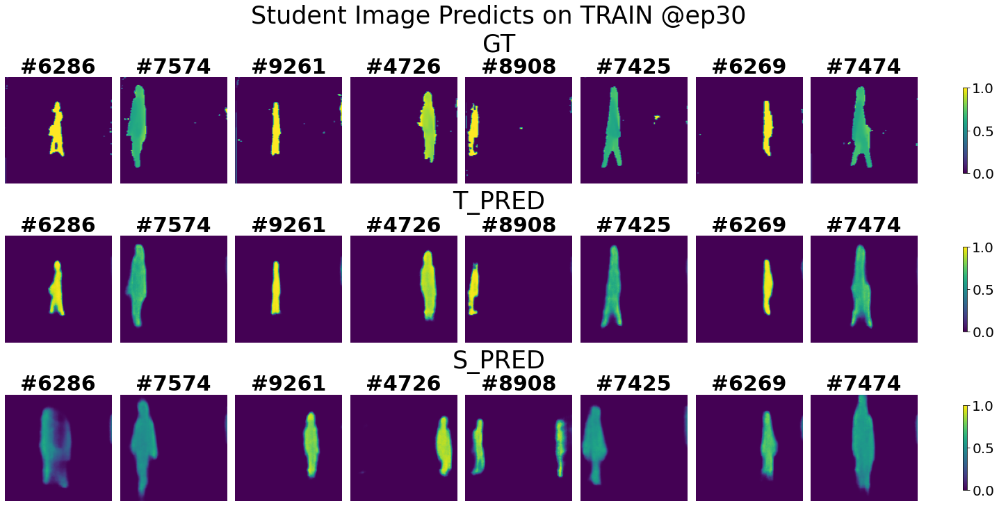

<Figure size 1440x720 with 0 Axes>

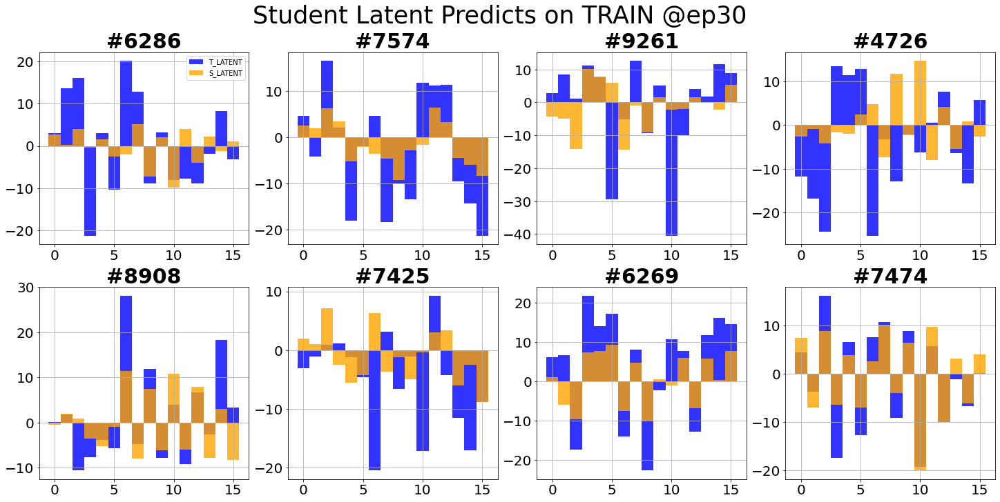

<Figure size 1440x720 with 0 Axes>

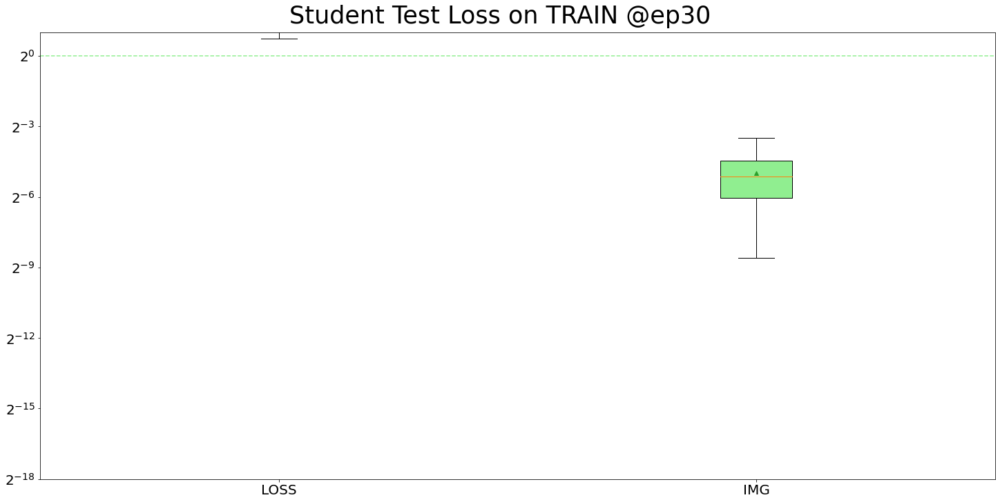

<Figure size 1440x720 with 0 Axes>

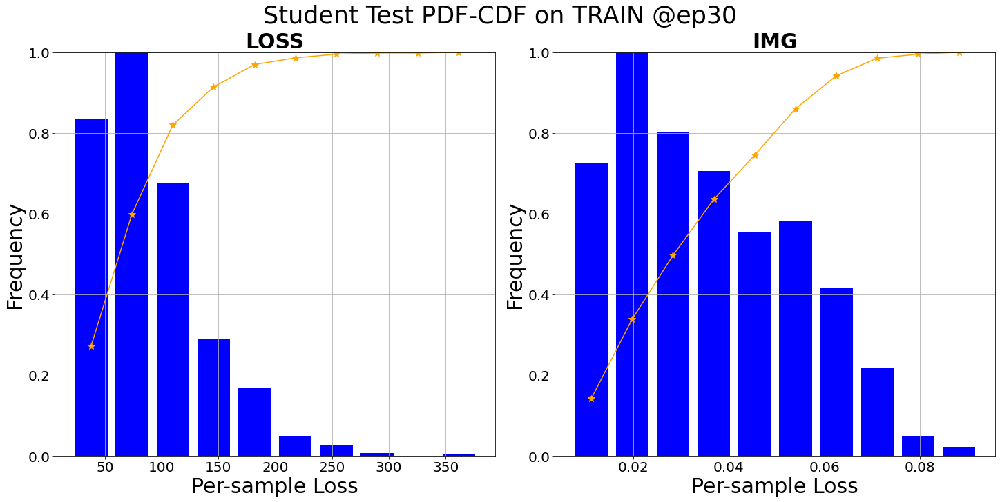

Student valid: epoch=9/10, batch=15/17, current best valid loss=74.0959        4.0959    
Total training time: 52.643187046051025 sec
Student test: sample=15/17, loss=57.6005    
Test finished. Average loss={'LOSS': 65.28496478563723, 'IMG': 0.029329715812363086}

Total training time: 6.151092290878296 sec


<Figure size 1440x720 with 0 Axes>

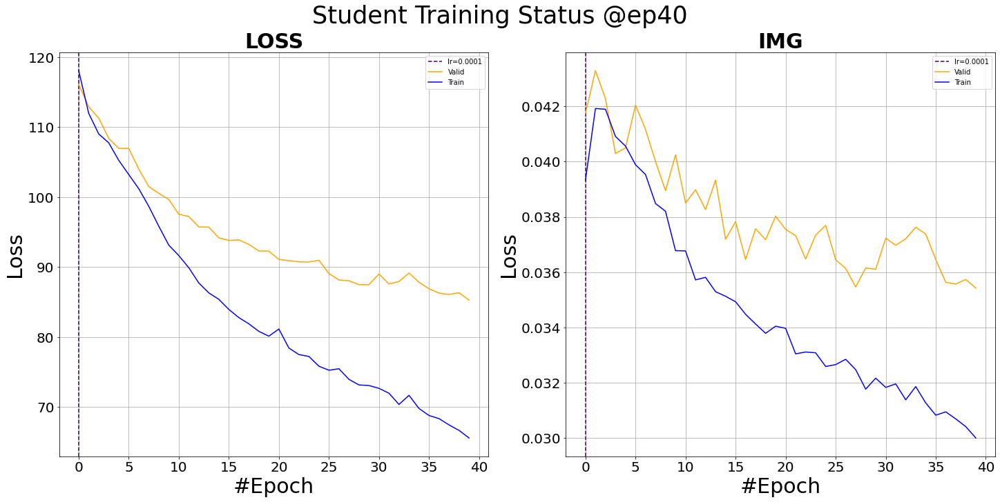

<Figure size 1440x720 with 0 Axes>

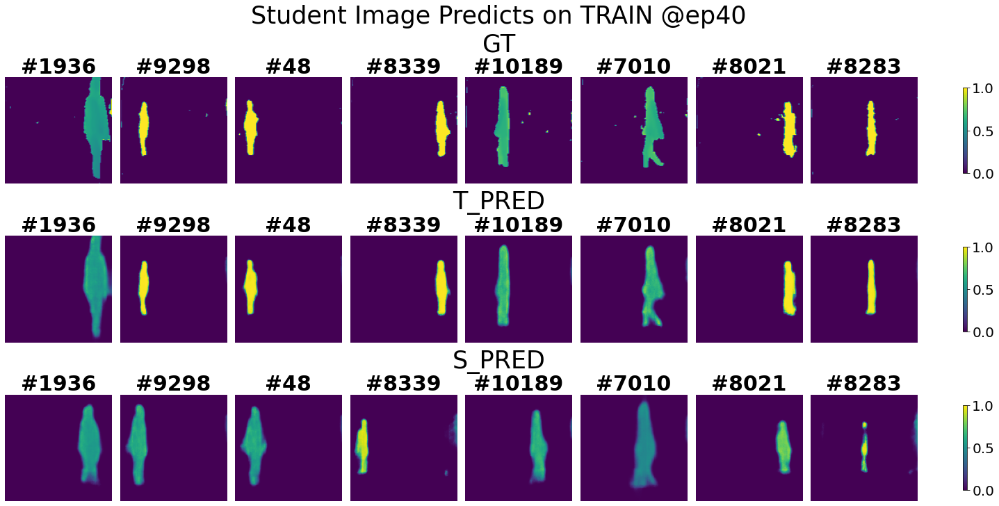

<Figure size 1440x720 with 0 Axes>

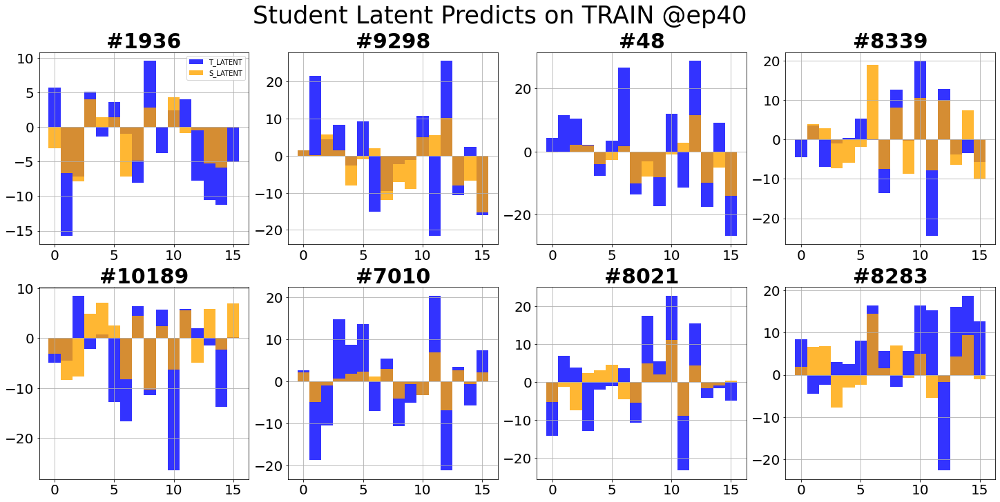

<Figure size 1440x720 with 0 Axes>

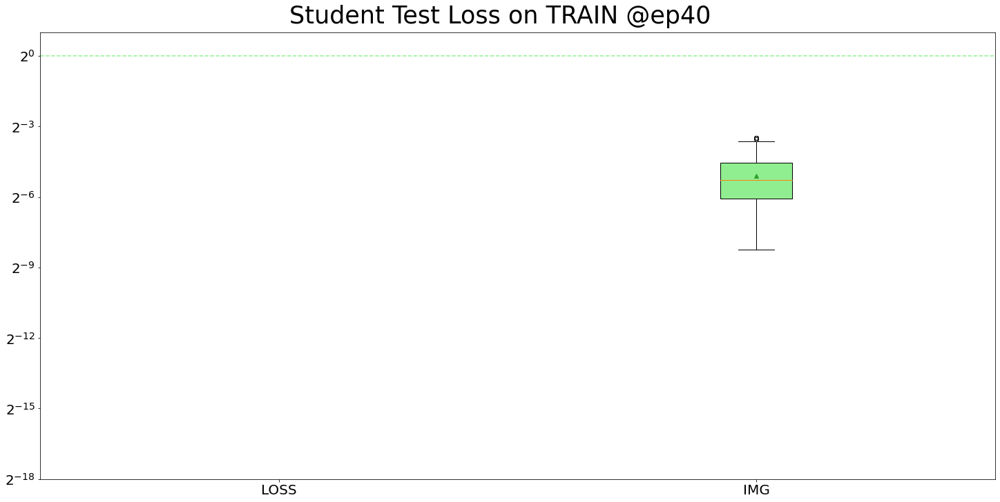

<Figure size 1440x720 with 0 Axes>

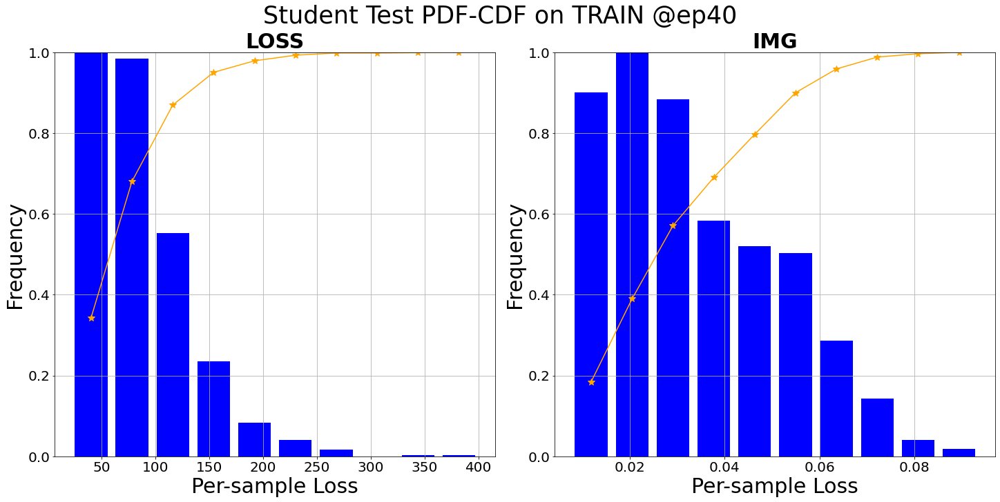

Student valid: epoch=9/10, batch=15/17, current best valid loss=74.0959        4.0959    
Total training time: 49.10338091850281 sec
Student test: sample=15/17, loss=57.5894    
Test finished. Average loss={'LOSS': 58.20268305697862, 'IMG': 0.027123165401837256}

Total training time: 5.736795663833618 sec


<Figure size 1440x720 with 0 Axes>

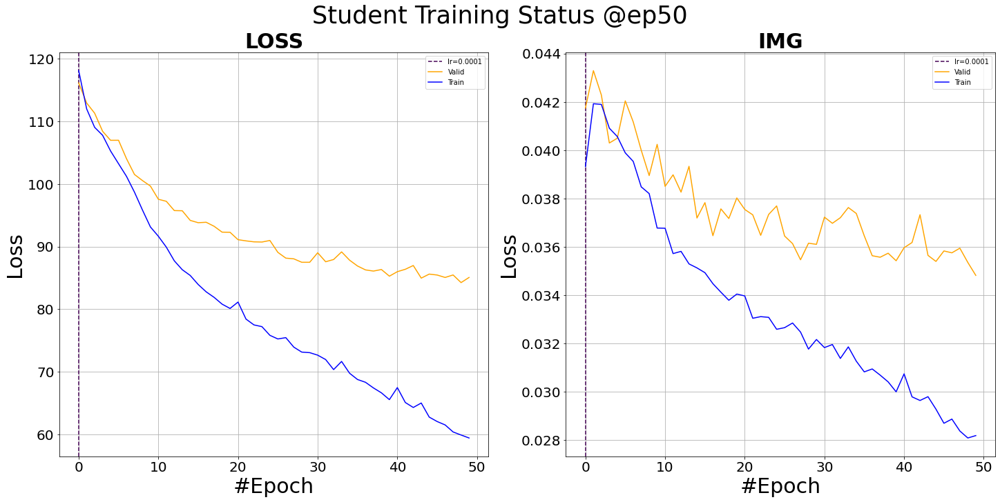

<Figure size 1440x720 with 0 Axes>

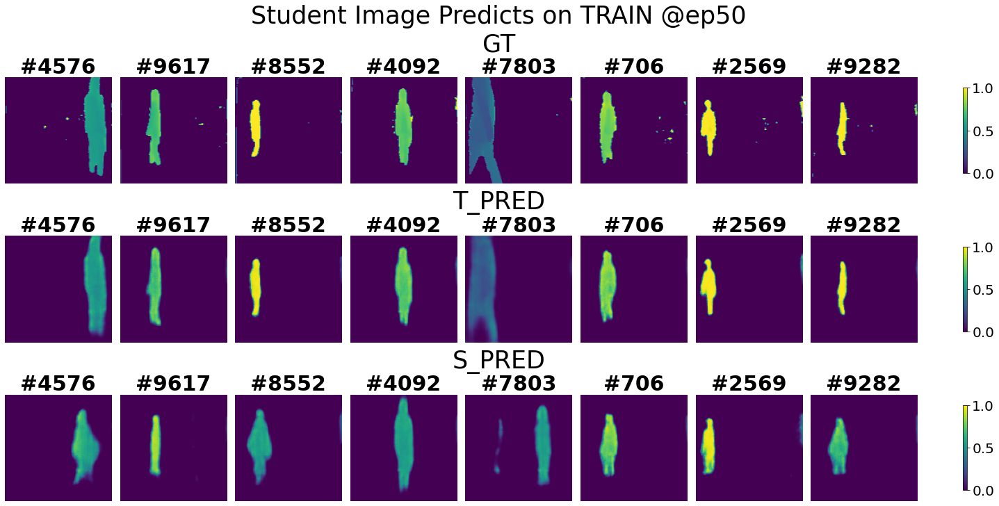

<Figure size 1440x720 with 0 Axes>

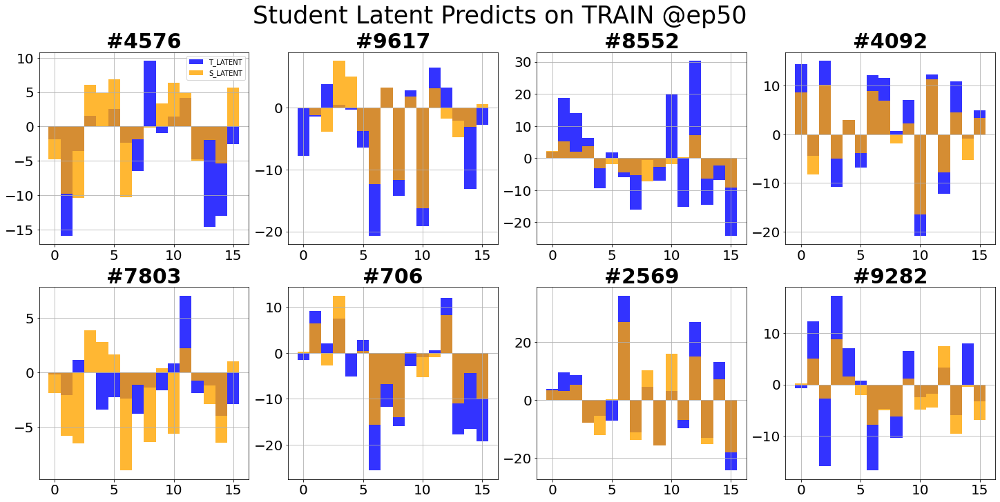

<Figure size 1440x720 with 0 Axes>

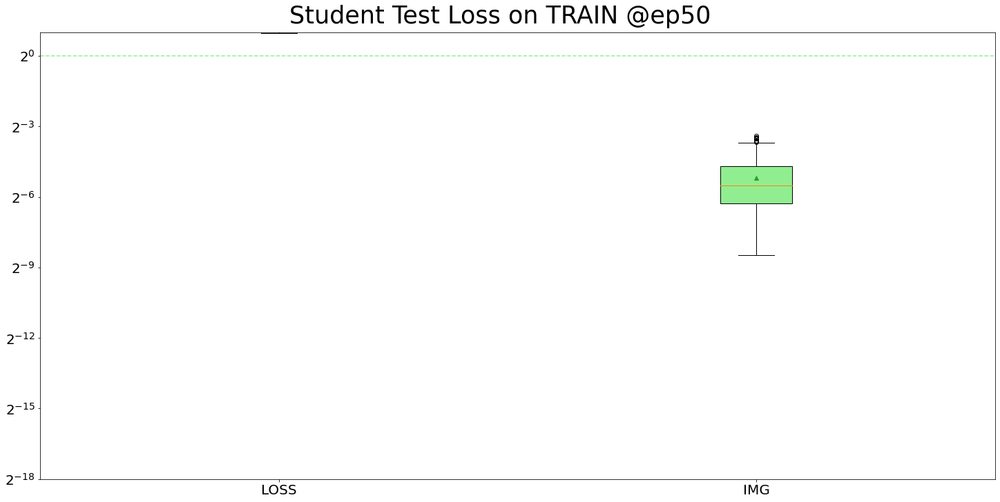

<Figure size 1440x720 with 0 Axes>

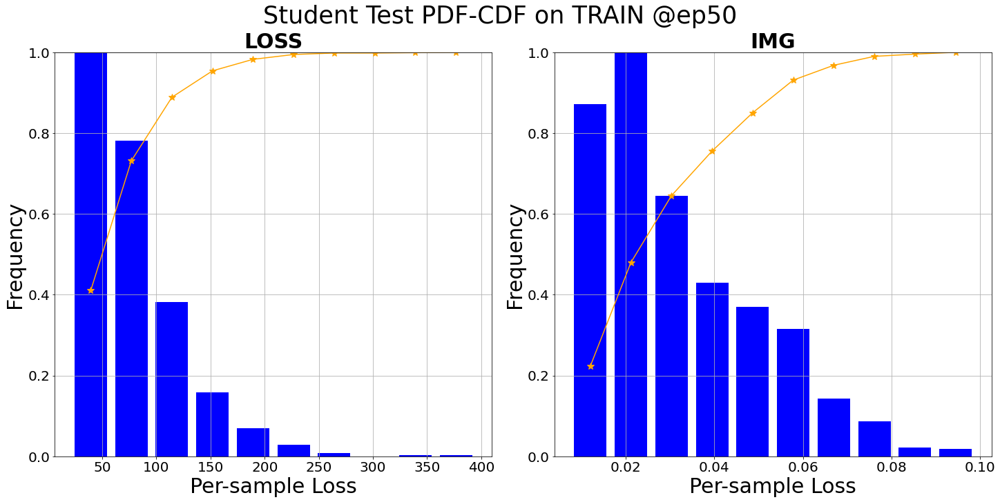

Student valid: epoch=9/10, batch=15/17, current best valid loss=74.0959        4.0959    
Total training time: 53.8189640045166 sec
Student test: sample=15/17, loss=100.0457    
Test finished. Average loss={'LOSS': 51.46616114812958, 'IMG': 0.024788153279908274}

Total training time: 5.710639238357544 sec


<Figure size 1440x720 with 0 Axes>

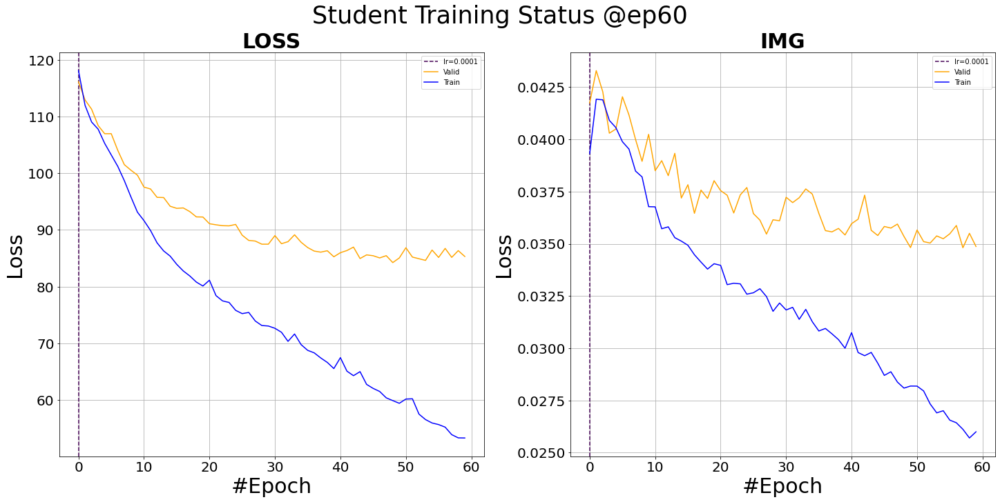

<Figure size 1440x720 with 0 Axes>

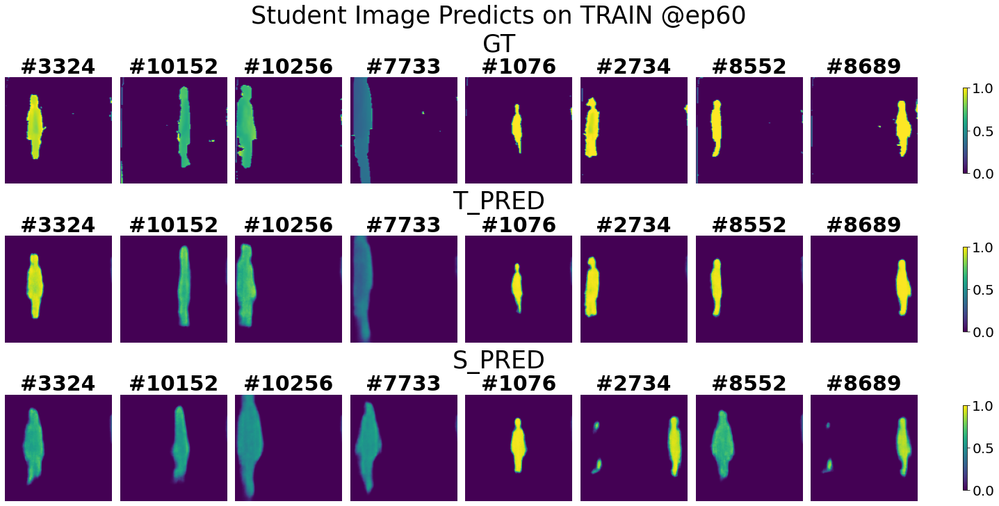

<Figure size 1440x720 with 0 Axes>

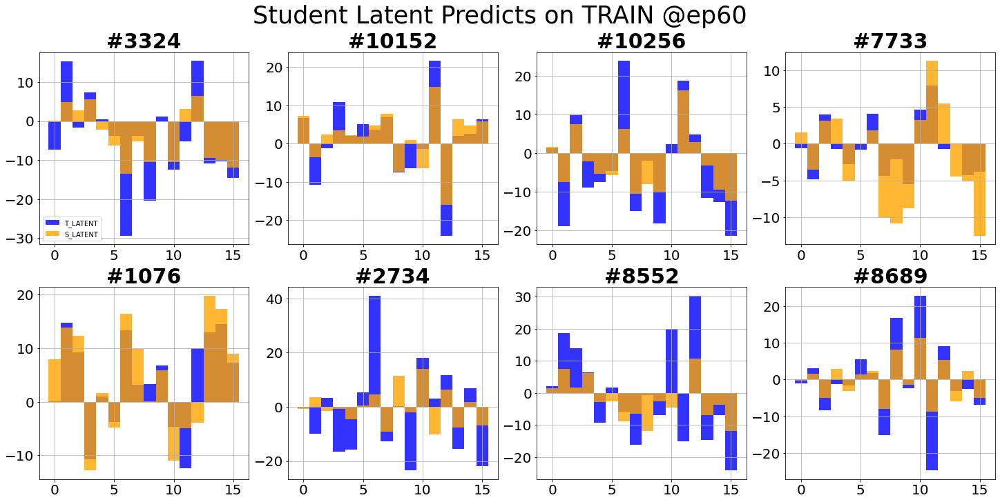

<Figure size 1440x720 with 0 Axes>

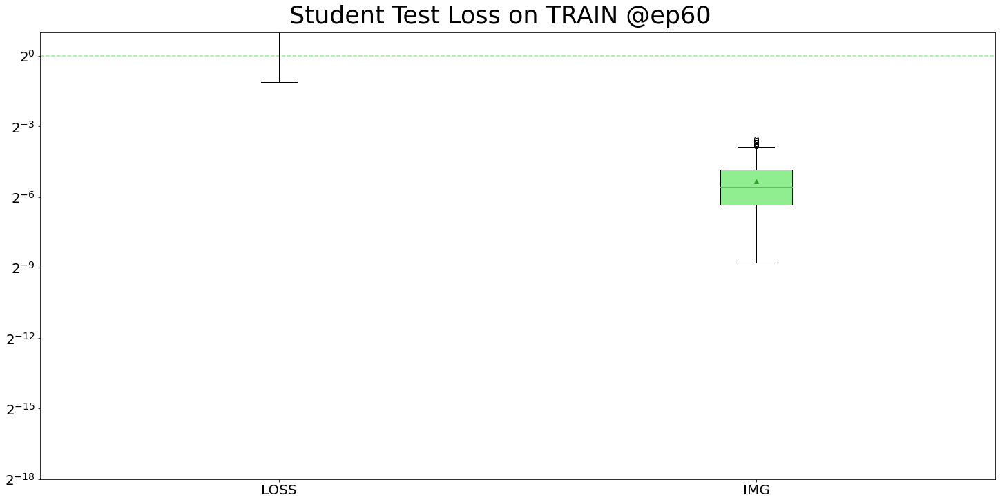

<Figure size 1440x720 with 0 Axes>

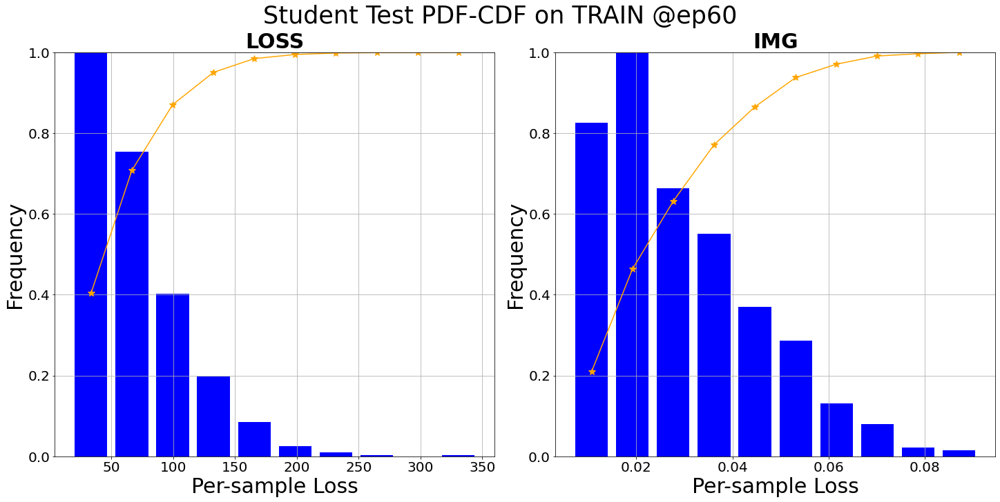

Student valid: epoch=9/10, batch=15/17, current best valid loss=74.0959        4.0959    
Total training time: 49.10681200027466 sec
Student test: sample=15/17, loss=49.0084    
Test finished. Average loss={'LOSS': 48.333297315984964, 'IMG': 0.025126133674990236}

Total training time: 5.719230890274048 sec


<Figure size 1440x720 with 0 Axes>

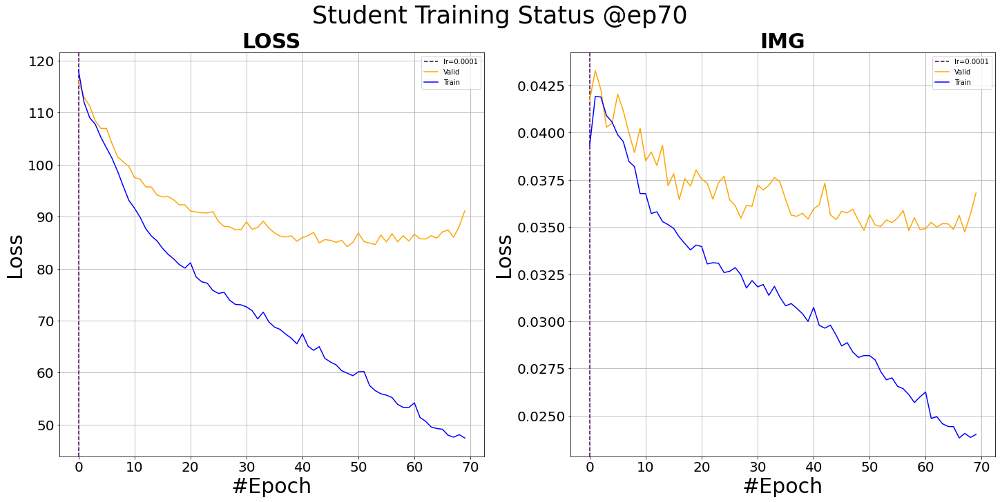

<Figure size 1440x720 with 0 Axes>

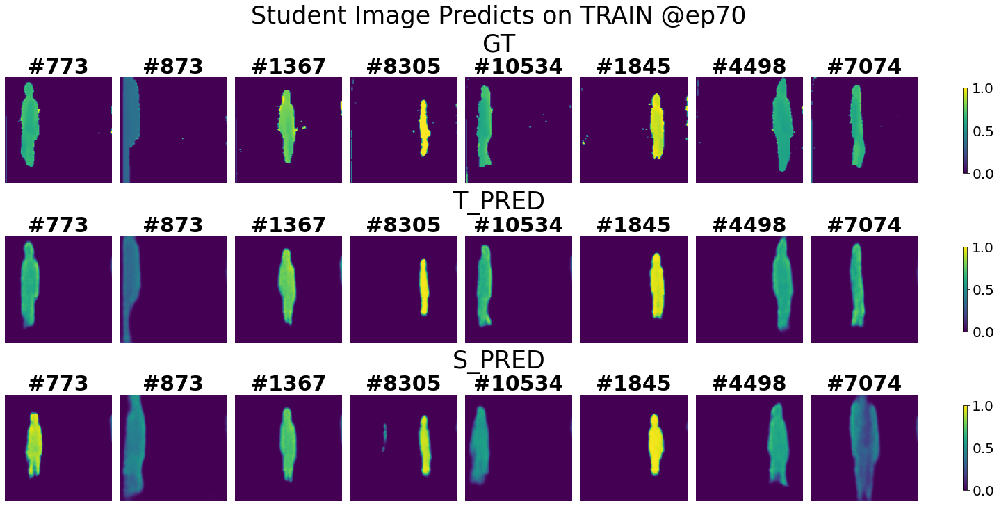

<Figure size 1440x720 with 0 Axes>

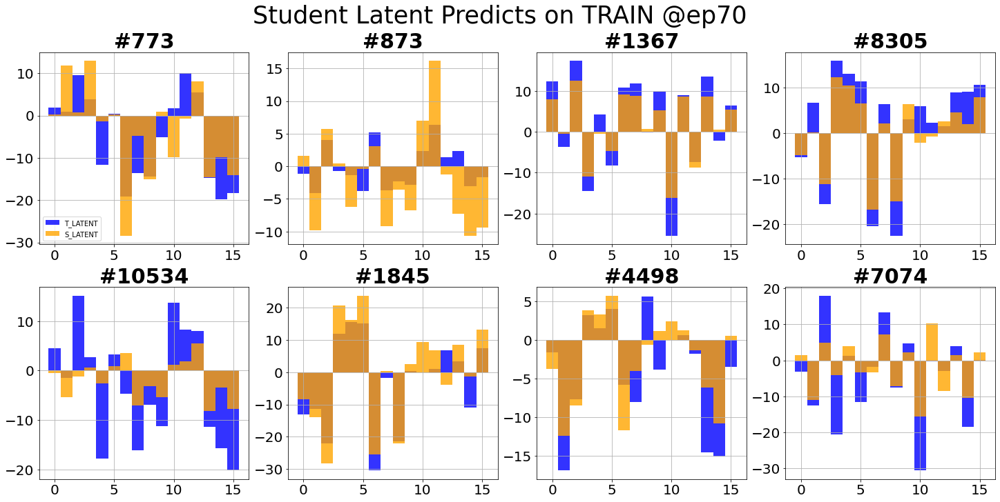

<Figure size 1440x720 with 0 Axes>

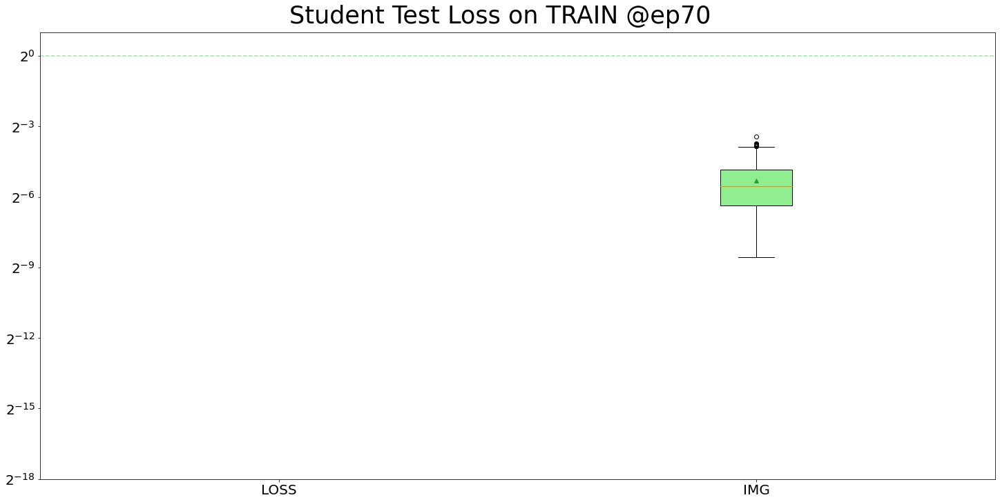

<Figure size 1440x720 with 0 Axes>

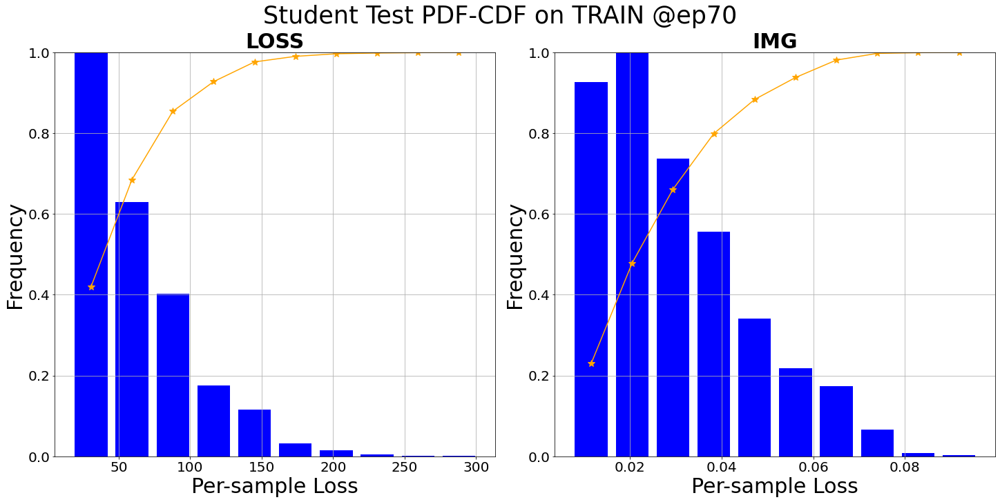

Student valid: epoch=9/10, batch=15/17, current best valid loss=73.5122        3.5122    
Total training time: 51.58077549934387 sec
Student test: sample=15/17, loss=46.6951    
Test finished. Average loss={'LOSS': 37.96388346186894, 'IMG': 0.020466506583890057}

Total training time: 6.16392970085144 sec


<Figure size 1440x720 with 0 Axes>

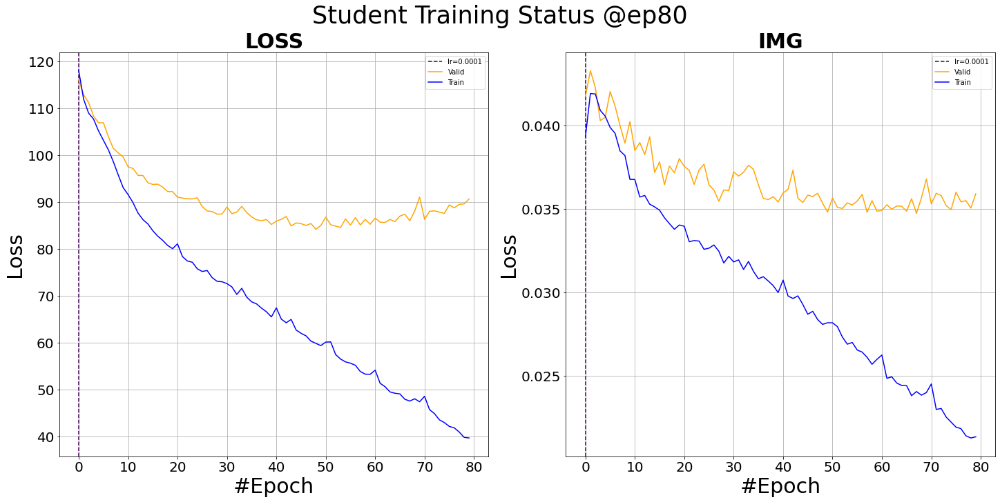

<Figure size 1440x720 with 0 Axes>

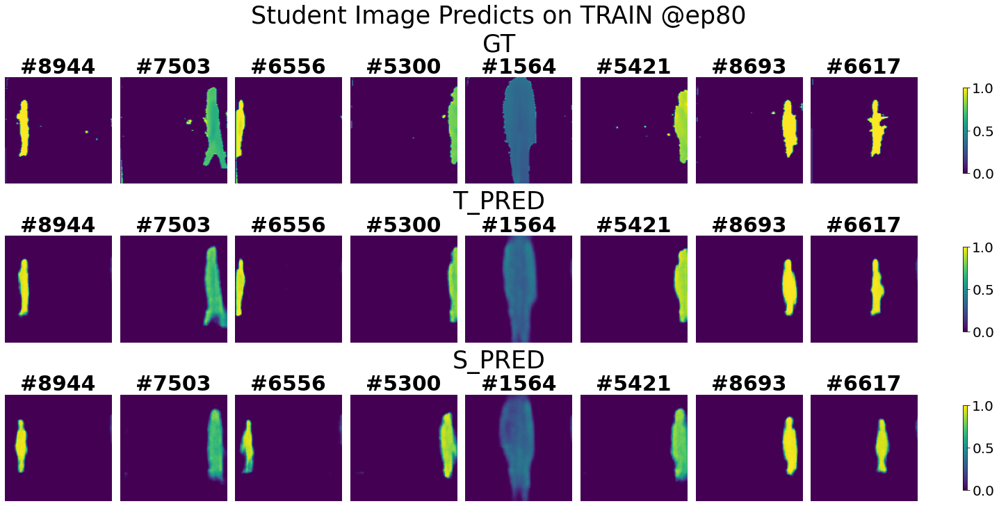

<Figure size 1440x720 with 0 Axes>

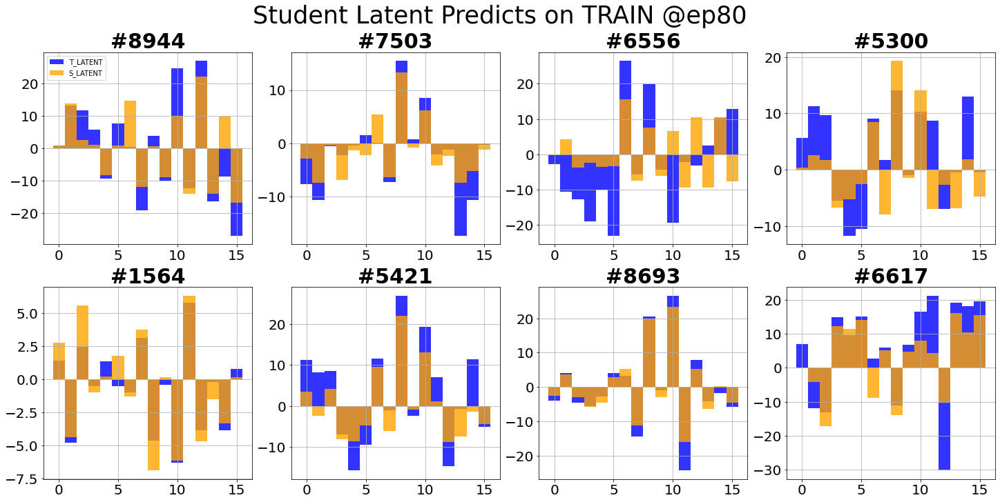

<Figure size 1440x720 with 0 Axes>

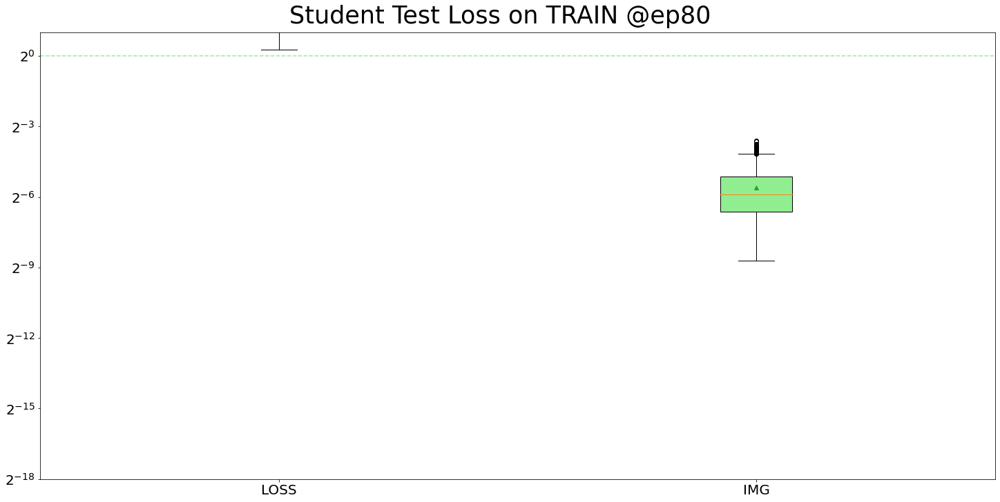

<Figure size 1440x720 with 0 Axes>

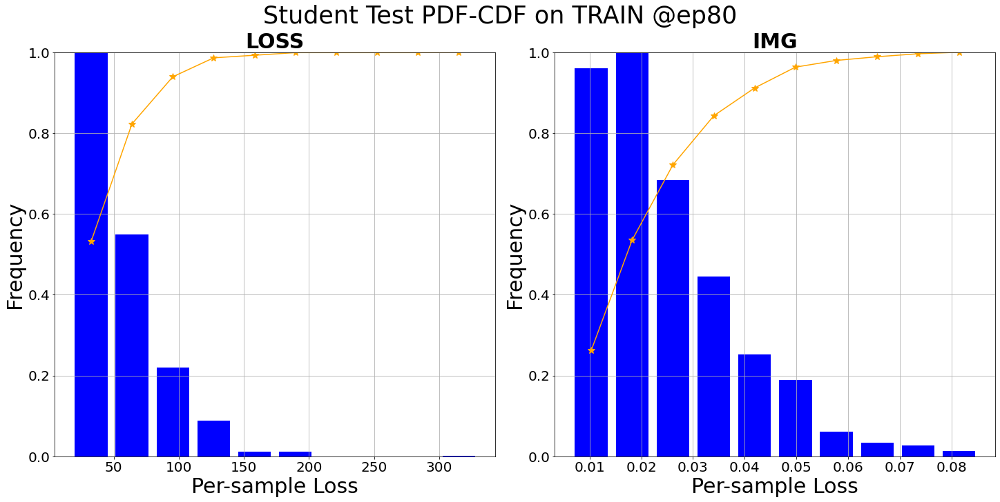

Student valid: epoch=9/10, batch=15/17, current best valid loss=73.5122        3.5122    
Total training time: 49.22924017906189 sec
Student test: sample=15/17, loss=21.8644    
Test finished. Average loss={'LOSS': 32.60217404749025, 'IMG': 0.017885493783015752}

Total training time: 5.704646348953247 sec


<Figure size 1440x720 with 0 Axes>

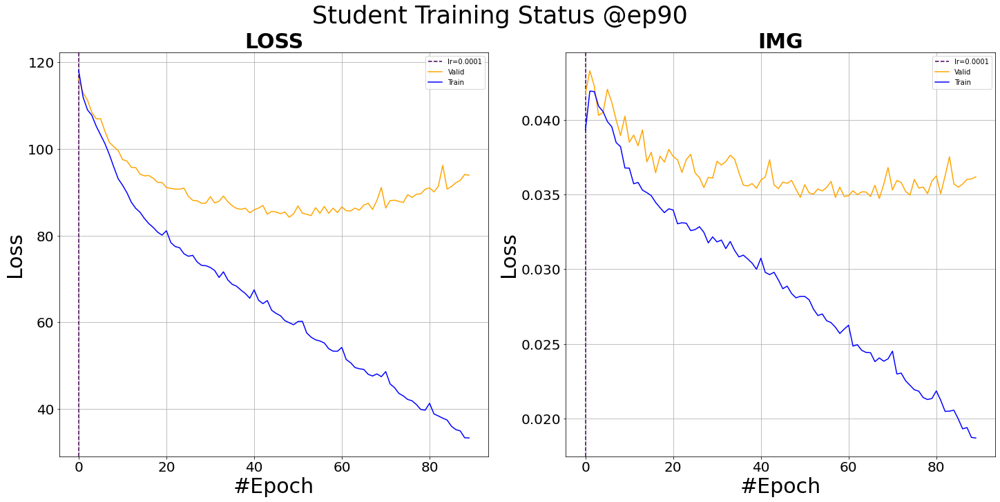

<Figure size 1440x720 with 0 Axes>

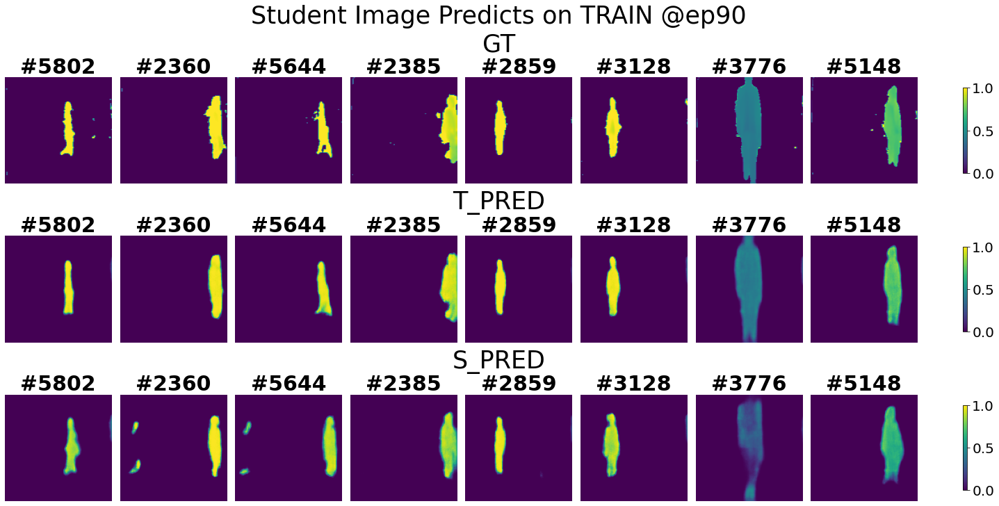

<Figure size 1440x720 with 0 Axes>

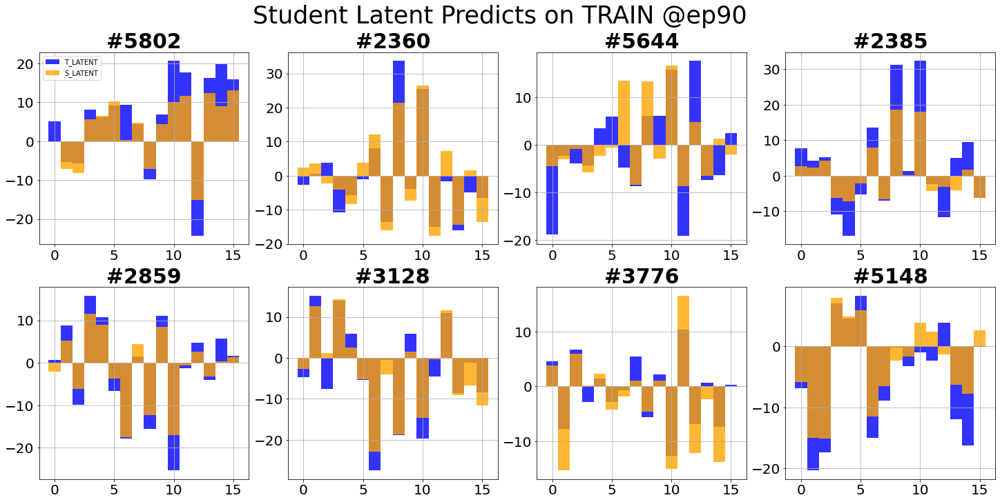

<Figure size 1440x720 with 0 Axes>

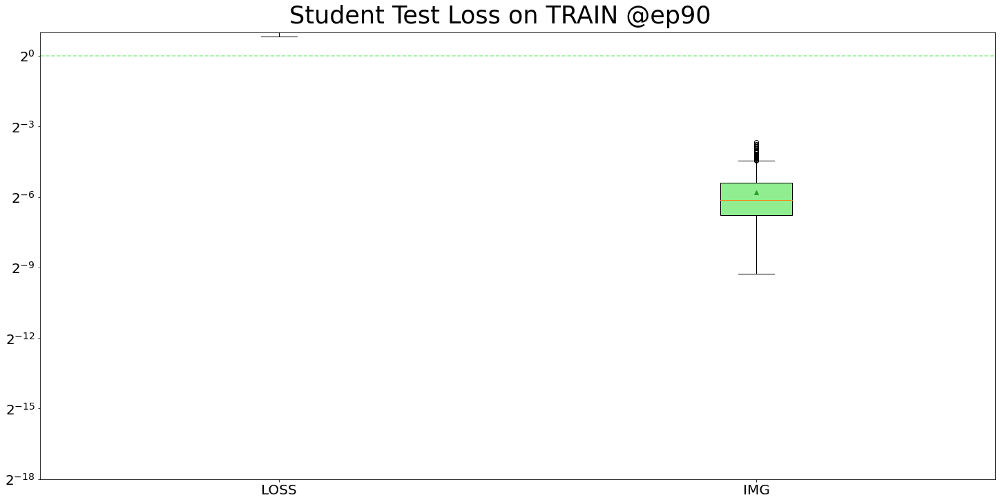

<Figure size 1440x720 with 0 Axes>

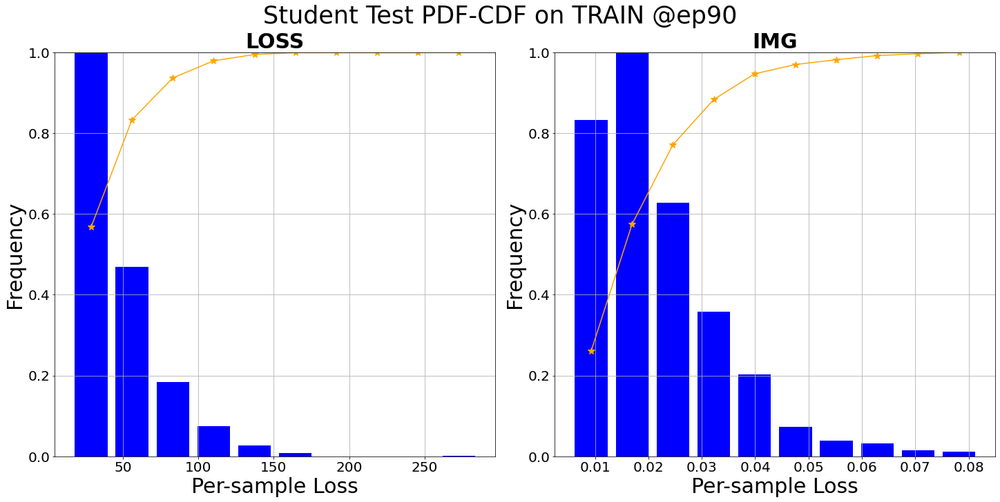

Student valid: epoch=9/10, batch=15/17, current best valid loss=73.5122        3.5122    
Total training time: 53.42921304702759 sec
Student test: sample=15/17, loss=5.3303     
Test finished. Average loss={'LOSS': 26.15338576908278, 'IMG': 0.016622922999244217}

Total training time: 6.148982048034668 sec


<Figure size 1440x720 with 0 Axes>

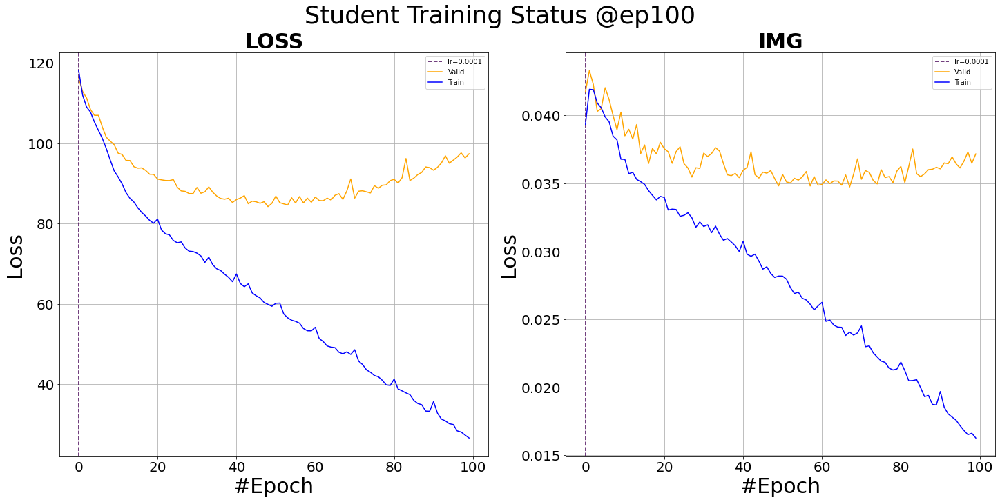

<Figure size 1440x720 with 0 Axes>

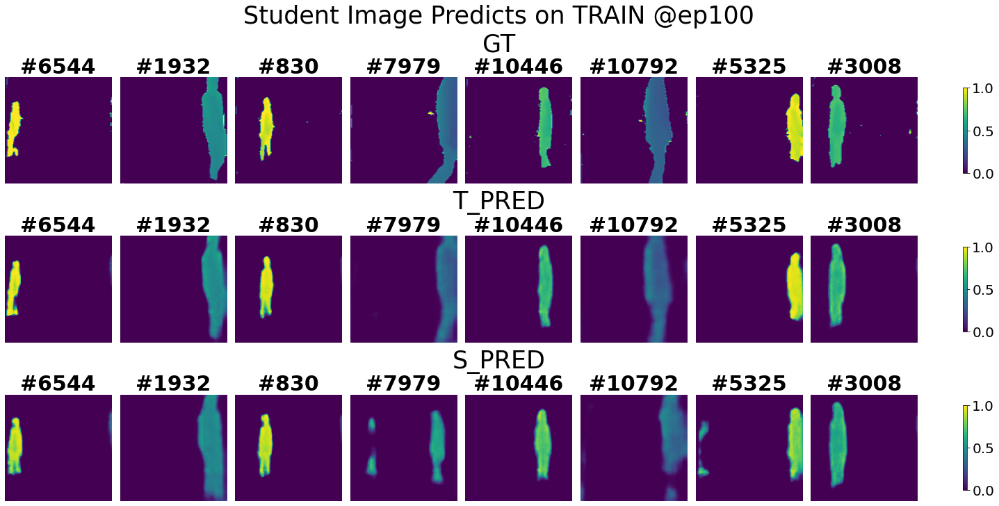

<Figure size 1440x720 with 0 Axes>

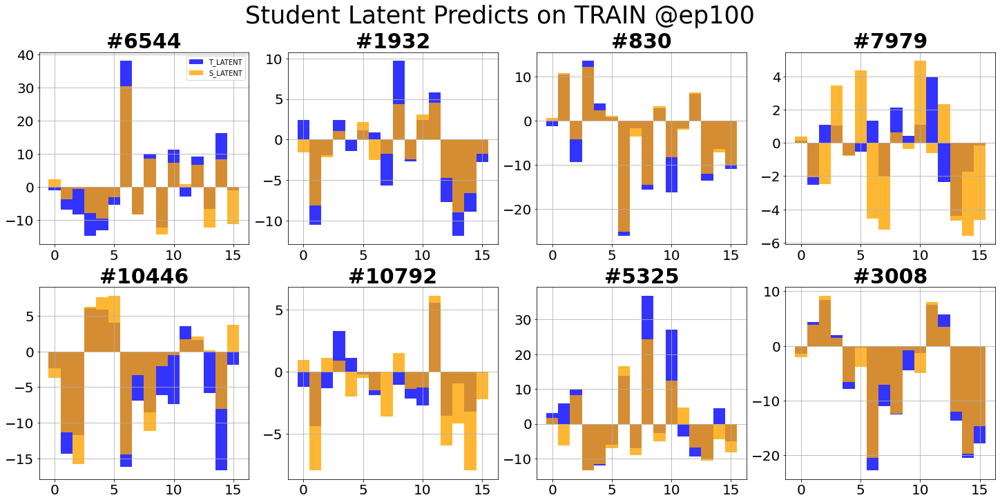

<Figure size 1440x720 with 0 Axes>

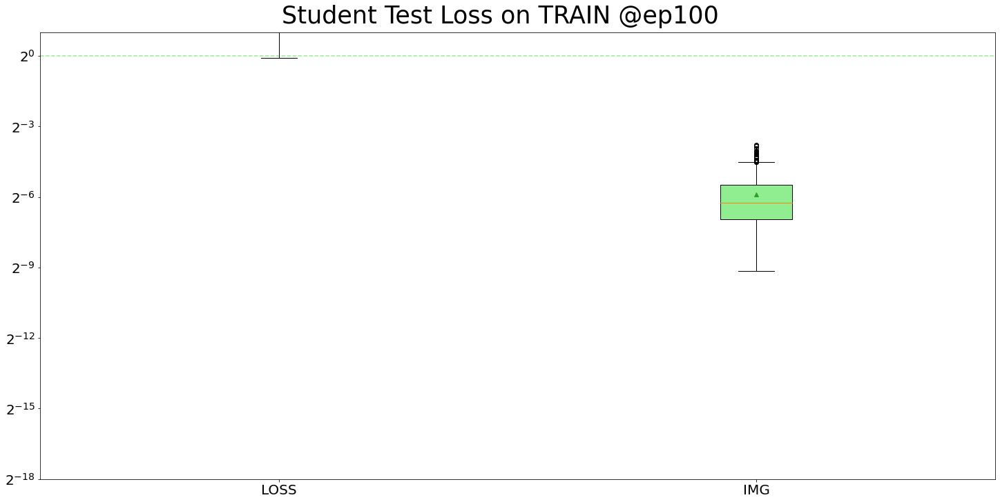

<Figure size 1440x720 with 0 Axes>

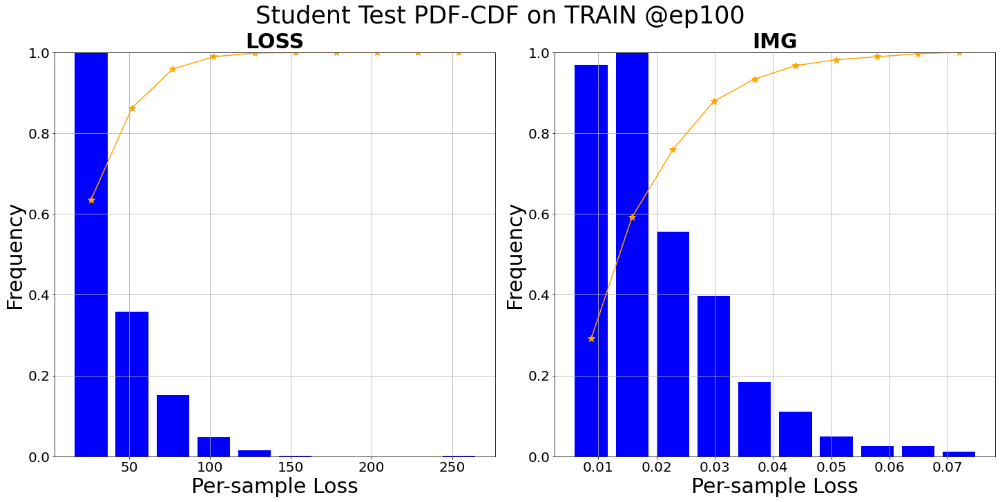


Schedule Completed!


In [34]:
### Scheduler
%matplotlib inline
#trainer1.lr=1e-5
trainer_ts_s.scheduler(turns=10,
                  test_loader='train', select_num=8,
                  autosave=True, notion=f"{date_run}TSAE", train_module={'csien'}, eval_module={'imgen', 'imgde'}, save_model=False)

Student test: sample=8790/8792, loss=52.6093     
Test finished. Average loss={'LOSS': 92.34168569654145, 'IMG': 0.03664921311894855}

Total training time: 48.852004289627075 sec


<Figure size 1440x720 with 0 Axes>

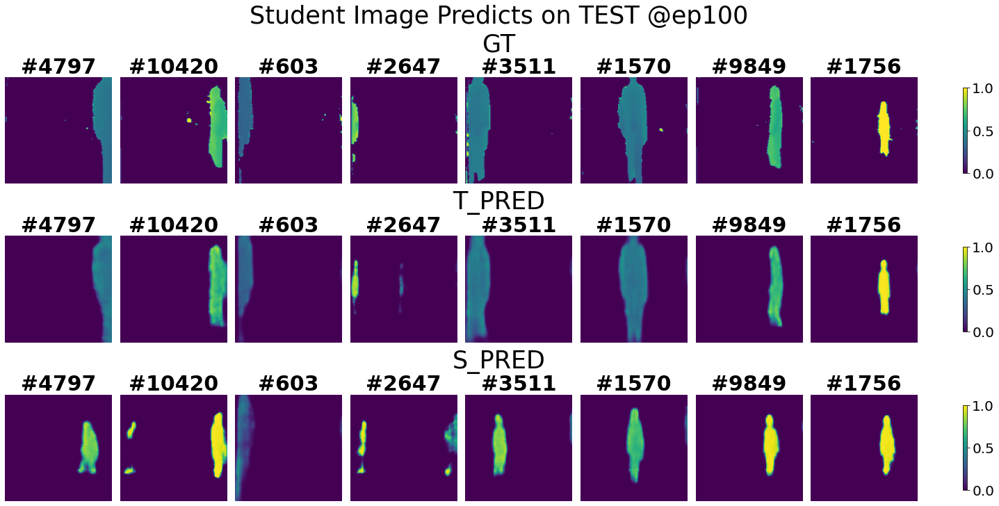

<Figure size 1440x720 with 0 Axes>

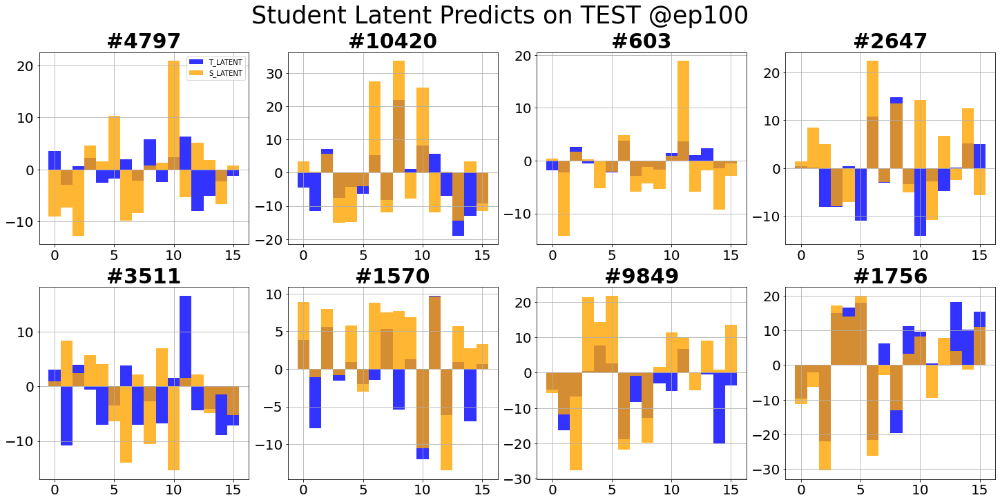

<Figure size 1440x720 with 0 Axes>

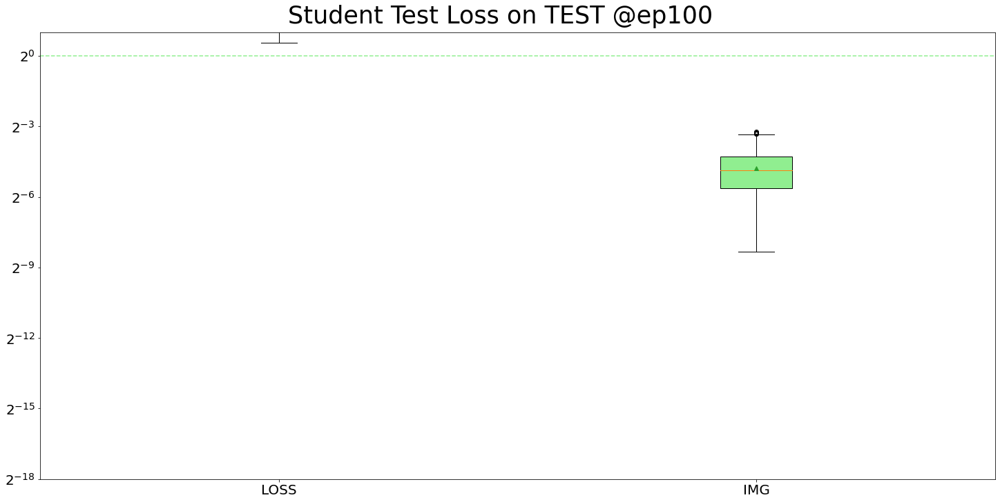

<Figure size 1440x720 with 0 Axes>

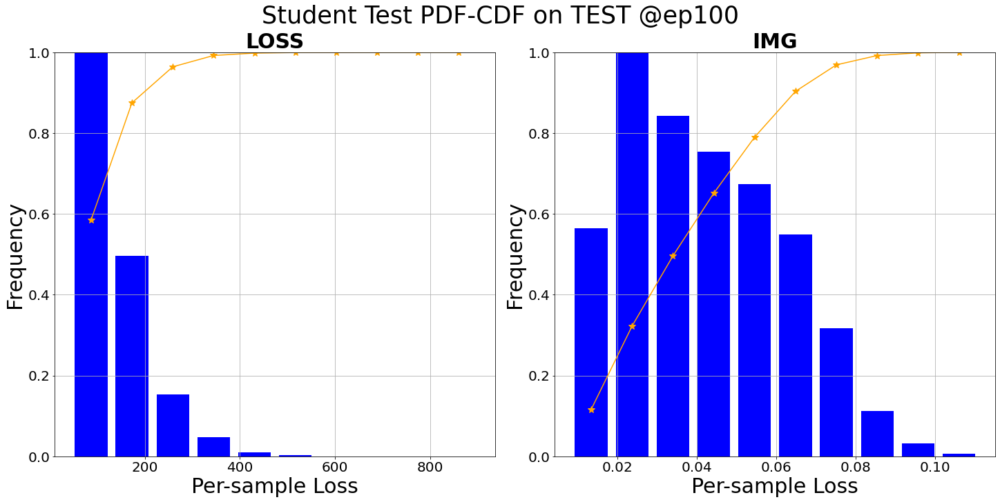

In [35]:
trainer_ts_s.test(loader='test')
trainer_ts_s.plot_test(select_num=8, autosave=True, notion=f"{date_run}TSAE")

In [36]:
trainer_ts_s.save(f"{date_run}TSAE")

Saving models...
Saving csien...
Saving imgen...
Saving imgde...
All saved!


In [37]:
trainer_ts_s.loss.save('pred', f"{date_run}TSAE")

Saving pred including GT, T_PRED, S_PRED, T_LATENT, S_LATENT, IND...Done


### Teacher-Student VAE

#### Teacher

In [40]:
# See Script-V05C5

### Comp

AE test: sample=15/17, loss=10260.7871    
Test finished. Average loss={'LOSS': 6249.288522075204}

Total training time: 2.8527884483337402 sec


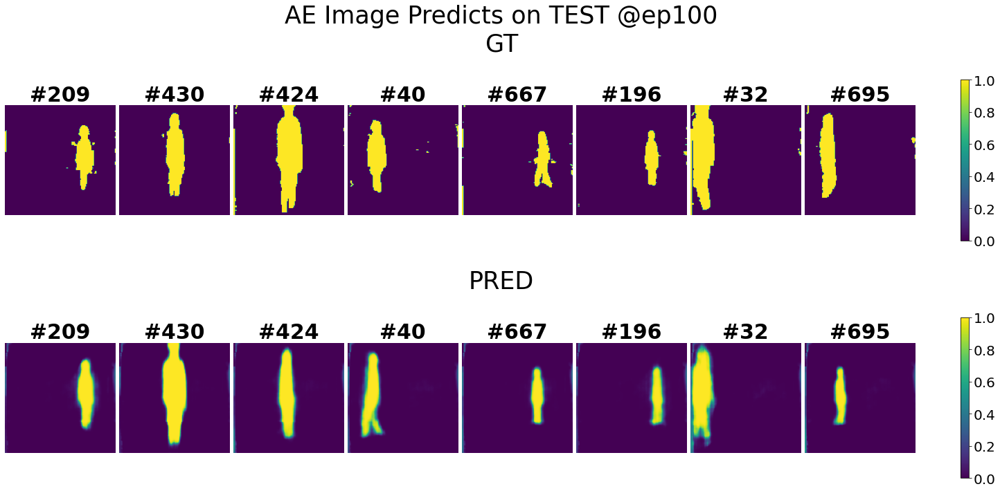

<Figure size 1440x720 with 0 Axes>

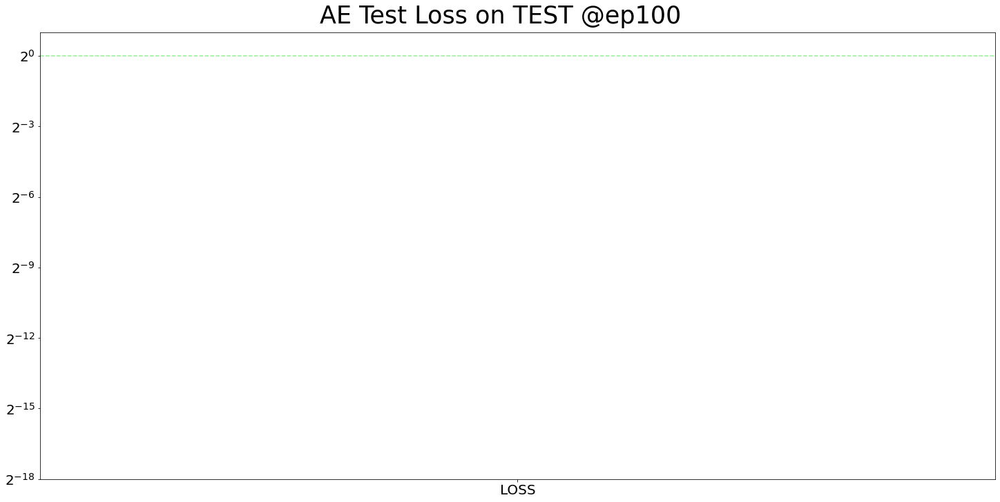

<Figure size 1440x720 with 0 Axes>

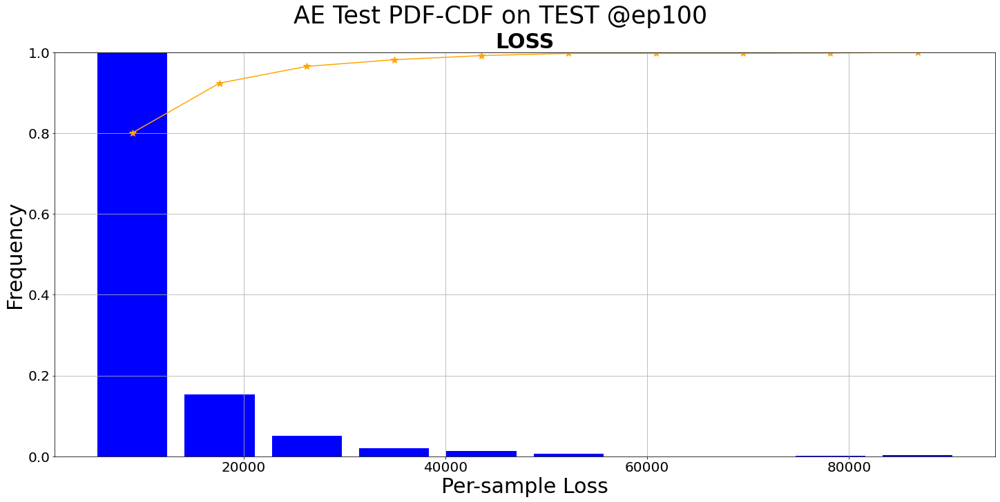

<Figure size 1440x720 with 0 Axes>

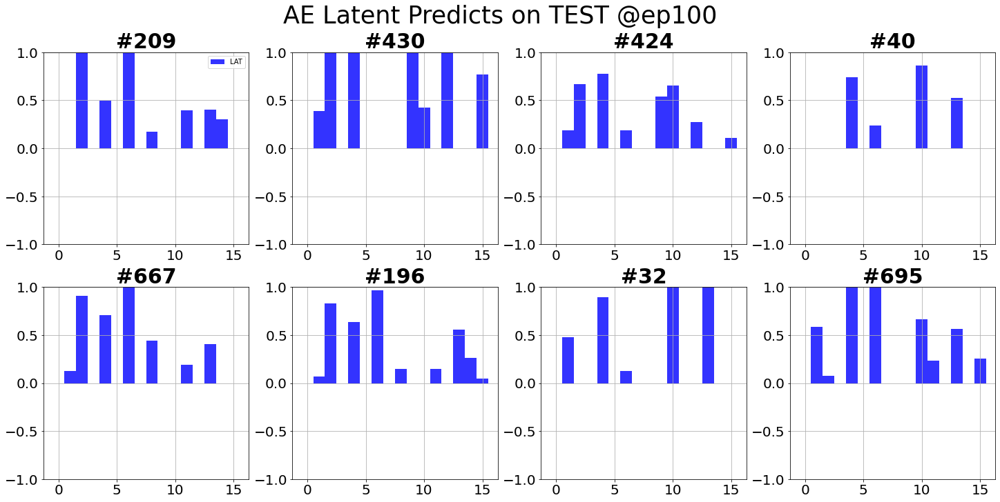

In [22]:
trainer_ae.test(mode='test')
trainer_ae.plot_test(select_ind=[0, 125, 250, 375, 500, 625, 750, 875],select_num=8, autosave=True, notion=f"{date_run}COMP")

VAE test: sample=15/17, loss=1263.0680    
Test finished. Average loss={'LOSS': 4848.197266073788}

Total training time: 3.1945793628692627 sec


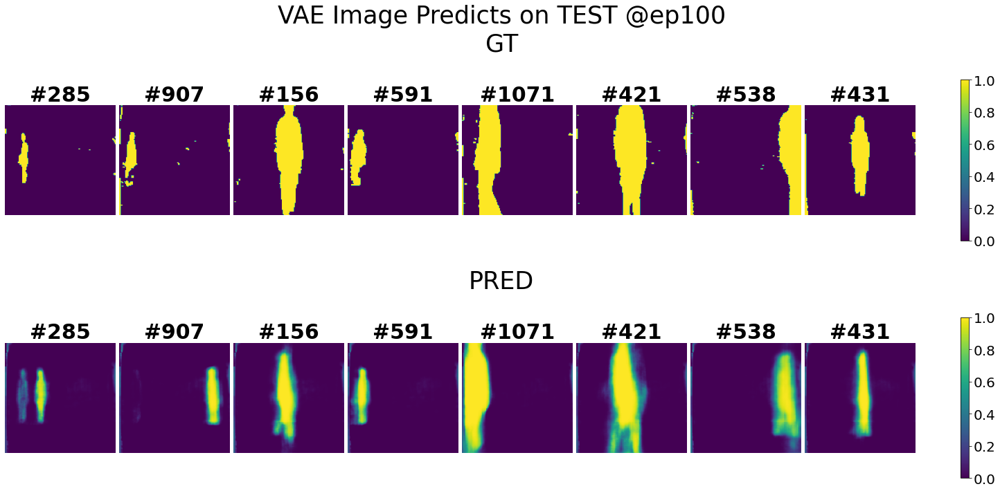

<Figure size 1440x720 with 0 Axes>

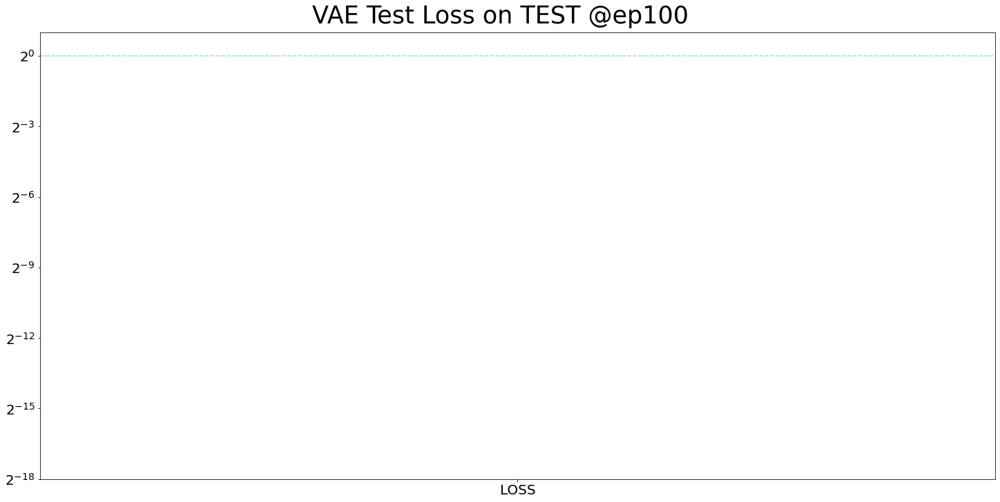

<Figure size 1440x720 with 0 Axes>

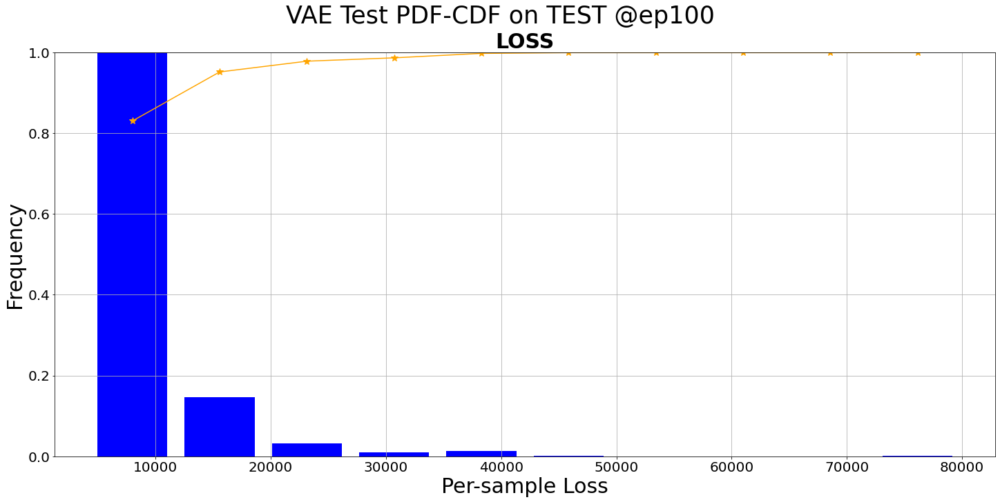

<Figure size 1440x720 with 0 Axes>

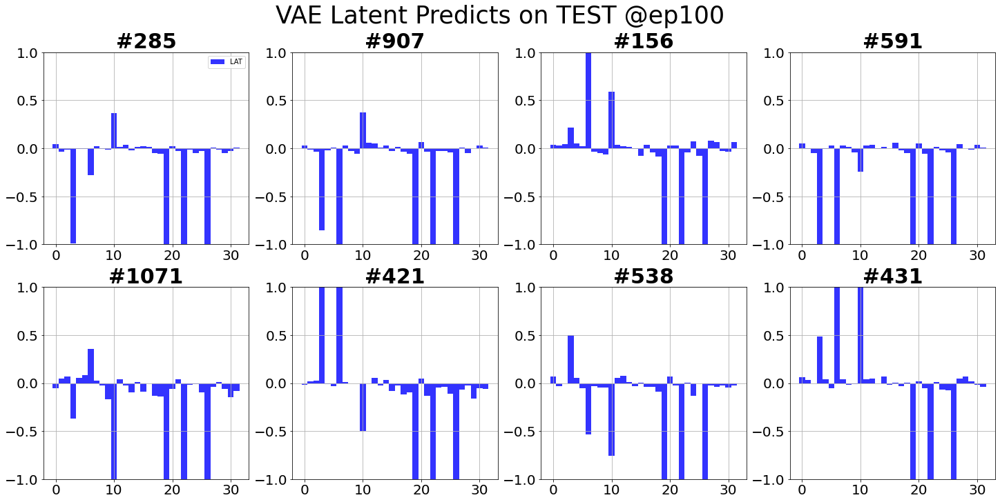

In [23]:
trainer_vae.test(mode='test')
trainer_vae.plot_test(select_ind=[0, 125, 250, 375, 500, 625, 750, 875],select_num=8, autosave=True, notion=f"{date_run}COMP")

In [24]:
trainer_ae_s.test(mode='test')
trainer_ae_s.plot_test(select_ind=[0, 125, 250, 375, 500, 625, 750, 875],select_num=8, autosave=True, notion=f"{date_run}COMP")

NameError: name 'trainer_ae_s' is not defined

In [46]:
print(np.sort(trainer_ae.loss.loss['pred']['IND'])[:10])
print(np.sort(trainer_vae.loss.loss['pred']['IND'])[:10])
print(np.sort(trainer_ae_s.loss.loss['pred']['IND'])[:10])

[12. 17. 23. 26. 47. 50. 52. 59. 63. 65.]
[12. 17. 23. 26. 47. 50. 52. 59. 63. 65.]
[12. 17. 23. 26. 47. 50. 52. 59. 63. 65.]
